# <span style='color:SteelBlue'>P6 - Segmentez des clients d'un site e-commerce</span>

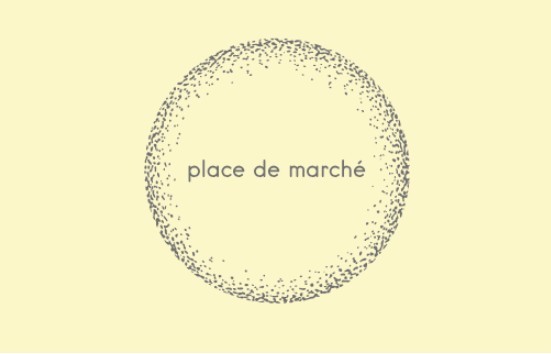

# <span class='bg-primary'>P6_01 - NLP - Données Textuelles - Classification Non Supervisée</span>

# <span class='bg-primary'>P6_01_01 - Words Embeddings</span>

## <span style='background:Thistle'>Sommaire du notebook</span> 

In [1]:
from jyquickhelper import add_notebook_menu
add_notebook_menu()

Ce Notebook traite le NLP avec les méthodes classiques avec classification non supervisée.

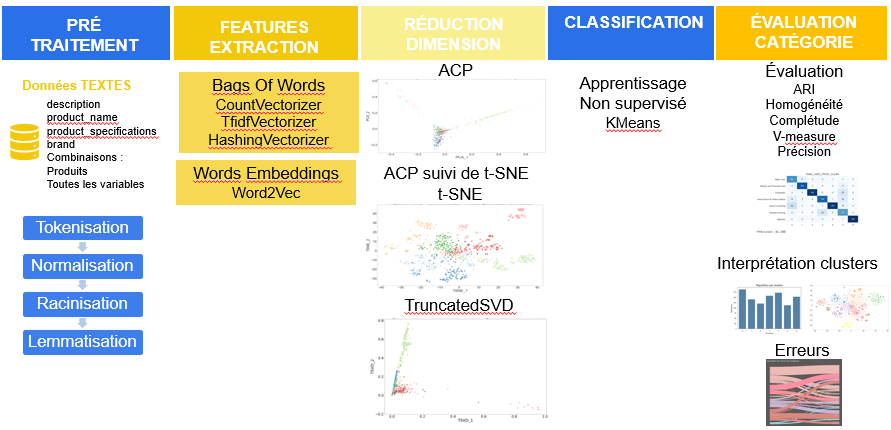

Les meilleurs résultats sont obtenus avec :

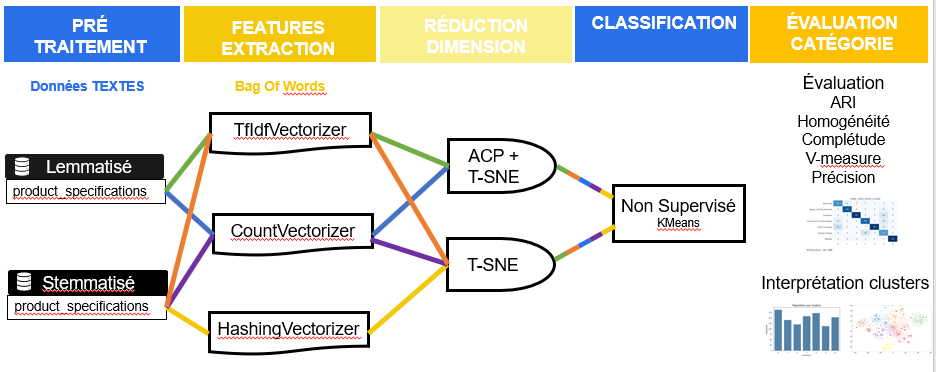

## <span style='background:Thistle'>1. Introduction</span>

**Mission**
*****
Réaliser une première **étude de faisabilité** d'un moteur de **classification d'articles** basé sur une **image et une description** pour l'**automatisation** de l'attribution de la **catégorie de l'article**.

**Objectifs**
*****
- analyser le jeu de données,
- réaliser :
    - un prétraitement des images,
    - un prétraitement des descriptions des produits
    - une réduction de dimension, 
    - puis un clustering. 

La représentation graphique aidera à convaincre que cette approche de modélisation permettra bien de regrouper des produits de même catégorie.

**Contraintes**
***
Afin d’extraire les features, mettre en œuvre a minima un algorithme de type SIFT / ORB / SURF (un algorithme de type CNN Transfer Learning peut éventuellement être utilisé en complément, s’il peut apporter un éclairage supplémentaire à la démonstration).

**Sources**
*****
- [Jeu de données](https://s3-eu-west-1.amazonaws.com/static.oc-static.com/prod/courses/files/Parcours_data_scientist/Projet+-+Textimage+DAS+V2/Dataset+projet+pre%CC%81traitement+textes+images.zip)

In [4]:
# Chargement des librairies
import datetime
import time
import sys
import os
import string
import json
from datetime import datetime
import jyquickhelper
import numpy as np
import pandas as pd
import outils_data
import outils_nlp
import outils_visu
import outils_acp
import outils_segmentation
import matplotlib as mpl
import matplotlib.pyplot as plt
# Feature extraction
import seaborn as sns
import sklearn
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer, \
    HashingVectorizer
# Traitement de text
import texthero as hero
from texthero import preprocessing
import nltk
from nltk.corpus import stopwords
from nltk import word_tokenize, FreqDist
from stop_words import get_stop_words
from gensim.models import Word2Vec
import multiprocessing
# Réduction dimension
from sklearn.decomposition import PCA, TruncatedSVD
from sklearn.manifold import TSNE
# Clustering
from sklearn.cluster import KMeans
from sklearn.metrics import confusion_matrix, classification_report

# Warnings
import warnings
warnings.filterwarnings('ignore')

%matplotlib inline
# Chargement à chaud des librairies personnelles
%load_ext autoreload
%autoreload 2
# Valide code pep8
%load_ext pycodestyle_magic
%pycodestyle_on
# %pycodestyle_off

# Versions
print('Version des librairies utilisées :')
print('jyquickhelper         : ' + jyquickhelper.__version__)
print('Python                : ' + sys.version)
print('NumPy                 : ' + np.version.full_version)
print('Pandas                : ' + pd.__version__)
print('Matplotlib            : ' + mpl.__version__)
print('Seaborn               : ' + sns.__version__)
print('Sklearn               : ' + sklearn.__version__)
print('Outils dataframe      : ' + outils_data.__version__)
print('Outils NLP            : ' + outils_nlp.__version__)
print('Outils visualisation  : ' + outils_visu.__version__)
print('Outils ACP            : ' + outils_acp.__version__)
print('Outils SEGMENTATION   : ' + outils_segmentation.__version__)
now = datetime.now().isoformat()
print('Lancé le           : ' + now)

Version des librairies utilisées :
jyquickhelper         : 0.4.220
Python                : 3.8.8 (default, Feb 24 2021, 15:54:32) [MSC v.1928 64 bit (AMD64)]
NumPy                 : 1.19.5
Pandas                : 1.2.2
Matplotlib            : 3.3.4
Seaborn               : 0.11.0
Sklearn               : 0.23.2
Outils dataframe      : 0.0.2
Outils NLP            : 0.0.0
Outils visualisation  : 0.0.2
Outils ACP            : 0.0.1
Outils SEGMENTATION   : 0.0.0
Lancé le           : 2021-06-14T16:44:59.326545


In [5]:
dico_pd_option = {
    'display.max_rows': 400,
    'display.max_column': 200,
    'display.width': 300,
    'display.precision': 5,
    'display.max_colwidth': 1000,
    'mode.chained_assignment': None
}
for cle, val in dico_pd_option.items():
    pd.set_option(cle, val)

## <span style='background:Thistle'>2. Jeu de données</span>

In [6]:
# Nombre aléatoire pour la reproductibilité des résultats
seed = 21

### <span style='background:PowderBlue'>2.1. Vue d'ensemble</span>

In [7]:
# Chargement du jeu de données
data = pd.read_csv('data/flipkart_com-ecommerce_sample_1050.csv')

Ce jeu de données est un extrait du [jeu de données](https://www.kaggle.com/PromptCloudHQ/flipkart-products) d'un site de e-commerce indien FlipKart.

In [5]:
# Vue d'ensemble du jeu de données
outils_data.resume_datasets([data], ['Data'])

Les données se décomposent en 1 fichier(s)


Jeu de données,Nb lignes,Nb variables,Nb nan,Nb var avec nan,Var avec nan
Data,1050,15,341,4,"retail_price, discounted_price, brand, product_specifications"


In [6]:
# Taille : nombre de lignes/colonnes
nRow, nVar = data.shape
print(f'Le jeu de données contient {nRow} lignes et {nVar} variables.')

Le jeu de données contient 1050 lignes et 15 variables.


In [7]:
# Contenu des 3 premières lignes
data.head(2)

,uniq_id,crawl_timestamp,product_url,product_name,product_category_tree,pid,retail_price,discounted_price,image,is_FK_Advantage_product,description,product_rating,overall_rating,brand,product_specifications
0,55b85ea15a1536d46b7190ad6fff8ce7,2016-04-30 03:22:56 +0000,http://www.flipkart.com/elegance-polyester-multicolor-abstract-eyelet-door-curtain/p/itmeg7bkzdgthcts?pid=CRNEG7BKMFFYHQ8Z,Elegance Polyester Multicolor Abstract Eyelet Door Curtain,"[""Home Furnishing >> Curtains & Accessories >> Curtains >> Elegance Polyester Multicolor Abstract Eyelet Do...""]",CRNEG7BKMFFYHQ8Z,1899.0,899.0,55b85ea15a1536d46b7190ad6fff8ce7.jpg,False,"Key Features of Elegance Polyester Multicolor Abstract Eyelet Door Curtain Floral Curtain,Elegance Polyester Multicolor Abstract Eyelet Door Curtain (213 cm in Height, Pack of 2) Price: Rs. 899 This curtain enhances the look of the interiors.This curtain is made from 100% high quality polyester fabric.It features an eyelet style stitch with Metal Ring.It makes the room environment romantic and loving.This curtain is ant- wrinkle and anti shrinkage and have elegant apparance.Give your home a bright and modernistic appeal with these designs. The surreal attention is sure to steal hearts. These contemporary eyelet and valance curtains slide smoothly so when you draw them apart first thing in the morning to welcome the bright sun rays you want to wish good morning to the whole world and when you draw them close in the evening, you create the most special moments of joyous beauty given by the soothing prints. Bring home the elegant curtain that softly filters light in your room so that ...",No rating available,No rating available,Elegance,"{""product_specification""=>[{""key""=>""Brand"", ""value""=>""Elegance""}, {""key""=>""Designed For"", ""value""=>""Door""}, {""key""=>""Type"", ""value""=>""Eyelet""}, {""key""=>""Model Name"", ""value""=>""Abstract Polyester Door Curtain Set Of 2""}, {""key""=>""Model ID"", ""value""=>""Duster25""}, {""key""=>""Color"", ""value""=>""Multicolor""}, {""key""=>""Length"", ""value""=>""213 cm""}, {""key""=>""Number of Contents in Sales Package"", ""value""=>""Pack of 2""}, {""key""=>""Sales Package"", ""value""=>""2 Curtains""}, {""key""=>""Material"", ""value""=>""Polyester""}]}"
1,7b72c92c2f6c40268628ec5f14c6d590,2016-04-30 03:22:56 +0000,http://www.flipkart.com/sathiyas-cotton-bath-towel/p/itmegfzhxbyucwgn?pid=BTWEGFZHGBXPHZUH,Sathiyas Cotton Bath Towel,"[""Baby Care >> Baby Bath & Skin >> Baby Bath Towels >> Sathiyas Baby Bath Towels >> Sathiyas Cotton Bath Towel (3 Bath Towel, Red, Y...""]",BTWEGFZHGBXPHZUH,600.0,449.0,7b72c92c2f6c40268628ec5f14c6d590.jpg,False,"Specifications of Sathiyas Cotton Bath Towel (3 Bath Towel, Red, Yellow, Blue) Bath Towel Features Machine Washable Yes Material Cotton Design Self Design General Brand Sathiyas Type Bath Towel GSM 500 Model Name Sathiyas cotton bath towel Ideal For Men, Women, Boys, Girls Model ID asvtwl322 Color Red, Yellow, Blue Size Mediam Dimensions Length 30 inch Width 60 inch In the Box Number of Contents in Sales Package 3 Sales Package 3 Bath Towel",No rating available,No rating available,Sathiyas,"{""product_specification""=>[{""key""=>""Machine Washable"", ""value""=>""Yes""}, {""key""=>""Material"", ""value""=>""Cotton""}, {""key""=>""Design"", ""value""=>""Self Design""}, {""key""=>""Brand"", ""value""=>""Sathiyas""}, {""key""=>""Type"", ""value""=>""Bath Towel""}, {""key""=>""GSM"", ""value""=>""500""}, {""key""=>""Model Name"", ""value""=>""Sathiyas cotton bath towel""}, {""key""=>""Ideal For"", ""value""=>""Men, Women, Boys, Girls""}, {""key""=>""Model ID"", ""value""=>""asvtwl322""}, {""key""=>""Color"", ""value""=>""Red, Yellow, Blue""}, {""key""=>""Size"", ""value""=>""Mediam""}, {""key""=>""Length"", ""value""=>""30 inch""}, {""key""=>""Width"", ""value""=>""60 inch""}, {""key""=>""Number of Contents in Sales Package"", ""value""=>""3""}, {""key""=>""Sales Package"", ""value""=>""3 Bath Towel""}]}"


-------------------------------------------------------------
Type de variable pour chacune des variables



uniq_id                     object
crawl_timestamp             object
product_url                 object
product_name                object
product_category_tree       object
pid                         object
retail_price               float64
discounted_price           float64
image                       object
is_FK_Advantage_product       bool
description                 object
product_rating              object
overall_rating              object
brand                       object
product_specifications      object
dtype: object

,Nombre par type de variable,% des types de variable
object,12,80.00000
float64,2,13.33000
bool,1,6.67000


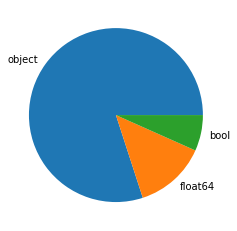

In [8]:
# Types des variables
outils_data.get_types_variables(data, True, True, True)

In [9]:
# Résumé des variables
desc_data = outils_data.description_variables(data)
desc_data

,uniq_id,crawl_timestamp,product_url,product_name,product_category_tree,pid,retail_price,discounted_price,image,is_FK_Advantage_product,description,product_rating,overall_rating,brand,product_specifications
type,object,object,object,object,object,object,float64,float64,object,bool,object,object,object,object,object
nb_nan,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,338.0,1.0
%_nan,0.0,0.0,0.0,0.0,0.0,0.0,0.09524,0.09524,0.0,0.0,0.0,0.0,0.0,32.19048,0.09524
count,1050,1050,1050,1050,1050,1050,1049.0,1049.0,1050,1050,1050,1050,1050,712,1049
unique,1050,149,1050,1050,642,1050,NaN,NaN,1050,2,1050,27,27,490,984
top,9c8fdf6c9c631d0892e9a6f55a4a2fd2,2015-12-01 12:40:44 +0000,http://www.flipkart.com/mars-queen-eye-liner-lip-gloss-eyeliner/p/itmej5q67a89dtgc?pid=CBKEJ5Q6KRZM6CZN,Sonata 8098YM01 Analog Watch - For Women,"[""Home Furnishing >> Bed Linen >> Blankets, Quilts & Dohars""]",BLAEE6KTUAEBTDKS,NaN,NaN,32f24a4303050f500dec7cb3608fe089.jpg,False,"Buy Al Fakher Pegs'N'Pipes Mint, Double Apple Hookah Flavor for Rs.297 online. Al Fakher Pegs'N'Pipes Mint, Double Apple Hookah Flavor at best prices with FREE shipping & cash on delivery. Only Genuine Products. 30 Day Replacement Guarantee.",No rating available,No rating available,PRINT SHAPES,"{""product_specification""=>[{""key""=>""Type"", ""value""=>""Mug""}, {""key""=>""Mug Capacity"", ""value""=>""5.5 l""}, {""key""=>""Freezer Safe"", ""value""=>""Yes""}, {""key""=>""Material"", ""value""=>""Ceramic""}, {""key""=>""Microwave Safe"", ""value""=>""Yes""}, {""value""=>""1 Year Rockmantra Brand Warranty and Free Transit Insurance.""}, {""key""=>""Diameter"", ""value""=>""88 mm""}, {""key""=>""Weight"", ""value""=>""300 g""}, {""key""=>""Height"", ""value""=>""101 mm""}, {""key""=>""Width"", ""value""=>""88 mm""}, {""key""=>""Sales Package"", ""value""=>""1 mug""}]}"
freq,1,150,1,1,56,1,NaN,NaN,1,993,1,889,889,11,22
mean,NaN,NaN,NaN,NaN,NaN,NaN,2186.19733,1584.52717,NaN,NaN,NaN,NaN,NaN,NaN,NaN
std,NaN,NaN,NaN,NaN,NaN,NaN,7639.22941,7475.09968,NaN,NaN,NaN,NaN,NaN,NaN,NaN
min,NaN,NaN,NaN,NaN,NaN,NaN,35.0,35.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN


- Clés uniques : uniq_id, product_url, product_name, pid, image, description.
- Variables avec des valeurs manquantes : retail_price, discounted_price, brand, product_specifications    

In [10]:
data['product_rating'].unique()

array(['No rating available', '5', '1', '2.3', '2.7', '4.5', '4', '3.8',
       '4.3', '3.7', '3.6', '3.5', '4.1', '4.9', '3.1', '4.2', '4.8',
       '4.4', '3.9', '3', '3.3', '2.5', '2', '4.7', '2.2', '3.2', '1.5'],
      dtype=object)

In [11]:
data['overall_rating'].unique()

array(['No rating available', '5', '1', '2.3', '2.7', '4.5', '4', '3.8',
       '4.3', '3.7', '3.6', '3.5', '4.1', '4.9', '3.1', '4.2', '4.8',
       '4.4', '3.9', '3', '3.3', '2.5', '2', '4.7', '2.2', '3.2', '1.5'],
      dtype=object)

Valeurs manquantes :341 NaN pour 15750 données (2.17 %)
-------------------------------------------------------------
Nombre et pourcentage de valeurs manquantes par variable



,Nombres de valeurs manquantes,% de valeurs manquantes
brand,338,32.19000
retail_price,1,0.10000
discounted_price,1,0.10000
product_specifications,1,0.10000


-------------------------------------------------------------
Heatmap de visualisation des valeurs manquantes


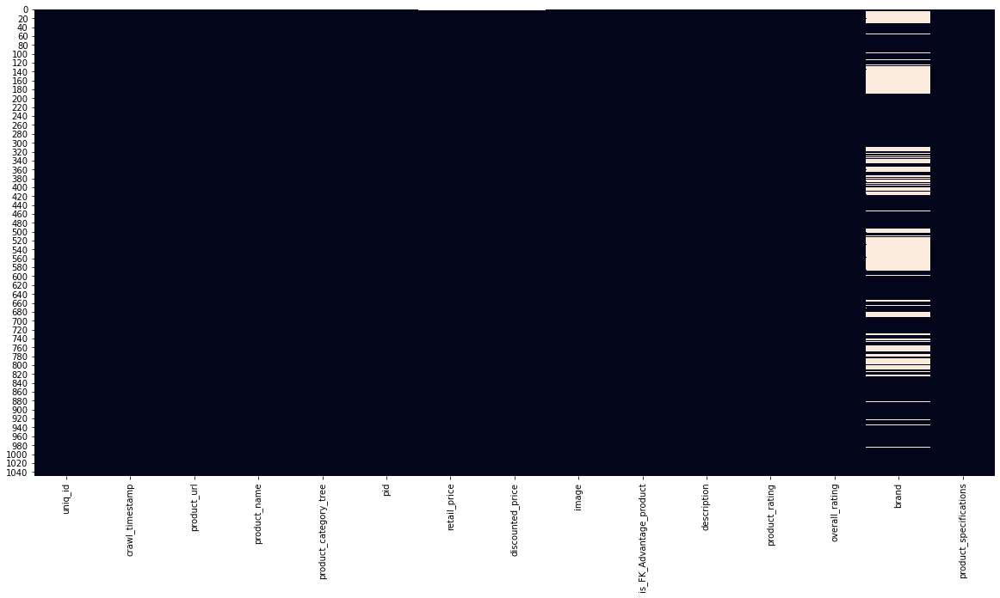

In [12]:
# Valeurs manquantes
outils_data.get_missing_values(data, True, True)

- Le jeu de données comporte peu de valeurs manquantes (~ 2%), seule la variable 'brand' comporte plus de 30% de valeurs manquantes.

**Compréhension des variables**
***
| Variable | Description | Note |
| --- | --- | --- |
| uniq_id | Identifiant unique | <span style='background:PeachPuff'>Clé unique</span> - ex : 59af3731b809a25f2bf99e99f645d8dd |
| crawl_timestamp | Horodatage | Format YYYY-MM-DD HH24:MI:SS +0000|
| product_url | URL d'accès au produit sur le site e-commerce Flickart | <span style='background:PeachPuff'>Clé unique</span> |
| **product_name** | Nom du produit | <span style='background:PeachPuff'>Clé unique</span> - <span style='background:Aqua'>Texte</span> |
| **product_category_tree** | Arbre des catégories des produits | Notre cible - sous-catégories séparées par '>>' - <span style='background:Aqua'>Texte</span> - <span style='background:Salmon'>Données multiples</span>|
| pid | Identifiant unique | <span style='background:PeachPuff'>Clé unique</span> - ex : CAGEBTJBTNGGDZQZ |
| retail_price | Prix de consommation |  |
| discounted_price | Prix réduit |  |
| **image** | Image | <span style='background:PeachPuff'>Clé unique</span> - Format : uniq_id.jpg ==> référence aux <span style='background:Plum'>images</span> du jeu de données |
| is_FK_Advantage_product | Produit avantageux FlipKart? | Booléen |
| **description** | Description du produit | <span style='background:PeachPuff'>Clé unique</span> - <span style='background:Aqua'>Texte</span> |
| product_rating | Évaluation du produit | Entre 1 et 5 avec 1 chiffre après la virgule ou 'No rating available' |
| overall_rating | Note moyenne globale d'évaluation | Entre 1 et 5 avec 1 chiffre après la virgule ou 'No rating available' |
| **brand** | Marque du produit | Valeurs manquantes - <span style='background:Aqua'>Texte</span> |
| **product_specifications** | Spécification du produit | Propriétés techniques avec clé/valeur  <span style='background:Salmon'>Données multiples</span> |

### <span style='background:PowderBlue'>2.2. Analyse exploratoire</span>

In [13]:
# Copie du jeu de données
data_ana = data.copy()

<span style='background:Moccasin'>***uniq_id / product_url / pid*** - Identifiants uniques</span>
***

- **uniq_id** et **pid** sont des clés uniques compliquées, peu explicites et ne nous permettent pas de trouver la catégorie du produit.
- **product_url** est une clé unique qui contient des informations sur le produit permettant de le catégoriser mais les informations sont les mêmes que celles de la variables 'description'.
- La variable **product_name** est unique et explicite, on la conservera comme clé primaire du produit.

**Conclusion** :
- Variables non conservées : **uniq_id**, **pid** et **product_url**.
- Variable conservée comme clé unique : **product_name**.

<span style='background:Moccasin'>***crawl_timestamp*** - Horodatage</span>
***

In [14]:
# Transforme de Object en Datetime
data_ana['crawl_timestamp'] = pd.to_datetime(data_ana['crawl_timestamp'])
# Période de notre sous-jeu de données
min = data_ana['crawl_timestamp'].min().strftime('%d/%m/%Y')
max = data_ana['crawl_timestamp'].max().strftime('%d/%m/%Y')
print(f'Période d\'ajout des produits : du {min} au {max}')

Période d'ajout des produits : du 01/12/2015 au 26/06/2016


In [15]:
%pycodestyle_off

In [16]:
# Ajout de la variable comportant l'année
data_ana['crawl_year'] = data_ana['crawl_timestamp'].apply(lambda x : x.year)

In [17]:
%pycodestyle_on

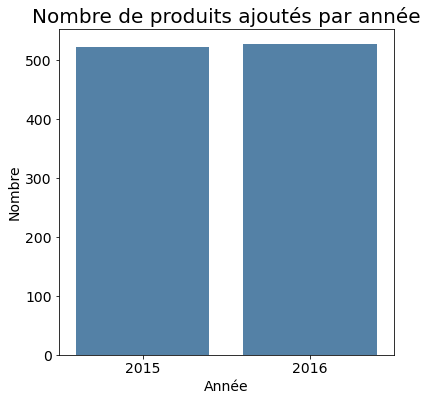

In [18]:
# Répartition du nombre de produits ajoutés par année
# -----------------------------------------------------------------------
plt.figure(figsize=(6, 6))
sns.countplot(x=data_ana.crawl_year, data=data_ana,
              color='SteelBlue')

plt.title('Nombre de produits ajoutés par année', fontsize=20)
plt.ylabel('Nombre', fontsize=14)
plt.xlabel('Année', fontsize=14)

plt.xticks(fontsize=14)
plt.yticks(fontsize=14)
plt.grid(False)
plt.show()

- Dans le sous-jeu de données à notre disposition, les ajouts de produits sont équitablement répartis entre 2015 et 2016.
- Cette variable ne donne aucune information sur la catégorie du produit, elle ne sera pas conservée.

**Conclusion** :
- Variable non conservée : **crawl_timestamp**.

<span style='background:Moccasin'>***product_category_tree*** - Arbre des catégories des produits</span>
***

In [19]:
print(data['product_category_tree'].head(1))

0    ["Home Furnishing >> Curtains & Accessories >> Curtains >> Elegance Polyester Multicolor Abstract Eyelet Do..."]
Name: product_category_tree, dtype: object


- La variable **product_category_tree** est constituée de plusieurs sous-catégories de produits séparées par des chevrons.
- Exemple : Home Furnishing >> Curtains & Accessories >> Curtains >> Elegance Polyester Multicolor Abstract Eyelet Do...

**Profondeur des sous-catégories ?**

'Nombre de sous-niveaux : 1051'

'Sous-niveaux existants : [2 3 4 5 6 7]'

'Sous-niveaux minimum : 2'

'Sous-niveaux maximum : 7'

"Nombre de produits n'ayant que x sous-niveaux"

'---------------------------------------------------------------'

,Nbre_par_niveau
2,3
3,368
4,274
5,278
6,70
7,57


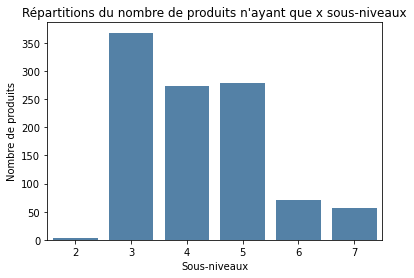

"Nombre de catégories contenant x% d'images pour la plage pour le niveau 1"

Plage,nb_données,%_données
"(0, 10]",0,0.00000
"(10, 50]",0,0.00000
"(50, 100]",0,0.00000
"(100, 150]",7,100.00000


"Nombre de catégories contenant x% d'images pour la plage pour le niveau 2"

Plage,nb_données,%_données
"(0, 10]",38,61.29032
"(10, 50]",17,27.41935
"(50, 100]",6,9.67742
"(100, 150]",1,1.61290


"Nombre de catégories contenant x% d'images pour la plage pour le niveau 3"

Plage,nb_données,%_données
"(0, 10]",220,91.28631
"(10, 50]",19,7.88382
"(50, 100]",2,0.82988
"(100, 150]",0,0.00000


"Nombre de catégories contenant x% d'images pour la plage pour le niveau 4"

Plage,nb_données,%_données
"(0, 10]",343,98.28080
"(10, 50]",5,1.43266
"(50, 100]",1,0.28653
"(100, 150]",0,0.00000


"Nombre de catégories contenant x% d'images pour la plage pour le niveau 5"

Plage,nb_données,%_données
"(0, 10]",296,99.66330
"(10, 50]",1,0.33670
"(50, 100]",0,0.00000
"(100, 150]",0,0.00000


"Nombre de catégories contenant x% d'images pour la plage pour le niveau 6"

Plage,nb_données,%_données
"(0, 10]",117,100.00000
"(10, 50]",0,0.00000
"(50, 100]",0,0.00000
"(100, 150]",0,0.00000


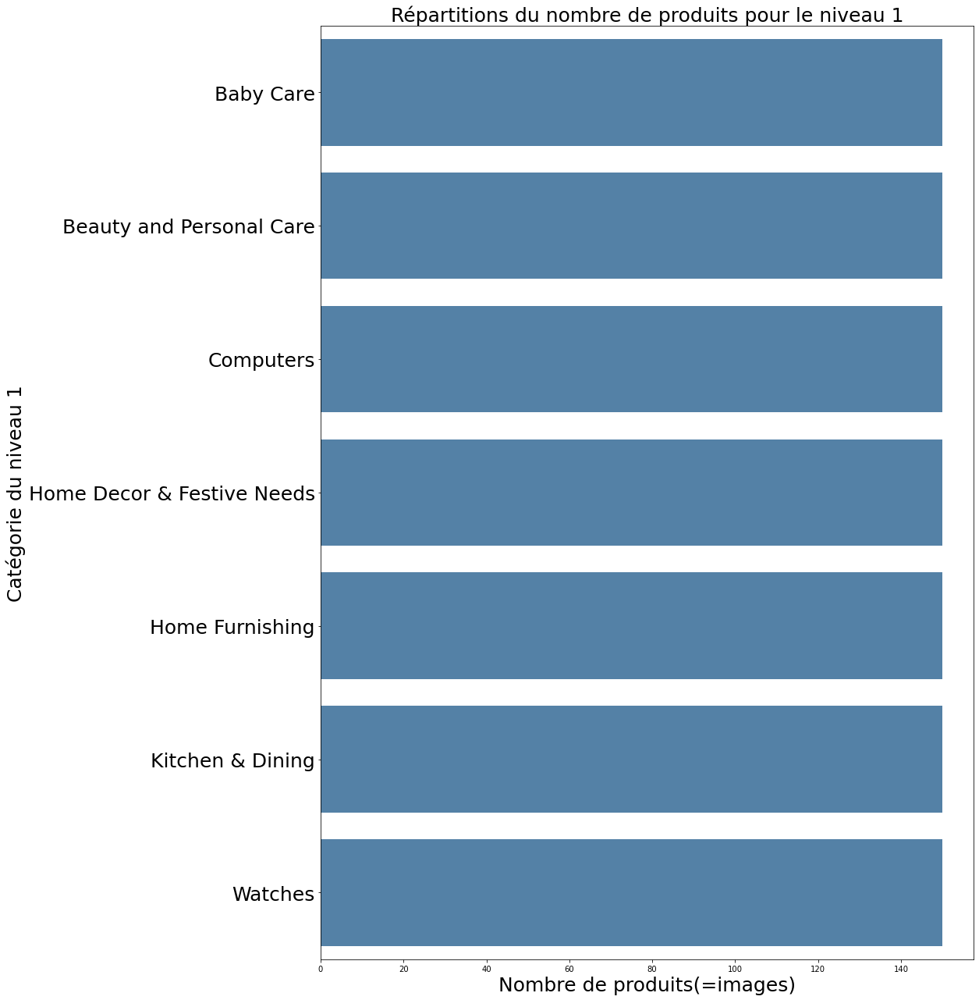

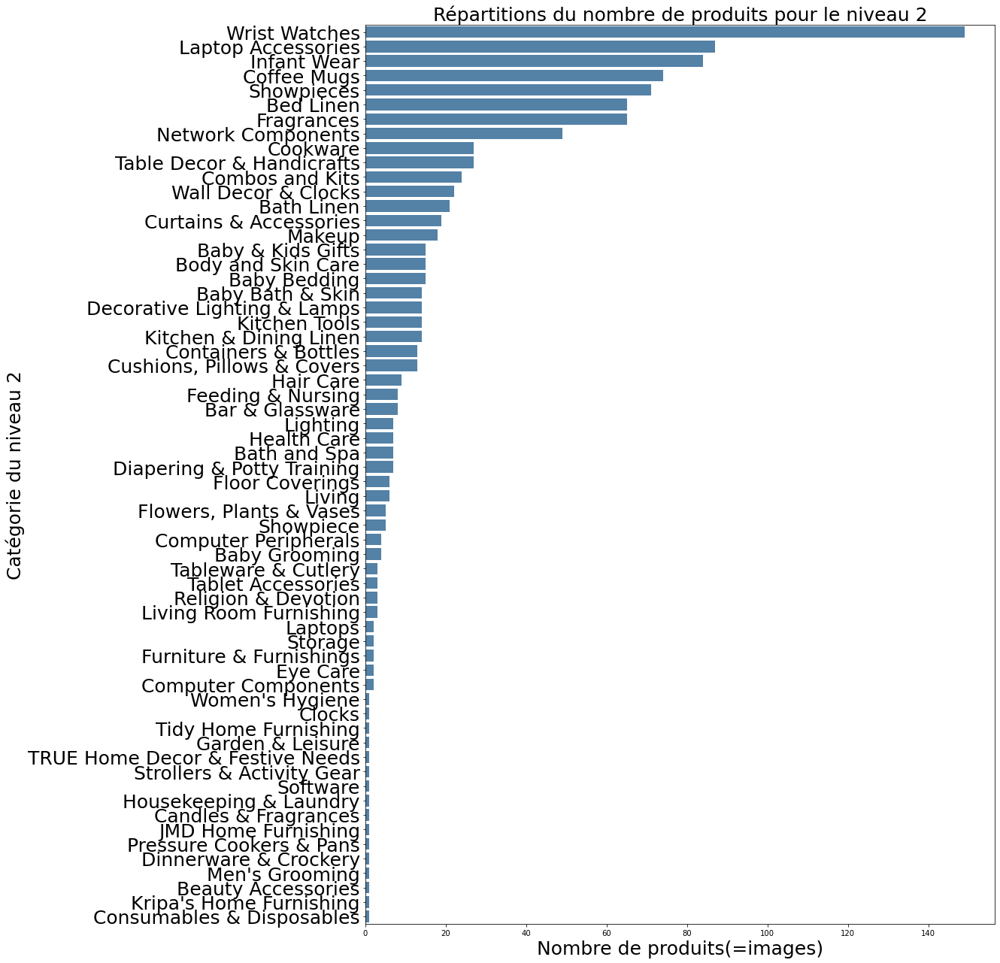

In [8]:
data = outils_data.decoupe_texte_selon_separateur(data,
                                                  'product_category_tree',
                                                  ' >> ')

In [201]:
# Nombre de catégories par niveau?
niveaux = ['Categorie_1', 'Categorie_2', 'Categorie_3', 'Categorie_4',
           'Categorie_5', 'Categorie_6', 'Categorie_7']
for niveau in niveaux:
    print(niveau + ' : ' + str(data[niveau].nunique()) + ' catégories')

Categorie_1 : 7 catégories
Categorie_2 : 62 catégories
Categorie_3 : 241 catégories
Categorie_4 : 349 catégories
Categorie_5 : 297 catégories
Categorie_6 : 117 catégories
Categorie_7 : 57 catégories


**Bilan** :
***
- Les sous-catégories sont comprises entre 2 au minimum et 7 au maximum.
- La plupart des produits ont entre 3 et 5 sous-niveaux.
- Le premier niveau comporte 7 catégories ayant chacune 150 images.
- Les autres niveaux comportent de nombreuses catégories ayant moins de 10 images, ce qui est bien insuffisant pour pouvoir correctement catégoriser ces niveaux en automatique. 

**Le niveau 1 des catégories sera utilisé pour la suite de l'analyse.**

<span style='background:Moccasin'>***image*** - Image</span>
***

- Cette variable est composée de la variable uniq_id + .jpg' et représente le nom de la photographie qui est enregistrée dans le repertoire 'Images' du jeu de données fourni.

In [21]:
# Est-ce que chaque produit à bien une photographie associée dans le
# répertoire 'Images'?
photo_image = []
for photo in os.listdir('data/Images'):
    photo_image.append(photo)
verif_exist = data[~data['image'].isin(photo_image)]
verif_exist

,uniq_id,crawl_timestamp,product_url,product_name,product_category_tree,pid,retail_price,discounted_price,image,is_FK_Advantage_product,description,product_rating,overall_rating,brand,product_specifications,Categorie_1,Categorie_2,Categorie_3,Categorie_4,Categorie_5,Categorie_6,Categorie_7


- Toutes les images ont bien un fichier de photographie dans le répertoire 'Images'.

<span style='background:Moccasin'>***description*** - Description textuelles du produit</span>
***

- Description textuelle du produit pour une compréhension de l'utilisateur.

<span style='background:Moccasin'>***brand*** - Marque</span>
***

- marque du produit qui peut donner des informations sur la catégorie du produit.

<span style='background:Moccasin'>***product_specifications*** - Spécifications du produit</span>
***

- clé, valeur de différentes propriétés du produit, ces informations sont retrouvées dans la variable description.

<span style='background:Moccasin'>***Autres variables*** - Inutiles pour la classification des catégories</span>
***

- **retail_price** : le prix de consommation peut indiquer si le produit est onéreux ou pas donc une idée de la catégorie mais aucune exploitation associée au texte ou à l'image.
- **discounted_price** : le prix réduit peut indiquer si le produit est onéreux ou pas donc une idée de la catégorie mais aucune exploitation associée au texte ou à l'image.
- **is_FK_Advantage_product** : booléen dont on ne peut tirer aucune information de texte ou d'image.
- **product_rating** : note du produit dont on ne peut tirer aucune information de texte ou d'image.
- **overall_rating** : note moyenne globale du produit dont on ne peut tirer aucune information de texte ou d'image

Ces variables ne seront pas conservées.

### <span style='background:PowderBlue'>2.3. Variables pertinentes?</span>

**Bilan de l'analyse exploratoire** :
***
- Notre mission est d'automatiser la classification des catégories des produits ajoutés par le vendeur à partir des descriptions textuelles et des images mis à disposition dans le jeu de données.
- Parmi les 6 clés uniques disponibles, le nom du produit sera conservé comme clé unique :
    - [x] **product_name**.
- Les variables utiles, conservées, contenant des données textuelles ou des images, sont :
    - [x] **image**,
    - [x] **product_category_tree**,
    - [x] **description**,
    - [x] **product_specifications**,
    - [x] **brand**,
    - [x] **Categorie_1**.

In [9]:
# Constitution du dataframe de travail
data_work = data[['product_name', 'brand', 'image', 'product_category_tree',
                  'description', 'product_specifications', 'Categorie_1']]

## <span style='background:Thistle'>3. Pré-traitement</span>

Préparation des données, les rendant exploitables pour l'automatisation des catégorisation.

Pré-traitement pas à pas pour observer le résultat de chaque étape pour les transformations effectuées sur la variable 'description'.

### <span style='background:PowderBlue'>3.1. Pré-traitement pas à pas</span>

#### <span style='background:Moccasin'>3.1.1 Tokenisation</span>

Pemière phase de définition de l'objet de l'analyse : 
- la tokenisation des textes qui consiste à identifier les unités de textes élémentaires (tokens) qui peuvent être des mots, mais aussi des lettres, des syllabes, des phrases, ou des séquences de ces éléments.
- Si les mots sont des unités de sens évidentes, les paires, les triplets de mots le sont aussi (n-grammes).
- à partir de ces tokens, l'analyse de la fréquence des mots peut être effectuée pour construire un dictionnaire permettant de filtrer les tokens selon leurs fréquences.
- les tokens les plus fréquents qui n'apportent donc aucune information sont supprimés.
- les tokens très peu fréquents qui apportent une information singulière sont également supprimés.

In [10]:
# Dataframe témoin des modifications
df_temoin = pd.DataFrame({})
df_temoin = \
    outils_nlp.suivre_modif_texte(df_temoin, 'Texte original',
                                  data_work['description'][1046])

In [11]:
# Tokenisation
# ----------------------------------------------------------------------
# Décomposition en tokens (souvent un mot mais peut être 3) par exemple)
data_work['description_clean'] = [word_tokenize(row)
                                  for row in data_work['description']]
# Suivi des modifications
df_temoin = \
    outils_nlp.suivre_modif_texte(df_temoin, 'Tokenisation',
                                  data_work['description_clean'][1046])

In [25]:
# Nombre de tokens total dans toutes les descriptions
list_all_token = []
for row in data_work['description_clean']:
    list_all_token.extend(row)
nb_tok = len(list_all_token)
nb_tok_unique = len(set(list_all_token))
display(f'Nombre de tokens total dans les descriptions : {nb_tok}')
display(f'Nombre de tokens uniques dans les descriptions : {nb_tok_unique}')

'Nombre de tokens total dans les descriptions : 91561'

'Nombre de tokens uniques dans les descriptions : 8175'

In [12]:
# Transformer liste en string
data_work['description_clean'] = \
    data_work['description_clean'].apply(lambda x: ' '.join(x))
# Suivi des modifications
df_temoin = \
    outils_nlp.suivre_modif_texte(df_temoin, 'Tokens en 1 phrase',
                                  data_work['description_clean'][1046])

#### <span style='background:Moccasin'>3.1.2. Normalisation</span>

Deuxième phase de lissage, correction et nettoyage des données textuelles :
- Mettre le texte en minuscule, mais au risque de perdre les capitales initiales qui indicent les noms communs,  
- supprimer la ponctuation, mais du même coup peut déstructurer les phrases, 
- éliminer les nombres et dates, 
- repérer (et éliminer) les liens URL et les mentions de personnes
- éliminer aussi les mots sans signification que l’anglais dénomme par “stopwords” avec des dictionnaires, 
- repérer et traiter les émoticônes...

**Librairie TextHero**

Les fonctions de nettoyage de TEXTHERO utilisée seront les suivantes :

- [x] **lowercase(s)** Tout le texte en minuscules.
- [x] **remove_digits()** Supprimer tous les blocs de chiffres.
- [x] **remove_punctuation()** Supprimer tous les string.punctuation (! "# $% & '() * +, -. / :; <=>? @ [\] ^ _` {|} ~).
- [x] **remove_stopwords()** Supprimer tous les mots vides (anglais uniquement).
- [x] **remove_whitespace()** Supprimer tout espace blanc entre les mots.

*Note* :
****
- [Source](https://ichi.pro/fr/essayez-texthero-le-moyen-le-plus-simple-et-le-plus-simple-de-nettoyer-et-d-analyser-du-texte-dans-pandas-120638900617842)
- [Doc_API_Reference](https://pypi.org/project/texthero/)

- [x] **lowercase(s)** Tout le texte en minuscules.

In [13]:
# Passage en minuscules pour être insensible à la casse (stopwords en
# minuscules)
data_work['description_clean'] = hero.lowercase(data_work['description_clean'])
# Ajoute dans le dataframe témoin
df_temoin = \
    outils_nlp.suivre_modif_texte(df_temoin, 'Hero minuscules',
                                  data_work['description_clean'][1046])

- [x] **remove_digits()** Supprimer tous les blocs de chiffres.

In [14]:
# Supprimer tous les chiffres.
data_work['description_clean'] = \
    hero.remove_digits(data_work['description_clean'],
                       only_blocks=False)
# Ajoute dans le dataframe témoin
df_temoin = \
    outils_nlp.suivre_modif_texte(df_temoin, 'Hero suppr chiffres',
                                  data_work['description_clean'][1046])

- [x] **remove_punctuation()** Supprimer tous les string.punctuation (! "# $% & '() * +, -. / :; <=>? @ [\] ^ _` {|} ~).

In [15]:
# Supprime la ponctuation
data_work['description_clean'] = \
    hero.remove_punctuation(data_work['description_clean'])
# Ajoute dans le dataframe témoin
df_temoin = \
    outils_nlp.suivre_modif_texte(df_temoin, 'Hero suppr ponctuation',
                                  data_work['description_clean'][1046])

- [x] **remove_whitespace()** Supprimer tout espace blanc entre les mots (\r\n...).

In [16]:
# Supprime les espaces blancs, retour chariot...
data_work['description_clean'] = \
    hero.remove_whitespace(data_work['description_clean'])
# Ajoute dans le dataframe témoin
df_temoin = \
    outils_nlp.suivre_modif_texte(df_temoin, 'Hero suppr espaces blancs',
                                  data_work['description_clean'][1046])

- [x] **remove_stopwords()** Supprimer tous les mots vides (anglais uniquement).

In [17]:
# Stop_words par défaut de la librairie TextHero (179 mots)
default_stopwords = hero.stopwords.DEFAULT
# Ajout des stops words de la librairie NLTK (174 mots)
custom_stopwords = default_stopwords.union(get_stop_words('english'))
# Ajout des stops words de la librairie stopwords (179 mots)
custom_stopwords = custom_stopwords.union(stopwords.words('english'))
# Ajout de toutes les lettres seules de a à z
custom_stopwords = custom_stopwords.union(list(string.ascii_lowercase))
# Supprimer les stop_words anglais définis dans les 3 librairies
data_work['description_clean'] = \
    hero.remove_stopwords(data_work['description_clean'],
                          custom_stopwords)
# Ajoute dans le dataframe témoin
df_temoin = \
    outils_nlp.suivre_modif_texte(df_temoin, 'Hero stop_words',
                                  data_work['description_clean'][1046])

**Mots trop fréquents ou trop rares**

In [18]:
# Fréquence de tous les mots de tous les produits dans la description?
texte = ''
sentence = ' '.join([texte + row for row in data_work['description_clean']])
tokens = nltk.word_tokenize(sentence)
fdist = FreqDist(tokens)
# Constitution du dataframe de travail
df_frequence_mot = pd.DataFrame({'Mot': fdist.keys(),
                                 'Frequence': fdist.values()}) \
                    .sort_values(['Frequence'], ascending=False)
nb_tot = df_frequence_mot['Frequence'].count()
df_frequence_mot['%_frequence'] = \
    round((df_frequence_mot['Frequence'])*100/nb_tot, 2)

In [33]:
# Mots très fréquents?
df_frequence_mot[df_frequence_mot['%_frequence'] > 5]

,Mot,Frequence,%_frequence
14,rs,911,17.94
138,products,631,12.43
234,free,618,12.17
223,buy,581,11.44
237,delivery,567,11.17
230,genuine,564,11.11
235,shipping,564,11.11
236,cash,564,11.11
232,replacement,559,11.01
10,cm,558,10.99


- On ajoutera à la liste des mots à supprimer les 18 premiers mots les plus fréquents qui sont assez généralistes et n'apportent aucune information (watch en 19ième position peut être utile pour une catégorie).

In [34]:
# Mots très rares?
df_frequence_mot[df_frequence_mot['Frequence'] < 3]

,Mot,Frequence,%_frequence
5061,block,2,0.04
3231,sided,2,0.04
4279,thick,2,0.04
4244,sick,2,0.04
3903,fighter,2,0.04
...,...,...,...
2222,cpu,1,0.02
2223,driver,1,0.02
3748,strblue,1,0.02
3747,blstri,1,0.02


- On ajoutera à la liste des mots à supprimer les mots les plus rares qui sont trop singuliers pour apporter une information.

In [19]:
# Ajout des mots très fréquents
custom_words_manuel = set(df_frequence_mot['Mot'].head(18).to_list())
# Ajout des mots rares
custom_words_manuel = \
    custom_words_manuel.union(df_frequence_mot[df_frequence_mot['Frequence']
                                               < 3]['Mot'].to_list())
# Supprimer les stop_words anglais définis dans les 3 librairies
data_work['description_clean'] = \
    hero.remove_stopwords(data_work['description_clean'],
                          custom_words_manuel)
# Ajoute dans le dataframe témoin
df_temoin = \
    outils_nlp.suivre_modif_texte(df_temoin, 'Suppr mots fréquents-rares',
                                  data_work['description_clean'][1046])

**Wordclouds**

Visualisation des mots les plus fréquents pour chacune des 7 catégories après le pré-traitement de la variable 'description'.

Mots les plus fréquents de la catégorie : Home Furnishing


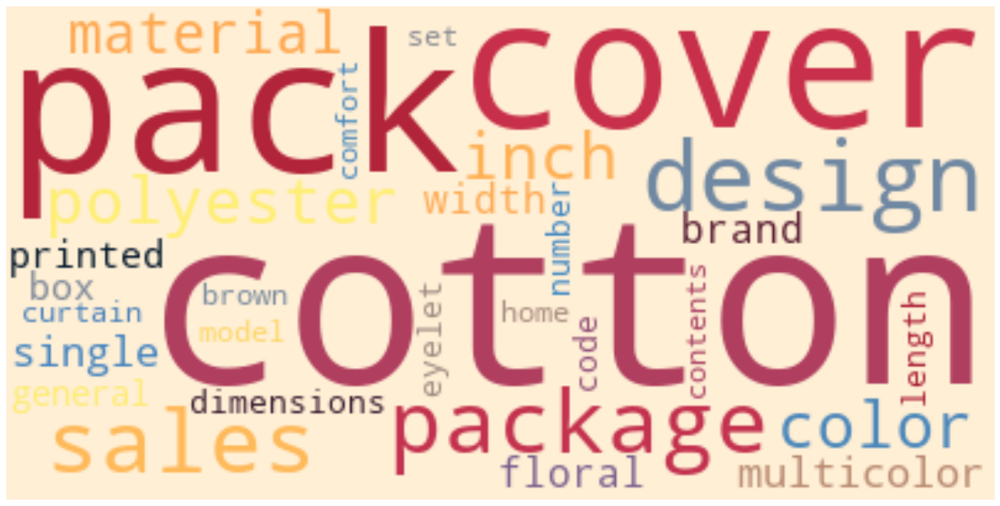

Mots les plus fréquents de la catégorie : Baby Care


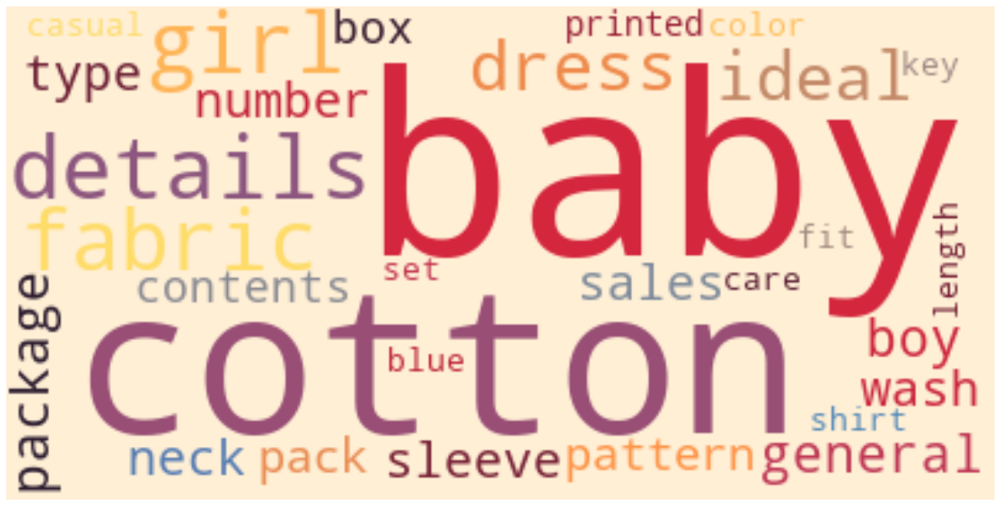

Mots les plus fréquents de la catégorie : Watches


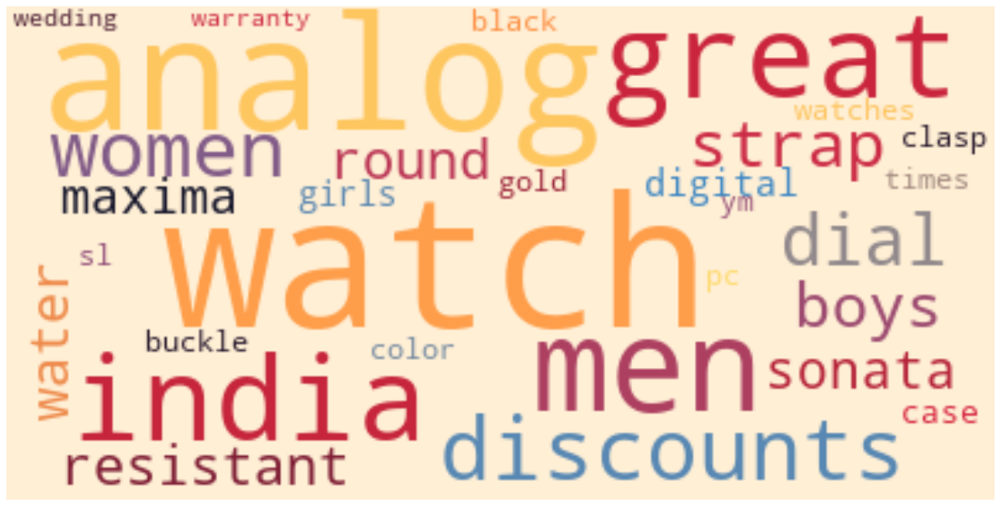

Mots les plus fréquents de la catégorie : Home Decor & Festive Needs


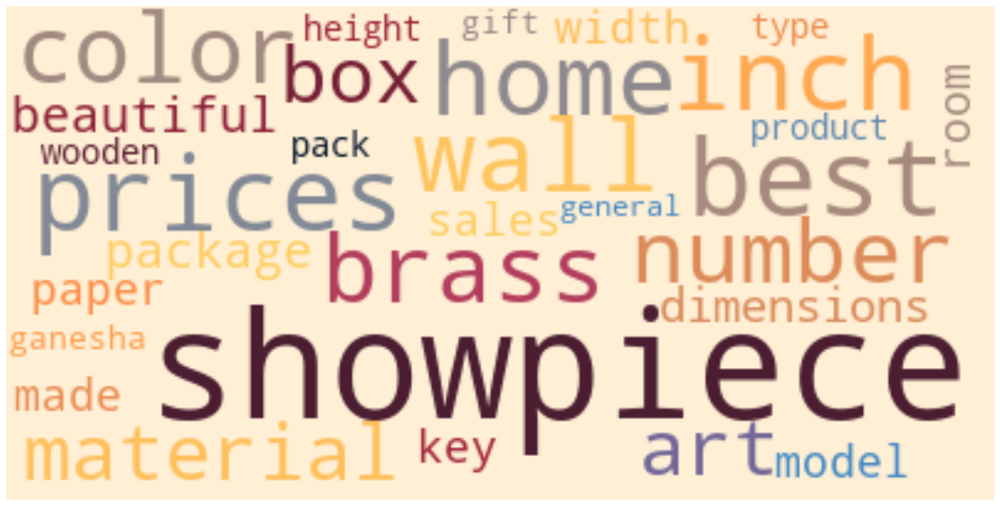

Mots les plus fréquents de la catégorie : Kitchen & Dining


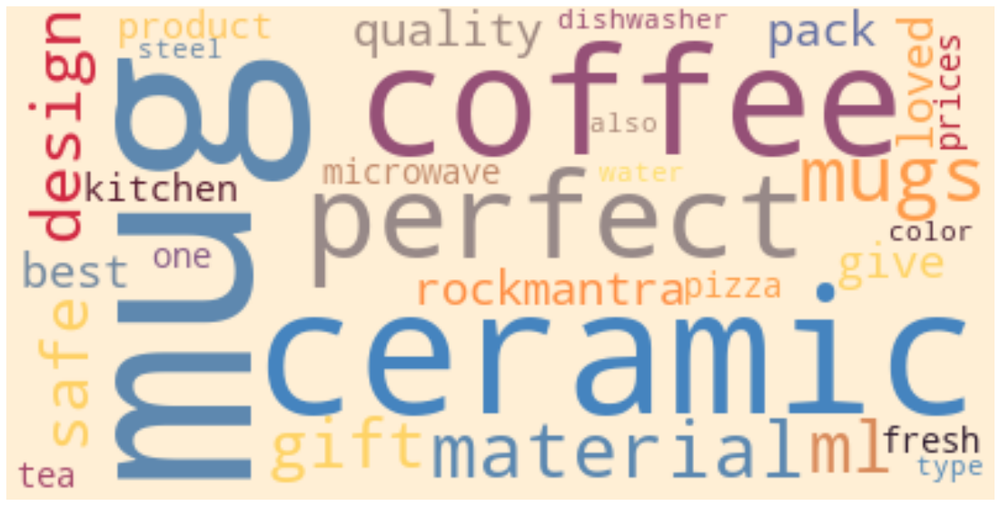

Mots les plus fréquents de la catégorie : Beauty and Personal Care


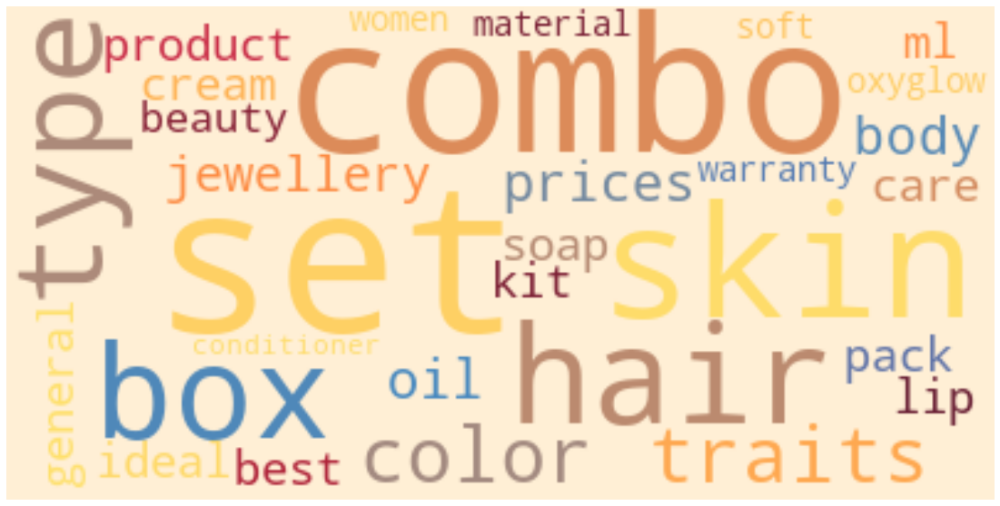

Mots les plus fréquents de la catégorie : Computers


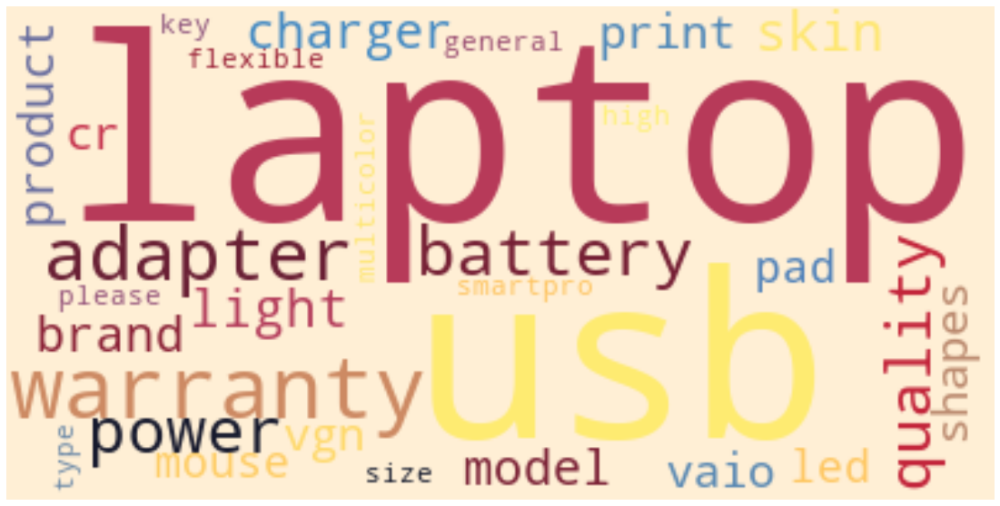

In [36]:
outils_visu.affiche_wordcloud_hue(data_work, 'description_clean',
                                  'Categorie_1', 30)

**Fréquence des 50 mots les plus fréquents dans la description des produits**

In [37]:
# Préparation du dataframe de travail
# ---------------------------------------------------------------------
# Fréquence de tous les mots de tous les produits dans la description
# nettoyée ?
texte = ''
sentence = ' '.join([texte + row for row in data_work['description_clean']])
tokens = nltk.word_tokenize(sentence)
fdist = FreqDist(tokens)
# Constitution du dataframe de travail
df_freq_clean = pd.DataFrame({'Mot': fdist.keys(),
                              'Frequence': fdist.values()}) \
                .sort_values(['Frequence'], ascending=False)
nb_tot = df_freq_clean['Frequence'].count()
df_freq_clean['%_frequence'] = \
    round((df_freq_clean['Frequence'])*100/nb_tot, 2)

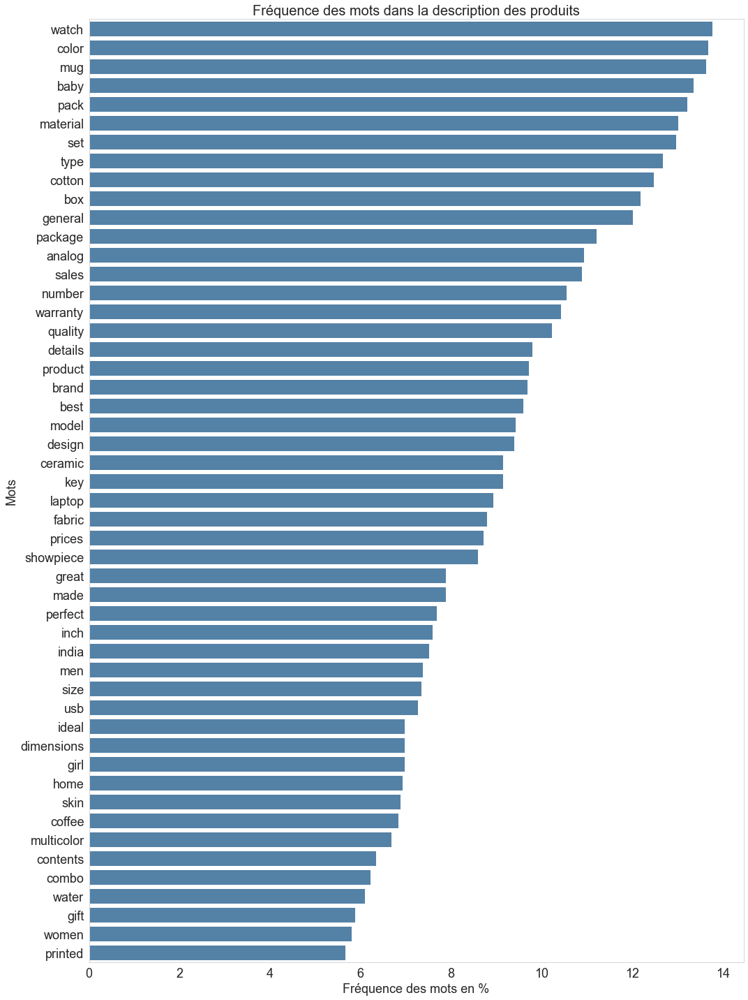

In [38]:
# Visualisation des 50 mots les plus fréquents dans description
# ---------------------------------------------------------------------
# Barplot de répartition
data_visu = df_freq_clean.head(50)
# Préparation de la liste des 50 mots les plus fréquents
liste_50_mots_desc = data_visu['Mot'].to_list()
sns.set_style("whitegrid")
plt.figure(figsize=(15, 20))
sns.barplot(x=data_visu['%_frequence'],
            y=data_visu['Mot'],
            data=data_visu,
            color='SteelBlue')
plt.title('Fréquence des mots dans la description des produits',
          fontsize=20)
plt.xlabel('Fréquence des mots en %', fontsize=18)
plt.ylabel('Mots', fontsize=18)
plt.xticks(fontsize=18)
plt.yticks(fontsize=18)
plt.grid(False)
plt.tight_layout()
plt.show()

**Fréquence des 50 mots les plus fréquents dans la description par catégorie**

In [39]:
%pycodestyle_off

In [40]:
# Préparation du dataframe de visualisation
# --------------------------------------------------------------------
df_freq_cat = pd.DataFrame({})
liste_categories = data_work['Categorie_1'].unique().tolist()
for cat in liste_categories :
    df_work=data_work[data_work['Categorie_1'] == cat]
    texte = ''
    sentence = ' '.join([texte + row for row \
                         in df_work['description_clean']])
    tokens = nltk.word_tokenize(sentence)
    fdist = FreqDist(tokens)
    df_freq_cat = df_freq_cat.append(pd.DataFrame({
            'Mot': fdist.keys(),
            'Frequence': fdist.values(),
            'Catégorie': cat
        }), ignore_index=True)

In [41]:
%pycodestyle_on

In [42]:
type(liste_50_mots_desc)

list

In [43]:
data_cat = df_freq_cat[df_freq_cat['Mot'].isin(liste_50_mots_desc)] \
    .sort_values(by=['Mot','Frequence'], ascending=[True,False])#.head(50)
data_cat

,Mot,Frequence,Catégorie
1470,analog,256,Watches
2590,analog,6,Home Decor & Festive Needs
697,baby,316,Baby Care
407,baby,2,Home Furnishing
2223,baby,1,Home Decor & Festive Needs
3985,baby,1,Beauty and Personal Care
2043,best,87,Home Decor & Festive Needs
3002,best,65,Kitchen & Dining
4666,best,27,Computers
3745,best,25,Beauty and Personal Care


2:27: E231 missing whitespace after ','
2:57: E231 missing whitespace after ','
2:65: E261 at least two spaces before inline comment
2:65: E262 inline comment should start with '# '


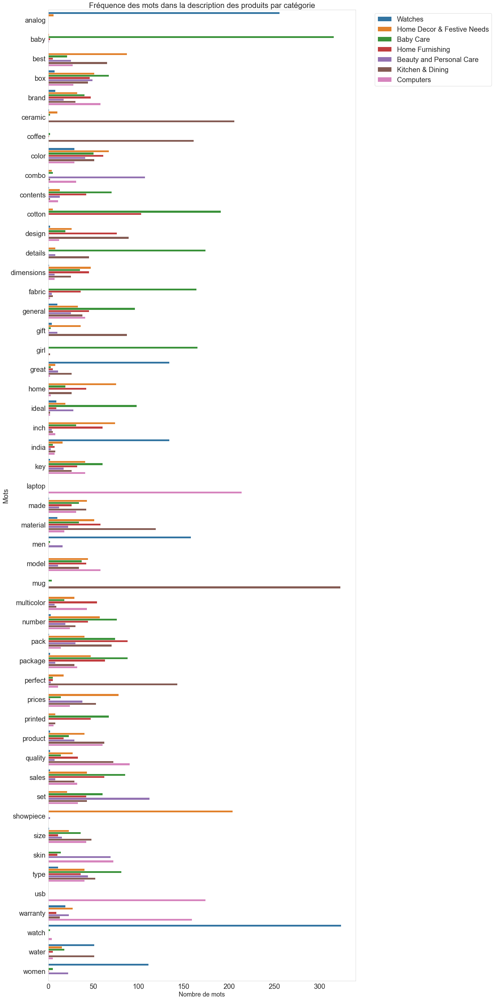

In [44]:
# Visualisation des 50 mots les plus fréquents dans description
# ---------------------------------------------------------------------
# Barplot de répartition
sns.set_style("whitegrid")
plt.figure(figsize=(20, 40))
sns.barplot(x=data_cat['Frequence'],
            y=data_cat['Mot'],
            hue=data_cat['Catégorie'],
            data=data_cat)
plt.title('Fréquence des mots dans la description des produits par catégorie',
          fontsize=22)
plt.xlabel('Nombre de mots', fontsize=18)
plt.ylabel('Mots', fontsize=20)
plt.xticks(fontsize=20)
plt.yticks(fontsize=20)
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, fontsize=20)
plt.grid(False)
plt.tight_layout()
plt.show()

### <span style='background:PowderBlue'>3.2. Groupement sémantique</span>

#### <span style='background:Moccasin'>3.2.1. Racinisation</span>

- La **racinisation**(ou **stemming** en anglais) consiste à ne conserver que la racine des mots étudiés. 
- L'idée étant de supprimer les suffixes, préfixes et autres des mots afin de ne conserver que leur origine. 
- C'est un procédé plus simple que la lemmatisation et plus rapide à effectuer puisqu'on tronque les mots essentiellement contrairement à la lemmatisation qui nécessite d'utiliser un dictionnaire.

**TextHero**
- texthero.preprocessing.stem utilise deux algorithmes de troncature NLTK connus sous le nom de nltk.stem.SnowballStemmer et nltk.stem.PorterStemmer. - SnowballStemmer doit être utilisé lorsque la série Pandas contient du texte non-anglais et qu'elle dispose d'un support multilangue.
- Comme le texte est anglais on choisira 'porter'.

[Source](https://texthero.org/docs/api/texthero.preprocessing.stem) 

In [20]:
# Racinisation
# ---------------------------------------------------------------------
# Exemple avec la variable description
data_work['description_clean_stem'] = hero.stem(data_work['description_clean'],
                                                stem='porter')
# Ajoute dans le dataframe témoin
df_temoin = \
    outils_nlp.suivre_modif_texte(df_temoin, 'Racinisation',
                                  data_work['description_clean_stem'][1046])

#### <span style='background:Moccasin'>3.2.2. Lemmatisation</span>

- Le processus de **lemmatisation** consiste à représenter les mots (ou lemmes) sous leur forme canonique pour ne conserver que le sens des mots utilisés dans le corpus.
- Par exemple pour un verbe, ce sera son infinitif, pour un nom, son masculin singulier. 

[Source](https://stackoverflow.com/questions/47557563/lemmatization-of-all-pandas-cells)

In [21]:
# Lemmatisation
# ---------------------------------------------------------------------
w_tokenizer = nltk.tokenize.WhitespaceTokenizer()
lemmatizer = nltk.stem.WordNetLemmatizer()
data_work['description_clean_lemma'] = \
    [[lemmatizer.lemmatize(w) for w in w_tokenizer.tokenize(text)]
     for text in data_work['description_clean']]
# Transformer liste en string
data_work['description_clean_lemma'] = \
    data_work['description_clean_lemma'].apply(lambda x: ' '.join(x))
# Ajoute dans le dataframe témoin
df_temoin = \
    outils_nlp.suivre_modif_texte(df_temoin, 'Lemmatisation',
                                  data_work['description_clean_lemma'][1046])

### <span style='background:PowderBlue'>3.3. Visualisation des différentes transformations</span>

In [22]:
df_temoin.style.hide_index()

Action,Contenu
Texte original,"Wallmantra Large Vinyl Sticker Sticker (Pack of 1) Price: Rs. 1,896 Bring home this exclusive Piece of Wall Art to give your home a refreshing look it deserves ! Wall Decals are the latest trend, sweeping the world of interior design, as a quick and easy way to personalise and transform your home. We at Wallmantra use only the highest quality premium self-adhesive vinyl for our products to ensure you receive the best quality product. The sizes are in inches (Width x Height), rounded to the nearest inch. The size of the product is the final size that will be up on the walls . These are very easy to apply and remove. You can apply these yourself. We send ready to apply Decal/Sticker with 2 practice items with instruction manual. You can also see the how to apply video. These are not re-usable. Contact Wallmantra for more options Bring home this exclusive Piece of Wall Art to give your home a refreshing look it deserves ! Wall Decals are the latest trend, sweeping the world of interior design, as a quick and easy way to personalise and transform your home. We at Wallmantra use only the highest quality premium self-adhesive vinyl for our products to ensure you receive the best quality product. The sizes are in inches (Width x Height), rounded to the nearest inch. The size of the product is the final size that will be up on the walls . These are very easy to apply and remove. You can apply these yourself. We send ready to apply Decal/Sticker with 2 practice items with instruction manual. You can also see the how to apply video. These are not re-usable. Contact Wallmantra for more options"
Tokenisation,"['Wallmantra', 'Large', 'Vinyl', 'Sticker', 'Sticker', '(', 'Pack', 'of', '1', ')', 'Price', ':', 'Rs', '.', '1,896', 'Bring', 'home', 'this', 'exclusive', 'Piece', 'of', 'Wall', 'Art', 'to', 'give', 'your', 'home', 'a', 'refreshing', 'look', 'it', 'deserves', '!', 'Wall', 'Decals', 'are', 'the', 'latest', 'trend', ',', 'sweeping', 'the', 'world', 'of', 'interior', 'design', ',', 'as', 'a', 'quick', 'and', 'easy', 'way', 'to', 'personalise', 'and', 'transform', 'your', 'home', '.', 'We', 'at', 'Wallmantra', 'use', 'only', 'the', 'highest', 'quality', 'premium', 'self-adhesive', 'vinyl', 'for', 'our', 'products', 'to', 'ensure', 'you', 'receive', 'the', 'best', 'quality', 'product', '.', 'The', 'sizes', 'are', 'in', 'inches', '(', 'Width', 'x', 'Height', ')', ',', 'rounded', 'to', 'the', 'nearest', 'inch', '.', 'The', 'size', 'of', 'the', 'product', 'is', 'the', 'final', 'size', 'that', 'will', 'be', 'up', 'on', 'the', 'walls', '.', 'These', 'are', 'very', 'easy', 'to', 'apply', 'and', 'remove', '.', 'You', 'can', 'apply', 'these', 'yourself', '.', 'We', 'send', 'ready', 'to', 'apply', 'Decal/Sticker', 'with', '2', 'practice', 'items', 'with', 'instruction', 'manual', '.', 'You', 'can', 'also', 'see', 'the', 'how', 'to', 'apply', 'video', '.', 'These', 'are', 'not', 're-usable', '.', 'Contact', 'Wallmantra', 'for', 'more', 'options', 'Bring', 'home', 'this', 'exclusive', 'Piece', 'of', 'Wall', 'Art', 'to', 'give', 'your', 'home', 'a', 'refreshing', 'look', 'it', 'deserves', '!', 'Wall', 'Decals', 'are', 'the', 'latest', 'trend', ',', 'sweeping', 'the', 'world', 'of', 'interior', 'design', ',', 'as', 'a', 'quick', 'and', 'easy', 'way', 'to', 'personalise', 'and', 'transform', 'your', 'home', '.', 'We', 'at', 'Wallmantra', 'use', 'only', 'the', 'highest', 'quality', 'premium', 'self-adhesive', 'vinyl', 'for', 'our', 'products', 'to', 'ensure', 'you', 'receive', 'the', 'best', 'quality', 'product', '.', 'The', 'sizes', 'are', 'in', 'inches', '(', 'Width', 'x', 'Height', ')', ',', 'rounded', 'to', 'the', 'nearest', 'inch', '.', 'The', 'size', 'of', 'the', 'product', 'is', 'the', 'final', 'size', 'that', 'will', 'be', 'up', 'on', 'the', 'walls', '.', 'These', 'are', 'very', 'easy', 'to', 'apply', 'and', 'remove', '.', 'You', 'can', 'apply', 'these', 'yourself', '.', 'We', 'send', 'ready', 'to', 'apply', 'Deca

### <span style='background:PowderBlue'>3.4. Pré-traitement global</span>

#### <span style='background:Moccasin'>3.4.1. Pré-traitement - product_name</span>

**product_name** : nom du produit

In [23]:
# Pré-traitement tokenisation, normalisation, stopwords
outils_nlp.pretraiter_texte(data_work, 'product_name',
                            'product_name_clean', [])
# Racinisation
outils_nlp.raciniser_texte(data_work, 'product_name_clean',
                           'product_name_stem')
# Lemmatisation
outils_nlp.lemmatiser_texte(data_work, 'product_name_clean',
                            'product_name_lemma')

In [49]:
data_work[['product_name_clean', 'product_name_stem',
           'product_name_lemma']].head(5)

,product_name_clean,product_name_stem,product_name_lemma
0,elegance polyester multicolor abstract eyelet door curtain,eleg polyest multicolor abstract eyelet door curtain,elegance polyester multicolor abstract eyelet door curtain
1,sathiyas cotton bath towel,sathiya cotton bath towel,sathiyas cotton bath towel
2,eurospa cotton terry face towel set,eurospa cotton terri face towel set,eurospa cotton terry face towel set
3,santosh royal fashion cotton printed king sized double bedsheet,santosh royal fashion cotton print king size doubl bedsheet,santosh royal fashion cotton printed king sized double bedsheet
4,jaipur print cotton floral king sized double bedsheet,jaipur print cotton floral king size doubl bedsheet,jaipur print cotton floral king sized double bedsheet


In [50]:
data_work['product_name_clean'].nunique()

988

- 'product_name' est une clé unique mais plus une fois pré-traitée.

#### <span style='background:Moccasin'>3.4.2. Pré-traitement - product_specifications</span>

**product_specifications** : spécifications du produit

**Tokenisation, normalisation, stopwords**

In [24]:
# Pré-traitement tokenisation, normalisation, stopwords
data_work['product_specifications_clean'] = \
    [json.dumps(row) for row in data_work['product_specifications']]
outils_nlp.pretraiter_texte(data_work, 'product_specifications_clean',
                            'product_specifications_clean',
                            ['key', 'value'])

**Mots trop fréquents ou trop rares**

In [25]:
# Fréquence de tous les mots de tous les produits dans la description?
texte_1 = ''
sentence_1 = ' '.join([texte_1 + row for row in
                       data_work['product_specifications_clean']])
tokens_1 = nltk.word_tokenize(sentence_1)
fdist_1 = FreqDist(tokens_1)
# Constitution du dataframe de travail
df_frequence_mot_1 = pd.DataFrame({'Mot': fdist_1.keys(),
                                   'Frequence': fdist_1.values()}) \
                     .sort_values(['Frequence'], ascending=False)
nb_tot_1 = df_frequence_mot_1['Frequence'].count()
df_frequence_mot_1['%_frequence'] = \
    round((df_frequence_mot_1['Frequence'])*100/nb_tot_1, 2)

In [53]:
# Mots très fréquents?
df_frequence_mot_1[df_frequence_mot_1['%_frequence'] > 5]

,Mot,Frequence,%_frequence
0,product,1244,33.56
6,type,1160,31.29
1,specification,1049,28.30
16,color,864,23.31
8,model,837,22.58
23,package,810,21.85
22,sales,808,21.80
20,number,806,21.74
26,material,800,21.58
19,cm,780,21.04


- On ajoutera à la liste des mots à supprimer les mots les plus fréquents qui sont assez généralistes et n'apportent aucune information  ==> représentés plus de 280 fois.

In [54]:
# Mots très rares?
df_frequence_mot_1[df_frequence_mot_1['Frequence'] < 3]

,Mot,Frequence,%_frequence
1970,passion,2,0.05
1802,keeps,2,0.05
1917,less,2,0.05
1815,routers,2,0.05
1870,four,2,0.05
...,...,...,...
2488,branches,1,0.03
1100,openings,1,0.03
1107,patterns,1,0.03
2483,stem,1,0.03


- On ajoutera à la liste des mots à supprimer les mots les plus rares qui sont trop singuliers pour apporter une information.

In [26]:
# Ajout des mots très fréquents
custom_words_manuel_1 = set(df_frequence_mot_1[df_frequence_mot_1['Frequence']
                                               >= 280]['Mot'].to_list())
# Ajout des mots rares
custom_words_manuel_1 = \
    custom_words_manuel_1.union(df_frequence_mot_1[df_frequence_mot_1
                                                   ['Frequence']
                                                   < 3]['Mot'].to_list())
# Supprimer les stop_words anglais définis dans les 3 librairies
data_work['product_specifications_clean'] = \
    hero.remove_stopwords(data_work['product_specifications_clean'],
                          custom_words_manuel_1)
# Supprime les espaces blancs
data_work['product_specifications_clean'] = \
    hero.remove_whitespace(data_work['product_specifications_clean'])
# Supprime les espaces blancs
data_work['product_specifications_clean'] = \
    data_work['product_specifications_clean'].replace(r'  ', ' ',
                                                      regex=True)
data_work['product_specifications_clean'] = \
    [row.rstrip() for row in data_work['product_specifications_clean']]
data_work['product_specifications_clean'] = \
    [row.lstrip() for row in data_work['product_specifications_clean']]

**Wordclouds**

Visualisation des mots les plus fréquents pour chacune des 7 catégories après le pré-traitement de la variable 'description'.

Mots les plus fréquents de la catégorie : Home Furnishing


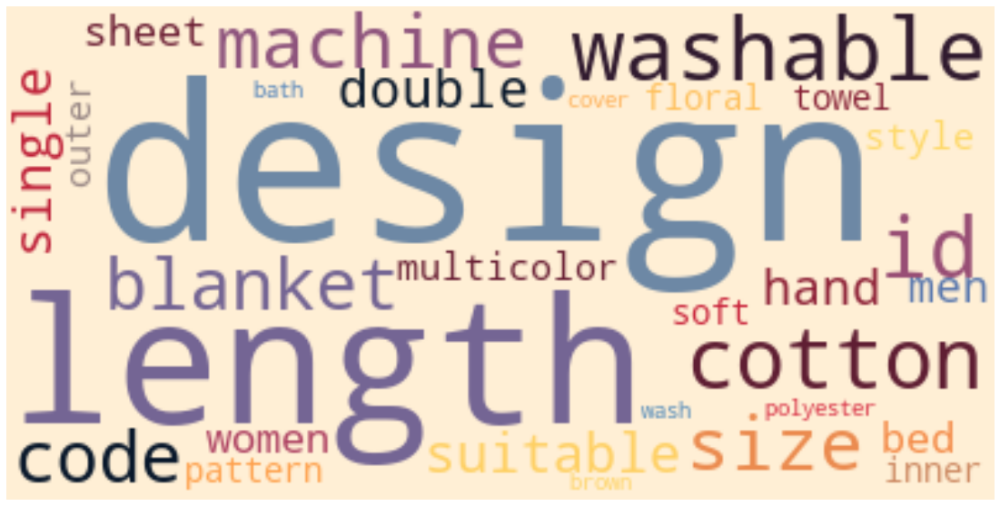

Mots les plus fréquents de la catégorie : Baby Care


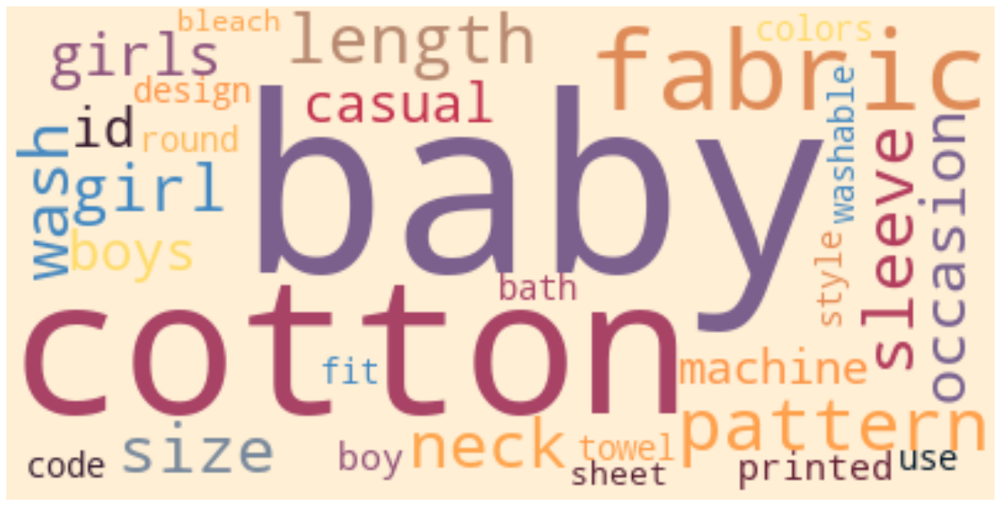

Mots les plus fréquents de la catégorie : Watches


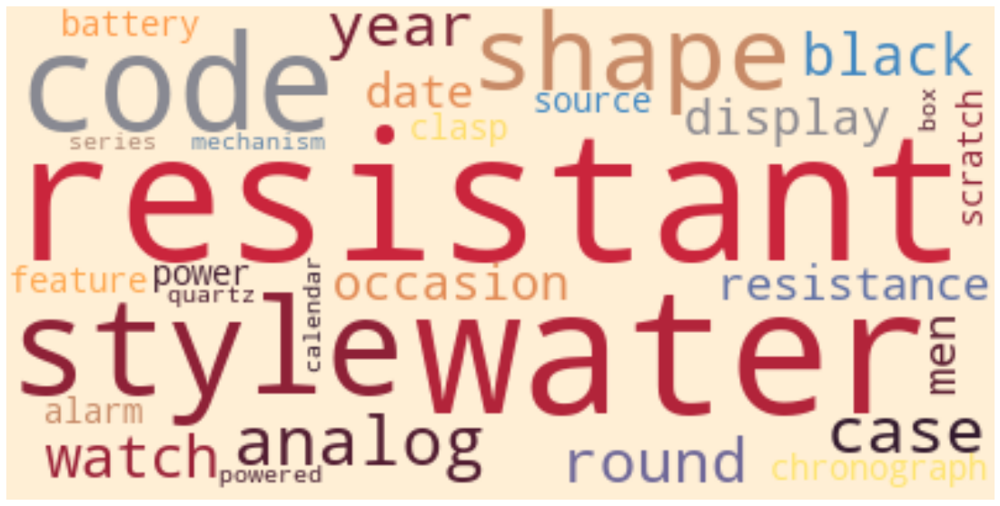

Mots les plus fréquents de la catégorie : Home Decor & Festive Needs


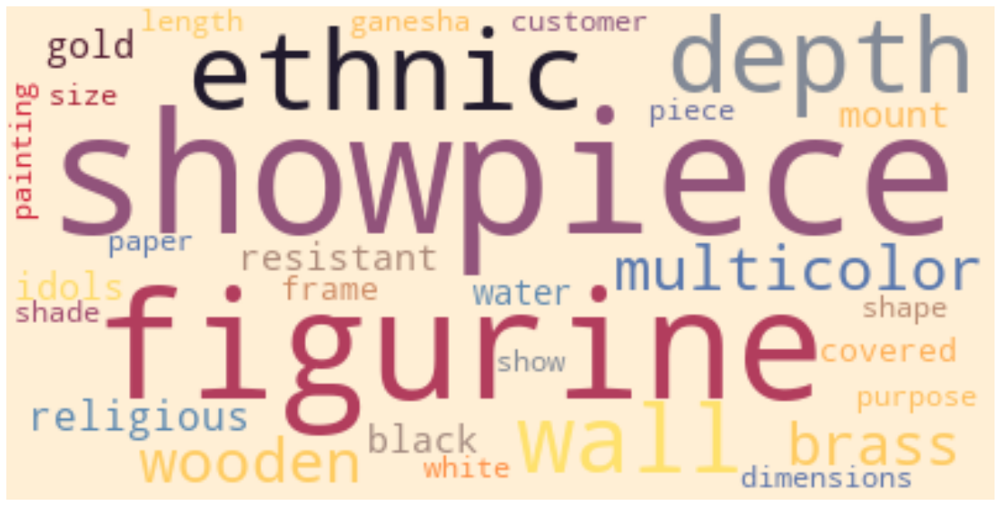

Mots les plus fréquents de la catégorie : Kitchen & Dining


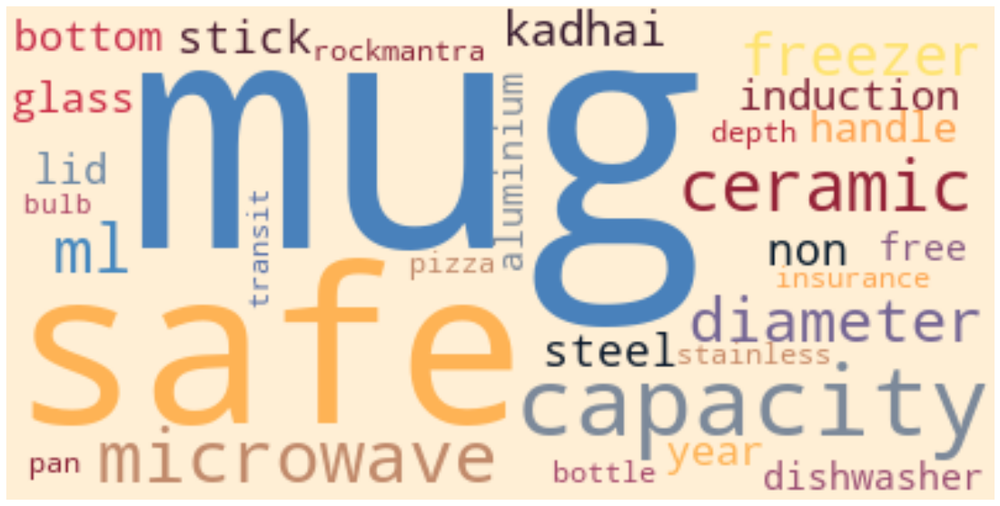

Mots les plus fréquents de la catégorie : Beauty and Personal Care


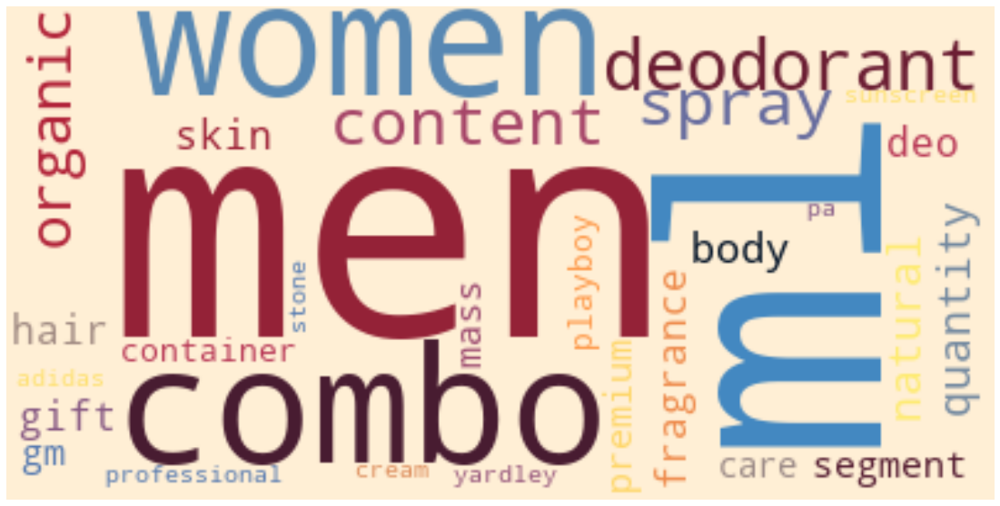

Mots les plus fréquents de la catégorie : Computers


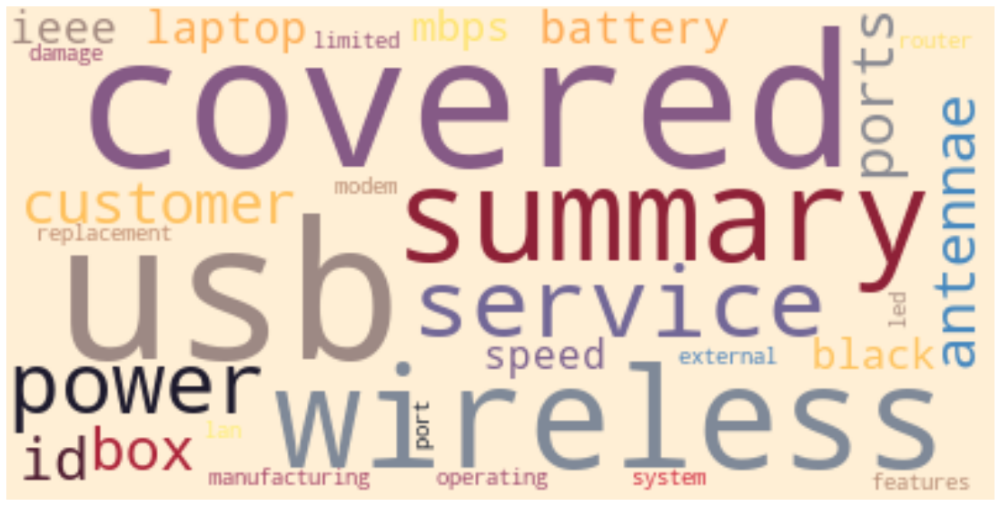

In [56]:
outils_visu.affiche_wordcloud_hue(data_work, 'product_specifications_clean',
                                  'Categorie_1', 30)

In [27]:
# Racinisation
outils_nlp.raciniser_texte(data_work, 'product_specifications_clean',
                           'product_specifications_stem')
# Lemmatisation
outils_nlp.lemmatiser_texte(data_work, 'product_specifications_clean',
                            'product_specifications_lemma')

In [58]:
data_work[['product_specifications', 'product_specifications_clean',
           'product_specifications_stem', 'product_specifications_lemma']] \
    .head(3)

,product_specifications,product_specifications_clean,product_specifications_stem,product_specifications_lemma
0,"{""product_specification""=>[{""key""=>""Brand"", ""value""=>""Elegance""}, {""key""=>""Designed For"", ""value""=>""Door""}, {""key""=>""Type"", ""value""=>""Eyelet""}, {""key""=>""Model Name"", ""value""=>""Abstract Polyester Door Curtain Set Of 2""}, {""key""=>""Model ID"", ""value""=>""Duster25""}, {""key""=>""Color"", ""value""=>""Multicolor""}, {""key""=>""Length"", ""value""=>""213 cm""}, {""key""=>""Number of Contents in Sales Package"", ""value""=>""Pack of 2""}, {""key""=>""Sales Package"", ""value""=>""2 Curtains""}, {""key""=>""Material"", ""value""=>""Polyester""}]}",elegance designed door eyelet abstract polyester door curtain id multicolor length curtains polyester,eleg design door eyelet abstract polyest door curtain id multicolor length curtain polyest,elegance designed door eyelet abstract polyester door curtain id multicolor length curtain polyester
1,"{""product_specification""=>[{""key""=>""Machine Washable"", ""value""=>""Yes""}, {""key""=>""Material"", ""value""=>""Cotton""}, {""key""=>""Design"", ""value""=>""Self Design""}, {""key""=>""Brand"", ""value""=>""Sathiyas""}, {""key""=>""Type"", ""value""=>""Bath Towel""}, {""key""=>""GSM"", ""value""=>""500""}, {""key""=>""Model Name"", ""value""=>""Sathiyas cotton bath towel""}, {""key""=>""Ideal For"", ""value""=>""Men, Women, Boys, Girls""}, {""key""=>""Model ID"", ""value""=>""asvtwl322""}, {""key""=>""Color"", ""value""=>""Red, Yellow, Blue""}, {""key""=>""Size"", ""value""=>""Mediam""}, {""key""=>""Length"", ""value""=>""30 inch""}, {""key""=>""Width"", ""value""=>""60 inch""}, {""key""=>""Number of Contents in Sales Package"", ""value""=>""3""}, {""key""=>""Sales Package"", ""value""=>""3 Bath Towel""}]}",machine washable cotton design self design bath towel gsm cotton bath towel men women boys girls id red yellow blue size length bath towel,machin washabl cotton design self design bath towel gsm cotton bath towel men women boy girl id red yellow blue size length bath towel,machine washable cotton design self design bath towel gsm cotton bath towel men woman boy girl id red yellow blue size length bath towel
2,"{""product_specification""=>[{""key""=>""Material"", ""value""=>""Cotton Terry""}, {""key""=>""Design"", ""value""=>""SHUVAM""}, {""key""=>""Brand"", ""value""=>""Eurospa""}, {""key""=>""GSM"", ""value""=>""360""}, {""key""=>""Type"", ""value""=>""Face Towel Set""}, {""key""=>""Model Name"", ""value""=>""SHUVAM20PCFTSETASSORTED""}, {""key""=>""Ideal For"", ""value""=>""Boys, Girls, Men, Women""}, {""key""=>""Model ID"", ""value""=>""SHUVAM20PCFTSETASSORTED""}, {""key""=>""Size"", ""value""=>""small""}, {""key""=>""Color"", ""value""=>""Assorted""}, {""key""=>""Weight"", ""value""=>""350 g""}, {""key""=>""Length"", ""value""=>""9 inch""}, {""key""=>""Width"", ""value""=>""9 inch""}, {""key""=>""Number of Contents in Sales Package"", ""value""=>""20""}, {""key""=>""Sales Package"", ""value""=>""20 PIECE FACE TOWEL SET""}]}",cotton terry design shuvam gsm face towel shuvam boys girls men women id shuvam size small assorted length piece face towel,cotton terri design shuvam gsm face towel shuvam boy girl men women id shuvam size small assort length piec face towel,cotton terry design shuvam gsm face towel shuvam boy girl men woman id shuvam size small assorted length piece face towel


#### <span style='background:Moccasin'>3.4.3. Pré-traitement - brand</span>

**brand** : marque du produit

In [28]:
# Pré-traitement tokenisation, normalisation, stopwords
outils_nlp.pretraiter_texte(data_work, 'brand',
                            'brand_clean', [])
# Racinisation
outils_nlp.raciniser_texte(data_work, 'brand_clean',
                           'brand_stem')
# Lemmatisation
outils_nlp.lemmatiser_texte(data_work, 'brand_clean',
                            'brand_lemma')

In [204]:
data_work[['brand_clean', 'brand_stem',
           'brand_lemma']].head(5)

,brand_clean,brand_stem,brand_lemma
0,elegance,eleg,elegance
1,sathiyas,sathiya,sathiyas
2,eurospa,eurospa,eurospa
3,santosh royal fashion,santosh royal fashion,santosh royal fashion
4,jaipur print,jaipur print,jaipur print


## <span style='background:Thistle'>4. Feature extraction - Words embeddings</span>

- L’hypothèse de distribution en linguistique est dérivée de la théorie sémantique de l'usage de la langue, c'est-à-dire que les mots utilisés et utilisés dans les mêmes contextes ont tendance à avoir des significations similaires.
- Le word embedding repose sur une découverte : la régularité de certains rapports qui permettent de jouer le sens par un calcul vectoriel.
- Le monde du machine learning apporte une innovation remarquable : la **vectorisation**. 
- Le principe est simple. À partir de la matrice termes-document, on peut aisément construire des tables de corrélations entre les termes. L’idée est de représenter ces corrélations le plus précisément possible pour garder toute l'information dans un espace de dimension arbitrairement grande. L’idée est moins de réduire que de conserver l’information et le choix est de représenter chaque terme dans un espace de 100 à 1000 dimensions.
- L'astuce est le sac de mot (bag of words). Un petit ou un grand ? Considère-t-on que deux termes sont similaires s’ils font partie d’un paquet de 5 mots ou de 40 mots ? C’est bien plus qu’une astuce, cela devient le paramètre de l’analyse, favoriser de petits sacs, c’est chercher les termes qui sont directement associés, de plus grands sacs permettent de mieux prendre en compte le contexte des termes. Le paramètre de la taille du sac traduit la stratégie de recherche : les compléments ou les contextes.
- Le words embeddings constitue les techniques traditionnelles et anciennes du NLP.

### <span style='background:PowderBlue'>4.1. BOW - Bags of words - CountVectorizer</span>

***Note*** :
***
- CountVectorizer convertit une collection de documents texte en une matrice de comptage de tokens : les occurrences des tokens dans chaque document. 
- Cette implémentation produit une représentation éparse, creuse du nombre de tokens.
- La fonction "count vectorizer" de la librairie scikit-learn de Python, fournit un index à chaque mot et génère un vecteur qui contient le nombre d'apparitions de chaque mot dans un morceau de texte.
- fit permet d'apprendre le vocabulaire d'un ensemble de textes.
- transform permet la transformation en un cadre de données pouvant être utilisé pour construire des modèles de machine learning.

**Hyperparamètres** :
- **stop_words** : Étant donné que CountVectorizer ne compte que les occurrences de chaque mot de son vocabulaire, des mots extrêmement courants comme " le ", " et ", etc. deviendront des caractéristiques très importantes alors qu'ils ajoutent peu de sens au texte. Votre modèle peut souvent être amélioré si vous ne tenez pas compte de ces mots. Les mots d'arrêt sont simplement une liste de mots que vous ne voulez pas utiliser comme caractéristiques. Vous pouvez définir le paramètre stop_words='english' pour utiliser une liste intégrée. Vous pouvez également définir stop_words comme une liste personnalisée. Ce paramètre a la valeur par défaut None.
- **ngram_range** : Un n-gram est juste une chaîne de n mots à la suite. Par exemple, la phrase 'I am Groot' contient les 2-grammes 'I am' et 'am Groot'. La phrase est elle-même un 3-gramme. Définissez le paramètre ngram_range=(a,b) où a est la taille minimale et b est la taille maximale des ngrams que vous voulez inclure dans vos caractéristiques. La plage ngram_range par défaut est (1,1).
- **min_df**, **max_df** : Ce sont les fréquences minimales et maximales des documents que les mots/n-grammes doivent avoir pour être utilisés comme caractéristiques. Si l'un ou l'autre de ces paramètres est défini comme un nombre entier, il sera utilisé comme limite au nombre de documents dans lesquels chaque caractéristique doit se trouver pour être considérée comme une caractéristique. Si l'un ou l'autre est défini comme un flottant, ce nombre sera interprété comme une fréquence plutôt qu'une limite numérique. min_df a la valeur 1 (int) par défaut et max_df a la valeur 1.0 (flottant) par défaut.
- **max_features** : Ce paramètre est assez explicite. Le CountVectorizer choisira les mots/caractéristiques qui apparaissent le plus fréquemment dans son vocabulaire et laissera tomber tout le reste.

Comme nous avons normalisé, nettoyé, supprimé les stopwords, les mots les plus fréquents et les mots les plus rares et préparer les variables lemmatisées et racinisées, nous utiliserons le constructeur par défaut sur les variables 'description' et 'produit_specification' lemmatisées ou racinisées.

**description** - lemmatisée

In [29]:
# Variable dont on veut extraire les features
desc_lem_data = data_work['description_clean_lemma']

In [30]:
# Instanciation
countvectorizer_desc_lem = CountVectorizer()
# Tokenisation et création du vocabulaire
countvectorizer_desc_lem.fit(desc_lem_data)
# Résumé du vocabulaire
# print(desc_lem_vectorizer.get_feature_names()[0:10])
# print(desc_lem_vectorizer.vocabulary_)
# Encodage/Vectorisation
vector_countvectorizer_desc_lem = \
    countvectorizer_desc_lem.transform(desc_lem_data)
# Résumé de la vectorisation
print(vector_countvectorizer_desc_lem.shape)
# print(type(vector_desc_lem_vectorizer))
# Dataframe pour réduction de dimension
X_vector_cv_desc_lem = vector_countvectorizer_desc_lem.toarray()
df_countvectorizer_desc_lem = pd.DataFrame(X_vector_cv_desc_lem)

(1050, 2204)


In [84]:
# Matrice BOW de CountVectorizer description lemmatisée
df_bow_count_vect_desc_lemma = pd.DataFrame(X_vector_cv_desc_lem,
                                            columns=countvectorizer_desc_lem
                                            .get_feature_names())
df_bow_count_vect_desc_lemma['Categorie'] = data_work['Categorie_1']
print(df_bow_count_vect_desc_lemma.shape)
# df_bow_count_vect_desc_lemma

(1050, 2205)


**description** - stemmatisée

In [31]:
# Variable dont on veut extraire les features
desc_stem_data = data_work['description_clean_stem']

In [32]:
# Instanciation
countvectorizer_desc_stem = CountVectorizer()
# Tokenisation et création du vocabulaire
countvectorizer_desc_stem.fit(desc_stem_data)
# Encodage/Vectorisation
vector_countvectorizer_desc_stem = \
    countvectorizer_desc_stem.transform(desc_stem_data)
# Résumé de la vectorisation
print(vector_countvectorizer_desc_stem.shape)
# Dataframe pour réduction de dimension
X_vector_cv_desc_stem = vector_countvectorizer_desc_stem.toarray()
df_countvectorizer_desc_stem = pd.DataFrame(X_vector_cv_desc_stem)

(1050, 1999)


**produit_specification** - lemmatisée

In [33]:
# Variable dont on veut extraire les features
prod_lem_data = data_work['product_specifications_lemma']

In [34]:
# Instanciation
countvectorizer_prod_lem = CountVectorizer()
# Tokenisation et création du vocabulaire
countvectorizer_prod_lem.fit(prod_lem_data)
# Encodage/Vectorisation
vector_countvectorizer_prod_lem = \
    countvectorizer_prod_lem.transform(prod_lem_data)
# Résumé de la vectorisation
print(vector_countvectorizer_prod_lem.shape)
# Dataframe pour réduction de dimension
X_vector_cv_prod_lem = vector_countvectorizer_prod_lem.toarray()
df_countvectorizer_prod_lem = pd.DataFrame(X_vector_cv_prod_lem)

(1050, 1259)


**produit_specification** - stemmatisée

In [35]:
# Variable dont on veut extraire les features
prod_stem_data = data_work['product_specifications_stem']

In [36]:
# Instanciation
countvectorizer_prod_stem = CountVectorizer()
# Tokenisation et création du vocabulaire
countvectorizer_prod_stem.fit(prod_stem_data)
# Encodage/Vectorisation
vector_countvectorizer_prod_stem = \
    countvectorizer_prod_stem.transform(prod_stem_data)
# Résumé de la vectorisation
print(vector_countvectorizer_prod_stem.shape)
# Dataframe pour réduction de dimension
X_vector_cv_prod_stem = vector_countvectorizer_prod_stem.toarray()
df_countvectorizer_prod_stem = pd.DataFrame(X_vector_cv_prod_stem)

(1050, 1195)


### <span style='background:PowderBlue'>4.2. BOW - TfidfVectorizer</span>

- Une transformation tf-idf (term frequency-inverse document frequency), permet de pondérer les fréquences d’apparition des termes par leur nombre d’occurrences dans l’ensemble des documents.
- La pondération tf-idf permet de contrebalancer l’importance d’un mot utilisé très fréquemment dans tous les documents du corpus par rapport aux termes plus spécifiques à certains documents. 
- TF-IDF est un produit de deux parties :
    - TF (Term Frequency) - Elle est définie comme le nombre de fois qu'un mot apparaît dans une phrase donnée.
    - IDF (Inverse Document Frequency) - Il est défini comme le logarithme à la base e du nombre total de documents divisé par les documents dans lesquels le mot apparaît.
    - Une mesure possible est la suivante (Jones 1973) :
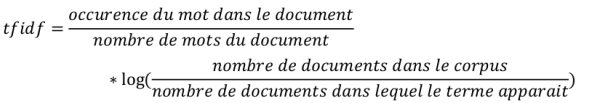
- Cette transformation permet de produire des premiers éléments d’analyses, au premier titre duquel apparaissent les nuages de mots (wordcloud) qui représentent la fréquence relative des termes et qui donnent une première idée des significations contenues dans le corpus.

[Source](https://hal.archives-ouvertes.fr/hal-02400308/document)

Comme nous avons normalisé, nettoyé, supprimé les stopwords, les mots les plus fréquents et les mots les plus rares et préparer les variables lemmatisées et racinisées, nous utiliserons le constructeur par défaut sur les variables 'description' et 'produit_specification' lemmatisées ou racinisées.

**description** - lemmatisée

In [37]:
# Instanciation
tfidfvectorizer_desc_lem = TfidfVectorizer()
# Tokenisation et création du vocabulaire
tfidfvectorizer_desc_lem.fit(desc_lem_data)
# Encodage/Vectorisation
vector_tfidfvectorizer_desc_lem = \
    tfidfvectorizer_desc_lem.transform(desc_lem_data)
# Résumé de la vectorisation
print(vector_tfidfvectorizer_desc_lem.shape)
# Dataframe pour réduction de dimension
X_vector_tfidf_desc_lem = vector_tfidfvectorizer_desc_lem.toarray()
df_tfidfvectorizer_desc_lem = pd.DataFrame(X_vector_tfidf_desc_lem)

(1050, 2204)


In [69]:
# Matrice BOW de tfIdfVectorizer description lemmatisée
df_bow_tfidf_vect_desc_lemma = pd.DataFrame(vector_tfidfvectorizer_desc_lem
                                            .todense(),
                                            columns=tfidfvectorizer_desc_lem
                                            .get_feature_names())
df_bow_tfidf_vect_desc_lemma['Categorie'] = data_work['Categorie_1']
print(df_bow_tfidf_vect_desc_lemma.shape)
# df_bow_tfidf_vect_desc_lemma

(1050, 2205)


**description** - stemmatisée

In [38]:
# Instanciation
tfidfvectorizer_desc_stem = TfidfVectorizer()
# Tokenisation et création du vocabulaire
tfidfvectorizer_desc_stem.fit(desc_stem_data)
# Encodage/Vectorisation
vector_tfidfvectorizer_desc_stem = \
    tfidfvectorizer_desc_stem.transform(desc_stem_data)
# Résumé de la vectorisation
print(vector_tfidfvectorizer_desc_stem.shape)
# Dataframe pour réduction de dimension
X_vector_tfidf_desc_stem = vector_tfidfvectorizer_desc_stem.toarray()
df_tfidfvectorizer_desc_stem = pd.DataFrame(X_vector_tfidf_desc_stem)

(1050, 1999)


**produit_specification** - lemmatisée

In [39]:
# Instanciation
tfidfvectorizer_prod_lem = TfidfVectorizer()
# Tokenisation et création du vocabulaire
tfidfvectorizer_prod_lem.fit(prod_lem_data)
# Encodage/Vectorisation
vector_tfidfvectorizer_prod_lem = \
    tfidfvectorizer_prod_lem.transform(prod_lem_data)
# Résumé de la vectorisation
print(vector_tfidfvectorizer_prod_lem.shape)
# Dataframe pour réduction de dimension
X_vector_tfidf_prod_lem = vector_tfidfvectorizer_prod_lem.toarray()
df_tfidfvectorizer_prod_lem = pd.DataFrame(X_vector_tfidf_prod_lem)

(1050, 1259)


**produit_specification** - stemmatisée

In [40]:
# Instanciation
tfidfvectorizer_prod_stem = TfidfVectorizer()
# Tokenisation et création du vocabulaire
tfidfvectorizer_prod_stem.fit(prod_stem_data)
# Encodage/Vectorisation
vector_tfidfvectorizer_prod_stem = \
    tfidfvectorizer_prod_stem.transform(prod_stem_data)
# Résumé de la vectorisation
print(vector_tfidfvectorizer_prod_stem.shape)
# Dataframe pour réduction de dimension
X_vector_tfidf_prod_stem = vector_tfidfvectorizer_prod_stem.toarray()
df_tfidfvectorizer_prod_stem = pd.DataFrame(X_vector_tfidf_prod_stem)

(1050, 1195)


### <span style='background:PowderBlue'>4.3. BOW - Hashing Vectorizer</span>

- Il transforme une collection de documents textuels en une matrice scipy.sparse contenant le nombre d'occurrences de tokens (ou des informations sur les occurrences binaires), éventuellement normalisée en fréquences de tokens si norm='l1' ou projetée sur la sphère unitaire euclidienne si norm='l2'.
- Cette implémentation du vectoriseur de texte utilise l'astuce du hachage pour trouver la correspondance entre le nom de la chaîne de caractères et l'index entier de la caractéristique.
- La fonction de hachage utilisée est la version 32 bits signée de Murmurhash3.
- Algorithme : ce vectoriseur est très utile car il nous permet de convertir n'importe quel mot en son hash et ne nécessite pas la génération d'un quelconque vocabulaire.
    - Étape 1 : Définir la taille du vecteur à créer pour chaque phrase.
    - Étape 2 : Appliquer l'algorithme de hachage (comme MurmurHash) à la phrase.
    - Étape 3 : Répéter l'étape 2 pour toutes les phrases.

[Source_1](https://scikit-learn.org/stable/modules/generated/sklearn.feature_extraction.text.HashingVectorizer.html)
[Source_2](https://towardsdatascience.com/different-techniques-to-represent-words-as-vectors-word-embeddings-3e4b9ab7ceb4)

**description** - lemmatisée

In [41]:
# Instanciation
hashvectorizer_desc_lem = HashingVectorizer(norm=None, n_features=2204)
# Hash/Vectorisation
vector_hashvectorizer_desc_lem = \
    hashvectorizer_desc_lem.fit_transform(desc_lem_data)
# Résumé de la vectorisation
print(vector_hashvectorizer_desc_lem.shape)
# Dataframe pour réduction de dimension
X_vector_hash_desc_lem = vector_hashvectorizer_desc_lem.toarray()
df_hashvectorizer_desc_lem = pd.DataFrame(X_vector_hash_desc_lem)

(1050, 2204)


In [74]:
# Matrice BOW de HashingVectorizer description lemmatisée
df_bow_hash_vect_desc_lemma = pd.DataFrame(vector_hashvectorizer_desc_lem
                                           .toarray(),
                                           columns=tfidfvectorizer_desc_lem
                                           .get_feature_names())
df_bow_hash_vect_desc_lemma['Categorie'] = data_work['Categorie_1']
print(df_bow_hash_vect_desc_lemma.shape)
# df_bow_hash_vect_desc_lemma

(1050, 2205)


**description** - stemmatisée

In [42]:
# Instanciation
hashvectorizer_desc_stem = HashingVectorizer(norm=None, n_features=1999)
# Tokenisation et création du vocabulaire
hashvectorizer_desc_stem.fit(desc_stem_data)
# Hash/Vectorisation
vector_hashvectorizer_desc_stem = \
    hashvectorizer_desc_stem.transform(desc_stem_data)
# Résumé de la vectorisation
print(vector_hashvectorizer_desc_stem.shape)
# Dataframe pour réduction de dimension
X_vector_hash_desc_stem = vector_hashvectorizer_desc_stem.toarray()
df_hashvectorizer_desc_stem = pd.DataFrame(X_vector_hash_desc_stem)

(1050, 1999)


**produit_specification** - lemmatisée

In [43]:
# Instanciation
hashvectorizer_prod_lem = HashingVectorizer(norm=None, n_features=1259)
# Tokenisation et création du vocabulaire
hashvectorizer_prod_lem.fit(prod_lem_data)
# Hash/Vectorisation
vector_hashvectorizer_prod_lem = \
    hashvectorizer_prod_lem.transform(prod_lem_data)
# Résumé de la vectorisation
print(vector_hashvectorizer_prod_lem.shape)
# Dataframe pour réduction de dimension
X_vector_hash_prod_lem = vector_hashvectorizer_prod_lem.toarray()
df_hashvectorizer_prod_lem = pd.DataFrame(X_vector_hash_prod_lem)

(1050, 1259)


**produit_specification** - stemmatisée

In [44]:
# Instanciation
hashvectorizer_prod_stem = HashingVectorizer(norm=None, n_features=1195)
# Tokenisation et création du vocabulaire
hashvectorizer_prod_stem.fit(prod_stem_data)
# Hash/Vectorisation
vector_hashvectorizer_prod_stem = \
    hashvectorizer_prod_stem.transform(prod_stem_data)
# Résumé de la vectorisation
print(vector_hashvectorizer_prod_stem.shape)
# Dataframe pour réduction de dimension
X_vector_hash_prod_stem = vector_hashvectorizer_prod_stem.toarray()
df_hashvectorizer_prod_stem = pd.DataFrame(X_vector_hash_prod_stem)

(1050, 1195)


### <span style='background:PowderBlue'>4.4. Word2vec</span>

- Il s'agit d'un ensemble de modèles de réseaux de neurones développés par google qui ont pour but de représenter les mots dans l'espace vectoriel. 
- Ces modèles sont très efficaces et performants pour comprendre le contexte et la relation entre les mots. Les mots similaires sont placés près les uns des autres dans l'espace vectoriel, tandis que les mots dissemblables sont placés loin les uns des autres.
- Il existe deux modèles dans cette classe (un réseau de neurones à 3 couches : 1 couche d’entrée, 1 couche cachée, 1 couche de sortie) :
    - CBOW (Continuous Bag of Words) : Le réseau neuronal examine les mots environnants (disons 2 à gauche et 2 à droite) et prédit le mot qui se trouve entre les deux.
        - 1. La couche Embedding va transformer chaque mot du contexte en vecteur d’embedding. La matrice W de l’embedding sera apprise au fur et à mesure que le modèle s’entraîne. Les dimensions résultantes sont : (lot, context_size, embedding).
        - 2. Ensuite, la couche GlobalAveragePooling1D permet de sommer les différents embedding pour avoir une dimension en sortie (batch_size, embedding).
        - 3.Enfin, La couche Dense de taille « voc_size » permet de prédire le mot cible.
    - Skip-grams : Le réseau neuronal prend un mot et essaie ensuite de prédire les mots environnants.
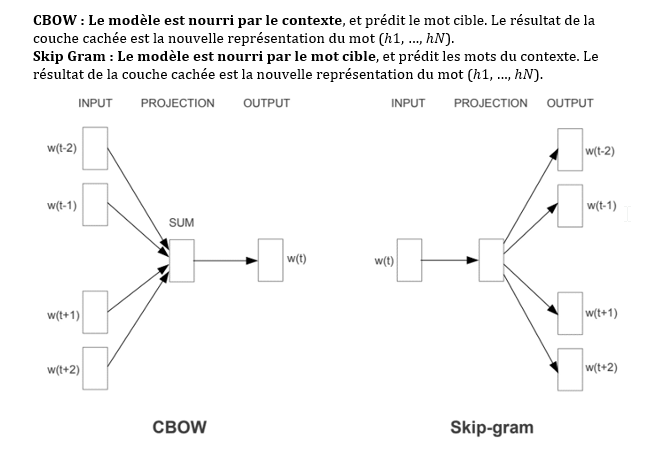    
- Le réseau neuronal possède une couche d'entrée, une couche cachée et une couche de sortie pour s'entraîner sur les données et construire les vecteurs. 

[Source](https://towardsdatascience.com/different-techniques-to-represent-words-as-vectors-word-embeddings-3e4b9ab7ceb4)

**Hyperparametres**
- **min_count** = int - Ignore tous les mots dont la fréquence absolue totale est inférieure à cette valeur - (2, 100)
- **window** = int - La distance maximale entre le mot actuel et le mot prédit dans une phrase. Par exemple, les mots fenêtre à gauche et les mots fenêtre à gauche de notre cible - (2, 10)
- **size** = int - Dimensionnalité des vecteurs de caractéristiques. - (50, 300)
- **sample** = float - Le seuil pour configurer quels mots à haute fréquence sont aléatoirement sous-échantillonnés. Très influent. - (0, 1e-5)
- **alpha** = float - Le taux d'apprentissage initial - (0.01, 0.05)
- **min_alpha** = float - Le taux d'apprentissage diminuera linéairement jusqu'à min_alpha au fur et à mesure de l'apprentissage. Pour le définir : alpha - (min_alpha * epochs) ~ 0.00
- **negative** = int - Si > 0, un échantillonnage négatif sera utilisé, l'int pour negative spécifie combien de "mots de bruit" doivent être noyés. Si la valeur est 0, aucun échantillonnage négatif n'est utilisé. - (5, 20)
- **workers** = int - Utilisez ce nombre de threads pour entraîner le modèle (=entraînement plus rapide avec des machines multicœurs).
- **sg** : L'algorithme de formation, soit CBOW(0) ou skip gram(1). L'algorithme d'apprentissage par défaut est CBOW.

In [45]:
# Compte le nombre de coeur du processeur
cores = multiprocessing.cpu_count()

In [46]:
text_dim = 300

**description** - lemmatisée

In [47]:
# Description Lemmatisée word2vec a besoin d'une liste de liste
data_vec = data_work['description_clean_lemma']
data_work['description_lemma_token'] = \
    [word_tokenize(str(row)) for row in
     data_vec]
data_token = data_work['description_lemma_token'].copy()

In [48]:
# Instanciation du modèle
w2v_model_desc_lem = Word2Vec(min_count=20, window=3, size=text_dim,
                              sample=6e-5, alpha=0.03, min_alpha=0.0007,
                              negative=20, workers=cores-1)
# Construit le vocabulaire à partir d'une séquence de mots et
# initialise ainsi le modèle.
w2v_model_desc_lem.build_vocab(data_token,
                               progress_per=10000)
# Entraînement du modèle
w2v_model_desc_lem.train(data_token,
                         total_examples=w2v_model_desc_lem.corpus_count,
                         epochs=30, report_delay=1)
# Vectorisation
vector_w2v_desc_lem = outils_nlp.word2vec_vectorisation(data_vec,
                                                        text_dim,
                                                        w2v_model_desc_lem)
# Dataframe pour réduction de dimension
df_w2v_desc_lem = pd.DataFrame(vector_w2v_desc_lem)

**description** - stemmatisée

In [49]:
# Description stemmatisée word2vec a besoin d'une liste de liste
data_vec = data_work['description_clean_stem']
data_work['description_stem_token'] = \
    [word_tokenize(str(row)) for row in
     data_vec]
data_token = data_work['description_stem_token'].copy()

In [50]:
# Instanciation du modèle
w2v_model_desc_stem = Word2Vec(min_count=20, window=2, size=text_dim,
                               sample=6e-5, alpha=0.03, min_alpha=0.0007,
                               negative=20, workers=cores-1)
# Construit le vocabulaire à partir d'une séquence de mots et
# initialise ainsi le modèle.
w2v_model_desc_stem.build_vocab(data_token,
                                progress_per=10000)
# Entraînement du modèle
w2v_model_desc_stem.train(data_token,
                          total_examples=w2v_model_desc_stem.corpus_count,
                          epochs=30, report_delay=1)
# Vectorisation
vector_w2v_desc_stem = outils_nlp.word2vec_vectorisation(data_vec,
                                                         text_dim,
                                                         w2v_model_desc_stem)
# Dataframe pour réduction de dimension
df_w2v_desc_stem = pd.DataFrame(vector_w2v_desc_stem)

**produit_specification** - lemmatisée

In [51]:
# Produit spécification Lemmatisée word2vec a besoin d'une liste de liste
data_vec = data_work['product_specifications_lemma']
data_work['product_specifications_token'] = \
    [word_tokenize(str(row)) for row in
     data_vec]
data_token = data_work['product_specifications_token'].copy()

**CBOW**

In [52]:
# Instanciation du modèle
w2v_model_prod_lem = Word2Vec(min_count=20, window=3, size=text_dim,
                              sample=6e-5, alpha=0.03, min_alpha=0.0007,
                              negative=20, workers=cores-1)
# Construit le vocabulaire à partir d'une séquence de mots et
# initialise ainsi le modèle.
w2v_model_prod_lem.build_vocab(data_token,
                               progress_per=10000)
# Entraînement du modèle
w2v_model_prod_lem.train(data_token,
                         total_examples=w2v_model_prod_lem.corpus_count,
                         epochs=30, report_delay=1)
# Vectorisation
vector_w2v_prod_lem = outils_nlp.word2vec_vectorisation(data_vec,
                                                        text_dim,
                                                        w2v_model_prod_lem)
# Dataframe pour réduction de dimension
df_w2v_prod_lem = pd.DataFrame(vector_w2v_prod_lem)

**Skip-gramm**

In [53]:
# Instanciation du modèle
w2v_model_prod_lem_sg = Word2Vec(min_count=20, window=3, size=text_dim,
                                 sample=6e-5, alpha=0.03, min_alpha=0.0007,
                                 negative=20, workers=cores-1, sg=1)
# Construit le vocabulaire à partir d'une séquence de mots et
# initialise ainsi le modèle.
w2v_model_prod_lem_sg.build_vocab(data_token,
                                  progress_per=10000)
# Entraînement du modèle
w2v_model_prod_lem_sg.train(data_token,
                            total_examples=w2v_model_prod_lem_sg.corpus_count,
                            epochs=30, report_delay=1)
# Vectorisation
vector_w2v_prod_lem_sg = \
    outils_nlp.word2vec_vectorisation(data_vec, text_dim,
                                      w2v_model_prod_lem_sg)
# Dataframe pour réduction de dimension
df_w2v_prod_lem_sg = pd.DataFrame(vector_w2v_prod_lem_sg)

**produit_specification** - stemmatisée

In [54]:
# Produit spécification stemmatisée word2vec a besoin d'une liste de liste
data_vec = data_work['product_specifications_stem']
data_work['product_specifications_stem_token'] = \
    [word_tokenize(str(row)) for row in
     data_vec]
data_token = data_work['product_specifications_stem_token'].copy()

In [55]:
# Instanciation du modèle
w2v_model_prod_stem = Word2Vec(min_count=20, window=2, size=text_dim,
                               sample=6e-5, alpha=0.03, min_alpha=0.0007,
                               negative=20, workers=cores-1)
# Construit le vocabulaire à partir d'une séquence de mots et
# initialise ainsi le modèle.
w2v_model_prod_stem.build_vocab(data_token,
                                progress_per=10000)
# Entraînement du modèle
w2v_model_prod_stem.train(data_token,
                          total_examples=w2v_model_prod_stem.corpus_count,
                          epochs=30, report_delay=1)
# Vectorisation
vector_w2v_prod_stem = outils_nlp.word2vec_vectorisation(data_vec,
                                                         text_dim,
                                                         w2v_model_prod_stem)
# Dataframe pour réduction de dimension
df_w2v_prod_stem = pd.DataFrame(vector_w2v_prod_stem)

## <span style='background:Thistle'>5. Réduction de dimension</span>

Les matrices issues de l'extraction des features pour les words embeddings sont des matrices denses et creuses avec une grande dimension. La réduction de dimension permettera de trouver de nouvelles features qui représenteront les features initiales améliorant les temps de calcul.

### <span style='background:PowderBlue'>5.1. ACP</span>

#### <span style='background:Moccasin'>5.1.1 BOW - CountVectorizer</span>

**description** - lemmatisée

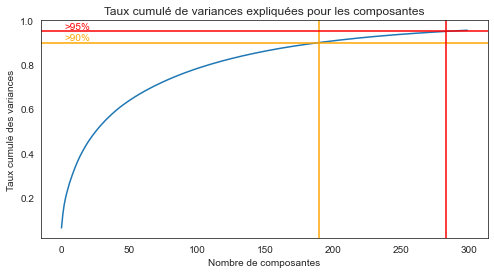

Nombre de composantes expliquant 90% de la variance : 190
Nombre de composantes expliquant 95% de la variance : 283


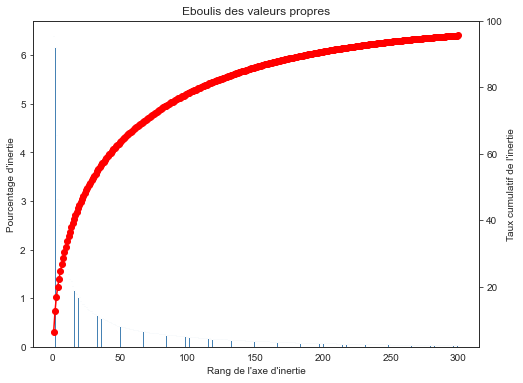

In [111]:
# Analyse en composante principale
liste_tuples_comp = [(0, 1)]
outils_acp.reduire_dimension_acp(df_countvectorizer_desc_lem, 300)

- 190 composantes expliquent plus de 90% de la variance en utilisant seulement 4% de toutes les variables.

In [56]:
%pycodestyle_off

In [57]:
# ACP avec 190 composantes expliquants 90% de la variance
n_comp = 190
pca_cv_desc_lem = PCA(n_components=n_comp, random_state=seed)
pca_cv_desc_lem.fit(df_countvectorizer_desc_lem)
X_proj_acp_cv_desc_lem = pca_cv_desc_lem.transform(df_countvectorizer_desc_lem)
# Dataframe pour clustering
df_acp_cv_desc_lem = pd.DataFrame({'VAR1' : X_proj_acp_cv_desc_lem[:, 0],
                                   'VAR2': X_proj_acp_cv_desc_lem[:, 1],
                                   'CATEGORIE' : data_work['Categorie_1']})

In [58]:
%pycodestyle_on

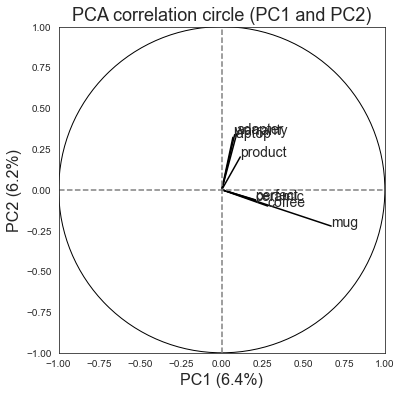

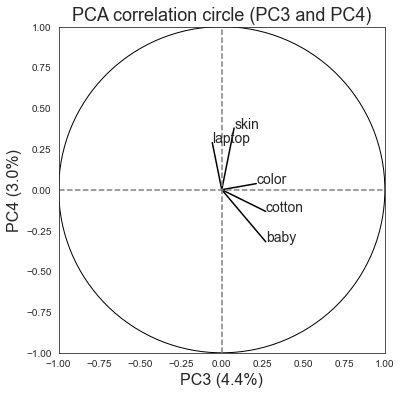

In [119]:
outils_acp.affiche_correlation_circle(pca_cv_desc_lem.components_,
                                      pca_cv_desc_lem,
                                      countvectorizer_desc_lem
                                      .get_feature_names(),
                                      [(0, 1), (2, 3)])

- La **première composante** (ceramic, coffe, mug) représente la catégorie **Kitchen & Dining** :
- La **seconde composante** (product, laptop, adapter, battery) représente la catégorie : **Computers**.    
- La **troisième composante** (color, cotton, baby) représente la catégorie : **Baby Care**.
- La **quatrième composante** (skin) représente la catégorie : **Beauty and Personal Care**.

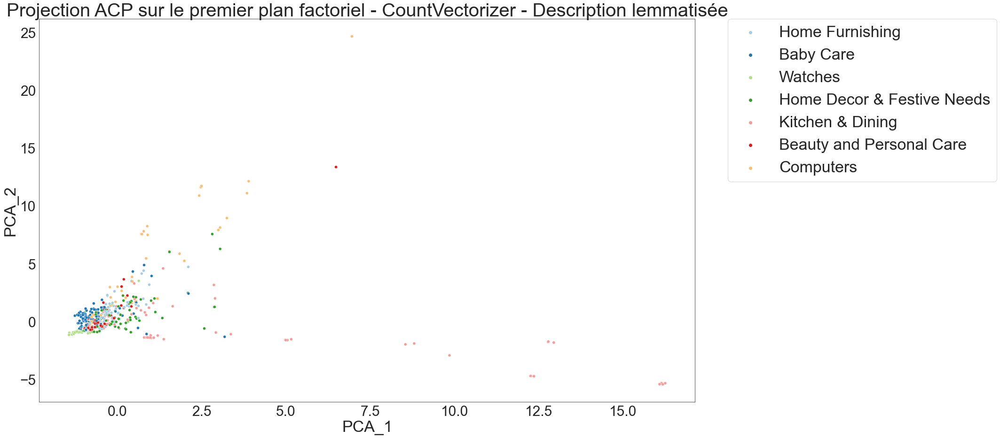

In [211]:
# Visulisation de la projection des 2 premiers plans factoriels
titre = 'Projection ACP sur le premier plan factoriel - CountVectorizer'
titre_1 = titre + ' - Description lemmatisée'
outils_acp.affiche_projections_reducdim(data_work, X_proj_acp_cv_desc_lem,
                                        'PCA_1', 'PCA_2', titre_1)

**description** - stemmatisée

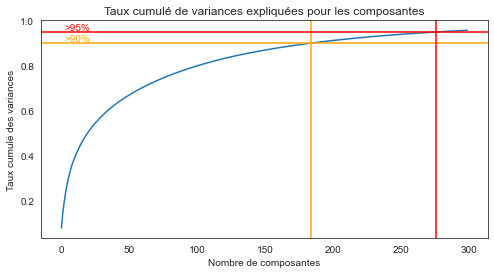

Nombre de composantes expliquant 90% de la variance : 184
Nombre de composantes expliquant 95% de la variance : 276


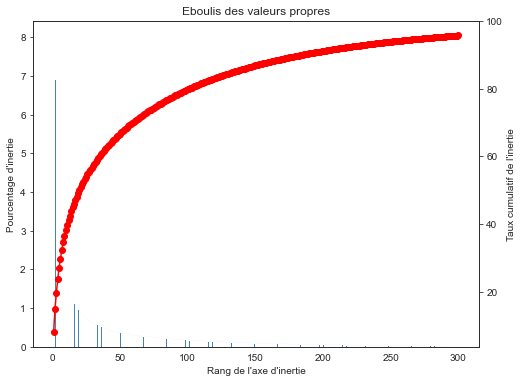

In [112]:
# Analyse en composante principale
liste_tuples_comp = [(0, 1)]
outils_acp.reduire_dimension_acp(df_countvectorizer_desc_stem, 300)

- 184 composantes expliquent plus de 90% de la variance en utilisant seulement 9% de toutes les variables.

In [59]:
%pycodestyle_off

In [60]:
# ACP avec 184 composantes expliquants 90% de la variance
n_comp_2 = 184
pca_cv_desc_stem = PCA(n_components=n_comp_2, random_state=seed)
pca_cv_desc_stem.fit(df_countvectorizer_desc_stem)
X_proj_acp_cv_desc_stem = \
    pca_cv_desc_stem.transform(df_countvectorizer_desc_stem)
# Dataframe pour clustering
df_acp_cv_desc_stem = pd.DataFrame({'VAR1' : X_proj_acp_cv_desc_stem[:, 0],
                                    'VAR2': X_proj_acp_cv_desc_stem[:, 1],
                                    'CATEGORIE' : data_work['Categorie_1']})

In [61]:
%pycodestyle_on

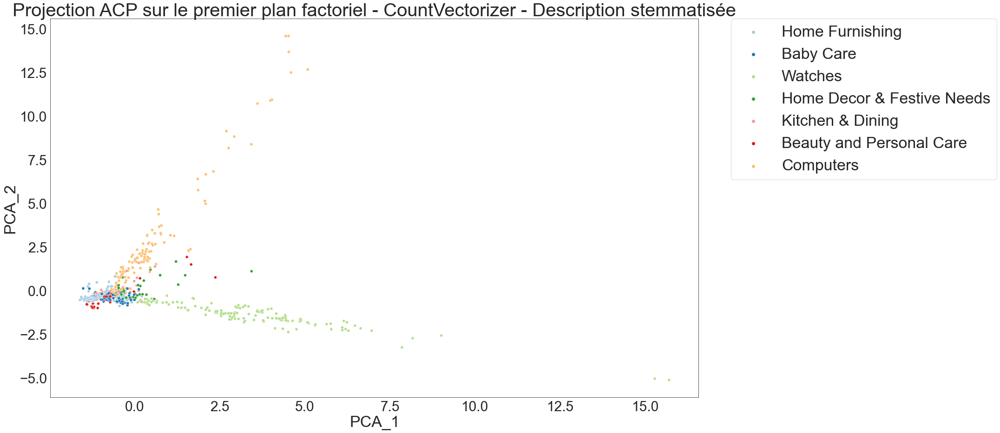

In [212]:
# Visulisation de la projection des 2 premiers plans factoriels
titre_2 = titre + ' - Description stemmatisée'
outils_acp.affiche_projections_reducdim(data_work, X_proj_acp_cv_desc_stem,
                                        'PCA_1', 'PCA_2', titre_2)

**produit_specification** - lemmatisée

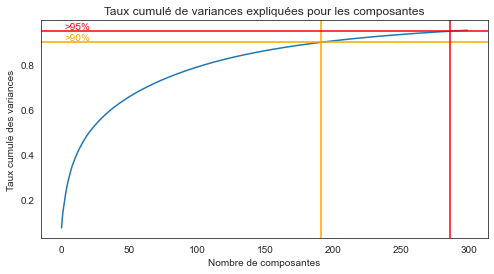

Nombre de composantes expliquant 90% de la variance : 191
Nombre de composantes expliquant 95% de la variance : 286


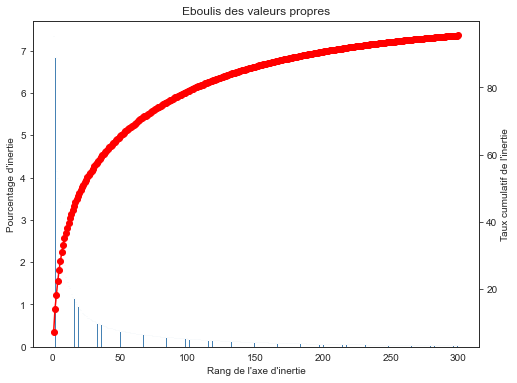

In [127]:
# Analyse en composante principale
liste_tuples_comp = [(0, 1)]
outils_acp.reduire_dimension_acp(df_countvectorizer_prod_lem, 300)

- 191 composantes expliquent plus de 90% de la variance en utilisant seulement 15% de toutes les variables.

In [62]:
%pycodestyle_off

In [63]:
# ACP avec 191 composantes expliquants 90% de la variance
n_comp_3 = 191
pca_cv_prod_lem = PCA(n_components=n_comp_3, random_state=seed)
pca_cv_prod_lem.fit(df_countvectorizer_prod_lem)
X_proj_acp_cv_prod_lem = \
    pca_cv_prod_lem.transform(df_countvectorizer_prod_lem)
# Dataframe pour clustering
df_acp_cv_prod_lem = pd.DataFrame({'VAR1' : X_proj_acp_cv_prod_lem[:, 0],
                                   'VAR2': X_proj_acp_cv_prod_lem[:, 1],
                                   'CATEGORIE' : data_work['Categorie_1']})

In [64]:
%pycodestyle_on

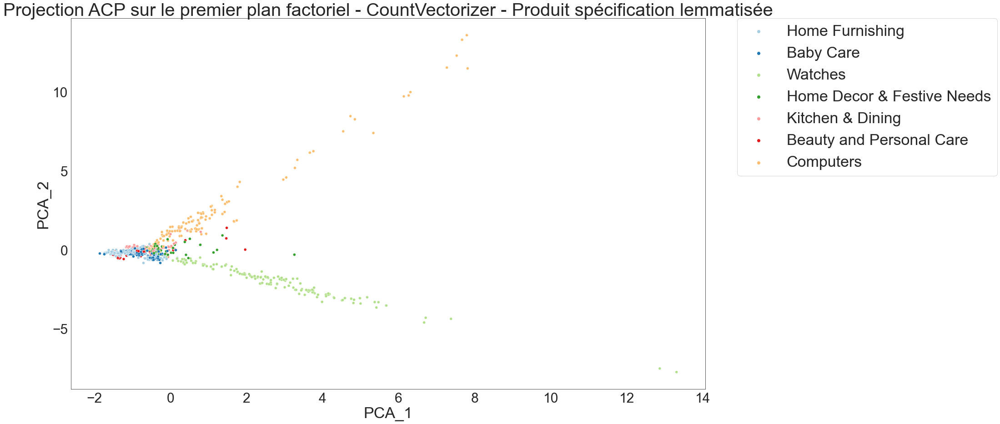

In [213]:
# Visulisation de la projection des 2 premiers plans factoriels
titre_3 = titre + ' - Produit spécification lemmatisée'
outils_acp.affiche_projections_reducdim(data_work, X_proj_acp_cv_prod_lem,
                                        'PCA_1', 'PCA_2', titre_3)

**produit_specification** - stemmatisée

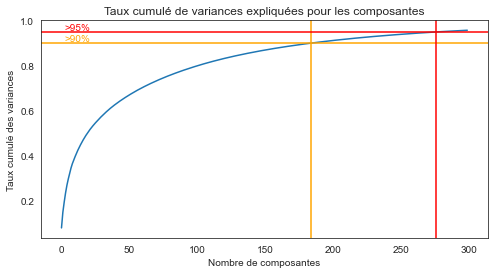

Nombre de composantes expliquant 90% de la variance : 184
Nombre de composantes expliquant 95% de la variance : 276


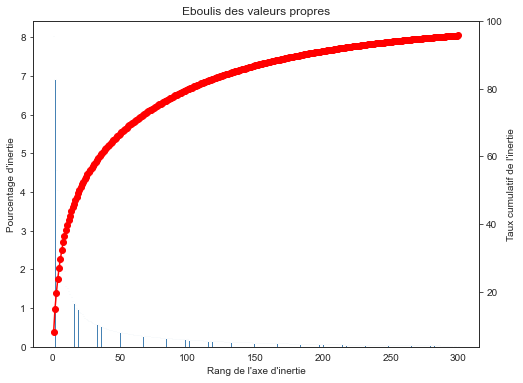

In [130]:
# Analyse en composante principale
liste_tuples_comp = [(0, 1)]
outils_acp.reduire_dimension_acp(df_countvectorizer_prod_stem, 300)

- 184 composantes expliquent plus de 90% de la variance en utilisant seulement 15% de toutes les variables.

In [65]:
%pycodestyle_off

In [66]:
# ACP avec 184 composantes expliquants 90% de la variance
n_comp_4 = 184
pca_cv_prod_stem = PCA(n_components=n_comp_4, random_state=seed)
pca_cv_prod_stem.fit(df_countvectorizer_prod_stem)
X_proj_acp_cv_prod_stem = \
    pca_cv_prod_stem.transform(df_countvectorizer_prod_stem)
# Dataframe pour clustering
df_acp_cv_prod_stem = pd.DataFrame({'VAR1' : X_proj_acp_cv_prod_stem[:, 0],
                                    'VAR2': X_proj_acp_cv_prod_stem[:, 1],
                                    'CATEGORIE' : data_work['Categorie_1']})

In [67]:
%pycodestyle_on

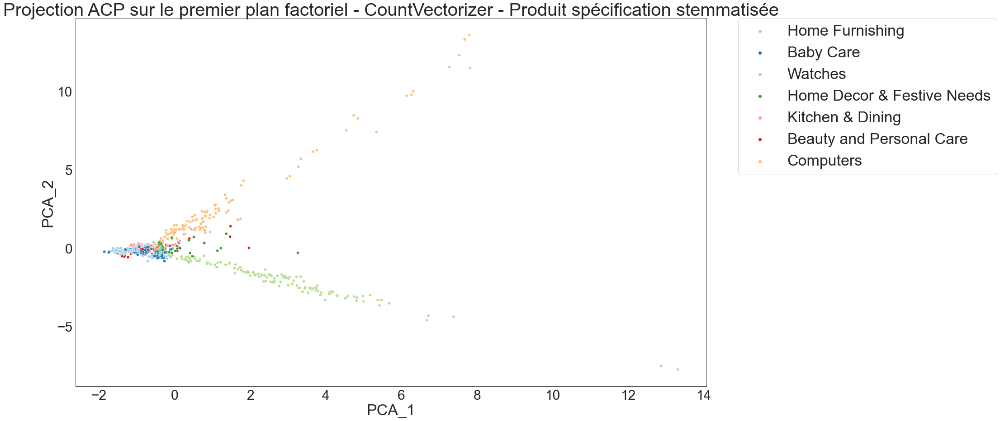

In [214]:
# Visulisation de la projection des 2 premiers plans factoriels
titre_4 = titre + ' - Produit spécification stemmatisée'
outils_acp.affiche_projections_reducdim(data_work, X_proj_acp_cv_prod_lem,
                                        'PCA_1', 'PCA_2', titre_4)

#### <span style='background:Moccasin'>5.1.2 BOW - TfidfVectorizer</span>

**description** - lemmatisée

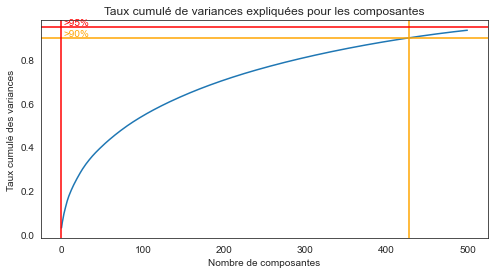

Nombre de composantes expliquant 90% de la variance : 427
Nombre de composantes expliquant 95% de la variance : 0


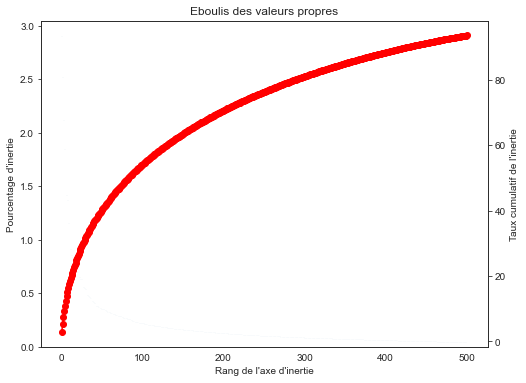

In [134]:
# Analyse en composante principale
liste_tuples_comp = [(0, 1)]
outils_acp.reduire_dimension_acp(df_tfidfvectorizer_desc_lem, 500)

- 427 composantes expliquent plus de 90% de la variance en utilisant seulement 19% de toutes les variables.

In [68]:
%pycodestyle_off

In [69]:
# ACP avec 427 composantes expliquants 90% de la variance
n_comp_5 = 427
pca_tfidf_desc_lem = PCA(n_components=n_comp_5, random_state=seed)
pca_tfidf_desc_lem.fit(df_tfidfvectorizer_desc_lem)
X_proj_acp_tfidf_desc_lem = \
    pca_tfidf_desc_lem.transform(df_tfidfvectorizer_desc_lem)
# Dataframe pour clustering
df_acp_tfidf_desc_lem = pd.DataFrame({'VAR1' : X_proj_acp_tfidf_desc_lem[:, 0],
                                      'VAR2': X_proj_acp_tfidf_desc_lem[:, 1],
                                      'CATEGORIE' : data_work['Categorie_1']})

In [70]:
%pycodestyle_on

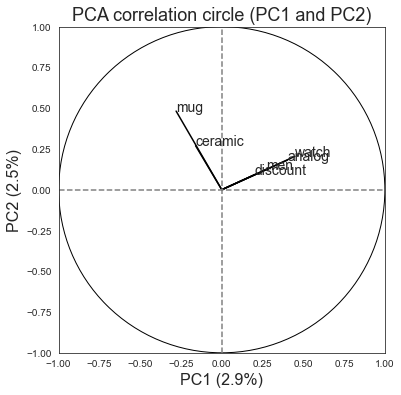

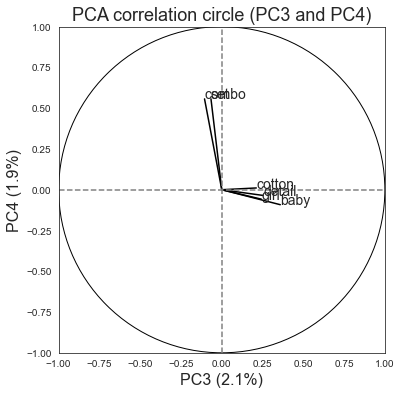

In [137]:
outils_acp.affiche_correlation_circle(pca_tfidf_desc_lem.components_,
                                      pca_tfidf_desc_lem,
                                      tfidfvectorizer_desc_lem
                                      .get_feature_names(),
                                      [(0, 1), (2, 3)])

- La **première composante** (watch, men, discount) représente la catégorie **Watches** :
- La **seconde composante** (ceramic, mug) représente la catégorie : **Kitchen & Dining**.    
- La **troisième composante** (color, cotton, baby) représente la catégorie : **Baby Care**.
- La **quatrième composante** (Beauty and Personal Care) représente la catégorie : **Beauty and Personal Care**.

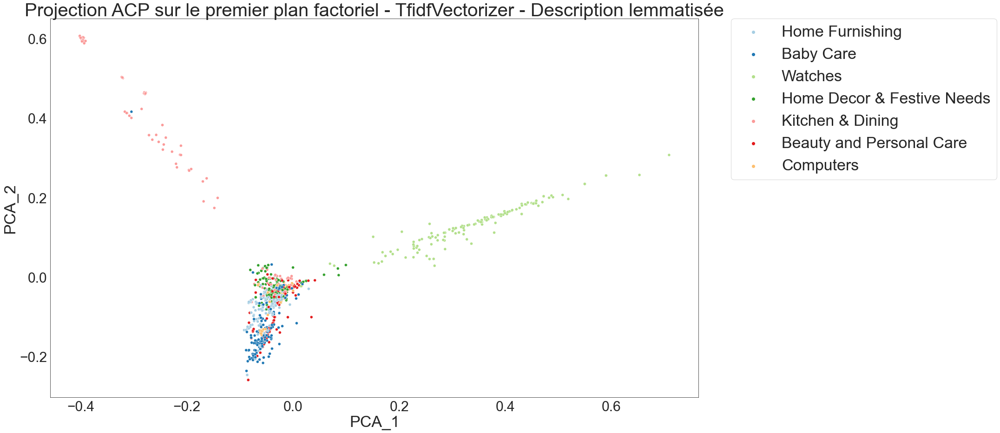

In [215]:
# Visulisation de la projection des 2 premiers plans factoriels
titre_tf = 'Projection ACP sur le premier plan factoriel - TfidfVectorizer'
titre_5 = titre_tf + ' - Description lemmatisée'
outils_acp.affiche_projections_reducdim(data_work, X_proj_acp_tfidf_desc_lem,
                                        'PCA_1', 'PCA_2', titre_5)

**description** - stemmatisée

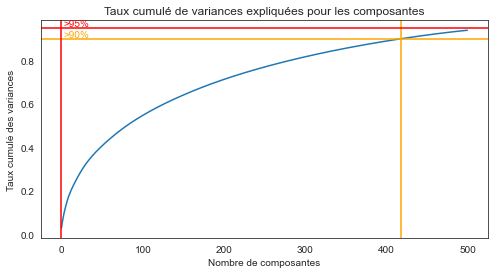

Nombre de composantes expliquant 90% de la variance : 417
Nombre de composantes expliquant 95% de la variance : 0


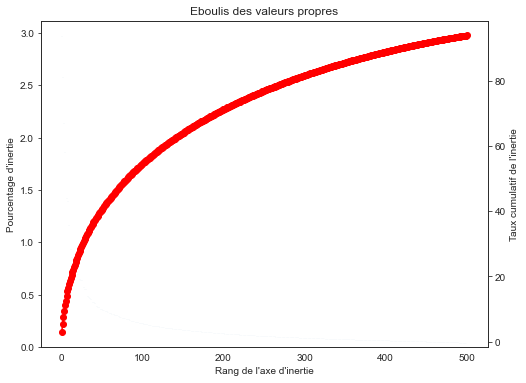

In [140]:
# Analyse en composante principale
liste_tuples_comp = [(0, 1)]
outils_acp.reduire_dimension_acp(df_tfidfvectorizer_desc_stem, 500)

- 417 composantes expliquent plus de 90% de la variance en utilisant seulement 21% de toutes les variables.

In [71]:
%pycodestyle_off

In [72]:
# ACP avec 417 composantes expliquants 90% de la variance
n_comp_6 = 417
pca_tfidf_desc_stem = PCA(n_components=n_comp_6, random_state=seed)
pca_tfidf_desc_stem.fit(df_tfidfvectorizer_desc_stem)
X_proj_acp_tfidf_desc_stem = \
    pca_tfidf_desc_stem.transform(df_tfidfvectorizer_desc_stem)
# Dataframe pour clustering
df_acp_tfidf_desc_stem = pd.DataFrame({'VAR1' : X_proj_acp_tfidf_desc_stem[:, 0],
                                       'VAR2': X_proj_acp_tfidf_desc_stem[:, 1],
                                       'CATEGORIE' : data_work['Categorie_1']})

In [73]:
%pycodestyle_on

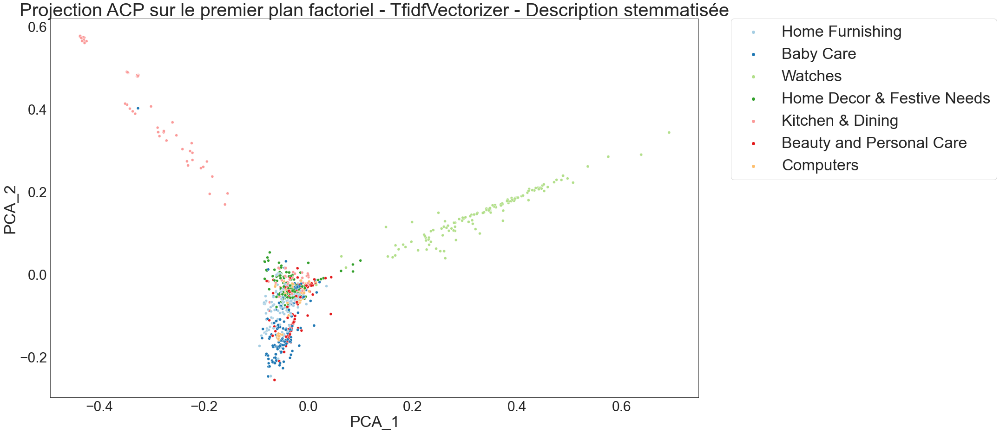

In [217]:
# Visulisation de la projection des 2 premiers plans factoriels
titre_tf = 'Projection ACP sur le premier plan factoriel - TfidfVectorizer'
titre_6 = titre_tf + ' - Description stemmatisée'
outils_acp.affiche_projections_reducdim(data_work, X_proj_acp_tfidf_desc_stem,
                                        'PCA_1', 'PCA_2', titre_6)

**produit_specification** - lemmatisée

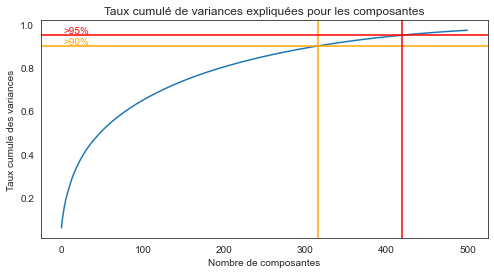

Nombre de composantes expliquant 90% de la variance : 315
Nombre de composantes expliquant 95% de la variance : 419


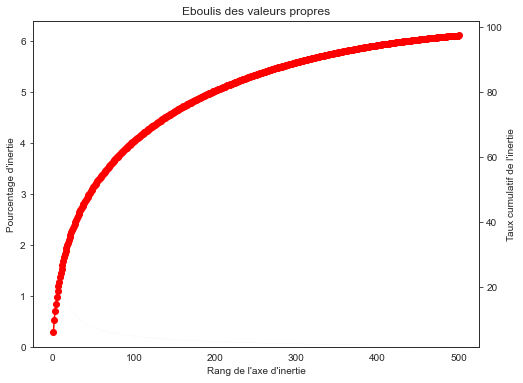

In [143]:
# Analyse en composante principale
liste_tuples_comp = [(0, 1)]
outils_acp.reduire_dimension_acp(df_tfidfvectorizer_prod_lem, 500)

- 315 composantes expliquent plus de 90% de la variance en utilisant seulement 25% de toutes les variables.

In [74]:
%pycodestyle_off

In [75]:
# ACP avec 315 composantes expliquants 90% de la variance
n_comp_7 = 315
pca_tfidf_prod_lem = PCA(n_components=n_comp_7, random_state=seed)
pca_tfidf_prod_lem.fit(df_tfidfvectorizer_prod_lem)
X_proj_acp_tfidf_prod_lem = \
    pca_tfidf_prod_lem.transform(df_tfidfvectorizer_prod_lem)
# Dataframe pour clustering
df_acp_tfidf_prod_lem = pd.DataFrame({'VAR1' : X_proj_acp_tfidf_prod_lem[:, 0],
                                      'VAR2': X_proj_acp_tfidf_prod_lem[:, 1],
                                      'CATEGORIE' : data_work['Categorie_1']})

In [76]:
%pycodestyle_on

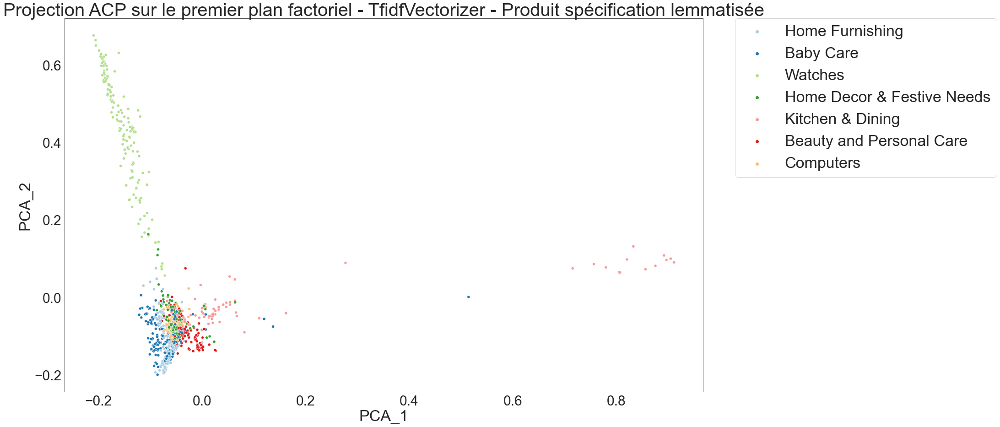

In [222]:
# Visulisation de la projection des 2 premiers plans factoriels
titre_tf = 'Projection ACP sur le premier plan factoriel - TfidfVectorizer'
titre_7 = titre_tf + ' - Produit spécification lemmatisée'
outils_acp.affiche_projections_reducdim(data_work, X_proj_acp_tfidf_prod_lem,
                                        'PCA_1', 'PCA_2', titre_7)

**produit_specification** - stemmatisée

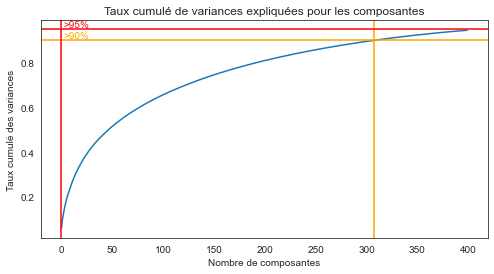

Nombre de composantes expliquant 90% de la variance : 307
Nombre de composantes expliquant 95% de la variance : 0


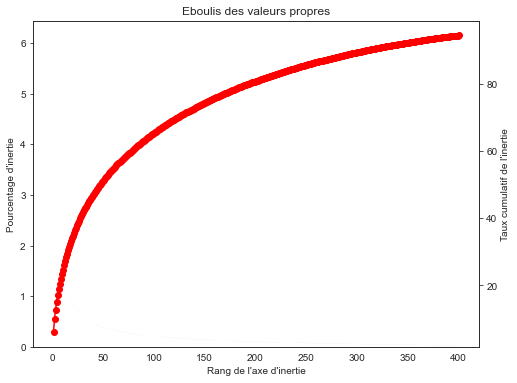

In [146]:
# Analyse en composante principale
liste_tuples_comp = [(0, 1)]
outils_acp.reduire_dimension_acp(df_tfidfvectorizer_prod_stem, 400)

- 307 composantes expliquent plus de 90% de la variance en utilisant seulement 26% de toutes les variables.

In [77]:
%pycodestyle_off

In [78]:
# ACP avec 307 composantes expliquants 90% de la variance
n_comp_8 = 307
pca_tfidf_prod_stem = PCA(n_components=n_comp_8, random_state=seed)
pca_tfidf_prod_stem.fit(df_tfidfvectorizer_prod_stem)
X_proj_acp_tfidf_prod_stem = \
    pca_tfidf_prod_stem.transform(df_tfidfvectorizer_prod_stem)
# Dataframe pour clustering
df_acp_tfidf_prod_stem = pd.DataFrame({'VAR1' : X_proj_acp_tfidf_prod_stem[:, 0],
                                       'VAR2': X_proj_acp_tfidf_prod_stem[:, 1],
                                       'CATEGORIE' : data_work['Categorie_1']})

In [79]:
%pycodestyle_on

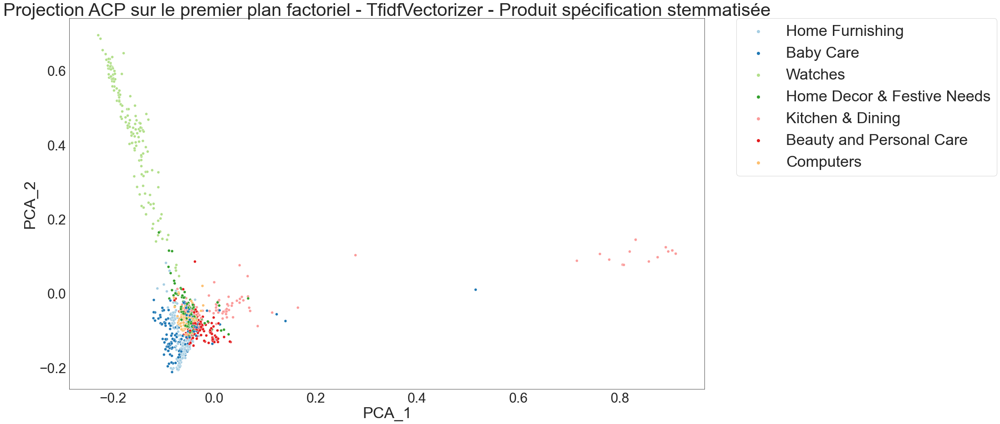

In [223]:
# Visulisation de la projection des 2 premiers plans factoriels
titre_tf = 'Projection ACP sur le premier plan factoriel - TfidfVectorizer'
titre_8 = titre_tf + ' - Produit spécification stemmatisée'
outils_acp.affiche_projections_reducdim(data_work, X_proj_acp_tfidf_prod_stem,
                                        'PCA_1', 'PCA_2', titre_8)

#### <span style='background:Moccasin'>5.1.3 BOW - HashingVectorizer</span>

**description** - lemmatisée

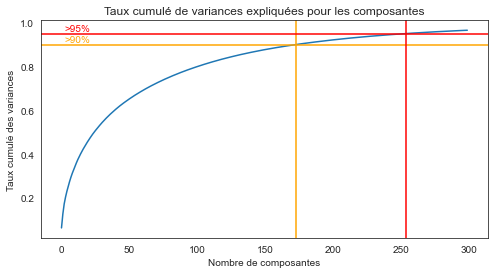

Nombre de composantes expliquant 90% de la variance : 173
Nombre de composantes expliquant 95% de la variance : 254


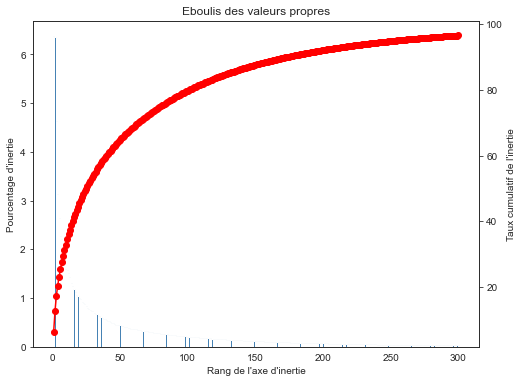

In [215]:
# Analyse en composante principale
liste_tuples_comp = [(0, 1)]
outils_acp.reduire_dimension_acp(df_hashvectorizer_desc_lem, 300)

- 173 composantes expliquent plus de 90% de la variance en utilisant seulement 8% de toutes les variables.

In [80]:
%pycodestyle_off

In [81]:
# ACP avec 173 composantes expliquants 90% de la variance
n_comp_9 = 427
pca_hash_desc_lem = PCA(n_components=n_comp_9, random_state=seed)
pca_hash_desc_lem.fit(df_hashvectorizer_desc_lem)
X_proj_acp_hash_desc_lem = \
    pca_hash_desc_lem.transform(df_hashvectorizer_desc_lem)
# Dataframe pour clustering
df_acp_hash_desc_lem = pd.DataFrame({'VAR1': X_proj_acp_hash_desc_lem[:, 0],
                                     'VAR2': X_proj_acp_hash_desc_lem[:, 1],
                                     'CATEGORIE' : data_work['Categorie_1']})

In [82]:
%pycodestyle_on

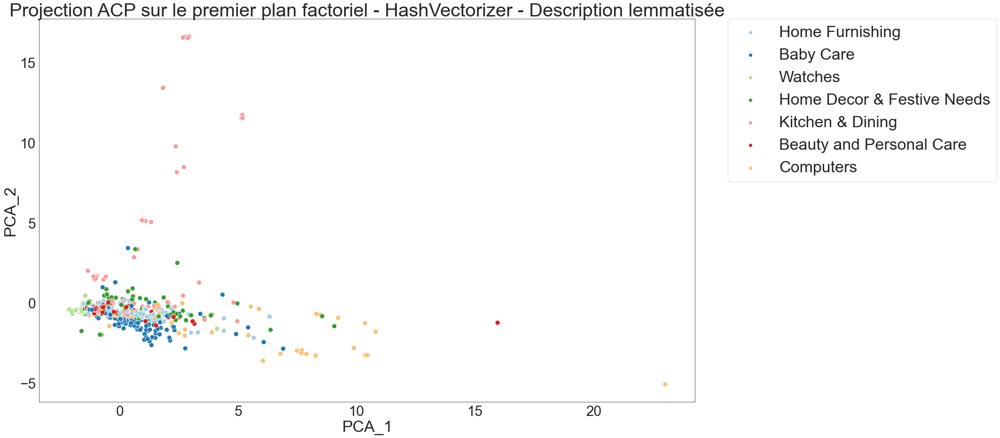

In [146]:
# Visulisation de la projection des 2 premiers plans factoriels
titre_hash = 'Projection ACP sur le premier plan factoriel - HashVectorizer'
titre_9 = titre_hash + ' - Description lemmatisée'
outils_acp.affiche_projections_reducdim(data_work, X_proj_acp_hash_desc_lem,
                                        'PCA_1', 'PCA_2', titre_9)

**description** - stemmatisée

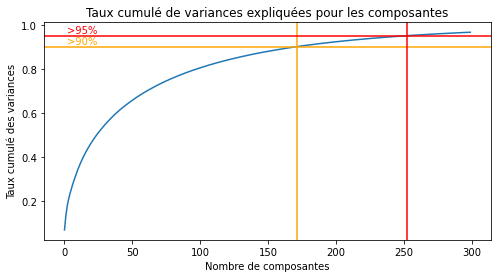

'Nombre de composantes expliquant 90% de la variance : 171'

'Nombre de composantes expliquant 95% de la variance : 252'

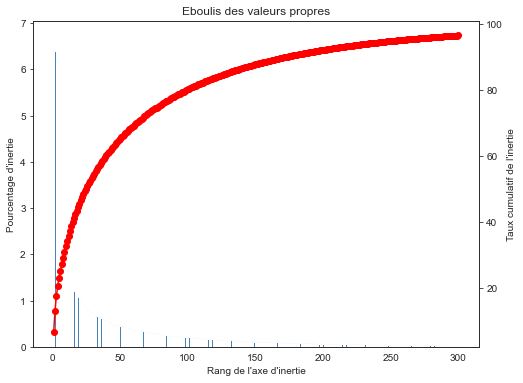

In [116]:
# Analyse en composante principale
liste_tuples_comp = [(0, 1)]
outils_acp.reduire_dimension_acp(df_hashvectorizer_desc_stem, 300)

- 171 composantes expliquent plus de 90% de la variance en utilisant seulement 8,5% de toutes les variables.

In [83]:
%pycodestyle_off

In [84]:
# ACP avec 171 composantes expliquants 90% de la variance
n_comp_10 = 171
pca_hash_desc_stem = PCA(n_components=n_comp_10, random_state=seed)
pca_hash_desc_stem.fit(df_hashvectorizer_desc_stem)
X_proj_acp_hash_desc_stem = \
    pca_hash_desc_stem.transform(df_hashvectorizer_desc_stem)
# Dataframe pour clustering
df_acp_hash_desc_stem = pd.DataFrame({'VAR1': X_proj_acp_hash_desc_stem[:, 0],
                                      'VAR2': X_proj_acp_hash_desc_stem[:, 1],
                                      'CATEGORIE' : data_work['Categorie_1']})

In [85]:
%pycodestyle_on

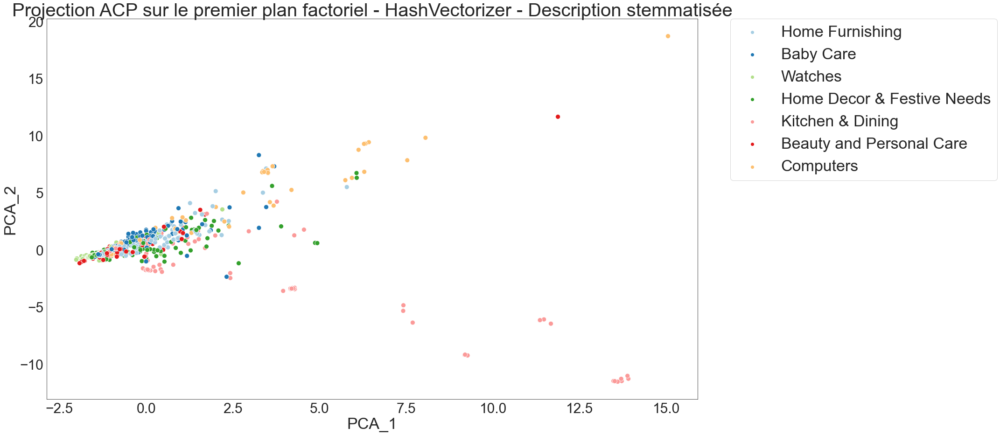

In [147]:
# Visulisation de la projection des 2 premiers plans factoriels
titre_10 = titre_hash + ' - Description stemmatisée'
outils_acp.affiche_projections_reducdim(data_work, X_proj_acp_hash_desc_stem,
                                        'PCA_1', 'PCA_2', titre_10)

**produit_specification** - lemmatisée

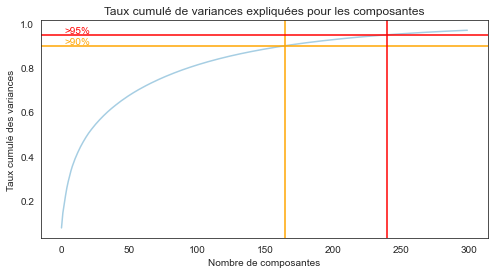

'Nombre de composantes expliquant 90% de la variance : 165'

'Nombre de composantes expliquant 95% de la variance : 240'

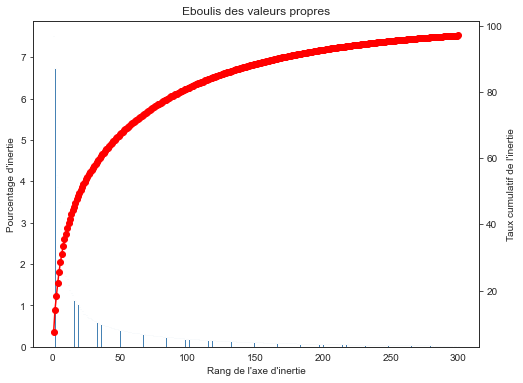

In [148]:
# Analyse en composante principale
liste_tuples_comp = [(0, 1)]
outils_acp.reduire_dimension_acp(df_hashvectorizer_prod_lem, 300)

- 165 composantes expliquent plus de 90% de la variance en utilisant seulement 13% de toutes les variables.

In [86]:
%pycodestyle_off

In [87]:
# ACP avec 165 composantes expliquants 90% de la variance
n_comp_11 = 165
pca_hash_prod_lem = PCA(n_components=n_comp_7, random_state=seed)
pca_hash_prod_lem.fit(df_hashvectorizer_prod_lem)
X_proj_acp_hash_prod_lem = \
    pca_hash_prod_lem.transform(df_hashvectorizer_prod_lem)
# Dataframe pour clustering
df_acp_hash_prod_lem = pd.DataFrame({'VAR1' : X_proj_acp_hash_prod_lem[:, 0],
                                     'VAR2' : X_proj_acp_hash_prod_lem[:, 1],
                                     'CATEGORIE' : data_work['Categorie_1']})

In [88]:
%pycodestyle_on

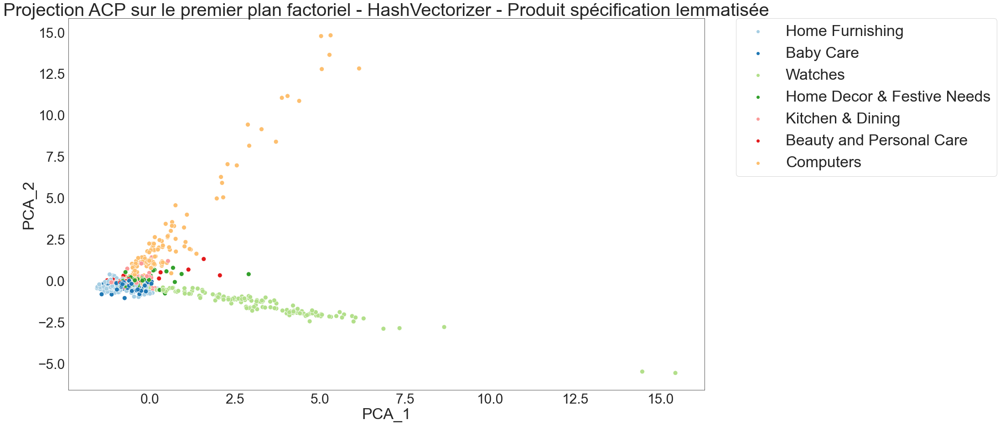

In [159]:
# Visulisation de la projection des 2 premiers plans factoriels
titre_11 = titre_hash + ' - Produit spécification lemmatisée'
outils_acp.affiche_projections_reducdim(data_work, X_proj_acp_hash_prod_lem,
                                        'PCA_1', 'PCA_2', titre_11)

**produit_specification** - stemmatisée

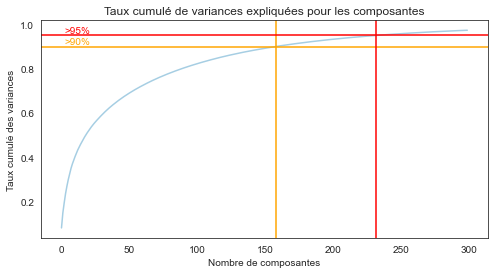

'Nombre de composantes expliquant 90% de la variance : 158'

'Nombre de composantes expliquant 95% de la variance : 232'

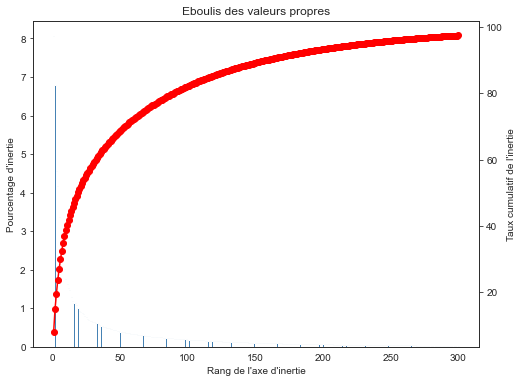

In [160]:
# Analyse en composante principale
liste_tuples_comp = [(0, 1)]
outils_acp.reduire_dimension_acp(df_hashvectorizer_prod_stem, 300)

- 158 composantes expliquent plus de 90% de la variance en utilisant seulement 13% de toutes les variables.

In [89]:
%pycodestyle_off

In [90]:
# ACP avec 158 composantes expliquants 90% de la variance
n_comp_12 = 158
pca_hash_prod_stem = PCA(n_components=n_comp_12, random_state=seed)
pca_hash_prod_stem.fit(df_hashvectorizer_prod_stem)
X_proj_acp_hash_prod_stem = \
    pca_hash_prod_stem.transform(df_hashvectorizer_prod_stem)
# Dataframe pour clustering
df_acp_hash_prod_stem = pd.DataFrame({'VAR1' : X_proj_acp_hash_prod_stem[:, 0],
                                      'VAR2' : X_proj_acp_hash_prod_stem[:, 1],
                                      'CATEGORIE' : data_work['Categorie_1']})

In [91]:
%pycodestyle_on

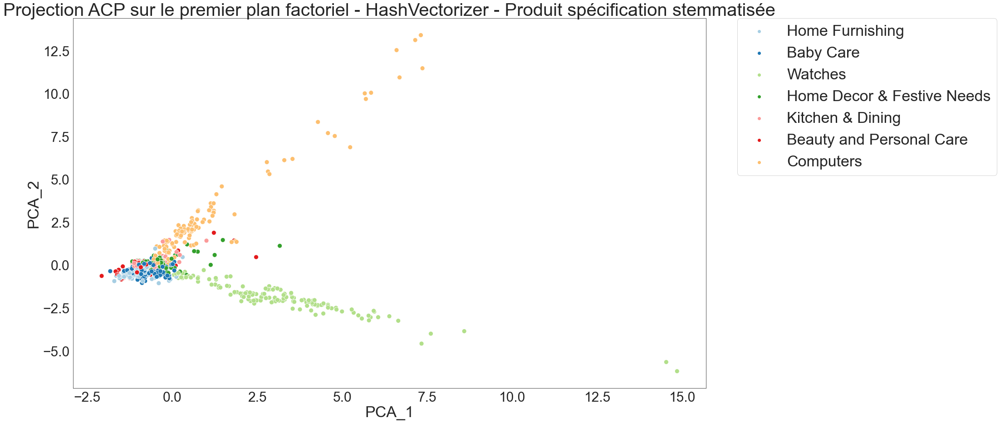

In [166]:
# Visulisation de la projection des 2 premiers plans factoriels
titre_12 = titre_hash + ' - Produit spécification stemmatisée'
outils_acp.affiche_projections_reducdim(data_work, X_proj_acp_hash_prod_stem,
                                        'PCA_1', 'PCA_2', titre_12)

### <span style='background:PowderBlue'>5.2. TSNE</span>

#### <span style='background:Moccasin'>5.2.1 BOW - CountVectorizer</span>

**description** - lemmatisée

In [241]:
# t-SNE tuning du paramètre perplexity sans initialisation PCA
top_depart = time.time()
liste_param = [5, 10, 20, 30, 40, 50]
results_cv_desc_lem = list()
tsne_results_cv_desc_lem = []
for i in liste_param:
    tsne = TSNE(n_components=2, verbose=1, perplexity=i, n_iter=500,
                random_state=seed)
    tsne_results_cv_desc_lem = tsne.fit_transform(df_countvectorizer_desc_lem)
    results_cv_desc_lem.append(tsne_results_cv_desc_lem)
print('t-SNE terminée! en : {} seconds'.format(time.time()-top_depart))

[t-SNE] Computing 16 nearest neighbors...
[t-SNE] Indexed 1050 samples in 0.343s...
[t-SNE] Computed neighbors for 1050 samples in 3.565s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1050
[t-SNE] Computed conditional probabilities for sample 1050 / 1050
[t-SNE] Mean sigma: 0.722421
[t-SNE] KL divergence after 250 iterations with early exaggeration: 80.867989
[t-SNE] KL divergence after 500 iterations: 1.002592
[t-SNE] Computing 31 nearest neighbors...
[t-SNE] Indexed 1050 samples in 0.365s...
[t-SNE] Computed neighbors for 1050 samples in 3.777s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1050
[t-SNE] Computed conditional probabilities for sample 1050 / 1050
[t-SNE] Mean sigma: 1.261212
[t-SNE] KL divergence after 250 iterations with early exaggeration: 82.641335
[t-SNE] KL divergence after 500 iterations: 1.002864
[t-SNE] Computing 61 nearest neighbors...
[t-SNE] Indexed 1050 samples in 0.354s...
[t-SNE] Computed neighbors for 1050 samples in 3.8

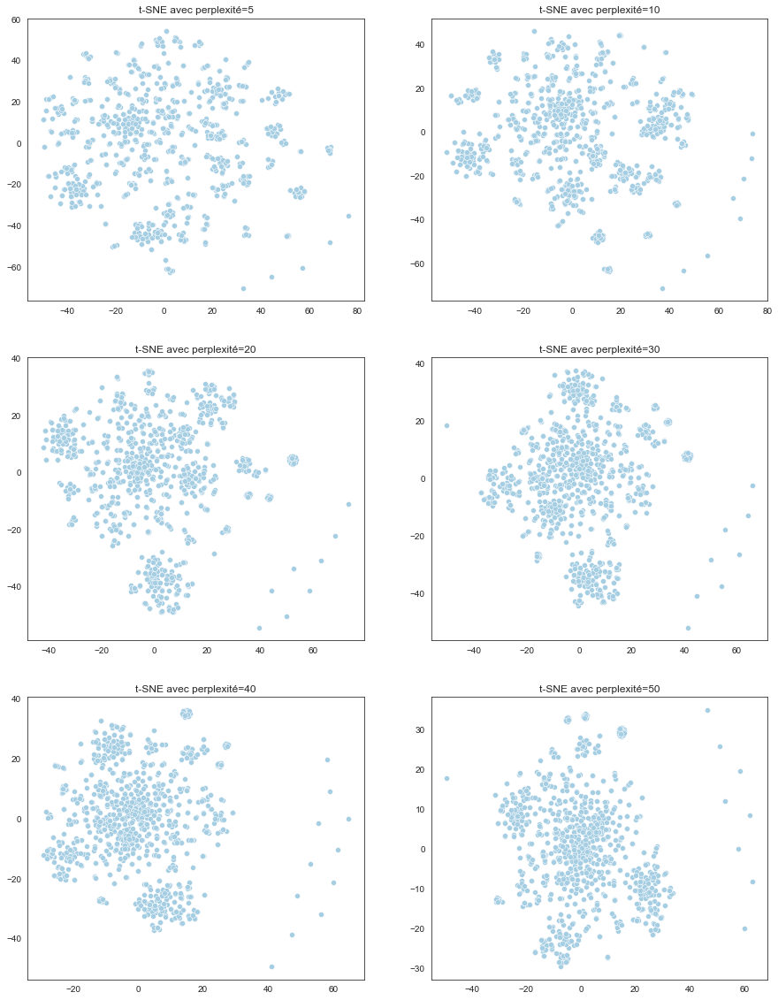

In [245]:
# Visualisation en 2D des différents résultats selon la perplexité
outils_segmentation.affiche_tsne(results_cv_desc_lem, liste_param, 1)

- groupes plus homogènes pour perplexité=40
- on laissera les paramètres learning_rate et n_iter par défaut (1000) et le nombre de composants par défaut (2).

In [92]:
%pycodestyle_off

In [93]:
# Réduction de dimension tsne
tsne_cv_desc_lem = TSNE(verbose=1, perplexity=40)
X_proj_tsne_cv_desc_lem = \
    tsne_cv_desc_lem.fit_transform(vector_countvectorizer_desc_lem)
# Dataframe pour clustering
df_tsne_cv_desc_lem = pd.DataFrame({'VAR1' : X_proj_tsne_cv_desc_lem[:, 0],
                                    'VAR2': X_proj_tsne_cv_desc_lem[:, 1],
                                    'CATEGORIE' : data_work['Categorie_1']})

[t-SNE] Computing 121 nearest neighbors...
[t-SNE] Indexed 1050 samples in 0.000s...
[t-SNE] Computed neighbors for 1050 samples in 0.036s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1050
[t-SNE] Computed conditional probabilities for sample 1050 / 1050
[t-SNE] Mean sigma: 1.602163
[t-SNE] KL divergence after 250 iterations with early exaggeration: 82.815994
[t-SNE] KL divergence after 1000 iterations: 0.993466


In [94]:
%pycodestyle_on

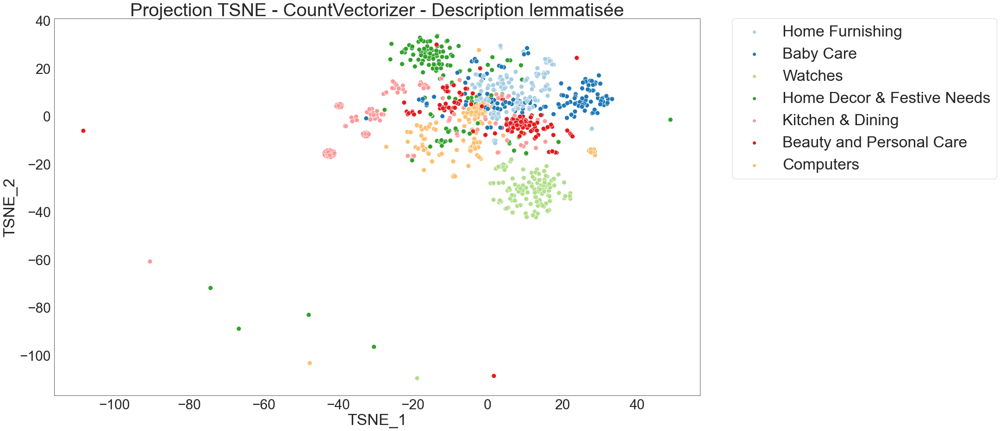

In [271]:
# Visulisation de la projection des 2 premiers variables TSNE
titre_tf = 'Projection TSNE - CountVectorizer'
titre_tf_1 = titre_tf + ' - Description lemmatisée'
outils_acp.affiche_projections_reducdim(data_work, X_proj_tsne_cv_desc_lem,
                                        'TSNE_1', 'TSNE_2', titre_tf_1)

**description** - stemmatisée

In [263]:
# t-SNE tuning du paramètre perplexity sans initialisation PCA
top_depart = time.time()
liste_param = [5, 10, 20, 30, 40, 50]
results_cv_desc_stem = list()
tsne_results_cv_desc_stem = []
for i in liste_param:
    tsne = TSNE(n_components=2, verbose=1, perplexity=i, n_iter=500,
                random_state=seed)
    tsne_results_cv_desc_stem = tsne.fit_transform(vector_countvectorizer_desc_stem)
    results_cv_desc_stem.append(tsne_results_cv_desc_stem)
print('t-SNE terminée! en : {} seconds'.format(time.time()-top_depart))

[t-SNE] Computing 16 nearest neighbors...
[t-SNE] Indexed 1050 samples in 0.009s...
[t-SNE] Computed neighbors for 1050 samples in 0.017s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1050
[t-SNE] Computed conditional probabilities for sample 1050 / 1050
[t-SNE] Mean sigma: 0.723452
[t-SNE] KL divergence after 250 iterations with early exaggeration: 83.030273
[t-SNE] KL divergence after 500 iterations: 0.989574
[t-SNE] Computing 31 nearest neighbors...
[t-SNE] Indexed 1050 samples in 0.000s...
[t-SNE] Computed neighbors for 1050 samples in 0.038s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1050
[t-SNE] Computed conditional probabilities for sample 1050 / 1050
[t-SNE] Mean sigma: 1.264696
[t-SNE] KL divergence after 250 iterations with early exaggeration: 82.626358
[t-SNE] KL divergence after 500 iterations: 0.981704
[t-SNE] Computing 61 nearest neighbors...
[t-SNE] Indexed 1050 samples in 0.000s...
[t-SNE] Computed neighbors for 1050 samples in 0.0

9:80: E501 line too long (84 > 79 characters)


[t-SNE] KL divergence after 500 iterations: 0.994082
t-SNE terminée! en : 9.33939790725708 seconds


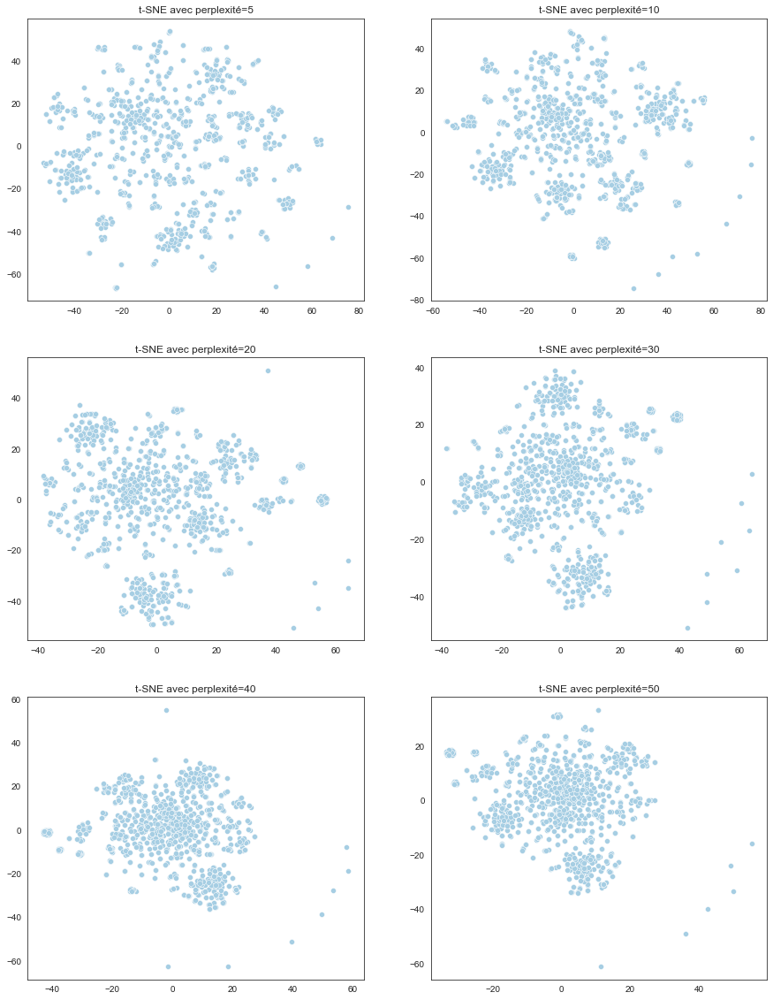

In [264]:
# Visualisation en 2D des différents résultats selon la perplexité
outils_segmentation.affiche_tsne(results_cv_desc_stem, liste_param, 1)

- groupes plus homogènes pour perplexité=40
- on laissera les paramètres learning_rate et n_iter par défaut (1000) et le nombre de composants par défaut (2).

In [95]:
%pycodestyle_off

In [96]:
# Réduction de dimension tsne
tsne_cv_desc_stem = TSNE(verbose=1, perplexity=40)
X_proj_tsne_cv_desc_stem = \
    tsne_cv_desc_stem.fit_transform(vector_countvectorizer_desc_stem)
# Dataframe pour clustering
df_tsne_cv_desc_stem = pd.DataFrame({'VAR1' : X_proj_tsne_cv_desc_stem[:, 0],
                                     'VAR2': X_proj_tsne_cv_desc_stem[:, 1],
                                     'CATEGORIE' : data_work['Categorie_1']})

[t-SNE] Computing 121 nearest neighbors...
[t-SNE] Indexed 1050 samples in 0.000s...
[t-SNE] Computed neighbors for 1050 samples in 0.033s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1050
[t-SNE] Computed conditional probabilities for sample 1050 / 1050
[t-SNE] Mean sigma: 1.612443
[t-SNE] KL divergence after 250 iterations with early exaggeration: 84.538116
[t-SNE] KL divergence after 1000 iterations: 0.971988


In [97]:
%pycodestyle_on

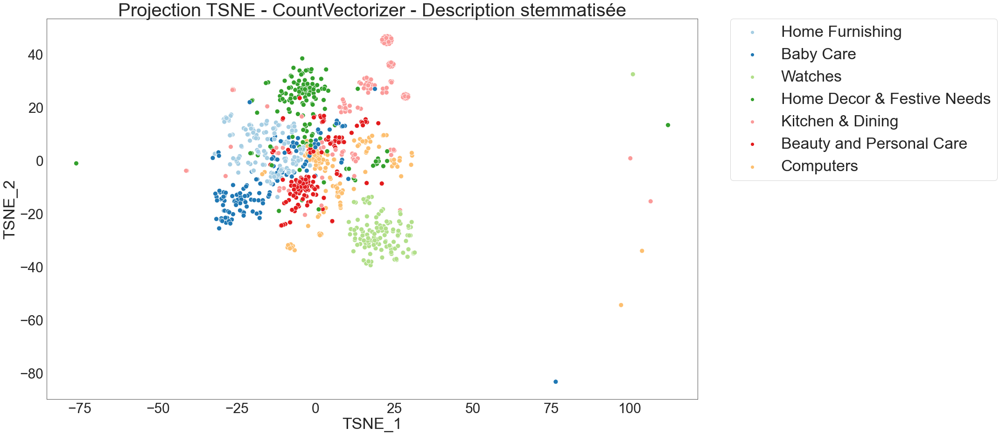

In [272]:
# Visulisation de la projection des 2 premiers variables TSNE
titre_tf = 'Projection TSNE - CountVectorizer'
titre_tf_2 = titre_tf + ' - Description stemmatisée'
outils_acp.affiche_projections_reducdim(data_work, X_proj_tsne_cv_desc_stem,
                                        'TSNE_1', 'TSNE_2', titre_tf_2)

**produit_specification** - lemmatisée

In [267]:
# t-SNE tuning du paramètre perplexity sans initialisation PCA
top_depart = time.time()
liste_param = [5, 10, 20, 30, 40, 50]
results_cv_prod_lem = list()
tsne_results_cv_prod_lem = []
for i in liste_param:
    tsne = TSNE(n_components=2, verbose=1, perplexity=i, n_iter=500,
                random_state=seed)
    tsne_results_cv_prod_lem = tsne.fit_transform(vector_countvectorizer_prod_lem)
    results_cv_prod_lem.append(tsne_results_cv_prod_lem)
print('t-SNE terminée! en : {} seconds'.format(time.time()-top_depart))

[t-SNE] Computing 16 nearest neighbors...
[t-SNE] Indexed 1050 samples in 0.000s...
[t-SNE] Computed neighbors for 1050 samples in 0.017s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1050
[t-SNE] Computed conditional probabilities for sample 1050 / 1050
[t-SNE] Mean sigma: 0.000000
[t-SNE] KL divergence after 250 iterations with early exaggeration: 75.801430
[t-SNE] KL divergence after 500 iterations: 0.838672
[t-SNE] Computing 31 nearest neighbors...
[t-SNE] Indexed 1050 samples in 0.000s...
[t-SNE] Computed neighbors for 1050 samples in 0.026s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1050
[t-SNE] Computed conditional probabilities for sample 1050 / 1050
[t-SNE] Mean sigma: 0.000000
[t-SNE] KL divergence after 250 iterations with early exaggeration: 74.114738
[t-SNE] KL divergence after 500 iterations: 0.816378
[t-SNE] Computing 61 nearest neighbors...
[t-SNE] Indexed 1050 samples in 0.000s...
[t-SNE] Computed neighbors for 1050 samples in 0.0

9:80: E501 line too long (82 > 79 characters)


[t-SNE] KL divergence after 500 iterations: 0.773271
t-SNE terminée! en : 8.357580184936523 seconds


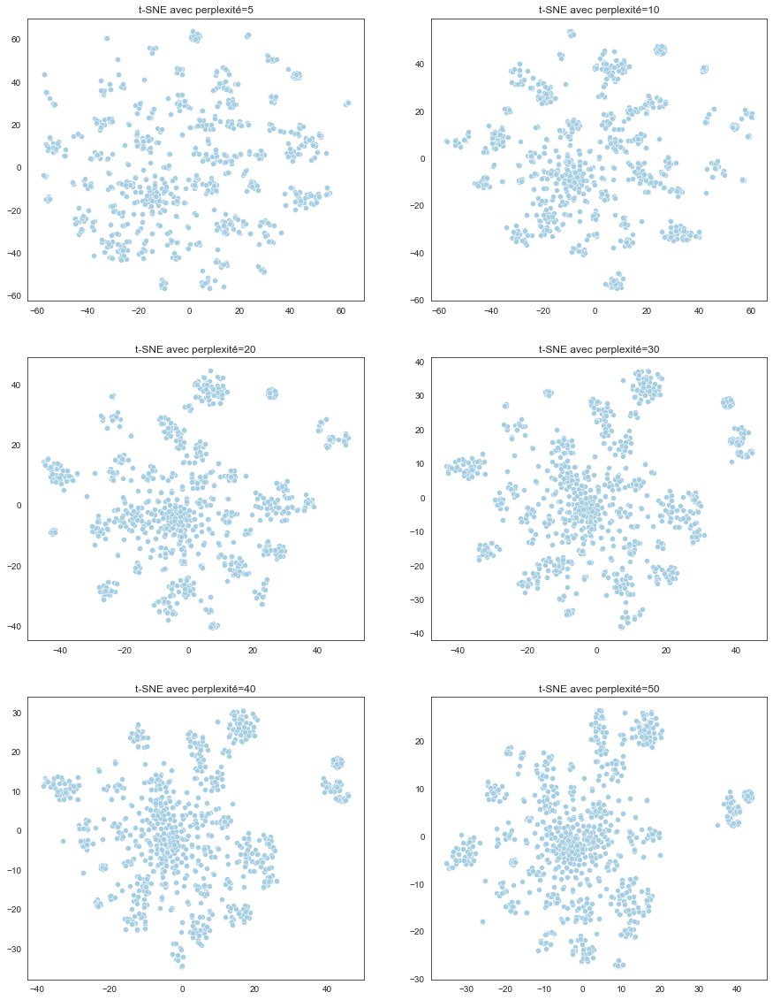

In [268]:
# Visualisation en 2D des différents résultats selon la perplexité
outils_segmentation.affiche_tsne(results_cv_prod_lem, liste_param, 1)

- groupes plus homogènes pour perplexité=40
- on laissera les paramètres learning_rate et n_iter par défaut (1000) et le nombre de composants par défaut (2).

In [98]:
%pycodestyle_off

In [99]:
# Réduction de dimension tsne
tsne_cv_prod_lem = TSNE(verbose=1, perplexity=40)
X_proj_tsne_cv_prod_lem = \
    tsne_cv_prod_lem.fit_transform(vector_countvectorizer_prod_lem)
# Dataframe pour clustering
df_tsne_cv_prod_lem = pd.DataFrame({'VAR1' : X_proj_tsne_cv_prod_lem[:, 0],
                                    'VAR2': X_proj_tsne_cv_prod_lem[:, 1],
                                    'CATEGORIE' : data_work['Categorie_1']})

[t-SNE] Computing 121 nearest neighbors...
[t-SNE] Indexed 1050 samples in 0.000s...
[t-SNE] Computed neighbors for 1050 samples in 0.033s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1050
[t-SNE] Computed conditional probabilities for sample 1050 / 1050
[t-SNE] Mean sigma: 1.838108
[t-SNE] KL divergence after 250 iterations with early exaggeration: 75.115234
[t-SNE] KL divergence after 1000 iterations: 0.789471


In [100]:
%pycodestyle_on

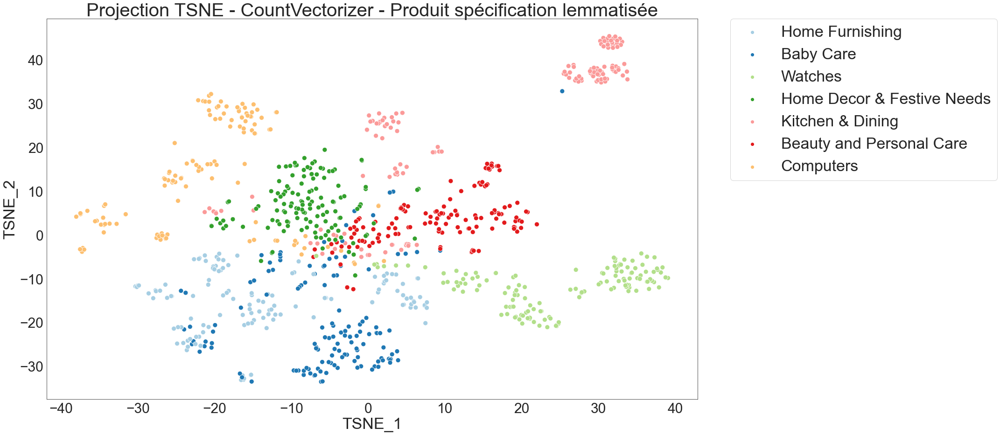

In [273]:
# Visulisation de la projection des 2 premiers variables TSNE
titre_tf = 'Projection TSNE - CountVectorizer'
titre_tf_3 = titre_tf + ' - Produit spécification lemmatisée'
outils_acp.affiche_projections_reducdim(data_work, X_proj_tsne_cv_prod_lem,
                                        'TSNE_1', 'TSNE_2', titre_tf_3)

**produit_specification** - stemmatisée

In [274]:
# t-SNE tuning du paramètre perplexity sans initialisation PCA
top_depart = time.time()
liste_param = [5, 10, 20, 30, 40, 50]
results_cv_prod_stem = list()
tsne_results_cv_prod_stem = []
for i in liste_param:
    tsne = TSNE(n_components=2, verbose=1, perplexity=i, n_iter=500,
                random_state=seed)
    tsne_results_cv_prod_stem = tsne.fit_transform(vector_countvectorizer_prod_stem)
    results_cv_prod_stem.append(tsne_results_cv_prod_stem)
print('t-SNE terminée! en : {} seconds'.format(time.time()-top_depart))

[t-SNE] Computing 16 nearest neighbors...
[t-SNE] Indexed 1050 samples in 0.000s...
[t-SNE] Computed neighbors for 1050 samples in 0.019s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1050
[t-SNE] Computed conditional probabilities for sample 1050 / 1050
[t-SNE] Mean sigma: 0.000000
[t-SNE] KL divergence after 250 iterations with early exaggeration: 71.980148
[t-SNE] KL divergence after 500 iterations: 0.845529
[t-SNE] Computing 31 nearest neighbors...
[t-SNE] Indexed 1050 samples in 0.000s...
[t-SNE] Computed neighbors for 1050 samples in 0.038s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1050
[t-SNE] Computed conditional probabilities for sample 1050 / 1050
[t-SNE] Mean sigma: 0.000000
[t-SNE] KL divergence after 250 iterations with early exaggeration: 74.430656
[t-SNE] KL divergence after 500 iterations: 0.807128
[t-SNE] Computing 61 nearest neighbors...
[t-SNE] Indexed 1050 samples in 0.000s...
[t-SNE] Computed neighbors for 1050 samples in 0.0

9:80: E501 line too long (84 > 79 characters)


[t-SNE] KL divergence after 500 iterations: 0.755467
t-SNE terminée! en : 8.313543796539307 seconds


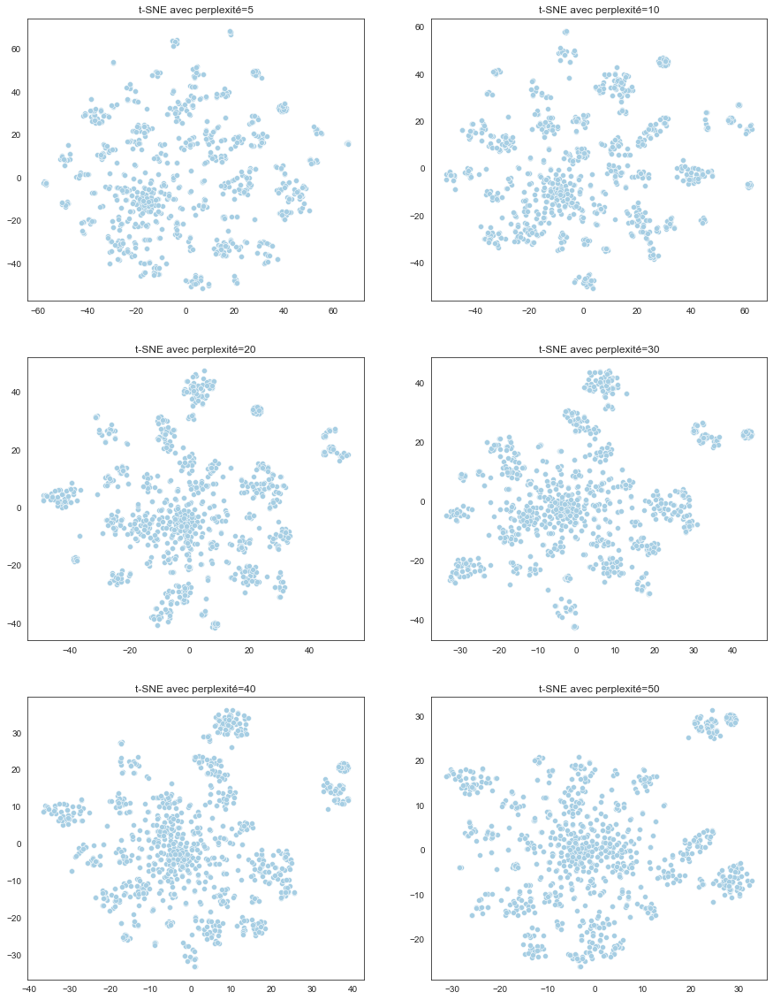

In [275]:
# Visualisation en 2D des différents résultats selon la perplexité
outils_segmentation.affiche_tsne(results_cv_prod_stem, liste_param, 1)

- groupes plus homogènes pour perplexité=40
- on laissera les paramètres learning_rate et n_iter par défaut (1000) et le nombre de composants par défaut (2).

In [101]:
%pycodestyle_off

In [102]:
# Réduction de dimension tsne
tsne_cv_prod_stem = TSNE(verbose=1, perplexity=40)
X_proj_tsne_cv_prod_stem = \
    tsne_cv_prod_stem.fit_transform(vector_countvectorizer_prod_stem)
# Dataframe pour clustering
df_tsne_cv_prod_stem = pd.DataFrame({'VAR1' : X_proj_tsne_cv_prod_stem[:, 0],
                                     'VAR2': X_proj_tsne_cv_prod_stem[:, 1],
                                     'CATEGORIE' : data_work['Categorie_1']})

[t-SNE] Computing 121 nearest neighbors...
[t-SNE] Indexed 1050 samples in 0.001s...
[t-SNE] Computed neighbors for 1050 samples in 0.031s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1050
[t-SNE] Computed conditional probabilities for sample 1050 / 1050
[t-SNE] Mean sigma: 1.849959
[t-SNE] KL divergence after 250 iterations with early exaggeration: 77.352280
[t-SNE] KL divergence after 1000 iterations: 0.761299


In [103]:
%pycodestyle_on

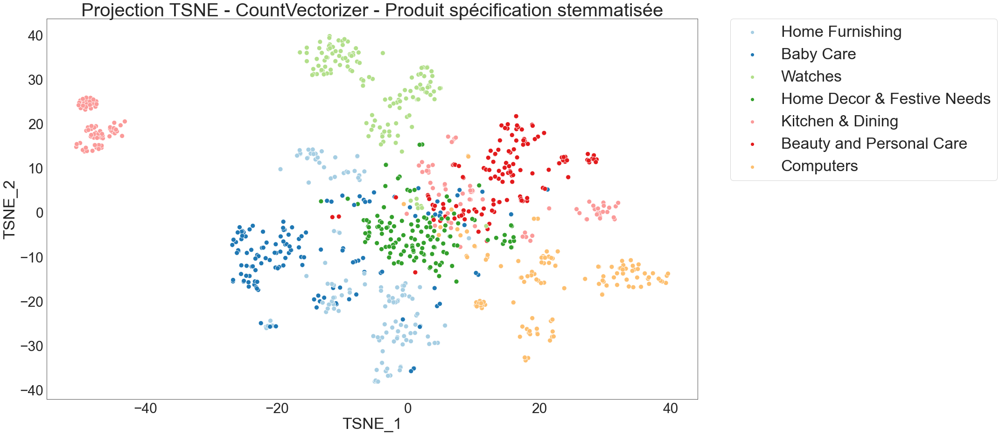

In [277]:
# Visulisation de la projection des 2 premiers variables TSNE
titre_tf = 'Projection TSNE - CountVectorizer'
titre_tf_4 = titre_tf + ' - Produit spécification stemmatisée'
outils_acp.affiche_projections_reducdim(data_work, X_proj_tsne_cv_prod_stem,
                                        'TSNE_1', 'TSNE_2', titre_tf_4)

#### <span style='background:Moccasin'>5.2.2 BOW - TfidfVectorizer</span>

**description** - lemmatisée

In [278]:
# t-SNE tuning du paramètre perplexity sans initialisation PCA
top_depart = time.time()
liste_param = [5, 10, 20, 30, 40, 50]
results_tfidf_desc_lem = list()
tsne_results_tfidf_desc_lem = []
for i in liste_param:
    tsne = TSNE(n_components=2, verbose=1, perplexity=i, n_iter=500,
                random_state=seed)
    tsne_results_tfidf_desc_lem = tsne.fit_transform(vector_tfidfvectorizer_desc_lem)
    results_tfidf_desc_lem.append(tsne_results_tfidf_desc_lem)
print('t-SNE terminée! en : {} seconds'.format(time.time()-top_depart))

[t-SNE] Computing 16 nearest neighbors...
[t-SNE] Indexed 1050 samples in 0.009s...
[t-SNE] Computed neighbors for 1050 samples in 0.017s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1050
[t-SNE] Computed conditional probabilities for sample 1050 / 1050
[t-SNE] Mean sigma: 0.142074
[t-SNE] KL divergence after 250 iterations with early exaggeration: 92.543381
[t-SNE] KL divergence after 500 iterations: 1.762938
[t-SNE] Computing 31 nearest neighbors...
[t-SNE] Indexed 1050 samples in 0.000s...
[t-SNE] Computed neighbors for 1050 samples in 0.022s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1050
[t-SNE] Computed conditional probabilities for sample 1050 / 1050
[t-SNE] Mean sigma: 0.348062
[t-SNE] KL divergence after 250 iterations with early exaggeration: 98.214767
[t-SNE] KL divergence after 500 iterations: 1.538390
[t-SNE] Computing 61 nearest neighbors...
[t-SNE] Indexed 1050 samples in 0.001s...
[t-SNE] Computed neighbors for 1050 samples in 0.0

9:80: E501 line too long (85 > 79 characters)


[t-SNE] KL divergence after 500 iterations: 1.233735
t-SNE terminée! en : 7.889953136444092 seconds


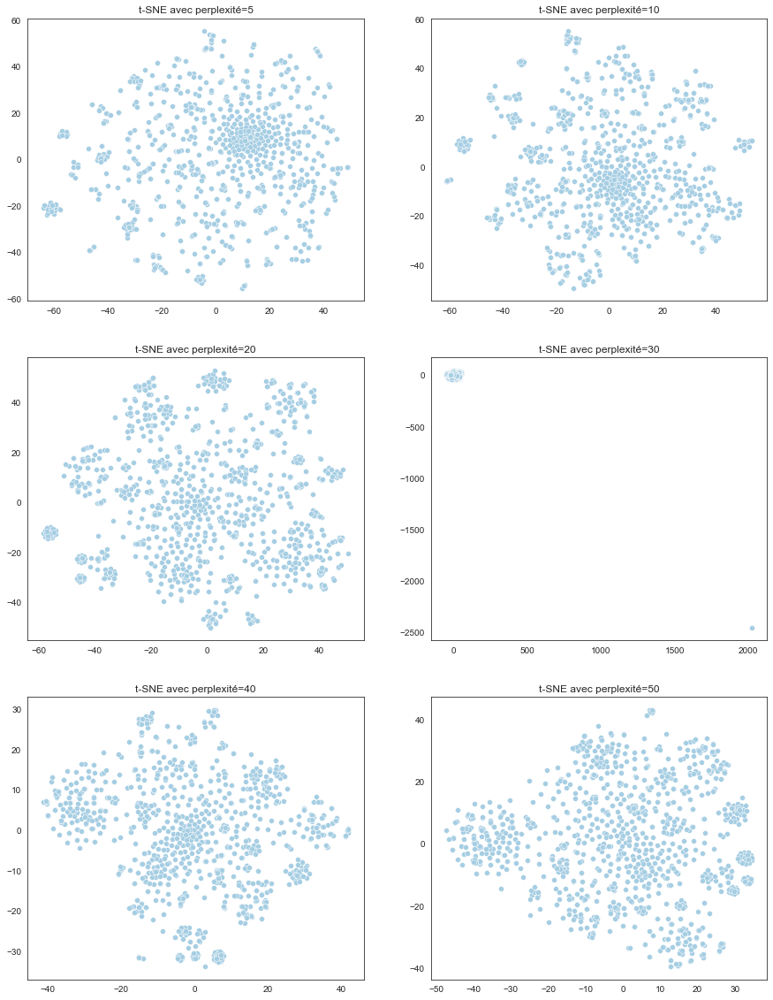

In [279]:
# Visualisation en 2D des différents résultats selon la perplexité
outils_segmentation.affiche_tsne(results_tfidf_desc_lem, liste_param, 1)

- groupes plus homogènes pour perplexité=40
- on laissera les paramètres learning_rate et n_iter par défaut (1000) et le nombre de composants par défaut (2).

In [104]:
%pycodestyle_off

In [105]:
# Réduction de dimension tsne
tsne_tfidf_desc_lem = TSNE(verbose=1, perplexity=40)
X_proj_tsne_tfidf_desc_lem = \
    tsne_tfidf_desc_lem.fit_transform(vector_tfidfvectorizer_desc_lem)
# Dataframe pour clustering
df_tsne_tfidf_desc_lem = pd.DataFrame({'VAR1' : X_proj_tsne_tfidf_desc_lem[:, 0],
                                       'VAR2': X_proj_tsne_tfidf_desc_lem[:, 1],
                                      'CATEGORIE' : data_work['Categorie_1']})

[t-SNE] Computing 121 nearest neighbors...
[t-SNE] Indexed 1050 samples in 0.000s...
[t-SNE] Computed neighbors for 1050 samples in 0.034s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1050
[t-SNE] Computed conditional probabilities for sample 1050 / 1050
[t-SNE] Mean sigma: 0.528367
[t-SNE] KL divergence after 250 iterations with early exaggeration: 89.057678
[t-SNE] KL divergence after 1000 iterations: 1.238235


In [106]:
%pycodestyle_on

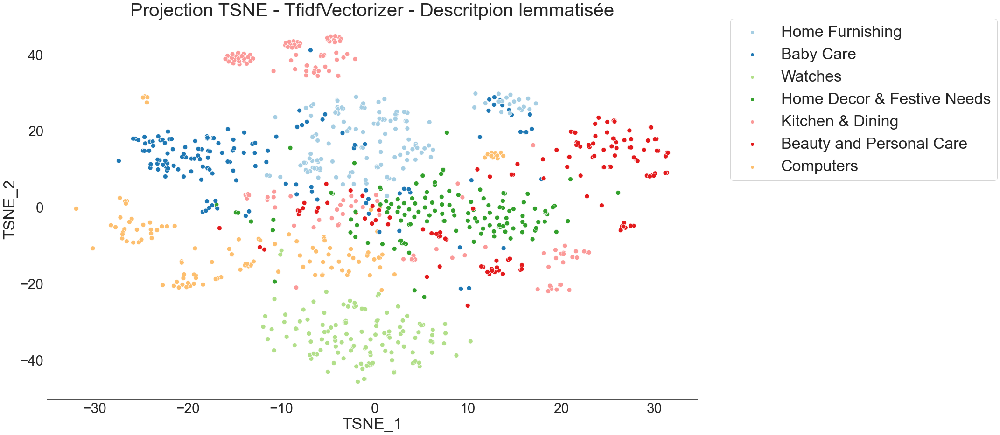

In [293]:
# Visulisation de la projection des 2 premiers variables TSNE
titre_tf = 'Projection TSNE - TfidfVectorizer'
titre_tf_5 = titre_tf + ' - Descritpion lemmatisée'
outils_acp.affiche_projections_reducdim(data_work, X_proj_tsne_tfidf_desc_lem,
                                        'TSNE_1', 'TSNE_2', titre_tf_5)

**description** - stemmatisée

In [295]:
# t-SNE tuning du paramètre perplexity sans initialisation PCA
top_depart = time.time()
liste_param = [5, 10, 20, 30, 40, 50]
results_tfidf_desc_stem = list()
tsne_results_tfidf_desc_stem = []
for i in liste_param:
    tsne = TSNE(n_components=2, verbose=1, perplexity=i, n_iter=500,
                random_state=seed)
    tsne_results_tfidf_desc_stem = tsne.fit_transform(vector_tfidfvectorizer_desc_stem)
    results_tfidf_desc_stem.append(tsne_results_tfidf_desc_stem)
print('t-SNE terminée! en : {} seconds'.format(time.time()-top_depart))

[t-SNE] Computing 16 nearest neighbors...
[t-SNE] Indexed 1050 samples in 0.000s...
[t-SNE] Computed neighbors for 1050 samples in 0.036s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1050
[t-SNE] Computed conditional probabilities for sample 1050 / 1050
[t-SNE] Mean sigma: 0.108770
[t-SNE] KL divergence after 250 iterations with early exaggeration: 94.632797
[t-SNE] KL divergence after 500 iterations: 1.725263
[t-SNE] Computing 31 nearest neighbors...
[t-SNE] Indexed 1050 samples in 0.000s...
[t-SNE] Computed neighbors for 1050 samples in 0.033s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1050
[t-SNE] Computed conditional probabilities for sample 1050 / 1050
[t-SNE] Mean sigma: 0.345090
[t-SNE] KL divergence after 250 iterations with early exaggeration: 101.577576
[t-SNE] KL divergence after 500 iterations: 1.546224
[t-SNE] Computing 61 nearest neighbors...
[t-SNE] Indexed 1050 samples in 0.001s...
[t-SNE] Computed neighbors for 1050 samples in 0.

9:80: E501 line too long (87 > 79 characters)


[t-SNE] KL divergence after 500 iterations: 1.214646
t-SNE terminée! en : 8.367127180099487 seconds


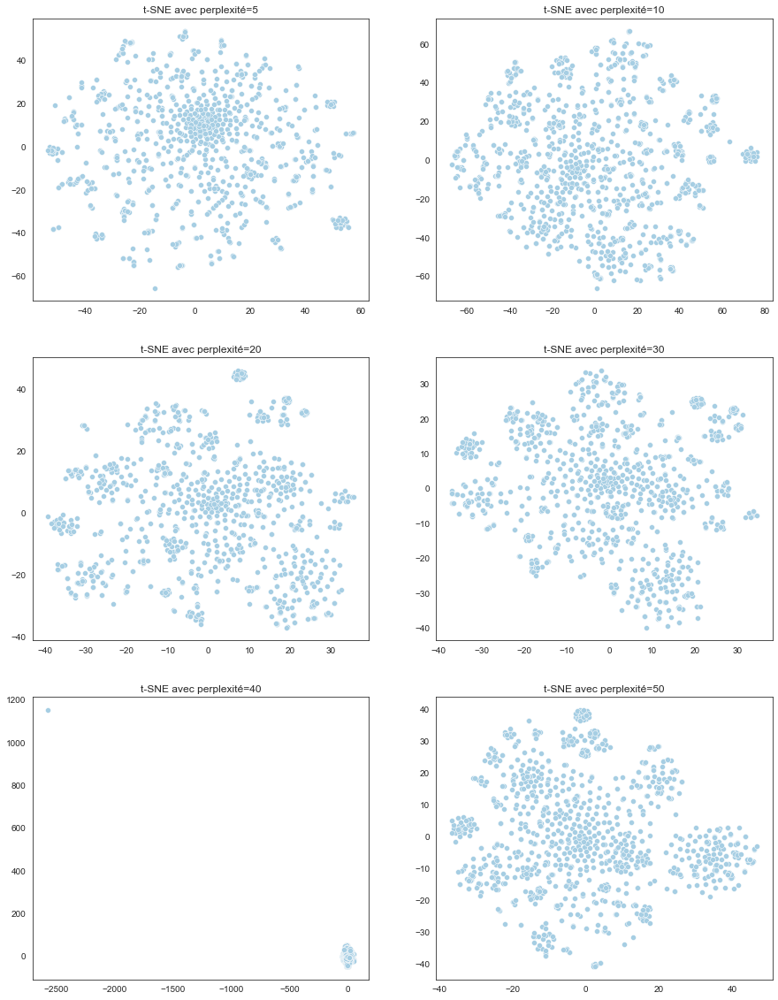

In [297]:
# Visualisation en 2D des différents résultats selon la perplexité
outils_segmentation.affiche_tsne(results_tfidf_desc_stem, liste_param, 1)

- groupes plus homogènes pour perplexité=40
- on laissera les paramètres learning_rate et n_iter par défaut (1000) et le nombre de composants par défaut (2).

In [107]:
%pycodestyle_off

In [108]:
# Réduction de dimension tsne
tsne_tfidf_desc_stem = TSNE(verbose=1, perplexity=40)
X_proj_tsne_tfidf_desc_stem = \
    tsne_tfidf_desc_stem.fit_transform(vector_tfidfvectorizer_desc_stem)
# Dataframe pour clustering
df_tsne_tfidf_desc_stem = pd.DataFrame({'VAR1' : X_proj_tsne_tfidf_desc_stem[:, 0],
                                       'VAR2': X_proj_tsne_tfidf_desc_stem[:, 1],
                                      'CATEGORIE' : data_work['Categorie_1']})

[t-SNE] Computing 121 nearest neighbors...
[t-SNE] Indexed 1050 samples in 0.000s...
[t-SNE] Computed neighbors for 1050 samples in 0.024s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1050
[t-SNE] Computed conditional probabilities for sample 1050 / 1050
[t-SNE] Mean sigma: 0.527935
[t-SNE] KL divergence after 250 iterations with early exaggeration: 92.760399
[t-SNE] KL divergence after 1000 iterations: 1.276288


In [109]:
%pycodestyle_on

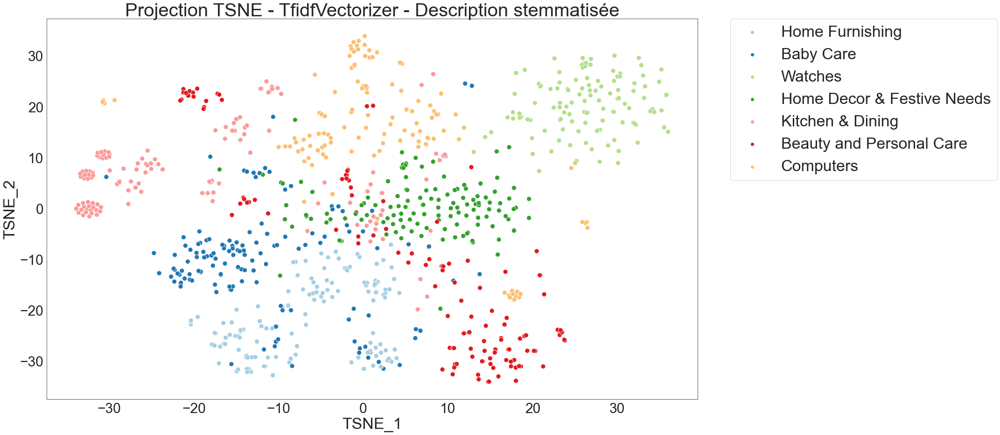

In [359]:
# Visulisation de la projection des 2 premiers variables TSNE
titre_tf = 'Projection TSNE - TfidfVectorizer'
titre_tf_6 = titre_tf + ' - Description stemmatisée'
outils_acp.affiche_projections_reducdim(data_work, X_proj_tsne_tfidf_desc_stem,
                                        'TSNE_1', 'TSNE_2', titre_tf_6)

**produit_specification** - lemmatisée

In [301]:
# t-SNE tuning du paramètre perplexity sans initialisation PCA
top_depart = time.time()
liste_param = [5, 10, 20, 30, 40, 50]
results_tfidf_prod_lem = list()
tsne_results_tfidf_prod_lem = []
for i in liste_param:
    tsne = TSNE(n_components=2, verbose=1, perplexity=i, n_iter=500,
                random_state=seed)
    tsne_results_tfidf_prod_lem = tsne.fit_transform(vector_tfidfvectorizer_prod_lem)
    results_tfidf_prod_lem.append(tsne_results_tfidf_prod_lem)
print('t-SNE terminée! en : {} seconds'.format(time.time()-top_depart))

[t-SNE] Computing 16 nearest neighbors...
[t-SNE] Indexed 1050 samples in 0.007s...
[t-SNE] Computed neighbors for 1050 samples in 0.017s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1050
[t-SNE] Computed conditional probabilities for sample 1050 / 1050
[t-SNE] Mean sigma: 0.000000
[t-SNE] KL divergence after 250 iterations with early exaggeration: 77.475845
[t-SNE] KL divergence after 500 iterations: 1.255757
[t-SNE] Computing 31 nearest neighbors...
[t-SNE] Indexed 1050 samples in 0.000s...
[t-SNE] Computed neighbors for 1050 samples in 0.032s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1050
[t-SNE] Computed conditional probabilities for sample 1050 / 1050
[t-SNE] Mean sigma: 0.000000
[t-SNE] KL divergence after 250 iterations with early exaggeration: 81.711288
[t-SNE] KL divergence after 500 iterations: 1.118741
[t-SNE] Computing 61 nearest neighbors...
[t-SNE] Indexed 1050 samples in 0.001s...
[t-SNE] Computed neighbors for 1050 samples in 0.0

9:80: E501 line too long (85 > 79 characters)


[t-SNE] KL divergence after 500 iterations: 0.854190
t-SNE terminée! en : 7.73506498336792 seconds


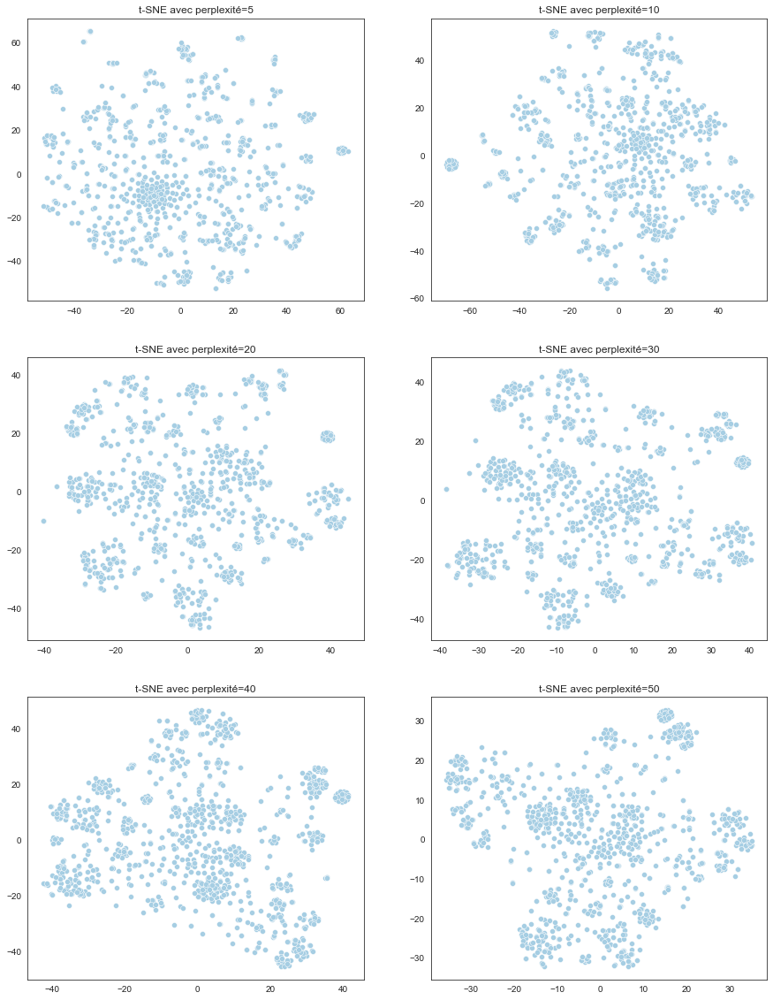

In [302]:
# Visualisation en 2D des différents résultats selon la perplexité
outils_segmentation.affiche_tsne(results_tfidf_prod_lem, liste_param, 1)

- groupes plus homogènes pour perplexité=40
- on laissera les paramètres learning_rate et n_iter par défaut (1000) et le nombre de composants par défaut (2).

In [110]:
%pycodestyle_off

In [111]:
# Réduction de dimension tsne
tsne_tfidf_prod_lem = TSNE(verbose=1, perplexity=40)
X_proj_tsne_tfidf_prod_lem = \
    tsne_tfidf_prod_lem.fit_transform(vector_tfidfvectorizer_prod_lem)
# Dataframe pour clustering
df_tsne_tfidf_prod_lem = pd.DataFrame({'VAR1' : X_proj_tsne_tfidf_prod_lem[:, 0],
                                       'VAR2': X_proj_tsne_tfidf_prod_lem[:, 1],
                                       'CATEGORIE' : data_work['Categorie_1']})

[t-SNE] Computing 121 nearest neighbors...
[t-SNE] Indexed 1050 samples in 0.000s...
[t-SNE] Computed neighbors for 1050 samples in 0.035s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1050
[t-SNE] Computed conditional probabilities for sample 1050 / 1050
[t-SNE] Mean sigma: 0.487317
[t-SNE] KL divergence after 250 iterations with early exaggeration: 77.917450
[t-SNE] KL divergence after 1000 iterations: 0.880300


In [113]:
%pycodestyle_on

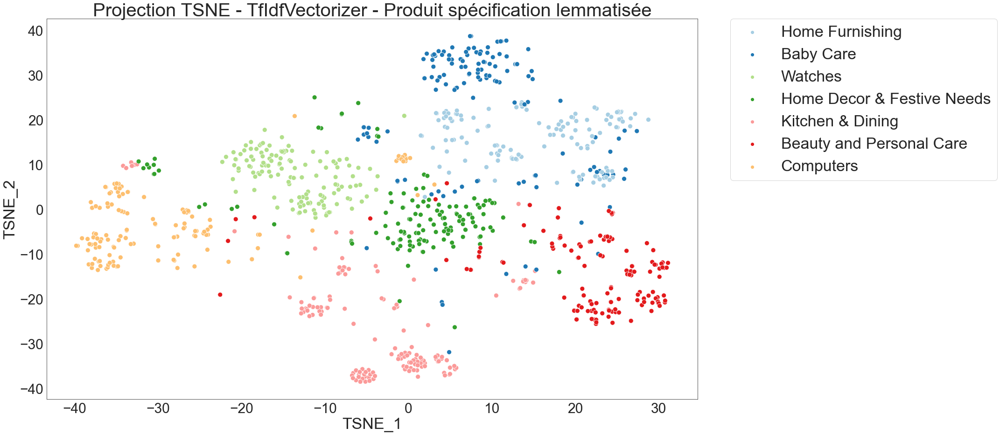

In [304]:
# Visulisation de la projection des 2 premiers variables TSNE
titre_tf = 'Projection TSNE - TfIdfVectorizer'
titre_tf_7 = titre_tf + ' - Produit spécification lemmatisée'
outils_acp.affiche_projections_reducdim(data_work, X_proj_tsne_tfidf_prod_lem,
                                        'TSNE_1', 'TSNE_2', titre_tf_7)

**produit_specification** - stemmatisée

In [305]:
# t-SNE tuning du paramètre perplexity sans initialisation PCA
top_depart = time.time()
liste_param = [5, 10, 20, 30, 40, 50]
results_tfidf_prod_stem = list()
tsne_results_tfidf_prod_stem = []
for i in liste_param:
    tsne = TSNE(n_components=2, verbose=1, perplexity=i, n_iter=500,
                random_state=seed)
    tsne_results_tfidf_prod_stem = tsne.fit_transform(vector_tfidfvectorizer_prod_stem)
    results_tfidf_prod_stem.append(tsne_results_tfidf_prod_stem)
print('t-SNE terminée! en : {} seconds'.format(time.time()-top_depart))

[t-SNE] Computing 16 nearest neighbors...
[t-SNE] Indexed 1050 samples in 0.001s...
[t-SNE] Computed neighbors for 1050 samples in 0.016s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1050
[t-SNE] Computed conditional probabilities for sample 1050 / 1050
[t-SNE] Mean sigma: 0.000000
[t-SNE] KL divergence after 250 iterations with early exaggeration: 76.932701
[t-SNE] KL divergence after 500 iterations: 1.232023
[t-SNE] Computing 31 nearest neighbors...
[t-SNE] Indexed 1050 samples in 0.000s...
[t-SNE] Computed neighbors for 1050 samples in 0.037s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1050
[t-SNE] Computed conditional probabilities for sample 1050 / 1050
[t-SNE] Mean sigma: 0.000000
[t-SNE] KL divergence after 250 iterations with early exaggeration: 81.713058
[t-SNE] KL divergence after 500 iterations: 1.116898
[t-SNE] Computing 61 nearest neighbors...
[t-SNE] Indexed 1050 samples in 0.000s...
[t-SNE] Computed neighbors for 1050 samples in 0.0

9:80: E501 line too long (87 > 79 characters)


[t-SNE] KL divergence after 500 iterations: 0.852226
t-SNE terminée! en : 8.019707679748535 seconds


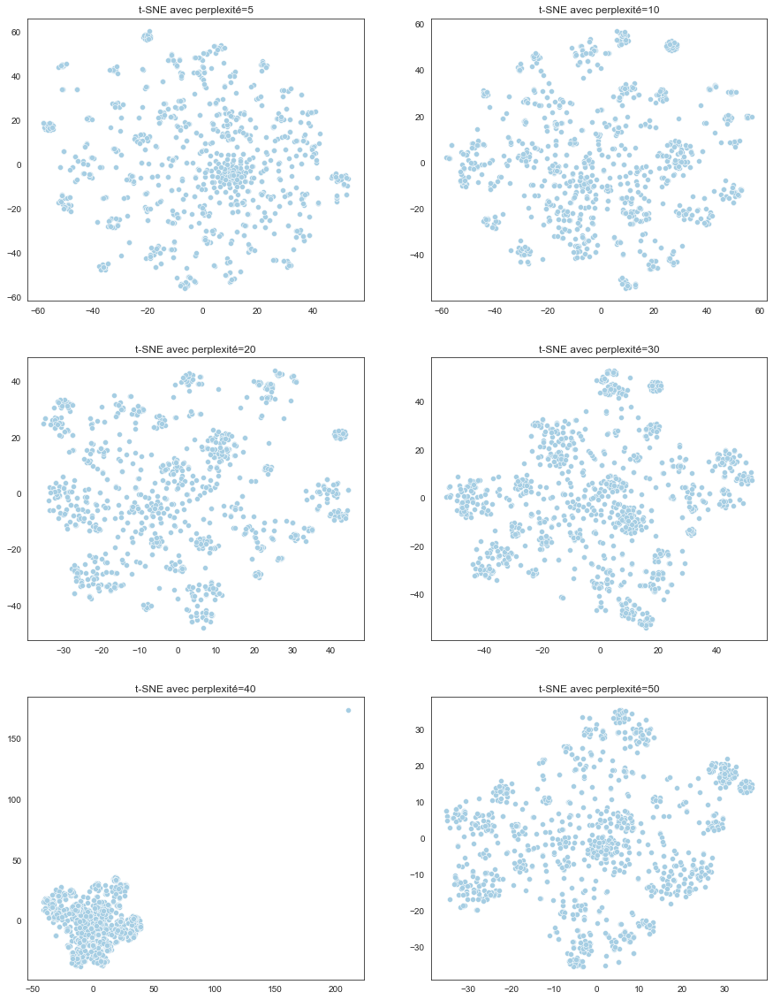

In [306]:
# Visualisation en 2D des différents résultats selon la perplexité
outils_segmentation.affiche_tsne(results_tfidf_prod_stem, liste_param, 1)

- groupes plus homogènes pour perplexité=40
- on laissera les paramètres learning_rate et n_iter par défaut (1000) et le nombre de composants par défaut (2).

In [114]:
%pycodestyle_off

In [115]:
# Réduction de dimension tsne
tsne_tfidf_prod_stem = TSNE(verbose=1, perplexity=40)
X_proj_tsne_tfidf_prod_stem = \
    tsne_tfidf_prod_stem.fit_transform(vector_tfidfvectorizer_prod_stem)
# Dataframe pour clustering
df_tsne_tfidf_prod_stem = pd.DataFrame({'VAR1' : X_proj_tsne_tfidf_prod_stem[:, 0],
                                        'VAR2': X_proj_tsne_tfidf_prod_stem[:, 1],
                                        'CATEGORIE' : data_work['Categorie_1']})

[t-SNE] Computing 121 nearest neighbors...
[t-SNE] Indexed 1050 samples in 0.000s...
[t-SNE] Computed neighbors for 1050 samples in 0.035s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1050
[t-SNE] Computed conditional probabilities for sample 1050 / 1050
[t-SNE] Mean sigma: 0.485824
[t-SNE] KL divergence after 250 iterations with early exaggeration: 78.289322
[t-SNE] KL divergence after 1000 iterations: 0.856560


In [116]:
%pycodestyle_on

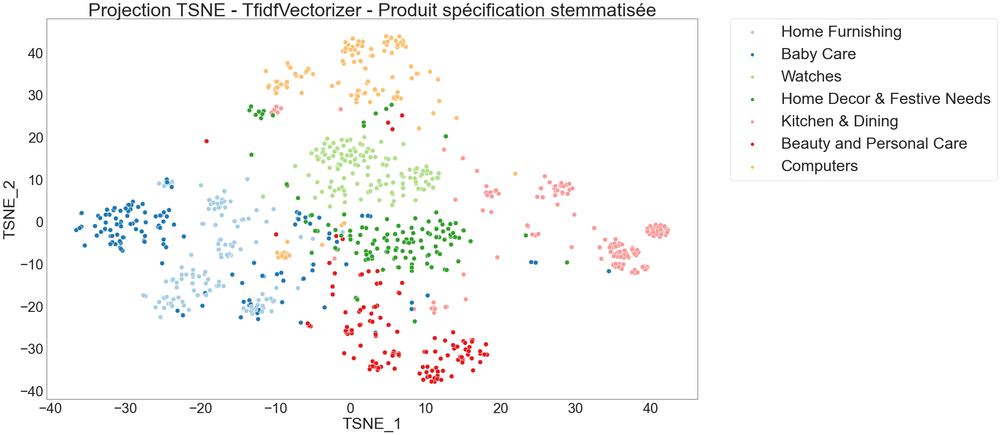

In [308]:
# Visulisation de la projection des 2 premiers variables TSNE
titre_tf = 'Projection TSNE - TfidfVectorizer'
titre_tf_8 = titre_tf + ' - Produit spécification stemmatisée'
outils_acp.affiche_projections_reducdim(data_work, X_proj_tsne_tfidf_prod_stem,
                                        'TSNE_1', 'TSNE_2', titre_tf_8)

#### <span style='background:Moccasin'>5.2.3 BOW - HashingfVectorizer</span>

**description** - lemmatisée

In [168]:
# t-SNE tuning du paramètre perplexity sans initialisation PCA
top_depart = time.time()
liste_param = [5, 10, 20, 30, 40, 50]
results_hash_desc_lem = list()
tsne_results_hash_desc_lem = []
for i in liste_param:
    tsne = TSNE(n_components=2, verbose=1, perplexity=i, n_iter=500,
                random_state=seed)
    tsne_results_hash_desc_lem = tsne.fit_transform(X_vector_hash_desc_lem)
    results_hash_desc_lem.append(tsne_results_hash_desc_lem)
print('t-SNE terminée! en : {} seconds'.format(time.time()-top_depart))

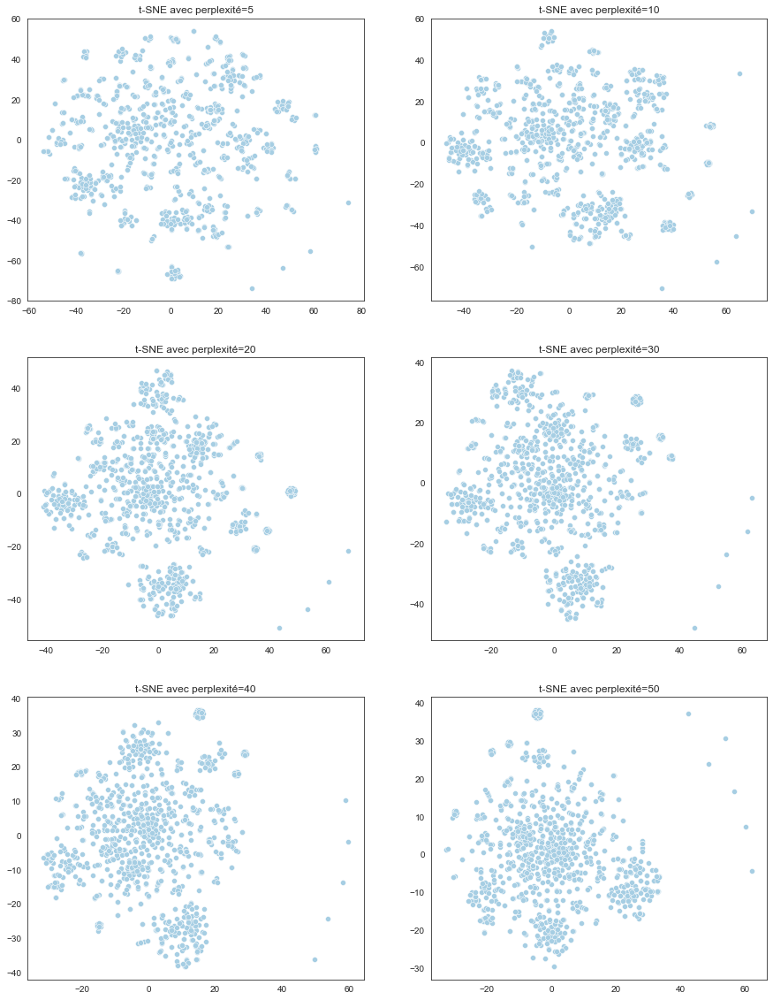

In [170]:
# Visualisation en 2D des différents résultats selon la perplexité
outils_segmentation.affiche_tsne(results_hash_desc_lem, liste_param, 1)

- groupes plus homogènes pour perplexité=40
- on laissera les paramètres learning_rate et n_iter par défaut (1000) et le nombre de composants par défaut (2).

In [117]:
%pycodestyle_off

In [118]:
# Réduction de dimension tsne
tsne_hash_desc_lem = TSNE(verbose=1, perplexity=40)
X_proj_tsne_hash_desc_lem = \
    tsne_hash_desc_lem.fit_transform(X_vector_hash_desc_lem)
# Dataframe pour clustering
df_tsne_hash_desc_lem = pd.DataFrame({'VAR1' : X_proj_tsne_hash_desc_lem[:, 0],
                                      'VAR2' : X_proj_tsne_hash_desc_lem[:, 1],
                                      'CATEGORIE' : data_work['Categorie_1']})

[t-SNE] Computing 121 nearest neighbors...
[t-SNE] Indexed 1050 samples in 0.360s...
[t-SNE] Computed neighbors for 1050 samples in 3.937s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1050
[t-SNE] Computed conditional probabilities for sample 1050 / 1050
[t-SNE] Mean sigma: 1.609040
[t-SNE] KL divergence after 250 iterations with early exaggeration: 80.270370
[t-SNE] KL divergence after 1000 iterations: 0.966275


In [120]:
%pycodestyle_on

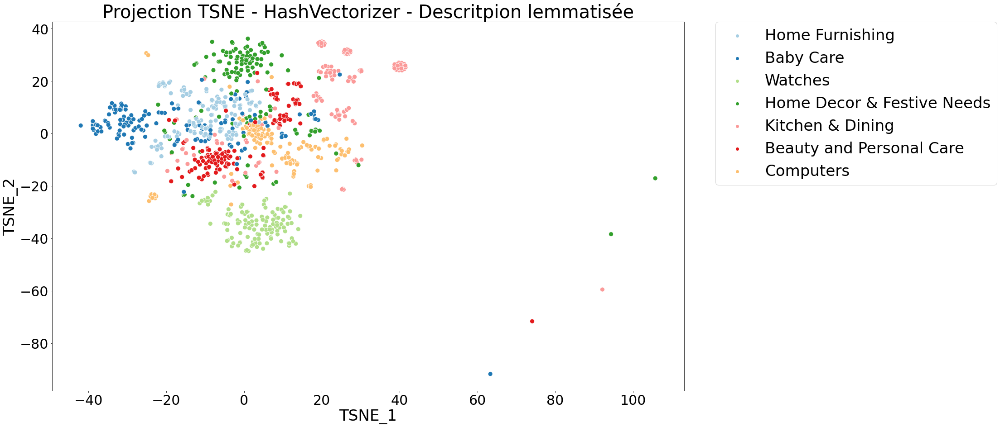

In [144]:
# Visulisation de la projection des 2 premiers variables TSNE
titre_tf_hash = 'Projection TSNE - HashVectorizer'
titre_hash_1 = titre_tf_hash + ' - Descritpion lemmatisée'
outils_acp.affiche_projections_reducdim(data_work, X_proj_tsne_hash_desc_lem,
                                        'TSNE_1', 'TSNE_2', titre_hash_1)

**description** - stemmatisée

In [121]:
%pycodestyle_off

In [122]:
# Réduction de dimension tsne
tsne_hash_desc_stem = TSNE(verbose=1, perplexity=40)
X_proj_tsne_hash_desc_stem = \
    tsne_hash_desc_stem.fit_transform(X_vector_hash_desc_stem)
# Dataframe pour clustering
df_tsne_hash_desc_stem = pd.DataFrame({'VAR1' : X_proj_tsne_hash_desc_stem[:, 0],
                                        'VAR2' : X_proj_tsne_hash_desc_stem[:, 1],
                                        'CATEGORIE' : data_work['Categorie_1']})

[t-SNE] Computing 121 nearest neighbors...
[t-SNE] Indexed 1050 samples in 0.325s...
[t-SNE] Computed neighbors for 1050 samples in 3.556s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1050
[t-SNE] Computed conditional probabilities for sample 1050 / 1050
[t-SNE] Mean sigma: 1.620496
[t-SNE] KL divergence after 250 iterations with early exaggeration: 78.999573
[t-SNE] KL divergence after 1000 iterations: 0.955092


In [123]:
%pycodestyle_on

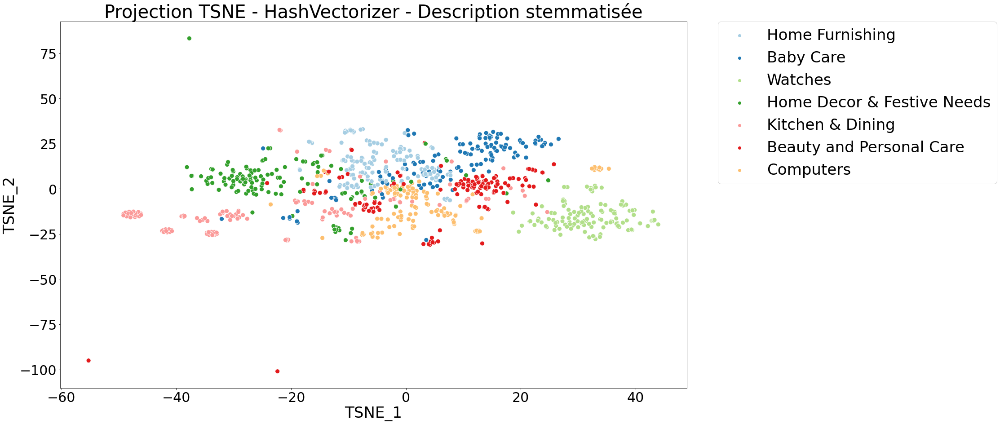

In [148]:
# Visulisation de la projection des 2 premiers variables TSNE
titre_hash_2 = titre_tf_hash + ' - Description stemmatisée'
outils_acp.affiche_projections_reducdim(data_work, X_proj_tsne_hash_desc_stem,
                                        'TSNE_1', 'TSNE_2', titre_hash_2)

**produit_specification** - lemmatisée

In [124]:
%pycodestyle_off

In [125]:
# Réduction de dimension tsne
tsne_hash_prod_lem = TSNE(verbose=1, perplexity=40)
X_proj_tsne_hash_prod_lem = \
    tsne_hash_prod_lem.fit_transform(X_vector_hash_prod_lem)
# Dataframe pour clustering
df_tsne_hash_prod_lem = pd.DataFrame({'VAR1' : X_proj_tsne_hash_prod_lem[:, 0],
                                      'VAR2' : X_proj_tsne_hash_prod_lem[:, 1],
                                      'CATEGORIE' : data_work['Categorie_1']})

[t-SNE] Computing 121 nearest neighbors...
[t-SNE] Indexed 1050 samples in 0.204s...
[t-SNE] Computed neighbors for 1050 samples in 2.190s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1050
[t-SNE] Computed conditional probabilities for sample 1050 / 1050
[t-SNE] Mean sigma: 1.833884
[t-SNE] KL divergence after 250 iterations with early exaggeration: 78.695770
[t-SNE] KL divergence after 1000 iterations: 0.789109


In [126]:
%pycodestyle_on

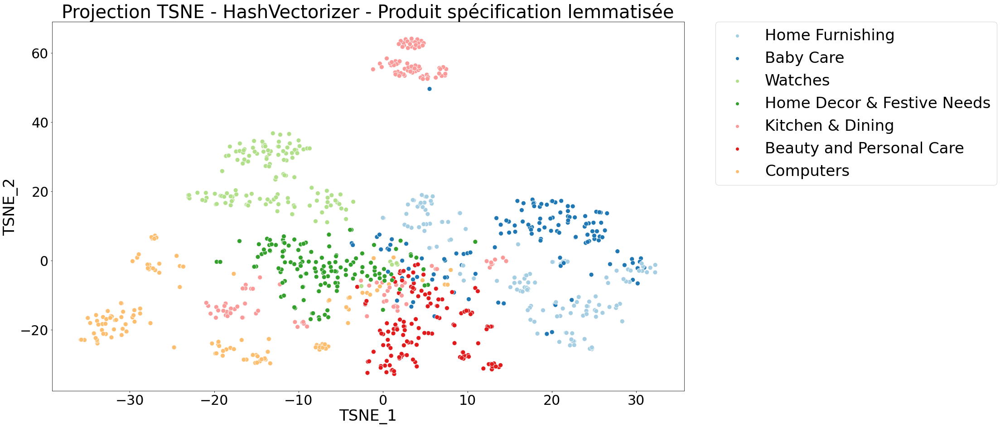

In [153]:
# Visulisation de la projection des 2 premiers variables TSNE
titre_hash_3 = titre_tf_hash + ' - Produit spécification lemmatisée'
outils_acp.affiche_projections_reducdim(data_work, X_proj_tsne_hash_prod_lem,
                                        'TSNE_1', 'TSNE_2', titre_hash_3)

**produit_specification** - stemmatisée

In [127]:
%pycodestyle_off

In [128]:
# Réduction de dimension tsne
tsne_hash_prod_stem = TSNE(verbose=1, perplexity=40)
X_proj_tsne_hash_prod_stem = \
    tsne_hash_prod_stem.fit_transform(X_vector_hash_prod_stem)
# Dataframe pour clustering
df_tsne_hash_prod_stem = pd.DataFrame({'VAR1' : X_proj_tsne_hash_prod_stem[:, 0],
                                        'VAR2' : X_proj_tsne_hash_prod_stem[:, 1],
                                        'CATEGORIE' : data_work['Categorie_1']})

[t-SNE] Computing 121 nearest neighbors...
[t-SNE] Indexed 1050 samples in 0.196s...
[t-SNE] Computed neighbors for 1050 samples in 2.055s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1050
[t-SNE] Computed conditional probabilities for sample 1050 / 1050
[t-SNE] Mean sigma: 1.848677
[t-SNE] KL divergence after 250 iterations with early exaggeration: 77.127319
[t-SNE] KL divergence after 1000 iterations: 0.772671


In [129]:
%pycodestyle_on

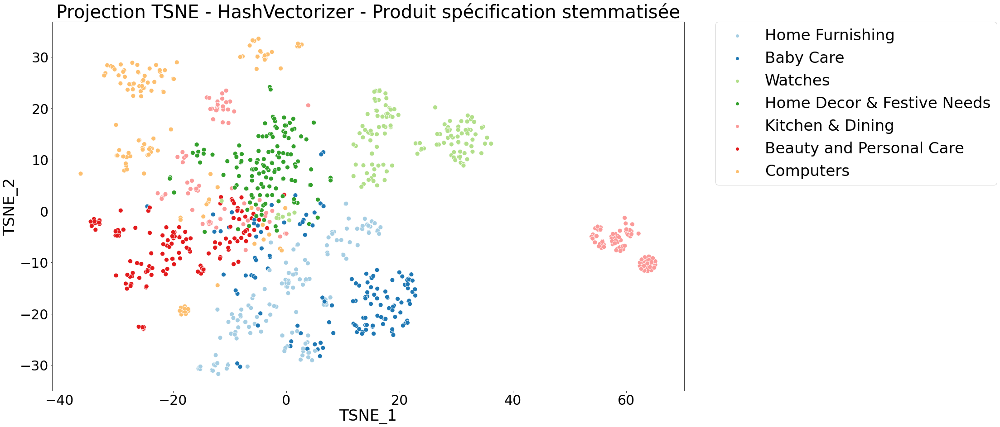

In [157]:
# Visulisation de la projection des 2 premiers variables TSNE
titre_hash_4 = titre_tf_hash + ' - Produit spécification stemmatisée'
outils_acp.affiche_projections_reducdim(data_work, X_proj_tsne_hash_prod_stem,
                                        'TSNE_1', 'TSNE_2', titre_hash_4)

#### <span style='background:Moccasin'>5.2.4 Word2vec</span>

**description** - lemmatisée

In [130]:
# t-SNE tuning du paramètre perplexity sans initialisation PCA
top_depart = time.time()
liste_param = [5, 10, 20, 30, 40, 50]
results_w2v_desc_lem = list()
tsne_results_w2v_desc_lem = []
for i in liste_param:
    tsne = TSNE(n_components=2, verbose=1, perplexity=i, n_iter=500,
                random_state=seed)
    tsne_results_w2v_desc_lem = tsne.fit_transform(vector_w2v_desc_lem)
    results_w2v_desc_lem.append(tsne_results_w2v_desc_lem)
print('t-SNE terminée! en : {} seconds'.format(time.time()-top_depart))

[t-SNE] Computing 16 nearest neighbors...
[t-SNE] Indexed 1050 samples in 0.039s...
[t-SNE] Computed neighbors for 1050 samples in 0.216s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1050
[t-SNE] Computed conditional probabilities for sample 1050 / 1050
[t-SNE] Mean sigma: 0.000000
[t-SNE] KL divergence after 250 iterations with early exaggeration: 63.690948
[t-SNE] KL divergence after 500 iterations: 0.604370
[t-SNE] Computing 31 nearest neighbors...
[t-SNE] Indexed 1050 samples in 0.052s...
[t-SNE] Computed neighbors for 1050 samples in 0.260s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1050
[t-SNE] Computed conditional probabilities for sample 1050 / 1050
[t-SNE] Mean sigma: 0.000000
[t-SNE] KL divergence after 250 iterations with early exaggeration: 61.300396
[t-SNE] KL divergence after 500 iterations: 0.563685
[t-SNE] Computing 61 nearest neighbors...
[t-SNE] Indexed 1050 samples in 0.053s...
[t-SNE] Computed neighbors for 1050 samples in 0.3

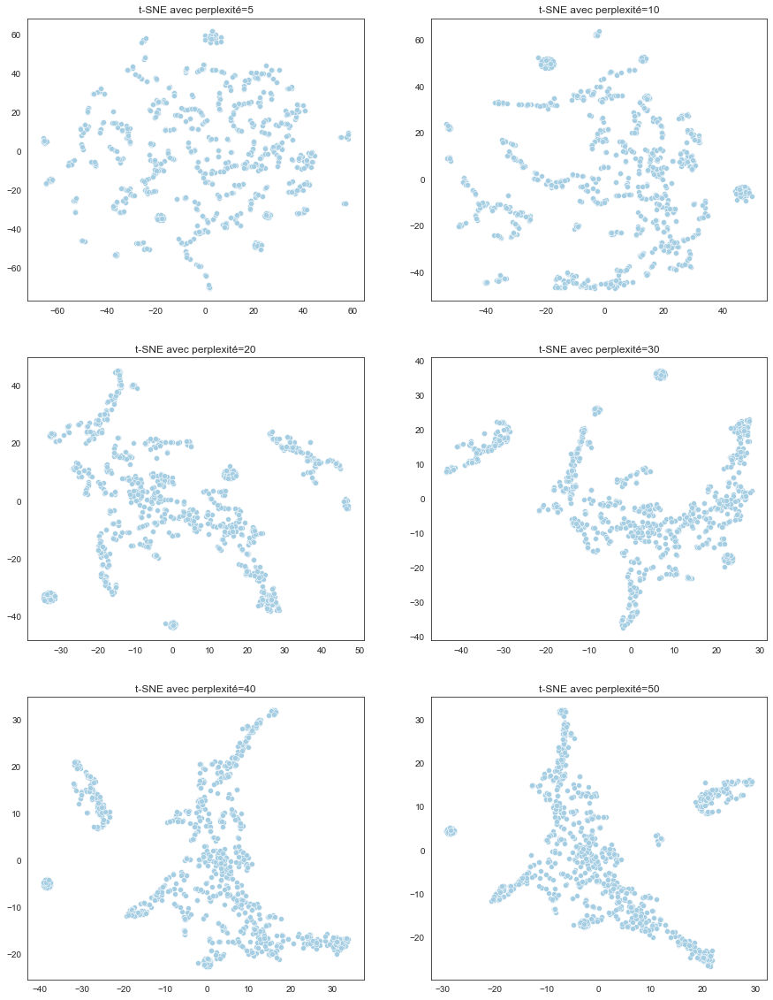

In [234]:
# Visualisation en 2D des différents résultats selon la perplexité
outils_segmentation.affiche_tsne(results_w2v_desc_lem, liste_param, 1)

- groupes plus homogènes pour perplexité=50
- on laissera les paramètres learning_rate et n_iter par défaut (1000) et le nombre de composants par défaut (2).

In [131]:
%pycodestyle_off

In [132]:
# Réduction de dimension tsne
tsne_w2v_desc_lem = TSNE(verbose=1, perplexity=50)
X_proj_tsne_w2v_desc_lem = \
    tsne_w2v_desc_lem.fit_transform(vector_w2v_desc_lem)
# Dataframe pour clustering
df_tsne_w2v_desc_lem = pd.DataFrame({'VAR1' : X_proj_tsne_w2v_desc_lem[:, 0],
                                     'VAR2' : X_proj_tsne_w2v_desc_lem[:, 1],
                                     'CATEGORIE' : data_work['Categorie_1']})

[t-SNE] Computing 151 nearest neighbors...
[t-SNE] Indexed 1050 samples in 0.043s...
[t-SNE] Computed neighbors for 1050 samples in 0.473s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1050
[t-SNE] Computed conditional probabilities for sample 1050 / 1050
[t-SNE] Mean sigma: 0.071123
[t-SNE] KL divergence after 250 iterations with early exaggeration: 52.809593
[t-SNE] KL divergence after 1000 iterations: 0.353223


In [134]:
%pycodestyle_on

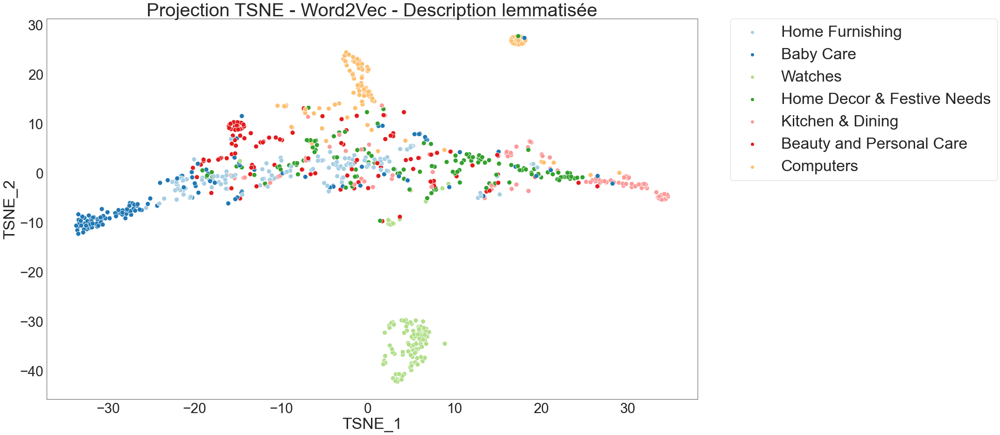

In [249]:
# Visulisation de la projection des 2 premiers variables TSNE
titre_w2v = 'Projection TSNE - Word2Vec'
titre_w2v_1 = titre_w2v + ' - Description lemmatisée'
outils_acp.affiche_projections_reducdim(data_work, X_proj_tsne_w2v_desc_lem,
                                        'TSNE_1', 'TSNE_2', titre_w2v_1)

**description** - stemmatisée

In [135]:
%pycodestyle_off

In [136]:
# Réduction de dimension tsne
tsne_w2v_desc_stem = TSNE(verbose=1, perplexity=50)
X_proj_tsne_w2v_desc_stem = \
    tsne_w2v_desc_stem.fit_transform(vector_w2v_desc_lem)
# Dataframe pour clustering
df_tsne_w2v_desc_stem = pd.DataFrame({'VAR1' : X_proj_tsne_w2v_desc_stem[:, 0],
                                      'VAR2' : X_proj_tsne_w2v_desc_stem[:, 1],
                                      'CATEGORIE' : data_work['Categorie_1']})

[t-SNE] Computing 151 nearest neighbors...
[t-SNE] Indexed 1050 samples in 0.037s...
[t-SNE] Computed neighbors for 1050 samples in 0.475s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1050
[t-SNE] Computed conditional probabilities for sample 1050 / 1050
[t-SNE] Mean sigma: 0.071123
[t-SNE] KL divergence after 250 iterations with early exaggeration: 52.849884
[t-SNE] KL divergence after 1000 iterations: 0.357223


In [137]:
%pycodestyle_on

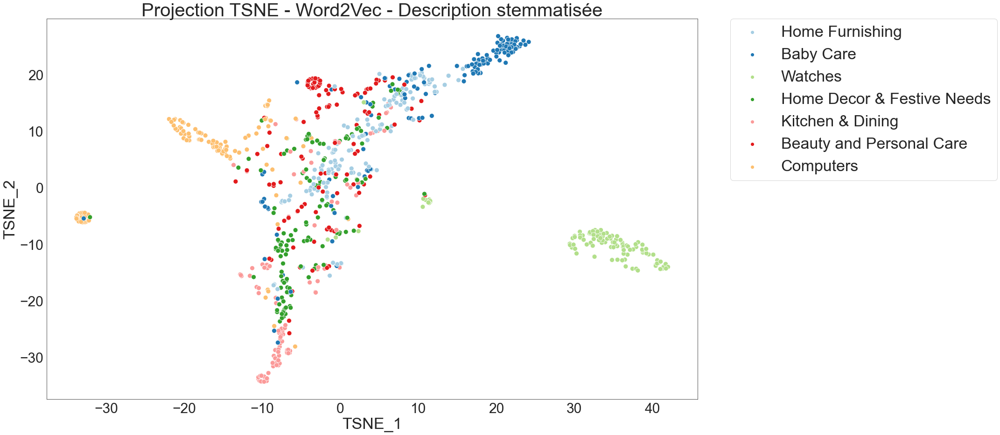

In [259]:
# Visulisation de la projection des 2 premiers variables TSNE
titre_w2v_2 = titre_w2v + ' - Description stemmatisée'
outils_acp.affiche_projections_reducdim(data_work, X_proj_tsne_w2v_desc_stem,
                                        'TSNE_1', 'TSNE_2', titre_w2v_2)

**produit_specification** - lemmatisée

**CBOW**

In [138]:
%pycodestyle_off

In [139]:
# Réduction de dimension tsne
tsne_w2v_prod_lem = TSNE(verbose=1, perplexity=50)
X_proj_tsne_w2v_prod_lem = \
    tsne_w2v_prod_lem.fit_transform(vector_w2v_prod_lem)
# Dataframe pour clustering
df_tsne_w2v_prod_lem = pd.DataFrame({'VAR1' : X_proj_tsne_w2v_prod_lem[:, 0],
                                     'VAR2' : X_proj_tsne_w2v_prod_lem[:, 1],
                                     'CATEGORIE' : data_work['Categorie_1']})

[t-SNE] Computing 151 nearest neighbors...
[t-SNE] Indexed 1050 samples in 0.039s...
[t-SNE] Computed neighbors for 1050 samples in 0.510s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1050
[t-SNE] Computed conditional probabilities for sample 1050 / 1050
[t-SNE] Mean sigma: 0.014130
[t-SNE] KL divergence after 250 iterations with early exaggeration: 49.965427
[t-SNE] KL divergence after 1000 iterations: 0.293428


In [140]:
%pycodestyle_on

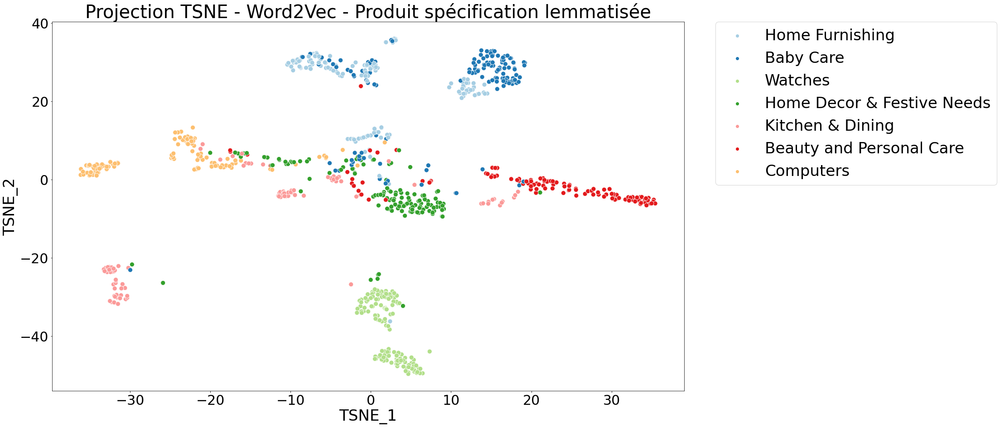

In [176]:
# Visulisation de la projection des 2 premiers variables TSNE
titre_w2v_3 = titre_w2v + ' - Produit spécification lemmatisée'
outils_acp.affiche_projections_reducdim(data_work, X_proj_tsne_w2v_prod_lem,
                                        'TSNE_1', 'TSNE_2', titre_w2v_3)

**Skip-gramm**

In [141]:
%pycodestyle_off

In [142]:
# Réduction de dimension tsne
tsne_w2v_prod_lem_sg = TSNE(verbose=1, perplexity=50)
X_proj_tsne_w2v_prod_lem_sg = \
    tsne_w2v_prod_lem_sg.fit_transform(vector_w2v_prod_lem_sg)
# Dataframe pour clustering
df_tsne_w2v_prod_lem_sg = pd.DataFrame({'VAR1' : X_proj_tsne_w2v_prod_lem_sg[:, 0],
                                        'VAR2' : X_proj_tsne_w2v_prod_lem_sg[:, 1],
                                        'CATEGORIE' : data_work['Categorie_1']})

[t-SNE] Computing 151 nearest neighbors...
[t-SNE] Indexed 1050 samples in 0.036s...
[t-SNE] Computed neighbors for 1050 samples in 0.431s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1050
[t-SNE] Computed conditional probabilities for sample 1050 / 1050
[t-SNE] Mean sigma: 0.101308
[t-SNE] KL divergence after 250 iterations with early exaggeration: 50.292305
[t-SNE] KL divergence after 1000 iterations: 0.280516


In [143]:
%pycodestyle_on

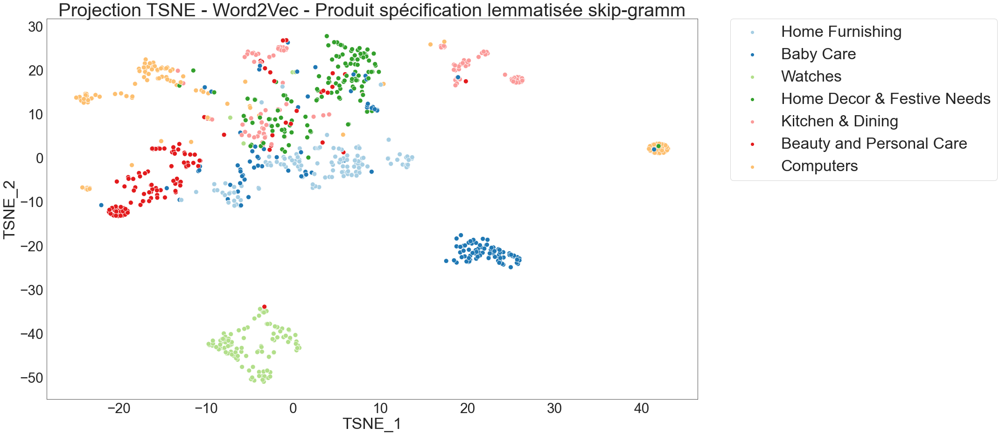

In [204]:
# Visulisation de la projection des 2 premiers variables TSNE
titre_w2v_3_sg = titre_w2v + ' - Produit spécification lemmatisée skip-gramm'
outils_acp.affiche_projections_reducdim(data_work, X_proj_tsne_w2v_prod_lem_sg,
                                        'TSNE_1', 'TSNE_2', titre_w2v_3_sg)

**produit_specification** - stemmatisée

In [144]:
%pycodestyle_off

In [145]:
# Réduction de dimension tsne
tsne_w2v_prod_stem = TSNE(verbose=1, perplexity=50)
X_proj_tsne_w2v_prod_stem = \
    tsne_w2v_prod_stem.fit_transform(X_vector_hash_prod_stem)
# Dataframe pour clustering
df_tsne_w2v_prod_stem = pd.DataFrame({'VAR1' : X_proj_tsne_w2v_prod_stem[:, 0],
                                      'VAR2' : X_proj_tsne_w2v_prod_stem[:, 1],
                                      'CATEGORIE' : data_work['Categorie_1']})

[t-SNE] Computing 151 nearest neighbors...
[t-SNE] Indexed 1050 samples in 0.196s...
[t-SNE] Computed neighbors for 1050 samples in 2.110s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1050
[t-SNE] Computed conditional probabilities for sample 1050 / 1050
[t-SNE] Mean sigma: 1.930593
[t-SNE] KL divergence after 250 iterations with early exaggeration: 77.978798
[t-SNE] KL divergence after 1000 iterations: 0.754671


In [146]:
%pycodestyle_on

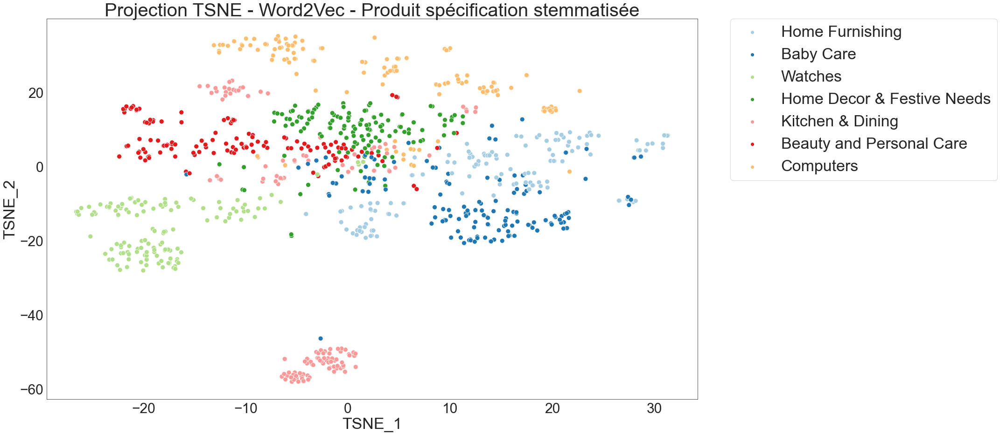

In [263]:
# Visualisation de la projection des 2 premiers variables TSNE
titre_w2v_4 = titre_w2v + ' - Produit spécification stemmatisée'
outils_acp.affiche_projections_reducdim(data_work, X_proj_tsne_w2v_prod_stem,
                                        'TSNE_1', 'TSNE_2', titre_w2v_4)

### <span style='background:PowderBlue'>5.3. ACP puis TSNE</span>

#### <span style='background:Moccasin'>5.3.1 BOW - CountVectorizer</span>

**description** - lemmatisée

In [313]:
# t-SNE tuning du paramètre perplexity avec initialisation PCA
top_depart = time.time()
liste_param = [5, 10, 20, 30, 40, 50]
results_cv_desc_lem = list()
acptsne_results_cv_desc_lem = []
for i in liste_param:
    tsne = TSNE(n_components=2, verbose=1, perplexity=i, n_iter=500,
                random_state=seed)
    acptsne_results_cv_desc_lem = tsne.fit_transform(X_proj_acp_cv_desc_lem)
    results_cv_desc_lem.append(acptsne_results_cv_desc_lem)
print('t-SNE terminée! en : {} seconds'.format(time.time()-top_depart))

[t-SNE] Computing 16 nearest neighbors...
[t-SNE] Indexed 1050 samples in 0.017s...
[t-SNE] Computed neighbors for 1050 samples in 0.306s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1050
[t-SNE] Computed conditional probabilities for sample 1050 / 1050
[t-SNE] Mean sigma: 0.029702
[t-SNE] KL divergence after 250 iterations with early exaggeration: 72.882858
[t-SNE] KL divergence after 500 iterations: 0.727327
[t-SNE] Computing 31 nearest neighbors...
[t-SNE] Indexed 1050 samples in 0.030s...
[t-SNE] Computed neighbors for 1050 samples in 0.342s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1050
[t-SNE] Computed conditional probabilities for sample 1050 / 1050
[t-SNE] Mean sigma: 0.058124
[t-SNE] KL divergence after 250 iterations with early exaggeration: 71.211502
[t-SNE] KL divergence after 500 iterations: 0.698622
[t-SNE] Computing 61 nearest neighbors...
[t-SNE] Indexed 1050 samples in 0.032s...
[t-SNE] Computed neighbors for 1050 samples in 0.3

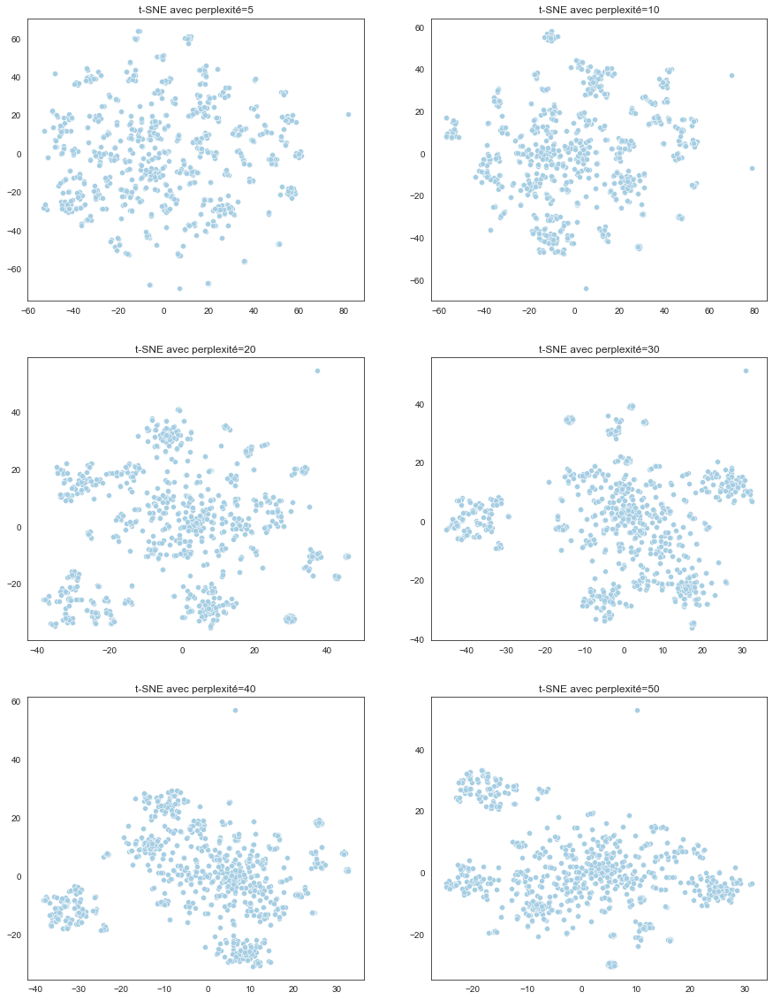

In [314]:
# Visualisation en 2D des différents résultats selon la perplexité
outils_segmentation.affiche_tsne(results_cv_desc_lem, liste_param, 1)

- groupes plus homogènes pour perplexité=30
- on laissera les paramètres learning_rate et n_iter par défaut (1000) et le nombre de composants par défaut (2).

In [147]:
%pycodestyle_off

In [148]:
# Réduction de dimension tsne
acptsne_cv_desc_lem = TSNE(verbose=1, perplexity=30)
X_proj_acptsne_cv_desc_lem = \
    acptsne_cv_desc_lem.fit_transform(X_proj_acp_cv_desc_lem)
# Dataframe pour clustering
df_acptsne_cv_desc_lem = pd.DataFrame({'VAR1' : X_proj_acptsne_cv_desc_lem[:, 0],
                                       'VAR2': X_proj_acptsne_cv_desc_lem[:, 1],
                                       'CATEGORIE' : data_work['Categorie_1']})

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 1050 samples in 0.022s...
[t-SNE] Computed neighbors for 1050 samples in 0.360s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1050
[t-SNE] Computed conditional probabilities for sample 1050 / 1050
[t-SNE] Mean sigma: 0.669924
[t-SNE] KL divergence after 250 iterations with early exaggeration: 67.779015
[t-SNE] KL divergence after 1000 iterations: 0.661079


In [149]:
%pycodestyle_on

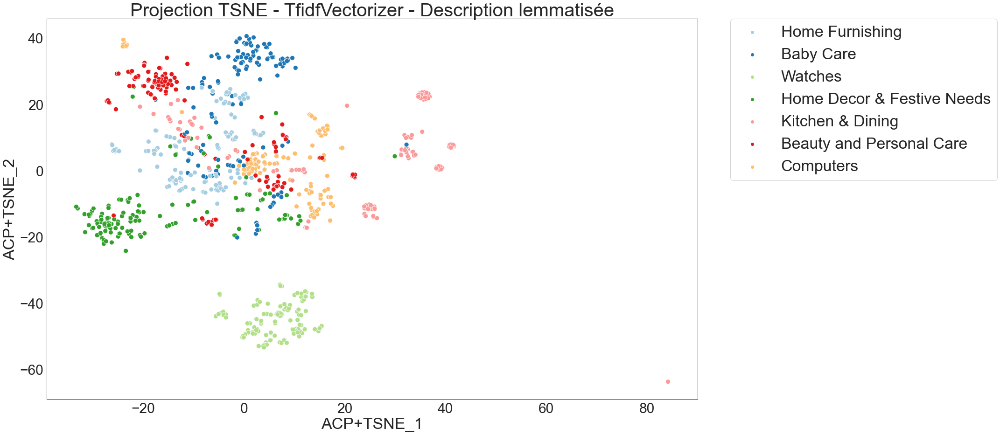

In [327]:
# Visulisation de la projection des 2 premiers variables ACP +TSNE
titre_acp = 'Projection ACP+TSNE - CountVectorizer'
titre_acp_1 = titre_tf + ' - Description lemmatisée'
outils_acp.affiche_projections_reducdim(data_work, X_proj_acptsne_cv_desc_lem,
                                        'ACP+TSNE_1', 'ACP+TSNE_2',
                                        titre_acp_1)

**description** - stemmatisée

In [328]:
# t-SNE tuning du paramètre perplexity avec initialisation PCA
top_depart = time.time()
liste_param = [5, 10, 20, 30, 40, 50]
results_cv_desc_stem = list()
acptsne_results_cv_desc_stem = []
for i in liste_param:
    tsne = TSNE(n_components=2, verbose=1, perplexity=i, n_iter=500,
                random_state=seed)
    acptsne_results_cv_desc_stem = tsne.fit_transform(X_proj_acp_cv_desc_stem)
    results_cv_desc_stem.append(acptsne_results_cv_desc_stem)
print('t-SNE terminée! en : {} seconds'.format(time.time()-top_depart))

[t-SNE] Computing 16 nearest neighbors...
[t-SNE] Indexed 1050 samples in 0.014s...
[t-SNE] Computed neighbors for 1050 samples in 0.291s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1050
[t-SNE] Computed conditional probabilities for sample 1050 / 1050
[t-SNE] Mean sigma: 0.000000
[t-SNE] KL divergence after 250 iterations with early exaggeration: 67.810745
[t-SNE] KL divergence after 500 iterations: 0.691659
[t-SNE] Computing 31 nearest neighbors...
[t-SNE] Indexed 1050 samples in 0.028s...
[t-SNE] Computed neighbors for 1050 samples in 0.321s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1050
[t-SNE] Computed conditional probabilities for sample 1050 / 1050
[t-SNE] Mean sigma: 0.000000
[t-SNE] KL divergence after 250 iterations with early exaggeration: 66.177498
[t-SNE] KL divergence after 500 iterations: 0.642014
[t-SNE] Computing 61 nearest neighbors...
[t-SNE] Indexed 1050 samples in 0.029s...
[t-SNE] Computed neighbors for 1050 samples in 0.3

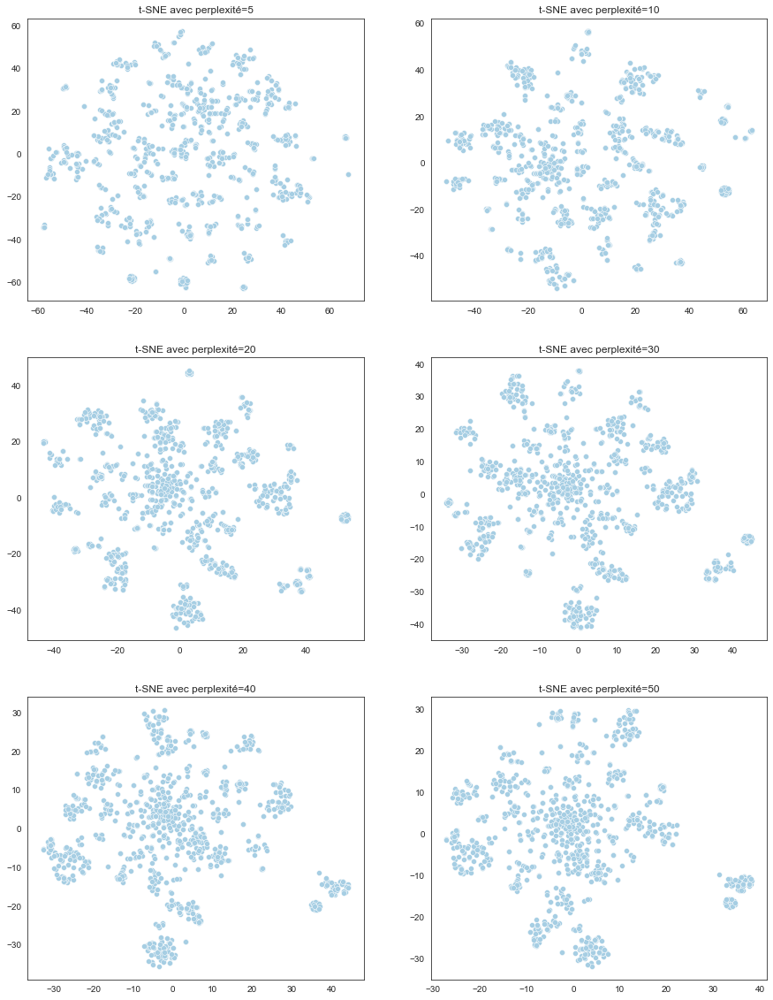

In [329]:
# Visualisation en 2D des différents résultats selon la perplexité
outils_segmentation.affiche_tsne(results_cv_desc_stem, liste_param, 1)

- groupes plus homogènes pour perplexité=30
- on laissera les paramètres learning_rate et n_iter par défaut (1000) et le nombre de composants par défaut (2).

In [150]:
%pycodestyle_off

In [151]:
# Réduction de dimension tsne
acptsne_cv_desc_stem = TSNE(verbose=1, perplexity=30)
X_proj_acptsne_cv_desc_stem = \
    acptsne_cv_desc_stem.fit_transform(X_proj_acp_cv_desc_stem)
# Dataframe pour clustering
df_acptsne_cv_desc_stem = pd.DataFrame({'VAR1' : X_proj_acptsne_cv_desc_stem[:, 0],
                                        'VAR2': X_proj_acptsne_cv_desc_stem[:, 1],
                                        'CATEGORIE' : data_work['Categorie_1']})

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 1050 samples in 0.020s...
[t-SNE] Computed neighbors for 1050 samples in 0.346s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1050
[t-SNE] Computed conditional probabilities for sample 1050 / 1050
[t-SNE] Mean sigma: 0.683955
[t-SNE] KL divergence after 250 iterations with early exaggeration: 69.407654
[t-SNE] KL divergence after 1000 iterations: 0.680882


In [153]:
%pycodestyle_on

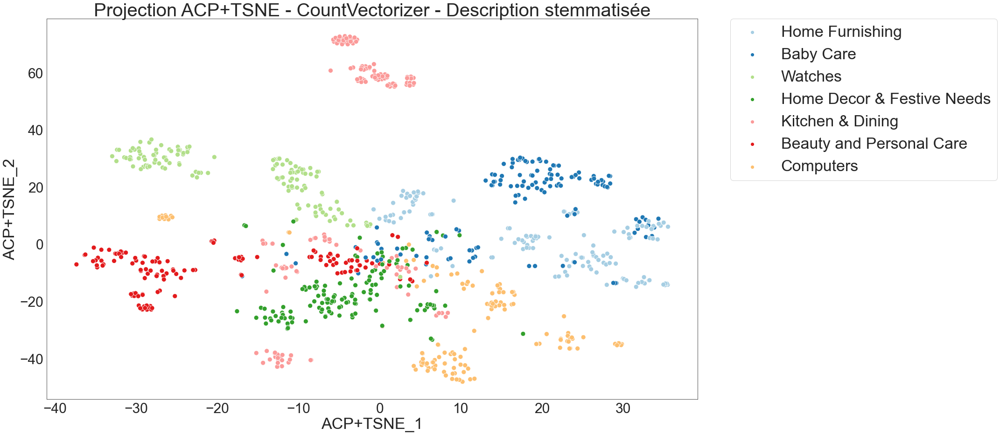

In [333]:
# Visulisation de la projection des 2 premiers variables ACP+TSNE
titre_acp = 'Projection ACP+TSNE - CountVectorizer'
titre_acp_2 = titre_acp + ' - Description stemmatisée'
outils_acp.affiche_projections_reducdim(data_work, X_proj_acptsne_cv_desc_stem,
                                        'ACP+TSNE_1', 'ACP+TSNE_2',
                                        titre_acp_2)

**produit_specification** - lemmatisée

In [334]:
# t-SNE tuning du paramètre perplexity avec initialisation PCA
top_depart = time.time()
liste_param = [5, 10, 20, 30, 40, 50]
results_cv_prod_lem = list()
acptsne_results_cv_prod_lem = []
for i in liste_param:
    tsne = TSNE(n_components=2, verbose=1, perplexity=i, n_iter=500,
                random_state=seed)
    acptsne_results_cv_prod_lem = tsne.fit_transform(X_proj_acp_cv_prod_lem)
    results_cv_prod_lem.append(acptsne_results_cv_prod_lem)
print('t-SNE terminée! en : {} seconds'.format(time.time()-top_depart))

[t-SNE] Computing 16 nearest neighbors...
[t-SNE] Indexed 1050 samples in 0.008s...
[t-SNE] Computed neighbors for 1050 samples in 0.322s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1050
[t-SNE] Computed conditional probabilities for sample 1050 / 1050
[t-SNE] Mean sigma: 0.000000
[t-SNE] KL divergence after 250 iterations with early exaggeration: 67.727509
[t-SNE] KL divergence after 500 iterations: 0.697084
[t-SNE] Computing 31 nearest neighbors...
[t-SNE] Indexed 1050 samples in 0.031s...
[t-SNE] Computed neighbors for 1050 samples in 0.337s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1050
[t-SNE] Computed conditional probabilities for sample 1050 / 1050
[t-SNE] Mean sigma: 0.000000
[t-SNE] KL divergence after 250 iterations with early exaggeration: 67.316071
[t-SNE] KL divergence after 500 iterations: 0.649415
[t-SNE] Computing 61 nearest neighbors...
[t-SNE] Indexed 1050 samples in 0.031s...
[t-SNE] Computed neighbors for 1050 samples in 0.3

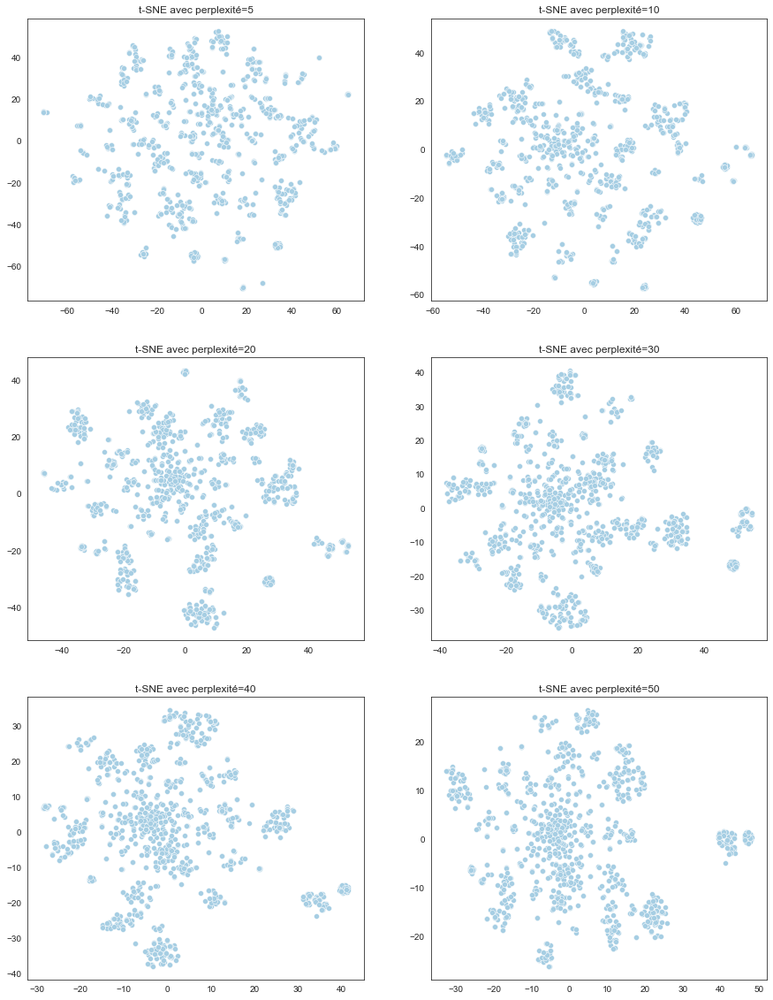

In [335]:
# Visualisation en 2D des différents résultats selon la perplexité
outils_segmentation.affiche_tsne(results_cv_prod_lem, liste_param, 1)

- groupes plus homogènes pour perplexité=40
- on laissera les paramètres learning_rate et n_iter par défaut (1000) et le nombre de composants par défaut (2).

In [154]:
%pycodestyle_off

In [155]:
# Réduction de dimension tsne
acptsne_cv_prod_lem = TSNE(verbose=1, perplexity=40)
X_proj_acptsne_cv_prod_lem = \
    acptsne_cv_prod_lem.fit_transform(X_proj_acp_cv_prod_lem)
# Dataframe pour clustering
df_acptsne_cv_prod_lem = pd.DataFrame({'VAR1' : X_proj_acptsne_cv_prod_lem[:, 0],
                                       'VAR2': X_proj_acptsne_cv_prod_lem[:, 1],
                                       'CATEGORIE' : data_work['Categorie_1']})

[t-SNE] Computing 121 nearest neighbors...
[t-SNE] Indexed 1050 samples in 0.022s...
[t-SNE] Computed neighbors for 1050 samples in 0.361s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1050
[t-SNE] Computed conditional probabilities for sample 1050 / 1050
[t-SNE] Mean sigma: 1.672506
[t-SNE] KL divergence after 250 iterations with early exaggeration: 70.574516
[t-SNE] KL divergence after 1000 iterations: 0.635919


In [156]:
%pycodestyle_on

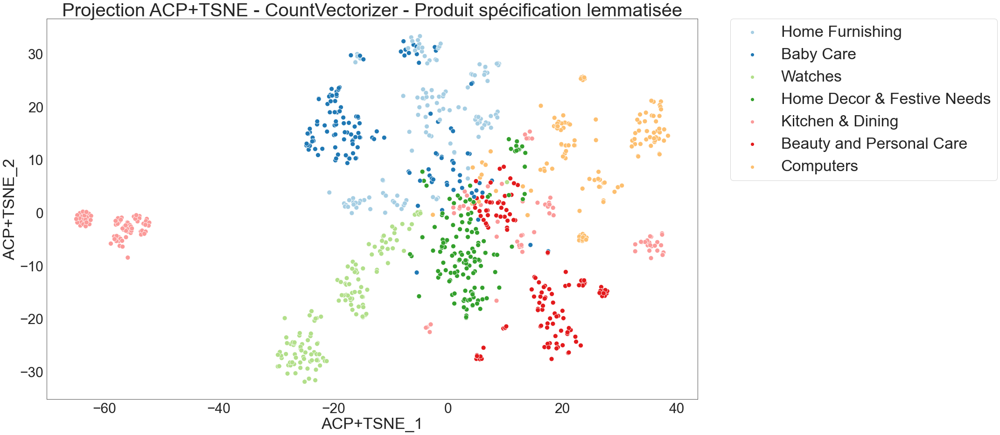

In [339]:
# Visulisation de la projection des 2 premiers variables ACP+TSNE
titre_acp = 'Projection ACP+TSNE - CountVectorizer'
titre_acp_3 = titre_acp + ' - Produit spécification lemmatisée'
outils_acp.affiche_projections_reducdim(data_work, X_proj_acptsne_cv_prod_lem,
                                        'ACP+TSNE_1', 'ACP+TSNE_2',
                                        titre_acp_3)

**produit_specification** - stemmatisée

In [340]:
# t-SNE tuning du paramètre perplexity avec initialisation PCA
top_depart = time.time()
liste_param = [5, 10, 20, 30, 40, 50]
results_cv_prod_stem = list()
acptsne_results_cv_prod_stem = []
for i in liste_param:
    tsne = TSNE(n_components=2, verbose=1, perplexity=i, n_iter=500,
                random_state=seed)
    acptsne_results_cv_prod_stem = tsne.fit_transform(vector_countvectorizer_prod_stem)
    results_cv_prod_stem.append(acptsne_results_cv_prod_stem)
print('t-SNE terminée! en : {} seconds'.format(time.time()-top_depart))

[t-SNE] Computing 16 nearest neighbors...
[t-SNE] Indexed 1050 samples in 0.000s...
[t-SNE] Computed neighbors for 1050 samples in 0.039s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1050
[t-SNE] Computed conditional probabilities for sample 1050 / 1050
[t-SNE] Mean sigma: 0.000000
[t-SNE] KL divergence after 250 iterations with early exaggeration: 71.980148
[t-SNE] KL divergence after 500 iterations: 0.845529
[t-SNE] Computing 31 nearest neighbors...
[t-SNE] Indexed 1050 samples in 0.000s...
[t-SNE] Computed neighbors for 1050 samples in 0.040s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1050
[t-SNE] Computed conditional probabilities for sample 1050 / 1050
[t-SNE] Mean sigma: 0.000000
[t-SNE] KL divergence after 250 iterations with early exaggeration: 74.430656
[t-SNE] KL divergence after 500 iterations: 0.807128
[t-SNE] Computing 61 nearest neighbors...
[t-SNE] Indexed 1050 samples in 0.001s...
[t-SNE] Computed neighbors for 1050 samples in 0.0

9:80: E501 line too long (87 > 79 characters)


[t-SNE] KL divergence after 500 iterations: 0.755467
t-SNE terminée! en : 8.379842519760132 seconds


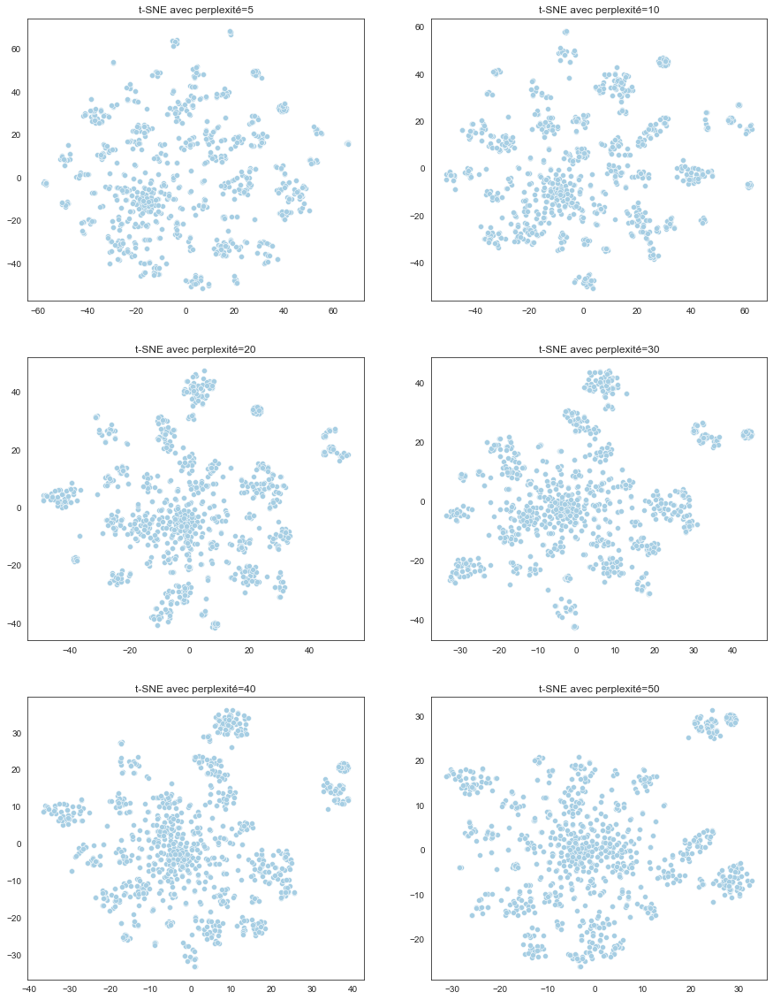

In [341]:
# Visualisation en 2D des différents résultats selon la perplexité
outils_segmentation.affiche_tsne(results_cv_prod_stem, liste_param, 1)

- groupes plus homogènes pour perplexité=40
- on laissera les paramètres learning_rate et n_iter par défaut (1000) et le nombre de composants par défaut (2).

In [157]:
%pycodestyle_off

In [158]:
# Réduction de dimension tsne
acptsne_cv_prod_stem = TSNE(verbose=1, perplexity=40)
X_proj_acptsne_cv_prod_stem = \
    acptsne_cv_prod_stem.fit_transform(X_proj_acp_cv_prod_stem)
# Dataframe pour clustering
df_acptsne_cv_prod_stem = pd.DataFrame({'VAR1' : X_proj_acptsne_cv_prod_stem[:, 0],
                                        'VAR2': X_proj_acptsne_cv_prod_stem[:, 1],
                                        'CATEGORIE' : data_work['Categorie_1']})

[t-SNE] Computing 121 nearest neighbors...
[t-SNE] Indexed 1050 samples in 0.020s...
[t-SNE] Computed neighbors for 1050 samples in 0.349s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1050
[t-SNE] Computed conditional probabilities for sample 1050 / 1050
[t-SNE] Mean sigma: 1.676312
[t-SNE] KL divergence after 250 iterations with early exaggeration: 70.812271
[t-SNE] KL divergence after 1000 iterations: 0.642143


In [159]:
%pycodestyle_on

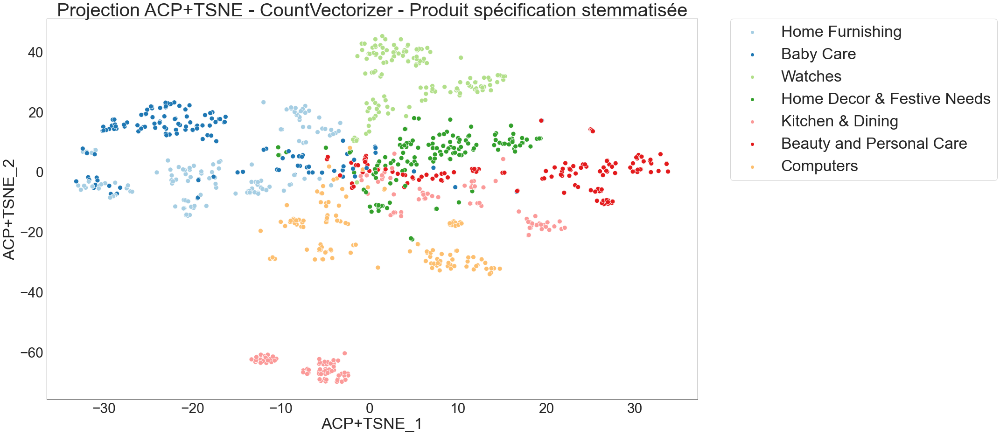

In [344]:
# Visulisation de la projection des 2 premiers variables ACP+TSNE
titre_acp = 'Projection ACP+TSNE - CountVectorizer'
titre_acp_4 = titre_acp + ' - Produit spécification stemmatisée'
outils_acp.affiche_projections_reducdim(data_work, X_proj_acptsne_cv_prod_stem,
                                        'ACP+TSNE_1', 'ACP+TSNE_2',
                                        titre_acp_4)

#### <span style='background:Moccasin'>5.3.2 BOW - TfidfVectorizer</span>

**description** - lemmatisée

In [345]:
# t-SNE tuning du paramètre perplexity zvec initialisation PCA
top_depart = time.time()
liste_param = [5, 10, 20, 30, 40, 50]
results_tfidf_desc_lem = list()
acptsne_results_tfidf_desc_lem = []
for i in liste_param:
    tsne = TSNE(n_components=2, verbose=1, perplexity=i, n_iter=500,
                random_state=seed)
    acptsne_results_tfidf_desc_lem = tsne.fit_transform(vector_tfidfvectorizer_desc_lem)
    results_tfidf_desc_lem.append(acptsne_results_tfidf_desc_lem)
print('t-SNE terminée! en : {} seconds'.format(time.time()-top_depart))

[t-SNE] Computing 16 nearest neighbors...
[t-SNE] Indexed 1050 samples in 0.000s...
[t-SNE] Computed neighbors for 1050 samples in 0.025s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1050
[t-SNE] Computed conditional probabilities for sample 1050 / 1050
[t-SNE] Mean sigma: 0.142074
[t-SNE] KL divergence after 250 iterations with early exaggeration: 92.543381
[t-SNE] KL divergence after 500 iterations: 1.762938
[t-SNE] Computing 31 nearest neighbors...
[t-SNE] Indexed 1050 samples in 0.000s...
[t-SNE] Computed neighbors for 1050 samples in 0.028s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1050
[t-SNE] Computed conditional probabilities for sample 1050 / 1050
[t-SNE] Mean sigma: 0.348062
[t-SNE] KL divergence after 250 iterations with early exaggeration: 98.214767
[t-SNE] KL divergence after 500 iterations: 1.538390
[t-SNE] Computing 61 nearest neighbors...
[t-SNE] Indexed 1050 samples in 0.001s...
[t-SNE] Computed neighbors for 1050 samples in 0.0

9:80: E501 line too long (88 > 79 characters)


[t-SNE] KL divergence after 500 iterations: 1.233735
t-SNE terminée! en : 7.970085144042969 seconds


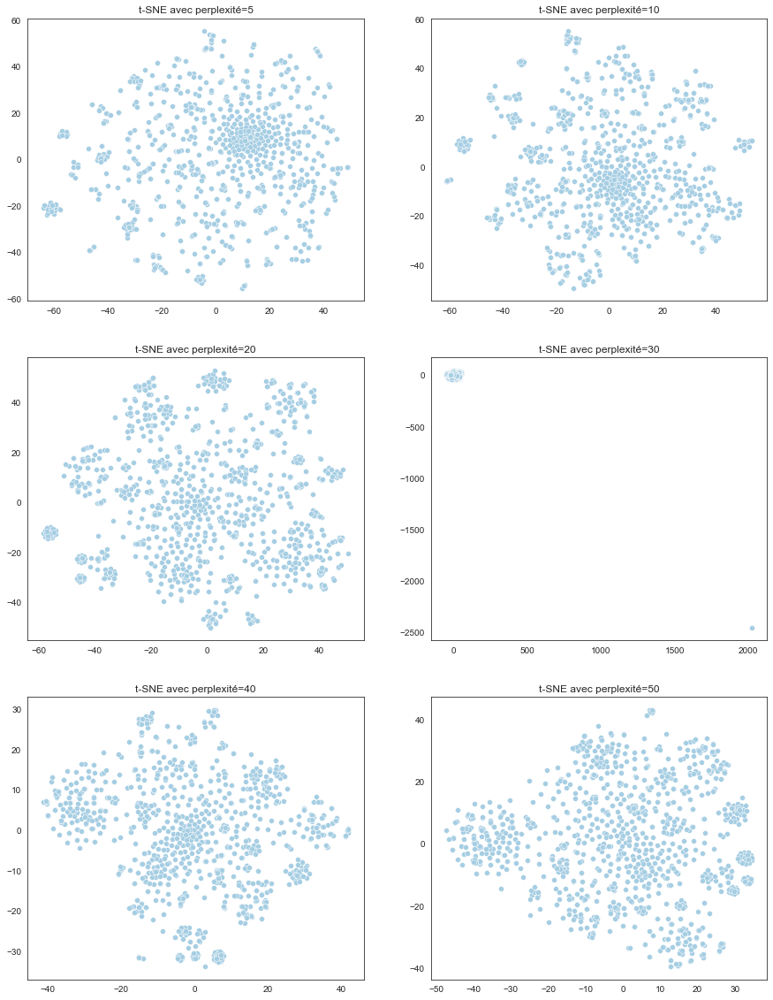

In [346]:
# Visualisation en 2D des différents résultats selon la perplexité
outils_segmentation.affiche_tsne(results_tfidf_desc_lem, liste_param, 1)

- groupes plus homogènes pour perplexité=40
- on laissera les paramètres learning_rate et n_iter par défaut (1000) et le nombre de composants par défaut (2).

In [160]:
%pycodestyle_off

In [161]:
# Réduction de dimension tsne
acptsne_tfidf_desc_lem = TSNE(verbose=1, perplexity=40)
X_proj_acptsne_tfidf_desc_lem = \
    acptsne_tfidf_desc_lem.fit_transform(X_proj_acp_tfidf_desc_lem)
# Dataframe pour clustering
df_acptsne_tfidf_desc_lem = pd.DataFrame({'VAR1' : X_proj_acptsne_tfidf_desc_lem[:, 0],
                                          'VAR2': X_proj_acptsne_tfidf_desc_lem[:, 1],
                                          'CATEGORIE' : data_work['Categorie_1']})

[t-SNE] Computing 121 nearest neighbors...
[t-SNE] Indexed 1050 samples in 0.051s...
[t-SNE] Computed neighbors for 1050 samples in 0.770s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1050
[t-SNE] Computed conditional probabilities for sample 1050 / 1050
[t-SNE] Mean sigma: 0.513224
[t-SNE] KL divergence after 250 iterations with early exaggeration: 86.233566
[t-SNE] KL divergence after 1000 iterations: 1.099360


In [162]:
%pycodestyle_on

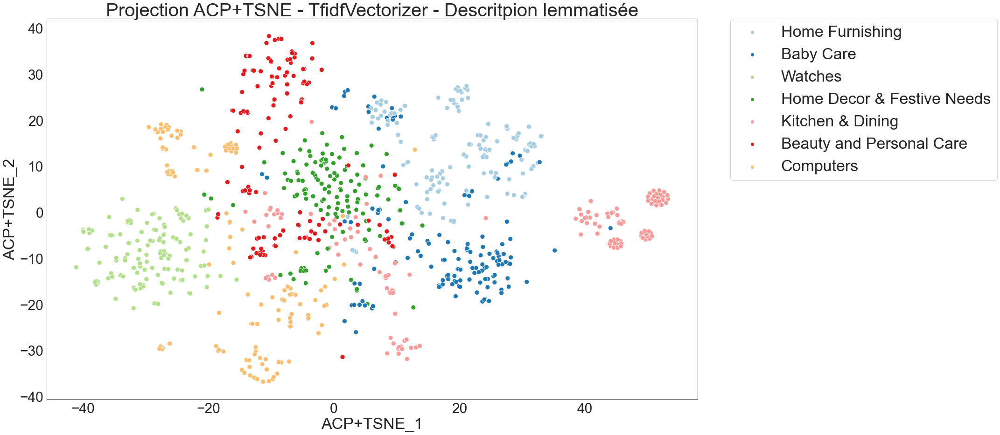

In [355]:
# Visulisation de la projection des 2 premiers variables ACP+TSNE
titre_acp = 'Projection ACP+TSNE - TfidfVectorizer'
titre_acp_5 = titre_acp + ' - Descritpion lemmatisée'
outils_acp.affiche_projections_reducdim(data_work,
                                        X_proj_acptsne_tfidf_desc_lem,
                                        'ACP+TSNE_1', 'ACP+TSNE_2',
                                        titre_acp_5)

**description** - stemmatisée

In [356]:
# t-SNE tuning du paramètre perplexity avec initialisation PCA
top_depart = time.time()
liste_param = [5, 10, 20, 30, 40, 50]
results_tfidf_desc_stem = list()
acptsne_results_tfidf_desc_stem = []
for i in liste_param:
    tsne = TSNE(n_components=2, verbose=1, perplexity=i, n_iter=500,
                random_state=seed)
    acptsne_results_tfidf_desc_stem = tsne.fit_transform(vector_tfidfvectorizer_desc_stem)
    results_tfidf_desc_stem.append(acptsne_results_tfidf_desc_stem)
print('t-SNE terminée! en : {} seconds'.format(time.time()-top_depart))

[t-SNE] Computing 16 nearest neighbors...
[t-SNE] Indexed 1050 samples in 0.000s...
[t-SNE] Computed neighbors for 1050 samples in 0.023s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1050
[t-SNE] Computed conditional probabilities for sample 1050 / 1050
[t-SNE] Mean sigma: 0.108770
[t-SNE] KL divergence after 250 iterations with early exaggeration: 94.632797
[t-SNE] KL divergence after 500 iterations: 1.725263
[t-SNE] Computing 31 nearest neighbors...
[t-SNE] Indexed 1050 samples in 0.001s...
[t-SNE] Computed neighbors for 1050 samples in 0.030s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1050
[t-SNE] Computed conditional probabilities for sample 1050 / 1050
[t-SNE] Mean sigma: 0.345090
[t-SNE] KL divergence after 250 iterations with early exaggeration: 101.577576
[t-SNE] KL divergence after 500 iterations: 1.546224
[t-SNE] Computing 61 nearest neighbors...
[t-SNE] Indexed 1050 samples in 0.000s...
[t-SNE] Computed neighbors for 1050 samples in 0.

9:80: E501 line too long (90 > 79 characters)


[t-SNE] KL divergence after 500 iterations: 1.214646
t-SNE terminée! en : 8.462992668151855 seconds


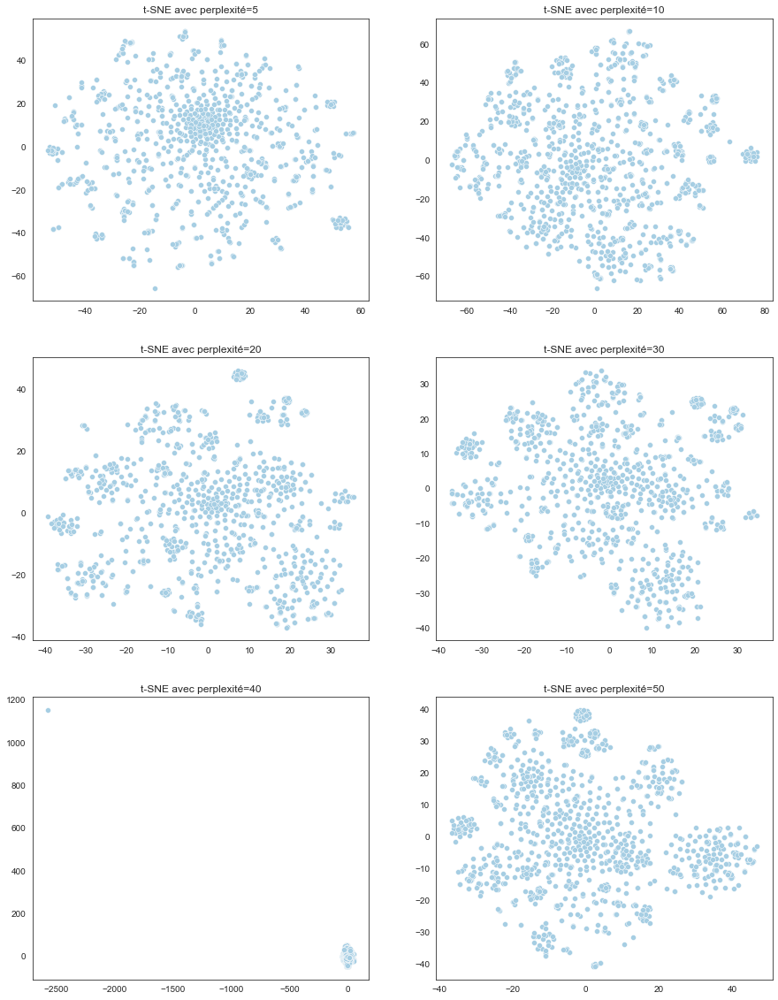

In [357]:
# Visualisation en 2D des différents résultats selon la perplexité
outils_segmentation.affiche_tsne(results_tfidf_desc_stem, liste_param, 1)

- groupes plus homogènes pour perplexité=40
- on laissera les paramètres learning_rate et n_iter par défaut (1000) et le nombre de composants par défaut (2).

In [163]:
%pycodestyle_off

In [164]:
# Réduction de dimension tsne
acptsne_tfidf_desc_stem = TSNE(verbose=1, perplexity=40)
X_proj_acptsne_tfidf_desc_stem = \
    acptsne_tfidf_desc_stem.fit_transform(X_proj_acp_tfidf_desc_stem)
# Dataframe pour clustering
df_acptsne_tfidf_desc_stem = pd.DataFrame({'VAR1' : X_proj_acptsne_tfidf_desc_stem[:, 0],
                                           'VAR2': X_proj_acptsne_tfidf_desc_stem[:, 1],
                                           'CATEGORIE' : data_work['Categorie_1']})

[t-SNE] Computing 121 nearest neighbors...
[t-SNE] Indexed 1050 samples in 0.049s...
[t-SNE] Computed neighbors for 1050 samples in 0.759s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1050
[t-SNE] Computed conditional probabilities for sample 1050 / 1050
[t-SNE] Mean sigma: 0.513138
[t-SNE] KL divergence after 250 iterations with early exaggeration: 86.235657
[t-SNE] KL divergence after 1000 iterations: 1.078146


In [165]:
%pycodestyle_on

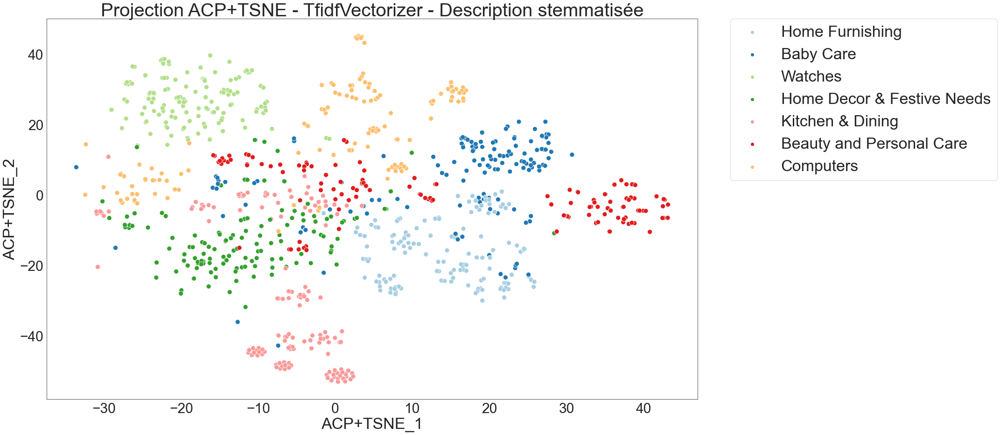

In [362]:
# Visulisation de la projection des 2 premiers variables ACP+TSNE
titre_acp = 'Projection ACP+TSNE - TfidfVectorizer'
titre_acp_6 = titre_acp + ' - Description stemmatisée'
outils_acp.affiche_projections_reducdim(data_work,
                                        X_proj_acptsne_tfidf_desc_stem,
                                        'ACP+TSNE_1', 'ACP+TSNE_2',
                                        titre_acp_6)

**produit_specification** - lemmatisée

In [368]:
# t-SNE tuning du paramètre perplexity avec initialisation PCA
top_depart = time.time()
liste_param = [5, 10, 20, 30, 40, 50]
results_tfidf_prod_lem = list()
acptsne_results_tfidf_prod_lem = []
for i in liste_param:
    tsne = TSNE(n_components=2, verbose=1, perplexity=i, n_iter=500,
                random_state=seed)
    acptsne_results_tfidf_prod_lem = tsne.fit_transform(X_proj_acp_tfidf_prod_lem)
    results_tfidf_prod_lem.append(acptsne_results_tfidf_prod_lem)
print('t-SNE terminée! en : {} seconds'.format(time.time()-top_depart))

[t-SNE] Computing 16 nearest neighbors...
[t-SNE] Indexed 1050 samples in 0.032s...
[t-SNE] Computed neighbors for 1050 samples in 0.516s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1050
[t-SNE] Computed conditional probabilities for sample 1050 / 1050
[t-SNE] Mean sigma: 0.000000
[t-SNE] KL divergence after 250 iterations with early exaggeration: 70.911537
[t-SNE] KL divergence after 500 iterations: 0.992639
[t-SNE] Computing 31 nearest neighbors...
[t-SNE] Indexed 1050 samples in 0.049s...
[t-SNE] Computed neighbors for 1050 samples in 0.534s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1050
[t-SNE] Computed conditional probabilities for sample 1050 / 1050
[t-SNE] Mean sigma: 0.000000
[t-SNE] KL divergence after 250 iterations with early exaggeration: 72.162544
[t-SNE] KL divergence after 500 iterations: 0.913021
[t-SNE] Computing 61 nearest neighbors...
[t-SNE] Indexed 1050 samples in 0.050s...
[t-SNE] Computed neighbors for 1050 samples in 0.5

9:80: E501 line too long (82 > 79 characters)


[t-SNE] KL divergence after 500 iterations: 1.135878
t-SNE terminée! en : 11.452399730682373 seconds


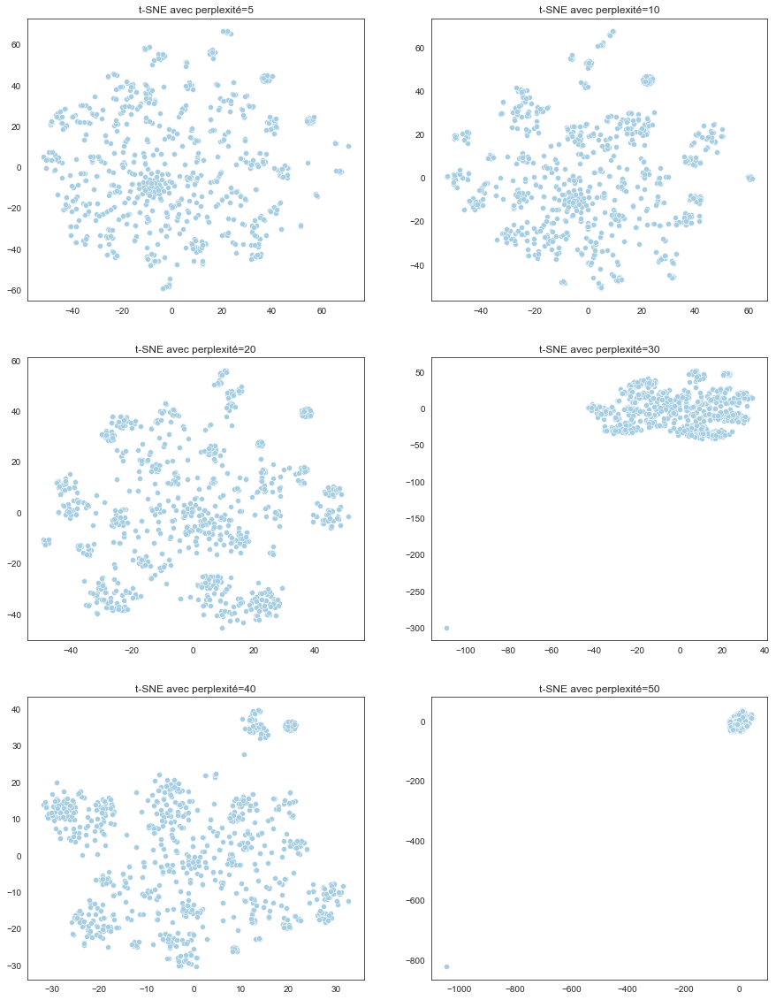

In [369]:
# Visualisation en 2D des différents résultats selon la perplexité
outils_segmentation.affiche_tsne(results_tfidf_prod_lem, liste_param, 1)

- groupes plus homogènes pour perplexité=40
- on laissera les paramètres learning_rate et n_iter par défaut (1000) et le nombre de composants par défaut (2).

In [166]:
%pycodestyle_off

In [167]:
# Réduction de dimension tsne
acptsne_tfidf_prod_lem = TSNE(verbose=1, perplexity=40)
X_proj_acptsne_tfidf_prod_lem = \
    acptsne_tfidf_prod_lem.fit_transform(X_proj_acp_tfidf_prod_lem)
# Dataframe pour clustering
df_acptsne_tfidf_prod_lem = pd.DataFrame({'VAR1' : X_proj_acptsne_tfidf_prod_lem[:, 0],
                                          'VAR2': X_proj_acptsne_tfidf_prod_lem[:, 1],
                                          'CATEGORIE' : data_work['Categorie_1']})

[t-SNE] Computing 121 nearest neighbors...
[t-SNE] Indexed 1050 samples in 0.036s...
[t-SNE] Computed neighbors for 1050 samples in 0.586s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1050
[t-SNE] Computed conditional probabilities for sample 1050 / 1050
[t-SNE] Mean sigma: 0.474767
[t-SNE] KL divergence after 250 iterations with early exaggeration: 74.586365
[t-SNE] KL divergence after 1000 iterations: 0.778111


In [168]:
%pycodestyle_on

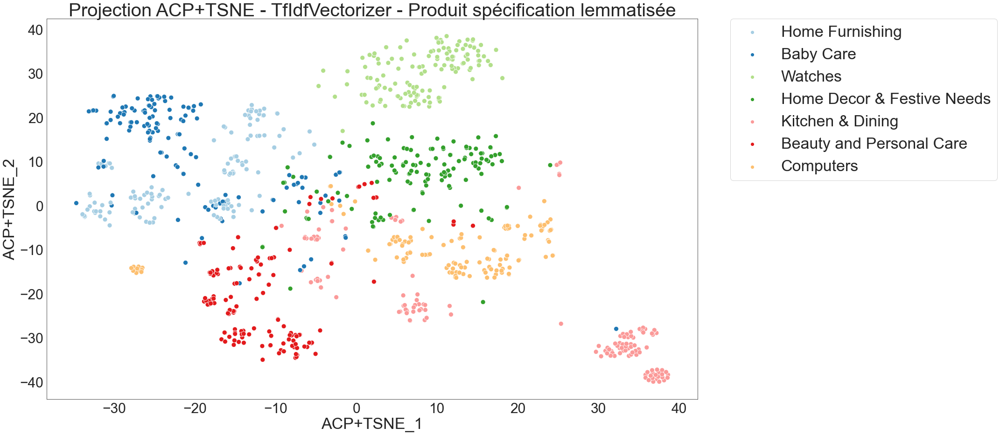

In [373]:
# Visulisation de la projection des 2 premiers variables ACP+TSNE
titre_acp = 'Projection ACP+TSNE - TfIdfVectorizer'
titre_acp_7 = titre_acp + ' - Produit spécification lemmatisée'
outils_acp.affiche_projections_reducdim(data_work,
                                        X_proj_acptsne_tfidf_prod_lem,
                                        'ACP+TSNE_1', 'ACP+TSNE_2',
                                        titre_acp_7)

**produit_specification** - stemmatisée

In [374]:
# t-SNE tuning du paramètre perplexity sans initialisation PCA
top_depart = time.time()
liste_param = [5, 10, 20, 30, 40, 50]
results_tfidf_prod_stem = list()
acptsne_results_tfidf_prod_stem = []
for i in liste_param:
    tsne = TSNE(n_components=2, verbose=1, perplexity=i, n_iter=500,
                random_state=seed)
    acptsne_results_tfidf_prod_stem = tsne.fit_transform(X_proj_acp_tfidf_prod_stem)
    results_tfidf_prod_stem.append(acptsne_results_tfidf_prod_stem)
print('t-SNE terminée! en : {} seconds'.format(time.time()-top_depart))

[t-SNE] Computing 16 nearest neighbors...
[t-SNE] Indexed 1050 samples in 0.029s...
[t-SNE] Computed neighbors for 1050 samples in 0.518s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1050
[t-SNE] Computed conditional probabilities for sample 1050 / 1050
[t-SNE] Mean sigma: 0.000000
[t-SNE] KL divergence after 250 iterations with early exaggeration: 70.886200
[t-SNE] KL divergence after 500 iterations: 0.944046
[t-SNE] Computing 31 nearest neighbors...
[t-SNE] Indexed 1050 samples in 0.050s...
[t-SNE] Computed neighbors for 1050 samples in 0.531s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1050
[t-SNE] Computed conditional probabilities for sample 1050 / 1050
[t-SNE] Mean sigma: 0.000000
[t-SNE] KL divergence after 250 iterations with early exaggeration: 75.317131
[t-SNE] KL divergence after 500 iterations: 0.898558
[t-SNE] Computing 61 nearest neighbors...
[t-SNE] Indexed 1050 samples in 0.047s...
[t-SNE] Computed neighbors for 1050 samples in 0.5

9:80: E501 line too long (84 > 79 characters)


[t-SNE] KL divergence after 500 iterations: 0.812118
t-SNE terminée! en : 11.776631593704224 seconds


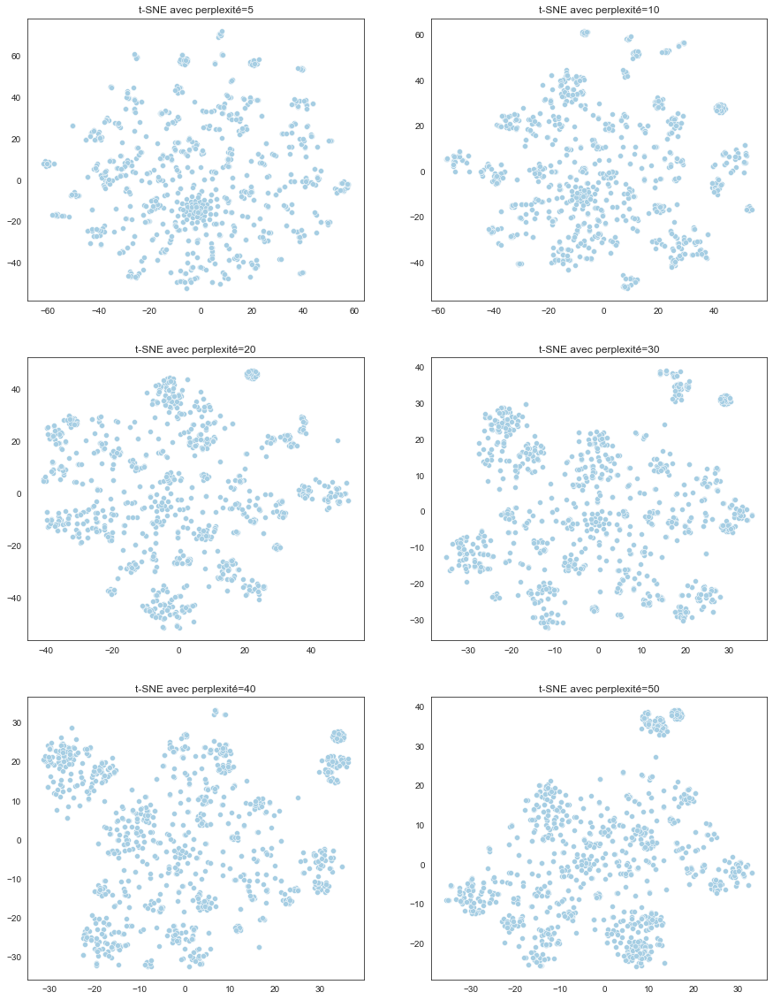

In [375]:
# Visualisation en 2D des différents résultats selon la perplexité
outils_segmentation.affiche_tsne(results_tfidf_prod_stem, liste_param, 1)

- groupes plus homogènes pour perplexité=40
- on laissera les paramètres learning_rate et n_iter par défaut (1000) et le nombre de composants par défaut (2).

In [169]:
%pycodestyle_off

In [170]:
# Réduction de dimension tsne
acptsne_tfidf_prod_stem = TSNE(verbose=1, perplexity=40)
X_proj_acptsne_tfidf_prod_stem = \
    acptsne_tfidf_prod_stem.fit_transform(X_proj_acp_tfidf_prod_stem)
# Dataframe pour clustering
df_acptsne_tfidf_prod_stem = pd.DataFrame({'VAR1' : X_proj_acptsne_tfidf_prod_stem[:, 0],
                                           'VAR2': X_proj_acptsne_tfidf_prod_stem[:, 1],
                                           'CATEGORIE' : data_work['Categorie_1']}) 

[t-SNE] Computing 121 nearest neighbors...
[t-SNE] Indexed 1050 samples in 0.034s...
[t-SNE] Computed neighbors for 1050 samples in 0.562s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1050
[t-SNE] Computed conditional probabilities for sample 1050 / 1050
[t-SNE] Mean sigma: 0.472768
[t-SNE] KL divergence after 250 iterations with early exaggeration: 76.757736
[t-SNE] KL divergence after 1000 iterations: 0.774020


In [171]:
%pycodestyle_on

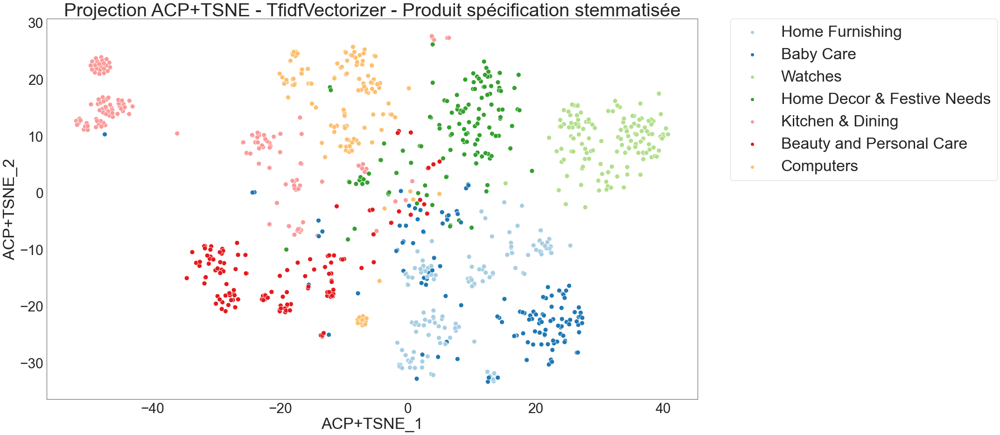

In [378]:
# Visulisation de la projection des 2 premiers variables ACP+TSNE
titre_acp = 'Projection ACP+TSNE - TfidfVectorizer'
titre_acp_8 = titre_acp + ' - Produit spécification stemmatisée'
outils_acp.affiche_projections_reducdim(data_work,
                                        X_proj_acptsne_tfidf_prod_stem,
                                        'ACP+TSNE_1', 'ACP+TSNE_2',
                                        titre_acp_8)

#### <span style='background:Moccasin'>5.3.3 BOW - HashingVectorizer</span>

**description** - lemmatisée

In [172]:
%pycodestyle_off

In [173]:
# Réduction de dimension tsne
acptsne_hash_desc_lem = TSNE(verbose=1, perplexity=40)
X_proj_acptsne_hash_desc_lem = \
    acptsne_hash_desc_lem.fit_transform(X_proj_acp_hash_desc_lem)
# Dataframe pour clustering
df_acptsne_hash_desc_lem = pd.DataFrame({'VAR1' : X_proj_acptsne_hash_desc_lem[:, 0],
                                         'VAR2' : X_proj_acptsne_hash_desc_lem[:, 1],
                                         'CATEGORIE' : data_work['Categorie_1']})

[t-SNE] Computing 121 nearest neighbors...
[t-SNE] Indexed 1050 samples in 0.063s...
[t-SNE] Computed neighbors for 1050 samples in 0.793s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1050
[t-SNE] Computed conditional probabilities for sample 1050 / 1050
[t-SNE] Mean sigma: 1.481871
[t-SNE] KL divergence after 250 iterations with early exaggeration: 76.870865
[t-SNE] KL divergence after 1000 iterations: 0.878974


In [174]:
%pycodestyle_on

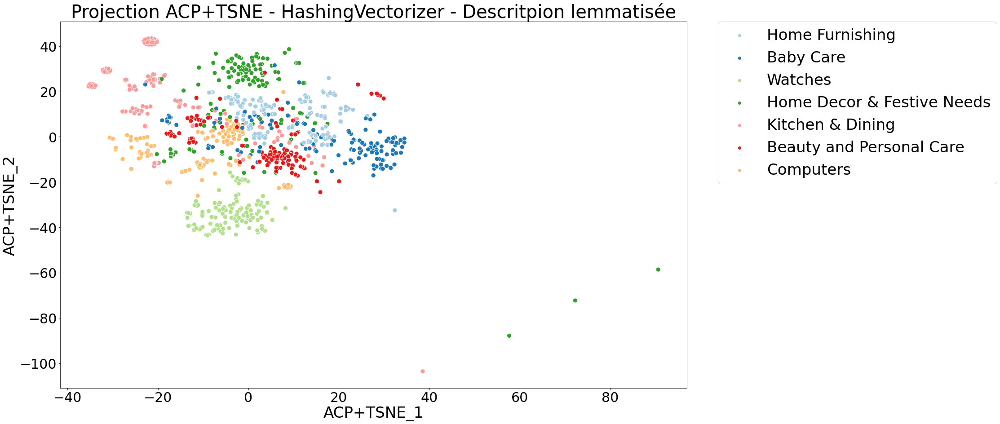

In [161]:
# Visulisation de la projection des 2 premiers variables ACP+TSNE
titre_at = 'Projection ACP+TSNE - HashingVectorizer'
titre_at_1 = titre_at + ' - Descritpion lemmatisée'
outils_acp.affiche_projections_reducdim(data_work,
                                        X_proj_acptsne_hash_desc_lem,
                                        'ACP+TSNE_1', 'ACP+TSNE_2',
                                        titre_at_1)

**description** - stemmatisée

In [175]:
%pycodestyle_off

In [176]:
# Réduction de dimension tsne
acptsne_hash_desc_stem = TSNE(verbose=1, perplexity=40)
X_proj_acptsne_hash_desc_stem = \
    acptsne_hash_desc_stem.fit_transform(X_proj_acp_hash_desc_stem)
# Dataframe pour clustering
df_acptsne_hash_desc_stem = pd.DataFrame({'VAR1' : X_proj_acptsne_hash_desc_stem[:, 0],
                                          'VAR2' : X_proj_acptsne_hash_desc_stem[:, 1],
                                          'CATEGORIE' : data_work['Categorie_1']})

[t-SNE] Computing 121 nearest neighbors...
[t-SNE] Indexed 1050 samples in 0.016s...
[t-SNE] Computed neighbors for 1050 samples in 0.342s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1050
[t-SNE] Computed conditional probabilities for sample 1050 / 1050
[t-SNE] Mean sigma: 1.096458
[t-SNE] KL divergence after 250 iterations with early exaggeration: 68.878311
[t-SNE] KL divergence after 1000 iterations: 0.687894


In [177]:
%pycodestyle_on

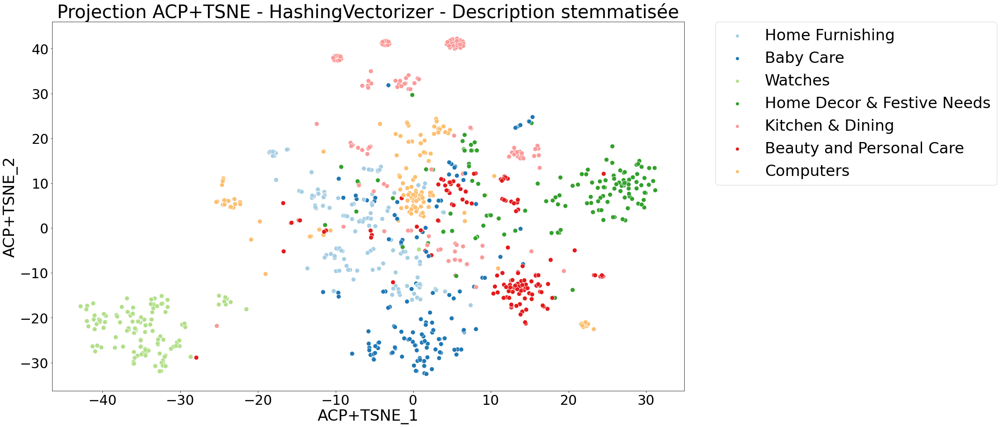

In [165]:
# Visulisation de la projection des 2 premiers variables ACP+TSNE
titre_at_2 = titre_at + ' - Description stemmatisée'
outils_acp.affiche_projections_reducdim(data_work,
                                        X_proj_acptsne_hash_desc_stem,
                                        'ACP+TSNE_1', 'ACP+TSNE_2',
                                        titre_at_2)

**produit_specification** - lemmatisée

In [178]:
%pycodestyle_off

In [179]:
# Réduction de dimension tsne
acptsne_hash_prod_lem = TSNE(verbose=1, perplexity=40)
X_proj_acptsne_hash_prod_lem = \
    acptsne_hash_prod_lem.fit_transform(X_proj_acp_hash_prod_lem)
# Dataframe pour clustering
df_acptsne_hash_prod_lem = pd.DataFrame({'VAR1' : X_proj_acptsne_hash_prod_lem[:, 0],
                                         'VAR2' : X_proj_acptsne_hash_prod_lem[:, 1],
                                         'CATEGORIE' : data_work['Categorie_1']})

[t-SNE] Computing 121 nearest neighbors...
[t-SNE] Indexed 1050 samples in 0.035s...
[t-SNE] Computed neighbors for 1050 samples in 0.579s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1050
[t-SNE] Computed conditional probabilities for sample 1050 / 1050
[t-SNE] Mean sigma: 1.807049
[t-SNE] KL divergence after 250 iterations with early exaggeration: 76.475342
[t-SNE] KL divergence after 1000 iterations: 0.754831


In [180]:
%pycodestyle_on

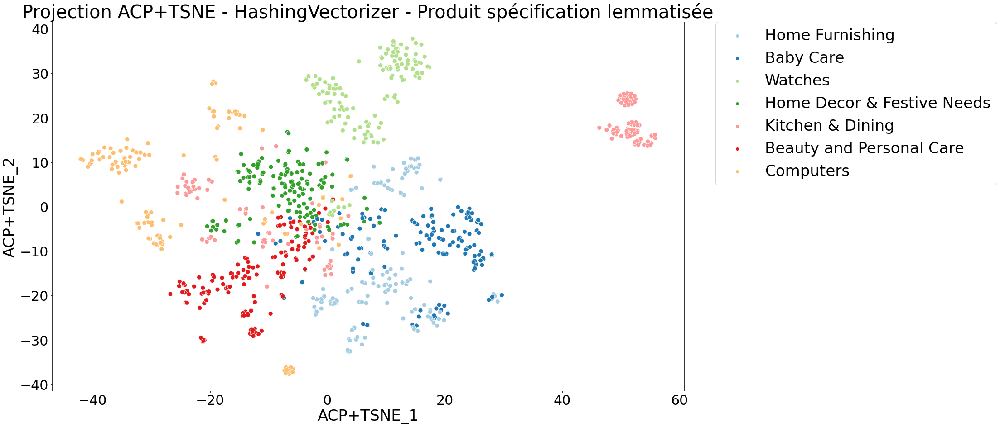

In [169]:
# Visulisation de la projection des 2 premiers variables ACP+TSNE
titre_at_3 = titre_at + ' - Produit spécification lemmatisée'
outils_acp.affiche_projections_reducdim(data_work,
                                        X_proj_acptsne_hash_prod_lem,
                                        'ACP+TSNE_1', 'ACP+TSNE_2',
                                        titre_at_3)

**produit_specification** - stemmatisée

In [182]:
%pycodestyle_off

In [183]:
# Réduction de dimension tsne
acptsne_hash_prod_stem = TSNE(verbose=1, perplexity=40)
X_proj_acptsne_hash_prod_stem = \
    acptsne_hash_prod_stem.fit_transform(X_proj_acp_hash_prod_stem)
# Dataframe pour clustering
df_acptsne_hash_prod_stem = pd.DataFrame({'VAR1' : X_proj_acptsne_hash_prod_stem[:, 0],
                                           'VAR2' : X_proj_acptsne_hash_prod_stem[:, 1],
                                           'CATEGORIE' : data_work['Categorie_1']}) 

[t-SNE] Computing 121 nearest neighbors...
[t-SNE] Indexed 1050 samples in 0.018s...
[t-SNE] Computed neighbors for 1050 samples in 0.300s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1050
[t-SNE] Computed conditional probabilities for sample 1050 / 1050
[t-SNE] Mean sigma: 1.682332
[t-SNE] KL divergence after 250 iterations with early exaggeration: 69.108505
[t-SNE] KL divergence after 1000 iterations: 0.651763


In [184]:
%pycodestyle_on

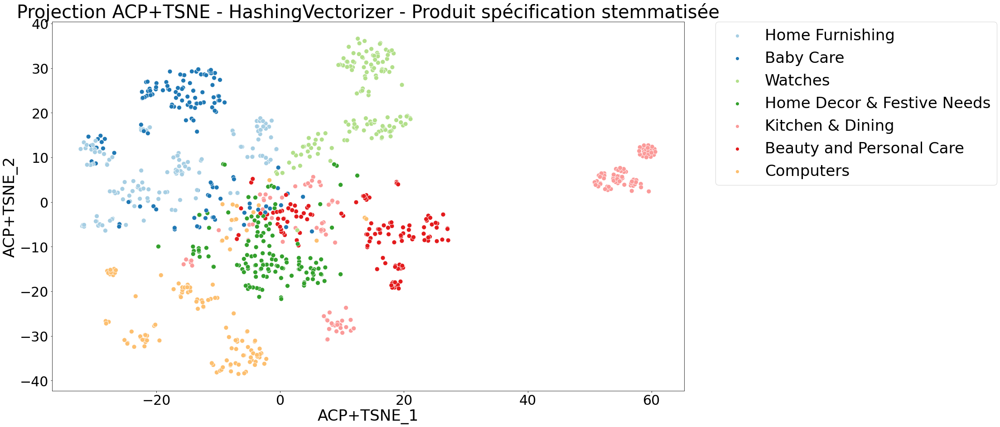

In [174]:
# Visulisation de la projection des 2 premiers variables ACP+TSNE
titre_at_4 = titre_at + ' - Produit spécification stemmatisée'
outils_acp.affiche_projections_reducdim(data_work,
                                        X_proj_acptsne_hash_prod_stem,
                                        'ACP+TSNE_1', 'ACP+TSNE_2',
                                        titre_at_4)

### <span style='background:PowderBlue'>5.4. TruncatedSVD</span>

**Note**
***
- Réduction de la dimensionnalité au moyen de la SVD tronquée (aka LSA).
- Ce transformateur effectue une réduction linéaire de la dimensionnalité au moyen de la décomposition de la valeur singulière (SVD) tronquée. 
- Contrairement à l'ACP, cet estimateur ne centre pas les données avant de calculer la décomposition en valeurs singulières. Cela signifie qu'il peut travailler efficacement avec des matrices éparses.
- Lorsque l'analyse SVD tronquée est appliquée à des matrices terme-document (telles que retournées par CountVectorizer ou TfidfVectorizer), cette transformation est connue sous le nom d'analyse sémantique latente (LSA), car elle transforme ces matrices en un espace "sémantique" de faible dimensionnalité. En particulier, l'analyse sémantique latente est connue pour combattre les effets de la synonymie et de la polysémie (qui signifient toutes deux qu'il existe plusieurs sens pour un même mot), qui font que les matrices terme-document sont trop éparses et présentent une faible similarité selon des mesures telles que la similarité en cosinus.

[Source](https://scikit-learn.org/stable/modules/decomposition.html#truncated-singular-value-decomposition-and-latent-semantic-analysis)

**Hyperparamètres**
***
- **n_composants** : int, default=2, dimensionnalité souhaitée des données de sortie. Doit être strictement inférieur au nombre d'éléments. La valeur par défaut est utile pour la visualisation. Pour LSA, une valeur de 100 est recommandée.
- *algorithm** : {'arpack', 'randomized'}, default='randomized' (par défaut). Solveur SVD à utiliser. Soit "arpack" pour le wrapper ARPACK dans SciPy (scipy.sparse.linalg.svds), soit "randomized" pour l'algorithme randomisé dû à Halko (2009).
- **n_iter** : int, par défaut=5, nombre d'itérations pour le solveur SVD randomisé. Non utilisé par ARPACK. La valeur par défaut est plus grande que celle de randomized_svd pour traiter les matrices éparses qui peuvent avoir un grand spectre à décroissance lente.
- **random_state** : int, RandomState instance ou None, default=None, Utilisé pendant randomized svd. Passez un int pour obtenir des résultats reproductibles entre plusieurs appels de fonction. Voir le glossaire.
- **tol** : float, default=0. Tolérance pour ARPACK. 0 signifie précision de la machine. Ignoré par le solveur SVD aléatoire.

#### <span style='background:Moccasin'>5.4.1 BOW - TfidfVectorizer</span>

**produit_specification** - lemmatisée

**Recherche du nombre de composant minimal**

In [185]:
from scipy.sparse import csr_matrix
n_comp = vector_tfidfvectorizer_prod_lem.shape[1]-1
tsvd = TruncatedSVD(n_components=n_comp)
X_tsvd = tsvd.fit(vector_tfidfvectorizer_prod_lem)

In [186]:
# Recherche du nombre minimal de composant pour expliquer 90% de
# la variance
tsvd_var_ratios = tsvd.explained_variance_ratio_
n_comp_mini_prod_lem = outils_nlp.select_n_components(tsvd_var_ratios, 0.9)
n_comp_mini_prod_lem

317

In [187]:
%pycodestyle_off

In [188]:
# Réduction de dimension TruncatedSVD
tsvd_tfidf_prod_lem = TruncatedSVD(n_components=n_comp_mini_prod_lem,
                                   n_iter=7, random_state=seed)
X_proj_tsvd_tfidf_prod_lem = \
    tsvd_tfidf_prod_lem.fit_transform(vector_tfidfvectorizer_prod_lem)
# Dataframe pour clustering
df_tsvd_tfidf_prod_lem = pd.DataFrame({'VAR1' : X_proj_tsvd_tfidf_prod_lem[:, 0],
                                       'VAR2': X_proj_tsvd_tfidf_prod_lem[:, 1],
                                       'CATEGORIE' : data_work['Categorie_1']})

In [189]:
%pycodestyle_on

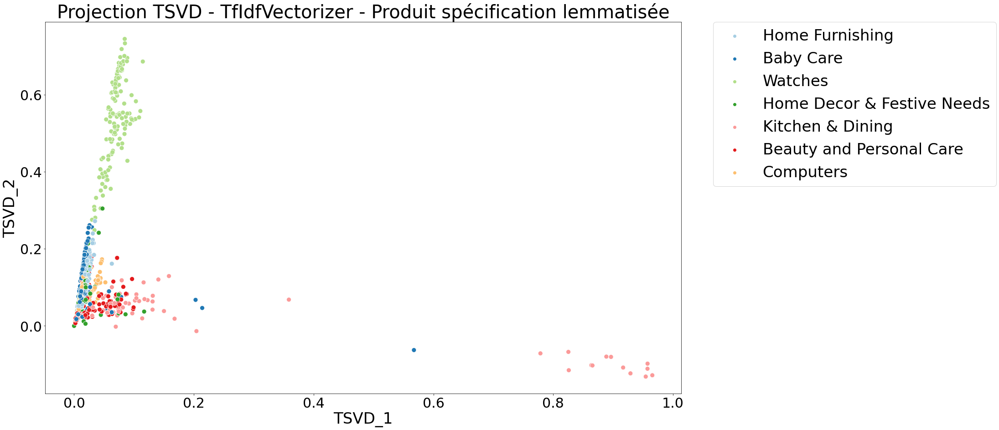

In [193]:
# Visulisation de la projection des 2 premiers variables TSVD
titre_ts = 'Projection TSVD - TfIdfVectorizer'
titre_ts_1 = titre_ts + ' - Produit spécification lemmatisée'
outils_acp.affiche_projections_reducdim(data_work, X_proj_tsvd_tfidf_prod_lem,
                                        'TSVD_1', 'TSVD_2', titre_ts_1)

**produit_specification** - stemmatisée

In [190]:
%pycodestyle_off

In [191]:
# Réduction de dimension TruncatedSVD
tsvd_tfidf_prod_stem = TruncatedSVD(n_components=n_comp_mini_prod_lem,
                                    n_iter=7, random_state=seed)
X_proj_tsvd_tfidf_prod_stem = \
    tsvd_tfidf_prod_stem.fit_transform(vector_tfidfvectorizer_prod_stem)
# Dataframe pour clustering
df_tsvd_tfidf_prod_stem = pd.DataFrame({'VAR1' : X_proj_tsvd_tfidf_prod_stem[:, 0],
                                       'VAR2' : X_proj_tsvd_tfidf_prod_stem[:, 1],
                                       'CATEGORIE' : data_work['Categorie_1']})

In [192]:
%pycodestyle_on

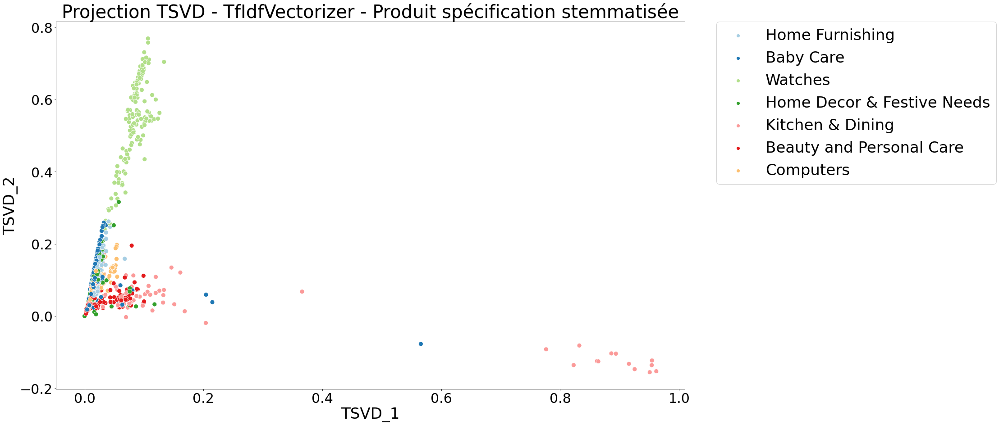

In [202]:
# Visulisation de la projection des 2 premiers variables TSVD
titre_ts_2 = titre_ts + ' - Produit spécification stemmatisée'
outils_acp.affiche_projections_reducdim(data_work, X_proj_tsvd_tfidf_prod_stem,
                                        'TSVD_1', 'TSVD_2', titre_ts_2)

## <span style='background:Thistle'>6. Clustering</span>

Clustering KMeans avec 7 clusters (=nombre de catégories).

In [193]:
cols = ['VAR1', 'VAR2']

In [194]:
# Dataframe de sauvegarde des résultats des métriques KMeans
# df_metrics_kmeans = pd.DataFrame()
# Chargement du jeu de données sauvegardé
df_metrics_kmeans = pd.read_csv('data_df_metrics_kmeans.csv')

In [195]:
# Dataframe de sauvegarde des résultats des scores KMeans
# df_scores = pd.DataFrame()
# Chargement du jeu de données sauvegardé
df_scores = pd.read_csv('data_df_scores.csv')

In [196]:
# Dataframe de sauvegarde des résultats des précisions de la
# catégorisation
# df_precision = pd.DataFrame()
# Chargement du jeu de données sauvegardé
df_precision = pd.read_csv('data_df_precision.csv')

### <span style='background:PowderBlue'>6.1. ACP BOW CountVectorizer</span>

**description** - lemmatisée
***

**Recherche des meilleurs hyperparamètres**

In [160]:
type_donnee = 'ACP_CV_DESC_LEM'

In [161]:
# Tuning hyperparametres n_init, max_iter
# Paramètres à tester
n_init = [10, 20, 30, 50, 70, 80, 100]
max_iter = [100, 200, 300, 400, 500]
# Métriques avec les différentes combinaisons des paramètres
df_metrics_kmeans = \
    outils_nlp.calcul_metrics_kmeans(df_acp_cv_desc_lem[cols],
                                     df_metrics_kmeans,
                                     type_donnee,
                                     seed, n_init, max_iter)
# Tri par indice de dispersion : proche de 0
df_metrics_kmeans[df_metrics_kmeans['Type_données'] == type_donnee] \
    .sort_values(by=['coef_silh', 'davies_bouldin', 'Durée (s)'],
                 ascending=[False, True, True]).style.hide_index()

Type_données,n_init,max_iter,coef_silh,dispersion,davies_bouldin,Durée (s)
ACP_CV_DESC_LEM,20,200,0.61800,705.62342,0.49613,0.06899
ACP_CV_DESC_LEM,20,400,0.61800,705.62342,0.49613,0.06899
ACP_CV_DESC_LEM,20,500,0.61800,705.62342,0.49613,0.06899
ACP_CV_DESC_LEM,20,300,0.61800,705.62342,0.49613,0.06899
ACP_CV_DESC_LEM,20,100,0.61800,705.62342,0.49613,0.07500
ACP_CV_DESC_LEM,30,500,0.61800,705.62342,0.49613,0.09941
ACP_CV_DESC_LEM,30,100,0.61800,705.62342,0.49613,0.10023
ACP_CV_DESC_LEM,30,200,0.61800,705.62342,0.49613,0.10141
ACP_CV_DESC_LEM,30,400,0.61800,705.62342,0.49613,0.10173
ACP_CV_DESC_LEM,30,300,0.61800,705.62342,0.49613,0.11161


In [162]:
# Sauvegarde des dataframes de trace
outils_data.to_csv(df_metrics_kmeans, 'data_df_metrics_kmeans.csv')

**Clustering**

In [163]:
# Instanciation du modèle KMeans avec les meilleurs paramètres
kmeans_acp_cv_desc_lem = KMeans(n_clusters=7, init='k-means++',
                                n_init=20, max_iter=200,
                                random_state=seed) \
    .fit(df_acp_cv_desc_lem[cols])
# Ajout de l'assignation du cluster au dataframe
df_acp_cv_desc_lem['Clusters'] = kmeans_acp_cv_desc_lem.labels_
kmeans_acp_cv_desc_lem_labels = kmeans_acp_cv_desc_lem.labels_

In [168]:
# Scores ?
df_scores = outils_nlp.calcul_metriques_clusters(df_acp_cv_desc_lem,
                                                 df_scores,
                                                 type_donnee)
df_scores.style.hide_index()

Type_données,ARI,Homogénéité,Complétude,V-measure
ACP_CV_DESC_LEM,0.03894,0.11797,0.20952,0.15095


In [169]:
# Sauvegarde des dataframes de trace
outils_data.to_csv(df_scores, 'data_df_scores.csv')

Clusters,Nombre,%
0,676,64.38000
1,29,2.76000
2,6,0.57000
3,25,2.38000
4,28,2.67000
5,63,6.00000
6,223,21.24000


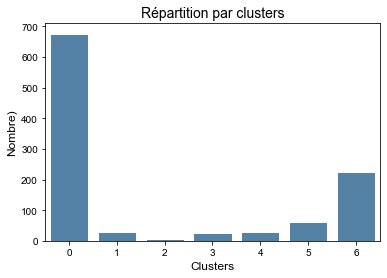

In [170]:
outils_nlp.affiche_repartition_par_clusters(kmeans_acp_cv_desc_lem_labels)

In [171]:
# Les catégories par clusters
df_acp_cv_desc_lem.groupby('Clusters')['CATEGORIE'].value_counts().to_frame()

CATEGORIE
Clusters CATEGORIE                            
0        Watches                           142
         Beauty and Personal Care          125
         Home Decor & Festive Needs         97
         Computers                          93
         Home Furnishing                    92
         Kitchen & Dining                   65
         Baby Care                          62
1        Kitchen & Dining                   29
2        Computers                           6
3        Computers                          21
         Home Decor & Festive Needs          3
         Beauty and Personal Care            1
4        Kitchen & Dining                   26
         Baby Care                           1
         Home Decor & Festive Needs          1
5        Computers                          16
         Home Decor & Festive Needs         15
         Home Furnishing                    12
         Kitchen & Dining                    8
         Baby Care                           7
         Beauty and Personal Care            4
         Watches                             1
6        Baby Care                          80
         Home Furnishing                    46
         Home Decor & Festive Needs         34
         Kitchen & Dining                   22
         Beauty and Personal Care           20
         Computers                          14
         Watches                             7

**Visualisation des clusters**

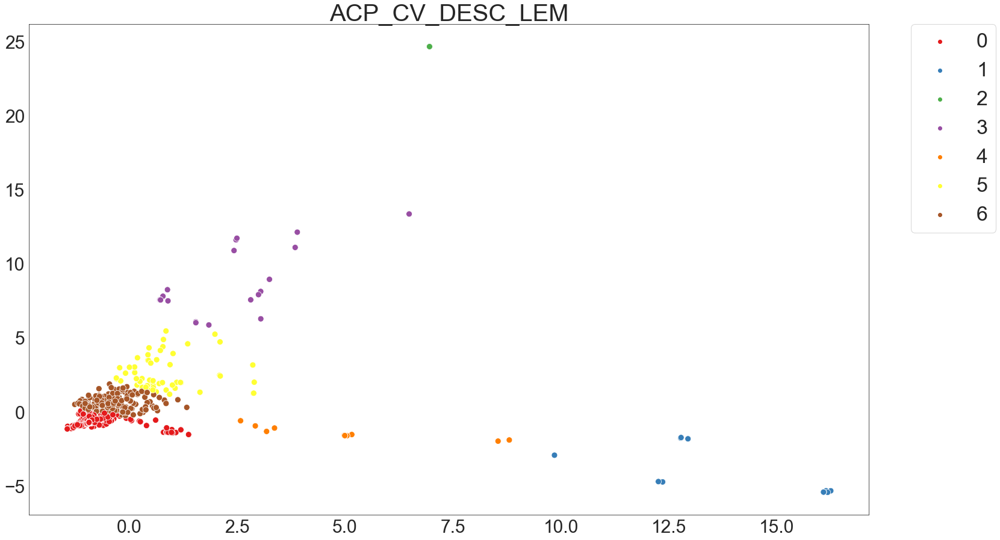

In [172]:
# Visualisation des clusters
outils_nlp.affiche_projection_par_clusters(X_proj_acp_cv_desc_lem,
                                           kmeans_acp_cv_desc_lem_labels,
                                           type_donnee)

In [173]:
# Sauvegarde des précisions de la catégorisation
df_precision = outils_nlp.sauvegarde_precision(df_precision, '0',
                                               type_donnee)
# Sauvegarde des dataframes de trace
outils_data.to_csv(df_precision, 'data_df_precision.csv')

**Bilan** :
***
- Répartition inégale (2 gros clusters), les vraies catégories sont mélangées dans les clusters, certains clusters sont vides, le score ARI est très faible.
- Cette combinaison ACP CountVectorizer + description lemmatisée ne parvient pas retrouver les 7 catégories comme le souhaite notre client.

**description** - stemmatisée
***

**Recherche des meilleurs hyperparamètres**

In [174]:
type_donnee = 'ACP_CV_DESC_STEM'

In [175]:
# Tuning hyperparametres n_init, max_iter
# Paramètres à tester
n_init = [10, 20, 30, 50, 70, 80, 100]
max_iter = [100, 200, 300, 400, 500]

# Métriques avec les différentes combinaisons des paramètres
df_metrics_kmeans = \
    outils_nlp.calcul_metrics_kmeans(df_acp_cv_desc_stem[cols],
                                     df_metrics_kmeans,
                                     type_donnee,
                                     seed, n_init, max_iter)
# Tri par indice de dispersion : proche de 0
df_metrics_kmeans[df_metrics_kmeans['Type_données'] == type_donnee] \
    .sort_values(by=['coef_silh', 'davies_bouldin', 'Durée (s)'],
                 ascending=[False, True, True]).style.hide_index()

Type_données,n_init,max_iter,coef_silh,dispersion,davies_bouldin,Durée (s)
ACP_CV_DESC_STEM,100,500,0.61077,872.22452,0.52778,0.31604
ACP_CV_DESC_STEM,100,300,0.61077,872.22452,0.52778,0.31641
ACP_CV_DESC_STEM,100,100,0.61077,872.22452,0.52778,0.32514
ACP_CV_DESC_STEM,100,200,0.61077,872.22452,0.52778,0.33208
ACP_CV_DESC_STEM,100,400,0.61077,872.22452,0.52778,0.33209
ACP_CV_DESC_STEM,10,200,0.60953,872.67672,0.52761,0.02394
ACP_CV_DESC_STEM,10,300,0.60953,872.67672,0.52761,0.03124
ACP_CV_DESC_STEM,10,500,0.60953,872.67672,0.52761,0.03587
ACP_CV_DESC_STEM,10,100,0.60953,872.67672,0.52761,0.03590
ACP_CV_DESC_STEM,10,400,0.60953,872.67672,0.52761,0.03730


In [176]:
# Sauvegarde des dataframes de trace
outils_data.to_csv(df_metrics_kmeans, 'data_df_metrics_kmeans.csv')

**Clustering**

In [177]:
# Instanciation du modèle KMeans avec les meilleurs paramètres
kmeans_acp_cv_desc_stem = KMeans(n_clusters=7, init='k-means++',
                                 n_init=100, max_iter=500,
                                 random_state=seed) \
    .fit(df_acp_cv_desc_stem[cols])
# Ajout de l'assignation du cluster au dataframe
df_acp_cv_desc_stem['Clusters'] = kmeans_acp_cv_desc_stem.labels_
kmeans_acp_cv_desc_stem_labels = kmeans_acp_cv_desc_stem.labels_

In [180]:
# Scores ?
df_scores = outils_nlp.calcul_metriques_clusters(df_acp_cv_desc_stem,
                                                 df_scores,
                                                 type_donnee)
df_scores.style.hide_index()

Type_données,ARI,Homogénéité,Complétude,V-measure
ACP_CV_DESC_LEM,0.03894,0.11797,0.20952,0.15095
ACP_CV_DESC_STEM,0.04503,0.11941,0.19802,0.14898


In [181]:
# Sauvegarde des dataframes de trace
outils_data.to_csv(df_scores, 'data_df_scores.csv')

Clusters,Nombre,%
0,214,20.38000
1,6,0.57000
2,28,2.67000
3,647,61.62000
4,33,3.14000
5,31,2.95000
6,91,8.67000


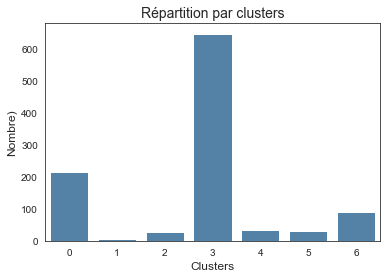

In [182]:
outils_nlp.affiche_repartition_par_clusters(kmeans_acp_cv_desc_stem_labels)

In [183]:
# Les catégories par clusters
df_acp_cv_desc_stem.groupby('Clusters')['CATEGORIE'].value_counts().to_frame()

CATEGORIE
Clusters CATEGORIE                            
0        Baby Care                          82
         Home Decor & Festive Needs         35
         Home Furnishing                    35
         Kitchen & Dining                   24
         Beauty and Personal Care           20
         Computers                          11
         Watches                             7
1        Computers                           6
2        Kitchen & Dining                   28
3        Watches                           142
         Beauty and Personal Care          119
         Computers                          94
         Home Decor & Festive Needs         92
         Home Furnishing                    89
         Kitchen & Dining                   58
         Baby Care                          53
4        Computers                          23
         Baby Care                           3
         Home Decor & Festive Needs          3
         Home Furnishing                     3
         Beauty and Personal Care            1
5        Kitchen & Dining                   27
         Home Decor & Festive Needs          3
         Baby Care                           1
6        Home Furnishing                    23
         Home Decor & Festive Needs         17
         Computers                          16
         Kitchen & Dining                   13
         Baby Care                          11
         Beauty and Personal Care           10
         Watches                             1

**Visualisation des clusters**

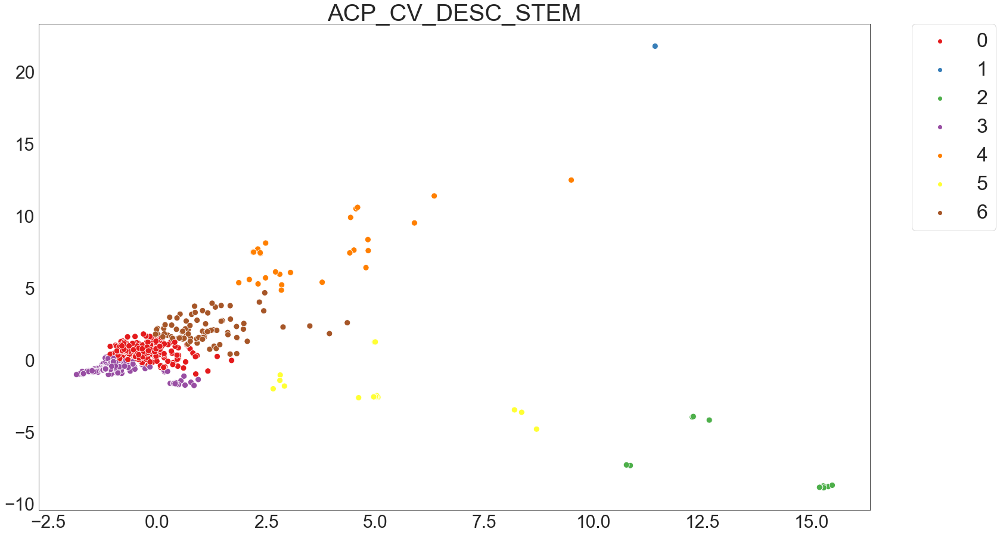

In [184]:
# Visualisation des clusters
outils_nlp.affiche_projection_par_clusters(X_proj_acp_cv_desc_stem,
                                           kmeans_acp_cv_desc_stem_labels,
                                           type_donnee)

In [185]:
# Sauvegarde des précisions de la catégorisation
df_precision = outils_nlp.sauvegarde_precision(df_precision, '0',
                                               type_donnee)
# Sauvegarde des dataframes de trace
outils_data.to_csv(df_precision, 'data_df_precision.csv')

**Bilan** :
***
- Répartition inégale (2 gros clusters), les vraies catégories sont mélangées dans les clusters, certains clusters sont vides, le score ARI est  faible (mias plus grand qu'avec les données lemmatisées).
- Cette combinaison ACP CountVectorizer + description stemmatisée ne parvient pas retrouver les 7 catégories comme le souhaite notre client.

**produit_specification** - lemmatisée
***

**Recherche des meilleurs hyperparamètres**

In [186]:
type_donnee = 'ACP_CV_PROD_LEM'

In [187]:
# Tuning hyperparametres n_init, max_iter
# Paramètres à tester
n_init = [10, 20, 30, 50, 70, 80, 100]
max_iter = [100, 200, 300, 400, 500]
# Métriques avec les différentes combinaisons des paramètres
df_metrics_kmeans = \
    outils_nlp.calcul_metrics_kmeans(df_acp_cv_prod_lem[cols],
                                     df_metrics_kmeans,
                                     type_donnee,
                                     seed, n_init, max_iter)
# Tri par indice de dispersion : proche de 0
df_metrics_kmeans[df_metrics_kmeans['Type_données'] == type_donnee] \
    .sort_values(by=['coef_silh', 'davies_bouldin', 'Durée (s)'],
                 ascending=[False, True, True]).style.hide_index()

Type_données,n_init,max_iter,coef_silh,dispersion,davies_bouldin,Durée (s)
ACP_CV_PROD_LEM,10,400,0.70152,415.40420,0.46668,0.03568
ACP_CV_PROD_LEM,10,300,0.70152,415.40420,0.46668,0.04698
ACP_CV_PROD_LEM,10,500,0.70152,415.40420,0.46668,0.04804
ACP_CV_PROD_LEM,10,100,0.70152,415.40420,0.46668,0.04887
ACP_CV_PROD_LEM,10,200,0.70152,415.40420,0.46668,0.04887
ACP_CV_PROD_LEM,20,200,0.69973,415.34976,0.46384,0.09014
ACP_CV_PROD_LEM,30,500,0.69973,415.34976,0.46384,0.12467
ACP_CV_PROD_LEM,30,100,0.69973,415.34976,0.46384,0.14561
ACP_CV_PROD_LEM,50,300,0.69973,415.34976,0.46384,0.20906
ACP_CV_PROD_LEM,50,400,0.69973,415.34976,0.46384,0.21243


In [188]:
# Sauvegarde des dataframes de trace
outils_data.to_csv(df_metrics_kmeans, 'data_df_metrics_kmeans.csv')

**Clustering**

In [189]:
# Instanciation du modèle KMeans avec les meilleurs paramètres
kmeans_acp_cv_prod_lem = KMeans(n_clusters=7, init='k-means++',
                                n_init=10, max_iter=400,
                                random_state=seed) \
    .fit(df_acp_cv_prod_lem[cols])
# Ajout de l'assignation du cluster au dataframe
df_acp_cv_prod_lem['Clusters'] = kmeans_acp_cv_prod_lem.labels_
kmeans_acp_cv_prod_lem_labels = kmeans_acp_cv_prod_lem.labels_

In [190]:
# Scores ?
df_scores = outils_nlp.calcul_metriques_clusters(df_acp_cv_prod_lem,
                                                 df_scores,
                                                 type_donnee)

In [191]:
df_scores.style.hide_index()

Type_données,ARI,Homogénéité,Complétude,V-measure
ACP_CV_DESC_LEM,0.03894,0.11797,0.20952,0.15095
ACP_CV_DESC_STEM,0.04503,0.11941,0.19802,0.14898
ACP_CV_PROD_LEM,0.10551,0.26012,0.58404,0.35994


In [192]:
# Sauvegarde des dataframes de trace
outils_data.to_csv(df_scores, 'data_df_scores.csv')

Clusters,Nombre,%
0,798,76.00000
1,48,4.57000
2,8,0.76000
3,10,0.95000
4,109,10.38000
5,75,7.14000
6,2,0.19000


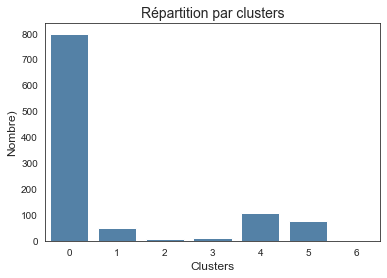

In [193]:
outils_nlp.affiche_repartition_par_clusters(kmeans_acp_cv_prod_lem_labels)

In [194]:
# Les catégories par clusters
df_acp_cv_prod_lem.groupby('Clusters')['CATEGORIE'].value_counts().to_frame()

CATEGORIE
Clusters CATEGORIE                            
0        Baby Care                         150
         Home Furnishing                   150
         Beauty and Personal Care          146
         Kitchen & Dining                  146
         Home Decor & Festive Needs        143
         Computers                          35
         Watches                            28
1        Watches                            48
2        Computers                           8
3        Computers                          10
4        Computers                          97
         Home Decor & Festive Needs          5
         Kitchen & Dining                    4
         Beauty and Personal Care            3
5        Watches                            72
         Home Decor & Festive Needs          2
         Beauty and Personal Care            1
6        Watches                             2

**Visualisation des clusters**

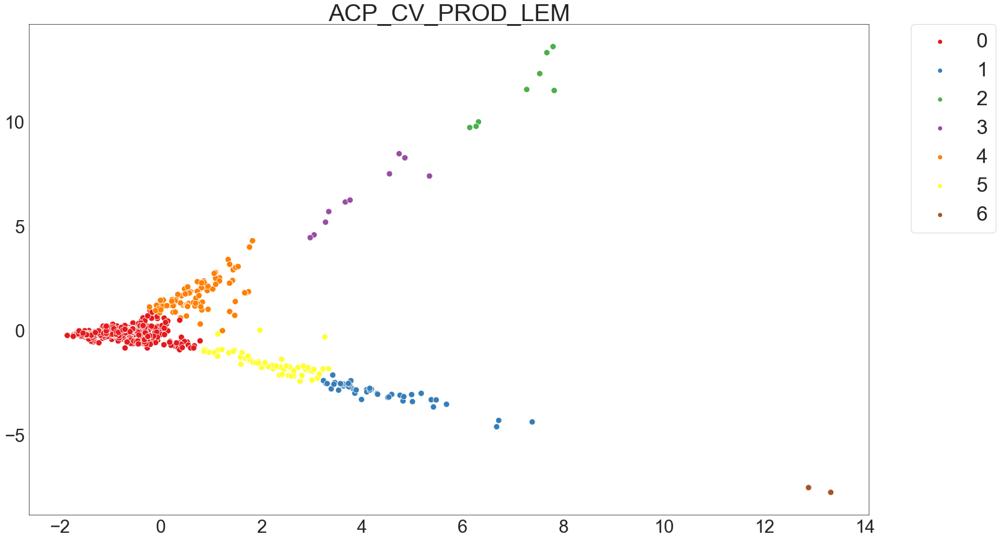

In [195]:
# Visualisation des clusters
outils_nlp.affiche_projection_par_clusters(X_proj_acp_cv_prod_lem,
                                           kmeans_acp_cv_prod_lem_labels,
                                           type_donnee)

In [196]:
# Sauvegarde des précisions de la catégorisation
df_precision = outils_nlp.sauvegarde_precision(df_precision, '0',
                                               type_donnee)
# Sauvegarde des dataframes de trace
outils_data.to_csv(df_precision, 'data_df_precision.csv')

**Bilan** :
***
- Répartition inégale (1 gros cluster), les vraies catégories sont mélangées dans les clusters, certains clusters sont vides, le score ARI est faible (mais plus grand qu'avec les données description stemmatisées).
- Cette combinaison ACP CountVectorizer + produit spécification lemmatisée ne parvient pas retrouver les 7 catégories comme le souhaite notre client.

**produit_specification** - stemmatisée
***

**Recherche des meilleurs hyperparamètres**

In [197]:
type_donnee = 'ACP_CV_PROD_STEM'

In [198]:
# Tuning hyperparametres n_init, max_iter
# Paramètres à tester
n_init = [10, 20, 30, 50, 70, 80, 100]
max_iter = [100, 200, 300, 400, 500]
# Métriques avec les différentes combinaisons des paramètres
df_metrics_kmeans = \
    outils_nlp.calcul_metrics_kmeans(df_acp_cv_prod_stem[cols],
                                     df_metrics_kmeans,
                                     type_donnee,
                                     seed, n_init, max_iter)
# Tri par indice de dispersion : proche de 0
df_metrics_kmeans[df_metrics_kmeans['Type_données'] == type_donnee] \
    .sort_values(by=['coef_silh', 'davies_bouldin', 'Durée (s)'],
                 ascending=[False, True, True]).style.hide_index()

Type_données,n_init,max_iter,coef_silh,dispersion,davies_bouldin,Durée (s)
ACP_CV_PROD_STEM,10,100,0.72346,439.74696,0.46608,0.04189
ACP_CV_PROD_STEM,10,500,0.72346,439.74696,0.46608,0.04189
ACP_CV_PROD_STEM,10,400,0.72346,439.74696,0.46608,0.04289
ACP_CV_PROD_STEM,10,200,0.72346,439.74696,0.46608,0.04388
ACP_CV_PROD_STEM,10,300,0.72346,439.74696,0.46608,0.04488
ACP_CV_PROD_STEM,20,100,0.72346,439.74696,0.46608,0.08178
ACP_CV_PROD_STEM,20,400,0.72346,439.74696,0.46608,0.08178
ACP_CV_PROD_STEM,20,300,0.72346,439.74696,0.46608,0.08278
ACP_CV_PROD_STEM,20,500,0.72346,439.74696,0.46608,0.08378
ACP_CV_PROD_STEM,20,200,0.72346,439.74696,0.46608,0.08477


In [199]:
# Sauvegarde des dataframes de trace
outils_data.to_csv(df_metrics_kmeans, 'data_df_metrics_kmeans.csv')

**Clustering**

In [200]:
# Instanciation du modèle KMeans avec les meilleurs paramètres
kmeans_acp_cv_prod_stem = KMeans(n_clusters=7, init='k-means++',
                                 n_init=10, max_iter=100,
                                 random_state=seed) \
    .fit(df_acp_cv_prod_stem[cols])
# Ajout de l'assignation du cluster au dataframe
df_acp_cv_prod_stem['Clusters'] = kmeans_acp_cv_prod_stem.labels_
kmeans_acp_cv_prod_stem_labels = kmeans_acp_cv_prod_stem.labels_

In [201]:
# Scores ?
df_scores = outils_nlp.calcul_metriques_clusters(df_acp_cv_prod_stem,
                                                 df_scores,
                                                 type_donnee)
df_scores.style.hide_index()

Type_données,ARI,Homogénéité,Complétude,V-measure
ACP_CV_DESC_LEM,0.03894,0.11797,0.20952,0.15095
ACP_CV_DESC_STEM,0.04503,0.11941,0.19802,0.14898
ACP_CV_PROD_LEM,0.10551,0.26012,0.58404,0.35994
ACP_CV_PROD_STEM,0.10015,0.25417,0.57940,0.35334


In [202]:
# Sauvegarde des dataframes de trace
outils_data.to_csv(df_scores, 'data_df_scores.csv')

Clusters,Nombre,%
0,804,76.57000
1,75,7.14000
2,8,0.76000
3,105,10.00000
4,2,0.19000
5,46,4.38000
6,10,0.95000


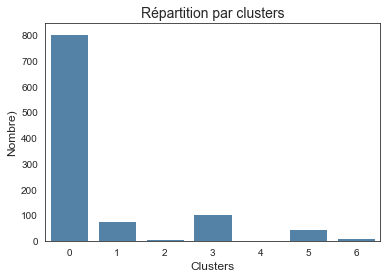

In [203]:
outils_nlp.affiche_repartition_par_clusters(kmeans_acp_cv_prod_stem_labels)

In [204]:
# Les catégories par clusters
df_acp_cv_prod_stem.groupby('Clusters')['CATEGORIE'].value_counts().to_frame()

CATEGORIE
Clusters CATEGORIE                            
0        Baby Care                         150
         Home Furnishing                   150
         Beauty and Personal Care          147
         Kitchen & Dining                  146
         Home Decor & Festive Needs        143
         Computers                          39
         Watches                            29
1        Watches                            73
         Beauty and Personal Care            1
         Home Decor & Festive Needs          1
2        Computers                           8
3        Computers                          93
         Home Decor & Festive Needs          6
         Kitchen & Dining                    4
         Beauty and Personal Care            2
4        Watches                             2
5        Watches                            46
6        Computers                          10

**Visualisation des clusters**

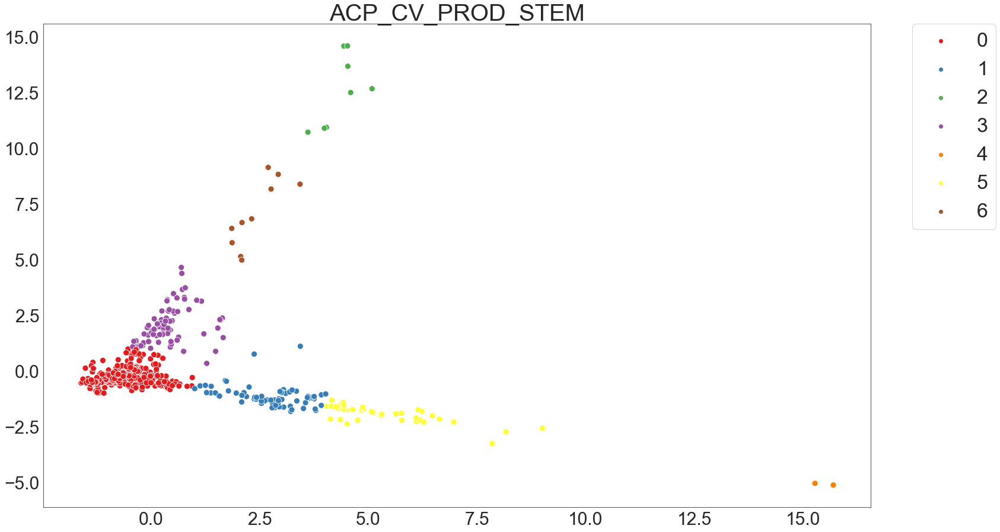

In [205]:
# Visualisation des clusters
outils_nlp.affiche_projection_par_clusters(X_proj_acp_cv_prod_stem,
                                           kmeans_acp_cv_prod_stem_labels,
                                           type_donnee)

In [206]:
# Sauvegarde des précisions de la catégorisation
df_precision = outils_nlp.sauvegarde_precision(df_precision, '0',
                                               type_donnee)
# Sauvegarde des dataframes de trace
outils_data.to_csv(df_precision, 'data_df_precision.csv')

**Bilan** :
***
- Répartition inégale (1 gros cluster), les vraies catégories sont mélangées dans les clusters, certains clusters sont vides, le score ARI est faible (plus faible qu'avec les données produit spécification lemmatisée).
- Cette combinaison ACP CountVectorizer + produit spécification stemmatisée ne parvient pas retrouver les 7 catégories comme le souhaite notre client.

### <span style='background:PowderBlue'>6.2. ACP BOW TfidfVectorizer</span>

**description** - lemmatisée
***

**Recherche des meilleurs hyperparamètres**

In [207]:
type_donnee = 'ACP_TFIDF_DESC_LEM'

In [208]:
# Tuning hyperparametres n_init, max_iter
# Paramètres à tester
n_init = [10, 20, 30, 50, 70, 80, 100]
max_iter = [100, 200, 300, 400, 500]
# Métriques avec les différentes combinaisons des paramètres
df_metrics_kmeans = \
    outils_nlp.calcul_metrics_kmeans(df_acp_tfidf_desc_lem[cols],
                                     df_metrics_kmeans,
                                     type_donnee,
                                     seed, n_init, max_iter)
# Tri par indice de dispersion : proche de 0
df_metrics_kmeans[df_metrics_kmeans['Type_données'] == type_donnee] \
    .sort_values(by=['coef_silh', 'davies_bouldin', 'Durée (s)'],
                 ascending=[False, True, True]).style.hide_index()

Type_données,n_init,max_iter,coef_silh,dispersion,davies_bouldin,Durée (s)
ACP_TFIDF_DESC_LEM,10,400,0.64275,1.81123,0.52517,0.03505
ACP_TFIDF_DESC_LEM,10,300,0.64275,1.81123,0.52517,0.03590
ACP_TFIDF_DESC_LEM,10,200,0.64275,1.81123,0.52517,0.03690
ACP_TFIDF_DESC_LEM,10,100,0.64275,1.81123,0.52517,0.03690
ACP_TFIDF_DESC_LEM,10,500,0.64275,1.81123,0.52517,0.04015
ACP_TFIDF_DESC_LEM,20,500,0.64275,1.81123,0.52517,0.06782
ACP_TFIDF_DESC_LEM,20,100,0.64275,1.81123,0.52517,0.06824
ACP_TFIDF_DESC_LEM,20,300,0.64275,1.81123,0.52517,0.06881
ACP_TFIDF_DESC_LEM,20,400,0.64275,1.81123,0.52517,0.06981
ACP_TFIDF_DESC_LEM,20,200,0.64275,1.81123,0.52517,0.07667


In [209]:
# Sauvegarde des dataframes de trace
outils_data.to_csv(df_metrics_kmeans, 'data_df_metrics_kmeans.csv')

**Clustering**

In [210]:
# Instanciation du modèle KMeans avec les meilleurs paramètres
kmeans_acp_tfidf_desc_lem = KMeans(n_clusters=7, init='k-means++',
                                   n_init=10, max_iter=400,
                                   random_state=seed) \
    .fit(df_acp_tfidf_desc_lem[cols])
# Ajout de l'assignation du cluster au dataframe
df_acp_tfidf_desc_lem['Clusters'] = kmeans_acp_tfidf_desc_lem.labels_
kmeans_acp_tfidf_desc_lem_labels = kmeans_acp_tfidf_desc_lem.labels_

In [212]:
# Scores ?
df_scores = outils_nlp.calcul_metriques_clusters(df_acp_tfidf_desc_lem,
                                                 df_scores,
                                                 type_donnee)
df_scores.style.hide_index()

Type_données,ARI,Homogénéité,Complétude,V-measure
ACP_CV_DESC_LEM,0.03894,0.11797,0.20952,0.15095
ACP_CV_DESC_STEM,0.04503,0.11941,0.19802,0.14898
ACP_CV_PROD_LEM,0.10551,0.26012,0.58404,0.35994
ACP_CV_PROD_STEM,0.10015,0.25417,0.57940,0.35334
ACP_TFIDF_DESC_LEM,0.14925,0.34720,0.53091,0.41984


In [213]:
# Sauvegarde des dataframes de trace
outils_data.to_csv(df_scores, 'data_df_scores.csv')

Clusters,Nombre,%
0,618,58.86000
1,70,6.67000
2,51,4.86000
3,210,20.00000
4,24,2.29000
5,64,6.10000
6,13,1.24000


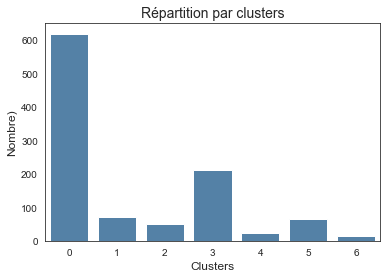

In [214]:
outils_nlp.affiche_repartition_par_clusters(kmeans_acp_tfidf_desc_lem_labels)

In [215]:
# Les catégories par clusters
df_acp_tfidf_desc_lem.groupby('Clusters')['CATEGORIE'].value_counts().to_frame()

CATEGORIE
Clusters CATEGORIE                            
0        Home Decor & Festive Needs        150
         Computers                         138
         Home Furnishing                   117
         Beauty and Personal Care           84
         Kitchen & Dining                   76
         Baby Care                          50
         Watches                             3
1        Watches                            70
2        Kitchen & Dining                   50
         Baby Care                           1
3        Baby Care                          99
         Beauty and Personal Care           66
         Home Furnishing                    33
         Computers                          12
4        Kitchen & Dining                   24
5        Watches                            64
6        Watches                            13

2:80: E501 line too long (80 > 79 characters)


**Visualisation des clusters**

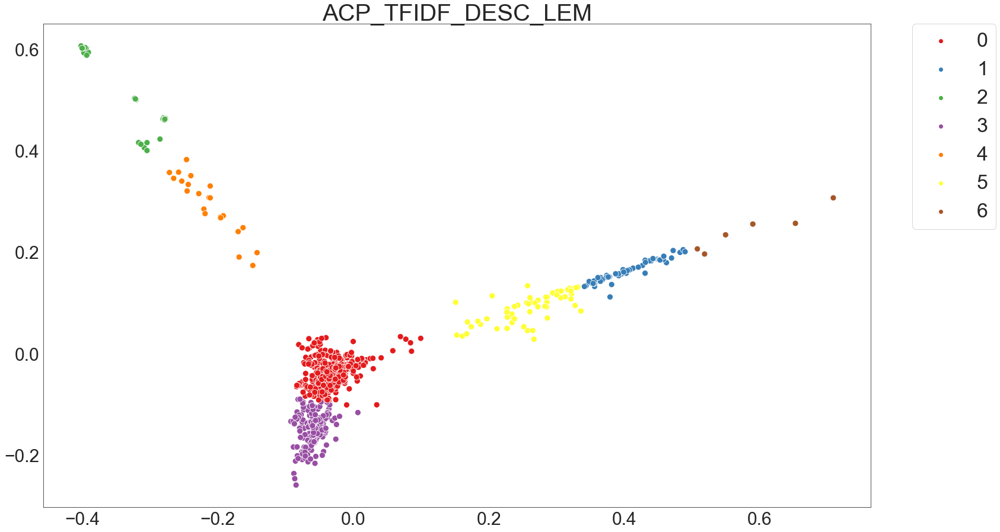

In [216]:
# Visualisation des clusters
outils_nlp.affiche_projection_par_clusters(X_proj_acp_tfidf_desc_lem,
                                           kmeans_acp_tfidf_desc_lem_labels,
                                           type_donnee)

In [217]:
# Sauvegarde des précisions de la catégorisation
df_precision = outils_nlp.sauvegarde_precision(df_precision, '0',
                                               type_donnee)
# Sauvegarde des dataframes de trace
outils_data.to_csv(df_precision, 'data_df_precision.csv')

**Bilan** :
***
- Répartition inégale (2 gros clusters), les vraies catégories sont mélangées dans les clusters, certains clusters sont vides, le score ARI est faible (mais meilleur résultat qu'avec ACP CountVectorizer).
- Cette combinaison ACP TfidfVectorizer+ description lemmatisée ne parvient pas retrouver les 7 catégories comme le souhaite notre client.

**description** - stemmatisée
***

**Recherche des meilleurs hyperparamètres**

In [218]:
type_donnee = 'ACP_TFIDF_DESC_STEM'

In [219]:
# Tuning hyperparametres n_init, max_iter
# Paramètres à tester
n_init = [10, 20, 30, 50, 70, 80, 100]
max_iter = [100, 200, 300, 400, 500]
# Métriques avec les différentes combinaisons des paramètres
df_metrics_kmeans = \
    outils_nlp.calcul_metrics_kmeans(df_acp_tfidf_desc_stem[cols],
                                     df_metrics_kmeans,
                                     type_donnee,
                                     seed, n_init, max_iter)
# Tri par indice de dispersion : proche de 0
df_metrics_kmeans[df_metrics_kmeans['Type_données'] == type_donnee] \
    .sort_values(by=['coef_silh', 'davies_bouldin', 'Durée (s)'],
                 ascending=[False, True, True]).style.hide_index()

Type_données,n_init,max_iter,coef_silh,dispersion,davies_bouldin,Durée (s)
ACP_TFIDF_DESC_STEM,10,300,0.62911,1.83560,0.52933,0.03790
ACP_TFIDF_DESC_STEM,10,200,0.62911,1.83560,0.52933,0.03790
ACP_TFIDF_DESC_STEM,10,500,0.62911,1.83560,0.52933,0.03790
ACP_TFIDF_DESC_STEM,10,100,0.62911,1.83560,0.52933,0.03821
ACP_TFIDF_DESC_STEM,10,400,0.62911,1.83560,0.52933,0.03890
ACP_TFIDF_DESC_STEM,20,300,0.62911,1.83560,0.52933,0.06237
ACP_TFIDF_DESC_STEM,20,500,0.62911,1.83560,0.52933,0.06248
ACP_TFIDF_DESC_STEM,20,100,0.62911,1.83560,0.52933,0.07281
ACP_TFIDF_DESC_STEM,20,200,0.62911,1.83560,0.52933,0.07480
ACP_TFIDF_DESC_STEM,20,400,0.62911,1.83560,0.52933,0.08461


In [220]:
# Sauvegarde des dataframes de trace
outils_data.to_csv(df_metrics_kmeans, 'data_df_metrics_kmeans.csv')

**Clustering**

In [221]:
# Instanciation du modèle KMeans avec les meilleurs paramètres
kmeans_acp_tfid_desc_stem = KMeans(n_clusters=7, init='k-means++',
                                   n_init=10, max_iter=200,
                                   random_state=seed) \
    .fit(df_acp_tfidf_desc_stem[cols])
# Ajout de l'assignation du cluster au dataframe
df_acp_tfidf_desc_stem['Clusters'] = kmeans_acp_tfid_desc_stem.labels_
kmeans_acp_tfid_desc_stem_labels = kmeans_acp_tfid_desc_stem.labels_

In [222]:
# Scores ?
df_scores = outils_nlp.calcul_metriques_clusters(df_acp_tfidf_desc_stem,
                                                 df_scores,
                                                 type_donnee)
df_scores.style.hide_index()

Type_données,ARI,Homogénéité,Complétude,V-measure
ACP_CV_DESC_LEM,0.03894,0.11797,0.20952,0.15095
ACP_CV_DESC_STEM,0.04503,0.11941,0.19802,0.14898
ACP_CV_PROD_LEM,0.10551,0.26012,0.58404,0.35994
ACP_CV_PROD_STEM,0.10015,0.25417,0.57940,0.35334
ACP_TFIDF_DESC_LEM,0.14925,0.34720,0.53091,0.41984
ACP_TFIDF_DESC_STEM,0.14698,0.34728,0.52762,0.41886


In [223]:
# Sauvegarde des dataframes de trace
outils_data.to_csv(df_scores, 'data_df_scores.csv')

Clusters,Nombre,%
0,619,58.95000
1,66,6.29000
2,51,4.86000
3,209,19.90000
4,61,5.81000
5,20,1.90000
6,24,2.29000


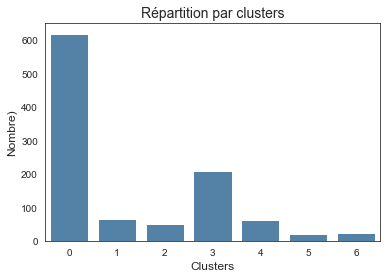

In [224]:
outils_nlp.affiche_repartition_par_clusters(kmeans_acp_tfid_desc_stem_labels)

In [227]:
# Les catégories par clusters
df_acp_tfidf_desc_stem.groupby('Clusters')['CATEGORIE'].value_counts() \
    .to_frame()

CATEGORIE
Clusters CATEGORIE                            
0        Home Decor & Festive Needs        150
         Computers                         138
         Home Furnishing                   117
         Beauty and Personal Care           86
         Kitchen & Dining                   76
         Baby Care                          49
         Watches                             3
1        Watches                            66
2        Kitchen & Dining                   50
         Baby Care                           1
3        Baby Care                         100
         Beauty and Personal Care           64
         Home Furnishing                    33
         Computers                          12
4        Watches                            61
5        Watches                            20
6        Kitchen & Dining                   24

**Visualisation des clusters**

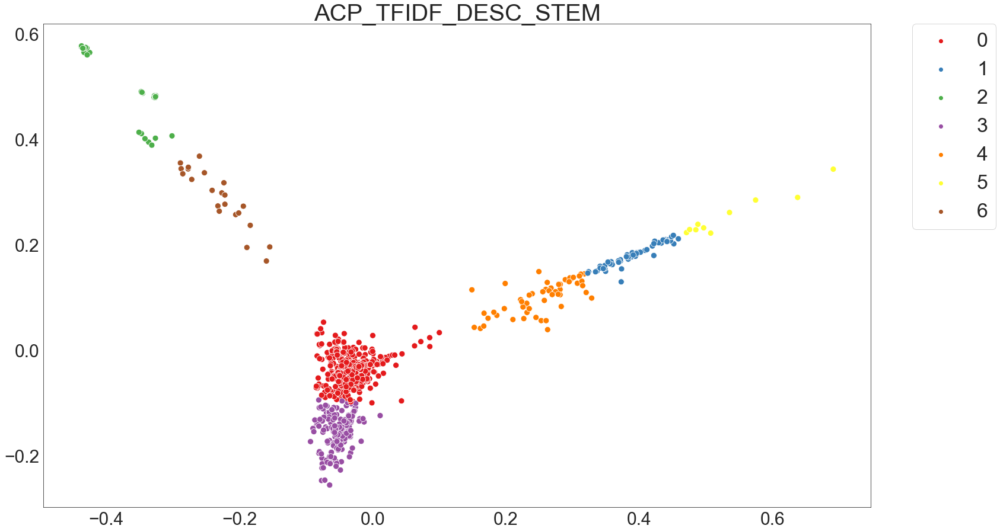

In [228]:
# Visualisation des clusters
outils_nlp.affiche_projection_par_clusters(X_proj_acp_tfidf_desc_stem,
                                           kmeans_acp_tfid_desc_stem_labels,
                                           type_donnee)

In [229]:
# Sauvegarde des précisions de la catégorisation
df_precision = outils_nlp.sauvegarde_precision(df_precision, '0',
                                               type_donnee)
# Sauvegarde des dataframes de trace
outils_data.to_csv(df_precision, 'data_df_precision.csv')

**Bilan** :
***
- Répartition inégale (2 gros clusters), les vraies catégories sont mélangées dans les clusters, certains clusters sont vides, le score ARI est  faible (et plus petit qu'avec les données lemmatisées).
- Cette combinaison ACP TfidfVectorizer + description stemmatisée ne parvient pas retrouver les 7 catégories comme le souhaite notre client.

**produit_specification** - lemmatisée
***

**Recherche des meilleurs hyperparamètres**

In [230]:
type_donnee = 'ACP_TFIDF_PROD_LEM'

In [231]:
# Tuning hyperparametres n_init, max_iter
# Paramètres à tester
n_init = [10, 20, 30, 50, 70, 80, 100]
max_iter = [100, 200, 300, 400, 500]
# Métriques avec les différentes combinaisons des paramètres
df_metrics_kmeans = \
    outils_nlp.calcul_metrics_kmeans(df_acp_tfidf_prod_lem[cols],
                                     df_metrics_kmeans,
                                     type_donnee,
                                     seed, n_init, max_iter)
# Tri par indice de dispersion : proche de 0
df_metrics_kmeans[df_metrics_kmeans['Type_données'] == type_donnee] \
    .sort_values(by=['coef_silh', 'davies_bouldin', 'Durée (s)'],
                 ascending=[False, True, True]).style.hide_index()

Type_données,n_init,max_iter,coef_silh,dispersion,davies_bouldin,Durée (s)
ACP_TFIDF_PROD_LEM,20,500,0.47505,1.93732,0.59960,0.06985
ACP_TFIDF_PROD_LEM,20,200,0.47505,1.93732,0.59960,0.07348
ACP_TFIDF_PROD_LEM,20,100,0.47505,1.93732,0.59960,0.07979
ACP_TFIDF_PROD_LEM,20,400,0.47505,1.93732,0.59960,0.07979
ACP_TFIDF_PROD_LEM,20,300,0.47505,1.93732,0.59960,0.08078
ACP_TFIDF_PROD_LEM,30,200,0.47505,1.93732,0.59960,0.10674
ACP_TFIDF_PROD_LEM,30,500,0.47505,1.93732,0.59960,0.11480
ACP_TFIDF_PROD_LEM,30,300,0.47505,1.93732,0.59960,0.11585
ACP_TFIDF_PROD_LEM,30,100,0.47505,1.93732,0.59960,0.12185
ACP_TFIDF_PROD_LEM,30,400,0.47505,1.93732,0.59960,0.12574


In [232]:
# Sauvegarde des dataframes de trace
outils_data.to_csv(df_metrics_kmeans, 'data_df_metrics_kmeans.csv')

**Clustering**

In [233]:
# Instanciation du modèle KMeans avec les meilleurs paramètres
kmeans_acp_tfidf_prod_lem = KMeans(n_clusters=7, init='k-means++',
                                   n_init=20, max_iter=500,
                                   random_state=seed) \
    .fit(df_acp_tfidf_prod_lem[cols])
# Ajout de l'assignation du cluster au dataframe
df_acp_tfidf_prod_lem['Clusters'] = kmeans_acp_tfidf_prod_lem.labels_
kmeans_acp_tfidf_prod_lem_labels = kmeans_acp_tfidf_prod_lem.labels_

In [234]:
# Scores ?
df_scores = outils_nlp.calcul_metriques_clusters(df_acp_tfidf_prod_lem,
                                                 df_scores,
                                                 type_donnee)
df_scores.style.hide_index()

Type_données,ARI,Homogénéité,Complétude,V-measure
ACP_CV_DESC_LEM,0.03894,0.11797,0.20952,0.15095
ACP_CV_DESC_STEM,0.04503,0.11941,0.19802,0.14898
ACP_CV_PROD_LEM,0.10551,0.26012,0.58404,0.35994
ACP_CV_PROD_STEM,0.10015,0.25417,0.57940,0.35334
ACP_TFIDF_DESC_LEM,0.14925,0.34720,0.53091,0.41984
ACP_TFIDF_DESC_STEM,0.14698,0.34728,0.52762,0.41886
ACP_TFIDF_PROD_LEM,0.20215,0.37890,0.48553,0.42564


In [235]:
# Sauvegarde des dataframes de trace
outils_data.to_csv(df_scores, 'data_df_scores.csv')

Clusters,Nombre,%
0,342,32.57000
1,75,7.14000
2,54,5.14000
3,64,6.10000
4,40,3.81000
5,422,40.19000
6,53,5.05000


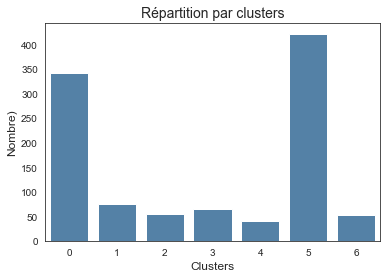

In [236]:
outils_nlp.affiche_repartition_par_clusters(kmeans_acp_tfidf_prod_lem_labels)

In [239]:
# Les catégories par clusters
df_acp_tfidf_prod_lem.groupby('Clusters')['CATEGORIE'].value_counts() \
    .to_frame()

CATEGORIE
Clusters CATEGORIE                            
0        Home Furnishing                   109
         Beauty and Personal Care           97
         Baby Care                          88
         Home Decor & Festive Needs         36
         Computers                          12
1        Kitchen & Dining                   74
         Baby Care                           1
2        Watches                            54
3        Kitchen & Dining                   50
         Home Decor & Festive Needs          6
         Baby Care                           4
         Beauty and Personal Care            3
         Computers                           1
4        Watches                            37
         Home Decor & Festive Needs          3
5        Computers                         137
         Home Decor & Festive Needs        105
         Baby Care                          57
         Beauty and Personal Care           50
         Home Furnishing                    41
         Kitchen & Dining                   26
         Watches                             6
6        Watches                            53

**Visualisation des clusters**

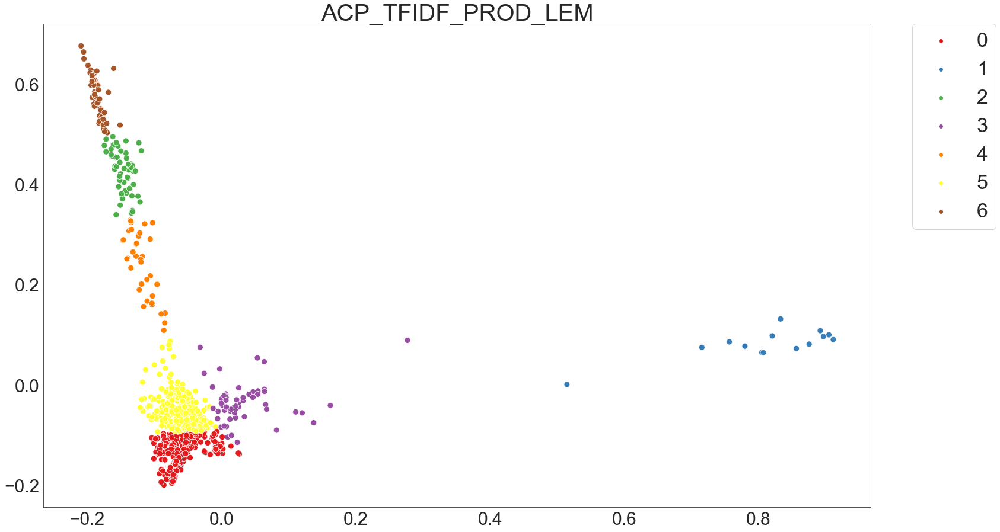

In [240]:
# Visualisation des clusters
outils_nlp.affiche_projection_par_clusters(X_proj_acp_tfidf_prod_lem,
                                           kmeans_acp_tfidf_prod_lem_labels,
                                           type_donnee)

In [241]:
# Sauvegarde des précisions de la catégorisation
df_precision = outils_nlp.sauvegarde_precision(df_precision, '0',
                                               type_donnee)
# Sauvegarde des dataframes de trace
outils_data.to_csv(df_precision, 'data_df_precision.csv')

**Bilan** :
***
- Répartition inégale (2 gros clusters), les vraies catégories sont mélangées dans les clusters, le score ARI est faible (mais plus grand qu'avec les données description et les clusters commencent à être mieux répartis).
- Cette combinaison ACP TfidfVectorizer + produit spécification lemmatisée ne parvient pas retrouver les 7 catégories comme le souhaite notre client.

**produit_specification** - stemmatisée
***

**Recherche des meilleurs hyperparamètres**

In [242]:
type_donnee = 'ACP_TFIDF_PROD_STEM'

In [243]:
# Tuning hyperparametres n_init, max_iter
# Paramètres à tester
n_init = [10, 20, 30, 50, 70, 80, 100]
max_iter = [100, 200, 300, 400, 500]
# Métriques avec les différentes combinaisons des paramètres
df_metrics_kmeans = \
    outils_nlp.calcul_metrics_kmeans(df_acp_tfidf_prod_stem[cols],
                                     df_metrics_kmeans,
                                     type_donnee,
                                     seed, n_init, max_iter)
# Tri par indice de dispersion : proche de 0
df_metrics_kmeans[df_metrics_kmeans['Type_données'] == type_donnee] \
    .sort_values(by=['coef_silh', 'davies_bouldin', 'Durée (s)'],
                 ascending=[False, True, True]).style.hide_index()

Type_données,n_init,max_iter,coef_silh,dispersion,davies_bouldin,Durée (s)
ACP_TFIDF_PROD_STEM,50,500,0.48452,2.04635,0.59556,0.15892
ACP_TFIDF_PROD_STEM,50,200,0.48452,2.04635,0.59556,0.16498
ACP_TFIDF_PROD_STEM,50,100,0.48452,2.04635,0.59556,0.16834
ACP_TFIDF_PROD_STEM,50,400,0.48452,2.04635,0.59556,0.17653
ACP_TFIDF_PROD_STEM,50,300,0.48452,2.04635,0.59556,0.17880
ACP_TFIDF_PROD_STEM,70,200,0.48452,2.04635,0.59556,0.23472
ACP_TFIDF_PROD_STEM,70,400,0.48452,2.04635,0.59556,0.24037
ACP_TFIDF_PROD_STEM,70,300,0.48452,2.04635,0.59556,0.24485
ACP_TFIDF_PROD_STEM,70,100,0.48452,2.04635,0.59556,0.25149
ACP_TFIDF_PROD_STEM,70,500,0.48452,2.04635,0.59556,0.25687


In [244]:
# Sauvegarde des dataframes de trace
outils_data.to_csv(df_metrics_kmeans, 'data_df_metrics_kmeans.csv')

**Clustering**

In [245]:
# Instanciation du modèle KMeans avec les meilleurs paramètres
kmeans_acp_tfidf_prod_stem = KMeans(n_clusters=7, init='k-means++',
                                    n_init=50, max_iter=500,
                                    random_state=seed) \
    .fit(df_acp_tfidf_prod_stem[cols])
# Ajout de l'assignation du cluster au dataframe
df_acp_tfidf_prod_stem['Clusters'] = kmeans_acp_tfidf_prod_stem.labels_
kmeans_acp_tfidf_prod_stem_labels = kmeans_acp_tfidf_prod_stem.labels_

In [246]:
# Scores ?
df_scores = outils_nlp.calcul_metriques_clusters(df_acp_tfidf_prod_stem,
                                                 df_scores,
                                                 type_donnee)
df_scores.style.hide_index()

Type_données,ARI,Homogénéité,Complétude,V-measure
ACP_CV_DESC_LEM,0.03894,0.11797,0.20952,0.15095
ACP_CV_DESC_STEM,0.04503,0.11941,0.19802,0.14898
ACP_CV_PROD_LEM,0.10551,0.26012,0.58404,0.35994
ACP_CV_PROD_STEM,0.10015,0.25417,0.57940,0.35334
ACP_TFIDF_DESC_LEM,0.14925,0.34720,0.53091,0.41984
ACP_TFIDF_DESC_STEM,0.14698,0.34728,0.52762,0.41886
ACP_TFIDF_PROD_LEM,0.20215,0.37890,0.48553,0.42564
ACP_TFIDF_PROD_STEM,0.21837,0.39724,0.50516,0.44475


In [247]:
# Sauvegarde des dataframes de trace
outils_data.to_csv(df_scores, 'data_df_scores.csv')

Clusters,Nombre,%
0,456,43.43000
1,75,7.14000
2,63,6.00000
3,58,5.52000
4,36,3.43000
5,69,6.57000
6,293,27.90000


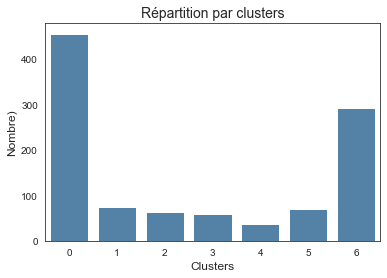

In [248]:
outils_nlp.affiche_repartition_par_clusters(kmeans_acp_tfidf_prod_stem_labels)

In [249]:
# Les catégories par clusters
df_acp_tfidf_prod_stem.groupby('Clusters')['CATEGORIE'].value_counts() \
    .to_frame()

CATEGORIE
Clusters CATEGORIE                            
0        Computers                         146
         Home Decor & Festive Needs        117
         Beauty and Personal Care           69
         Baby Care                          59
         Home Furnishing                    38
         Kitchen & Dining                   26
         Watches                             1
1        Kitchen & Dining                   74
         Baby Care                           1
2        Watches                            63
3        Watches                            58
4        Watches                            28
         Home Decor & Festive Needs          5
         Home Furnishing                     2
         Beauty and Personal Care            1
5        Kitchen & Dining                   50
         Beauty and Personal Care            8
         Home Decor & Festive Needs          6
         Baby Care                           4
         Computers                           1
6        Home Furnishing                   110
         Baby Care                          86
         Beauty and Personal Care           72
         Home Decor & Festive Needs         22
         Computers                           3

**Visualisation des clusters**

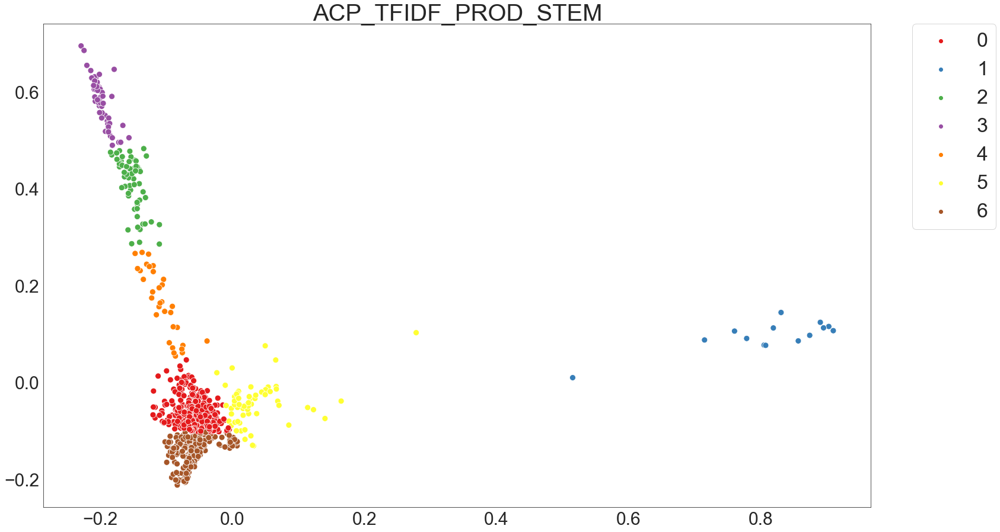

In [250]:
# Visualisation des clusters
outils_nlp.affiche_projection_par_clusters(X_proj_acp_tfidf_prod_stem,
                                           kmeans_acp_tfidf_prod_stem_labels,
                                           type_donnee)

In [251]:
# Sauvegarde des précisions de la catégorisation
df_precision = outils_nlp.sauvegarde_precision(df_precision, '0',
                                               type_donnee)
# Sauvegarde des dataframes de trace
outils_data.to_csv(df_precision, 'data_df_precision.csv')

**Bilan** :
***
- Répartition inégale (2 gros clusters), les vraies catégories sont mélangées dans les clusters, le score ARI est faible (mais plus grand qu'avec les données produit spécification lemmatisée).
- Cette combinaison ACP + produit spécification stemmatisée ne parvient pas retrouver les 7 catégories comme le souhaite notre client.

### <span style='background:PowderBlue'>6.3. ACP BOW HashingVectorizer</span>

**description** - lemmatisée
***

**Recherche des meilleurs hyperparamètres**

In [252]:
type_donnee = 'ACP_HASH_DESC_LEM'

In [253]:
# Tuning hyperparametres n_init, max_iter
# Paramètres à tester
n_init = [10, 20, 30, 50, 70, 80, 100]
max_iter = [100, 200, 300, 400, 500]
# Métriques avec les différentes combinaisons des paramètres
df_metrics_kmeans = \
    outils_nlp.calcul_metrics_kmeans(df_acp_hash_desc_lem[cols],
                                     df_metrics_kmeans,
                                     type_donnee,
                                     seed, n_init, max_iter)
# Tri par indice de dispersion : proche de 0
df_metrics_kmeans[df_metrics_kmeans['Type_données'] == type_donnee] \
    .sort_values(by=['coef_silh', 'davies_bouldin', 'Durée (s)'],
                 ascending=[False, True, True]).style.hide_index()

Type_données,n_init,max_iter,coef_silh,dispersion,davies_bouldin,Durée (s)
ACP_HASH_DESC_LEM,10,500,0.64892,782.12075,0.50374,0.03989
ACP_HASH_DESC_LEM,10,300,0.64892,782.12075,0.50374,0.03989
ACP_HASH_DESC_LEM,10,400,0.64892,782.12075,0.50374,0.03989
ACP_HASH_DESC_LEM,10,100,0.64892,782.12075,0.50374,0.04089
ACP_HASH_DESC_LEM,10,200,0.64892,782.12075,0.50374,0.04288
ACP_HASH_DESC_LEM,20,500,0.64892,782.12075,0.50374,0.06904
ACP_HASH_DESC_LEM,20,400,0.64892,782.12075,0.50374,0.06899
ACP_HASH_DESC_LEM,20,300,0.64892,782.12075,0.50374,0.06973
ACP_HASH_DESC_LEM,20,200,0.64892,782.12075,0.50374,0.07380
ACP_HASH_DESC_LEM,20,100,0.64892,782.12075,0.50374,0.07380


In [254]:
# Sauvegarde des dataframes de trace
outils_data.to_csv(df_metrics_kmeans, 'data_df_metrics_kmeans.csv')

**Clustering**

In [255]:
# Instanciation du modèle KMeans avec les meilleurs paramètres
kmeans_acp_hash_desc_lem = KMeans(n_clusters=7, init='k-means++',
                                  n_init=10, max_iter=500,
                                  random_state=seed) \
    .fit(df_acp_hash_desc_lem[cols])
# Ajout de l'assignation du cluster au dataframe
df_acp_hash_desc_lem['Clusters'] = kmeans_acp_hash_desc_lem.labels_
kmeans_acp_hash_desc_lem_labels = kmeans_acp_hash_desc_lem.labels_

In [257]:
# Scores ?
df_scores = outils_nlp.calcul_metriques_clusters(df_acp_hash_desc_lem,
                                                 df_scores,
                                                 type_donnee)
df_scores.style.hide_index()

Type_données,ARI,Homogénéité,Complétude,V-measure
ACP_CV_DESC_LEM,0.03894,0.11797,0.20952,0.15095
ACP_CV_DESC_STEM,0.04503,0.11941,0.19802,0.14898
ACP_CV_PROD_LEM,0.10551,0.26012,0.58404,0.35994
ACP_CV_PROD_STEM,0.10015,0.25417,0.57940,0.35334
ACP_TFIDF_DESC_LEM,0.14925,0.34720,0.53091,0.41984
ACP_TFIDF_DESC_STEM,0.14698,0.34728,0.52762,0.41886
ACP_TFIDF_PROD_LEM,0.20215,0.37890,0.48553,0.42564
ACP_TFIDF_PROD_STEM,0.21837,0.39724,0.50516,0.44475
ACP_HASH_DESC_LEM,0.03915,0.11095,0.19437,0.14126


In [266]:
# Sauvegarde des dataframes de trace
outils_data.to_csv(df_scores, 'data_df_scores.csv')

Clusters,Nombre,%
0,672,64.00000
1,29,2.76000
2,28,2.67000
3,223,21.24000
4,7,0.67000
5,30,2.86000
6,61,5.81000


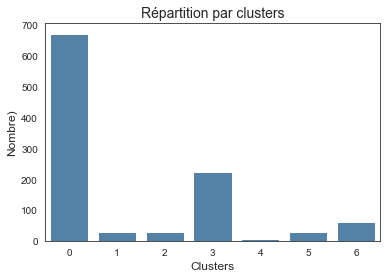

In [258]:
outils_nlp.affiche_repartition_par_clusters(kmeans_acp_hash_desc_lem_labels)

In [259]:
# Les catégories par clusters
df_acp_hash_desc_lem.groupby('Clusters')['CATEGORIE'].value_counts() \
    .to_frame()

CATEGORIE
Clusters CATEGORIE                            
0        Watches                           139
         Beauty and Personal Care          125
         Home Decor & Festive Needs         99
         Computers                          94
         Home Furnishing                    93
         Kitchen & Dining                   69
         Baby Care                          53
1        Kitchen & Dining                   29
2        Computers                          20
         Baby Care                           3
         Home Decor & Festive Needs          3
         Home Furnishing                     2
3        Baby Care                          81
         Home Furnishing                    46
         Home Decor & Festive Needs         30
         Computers                          20
         Beauty and Personal Care           18
         Kitchen & Dining                   18
         Watches                            10
4        Computers                           6
         Beauty and Personal Care            1
5        Kitchen & Dining                   26
         Home Decor & Festive Needs          3
         Baby Care                           1
6        Home Decor & Festive Needs         15
         Baby Care                          12
         Computers                          10
         Home Furnishing                     9
         Kitchen & Dining                    8
         Beauty and Personal Care            6
         Watches                             1

**Visualisation des clusters**

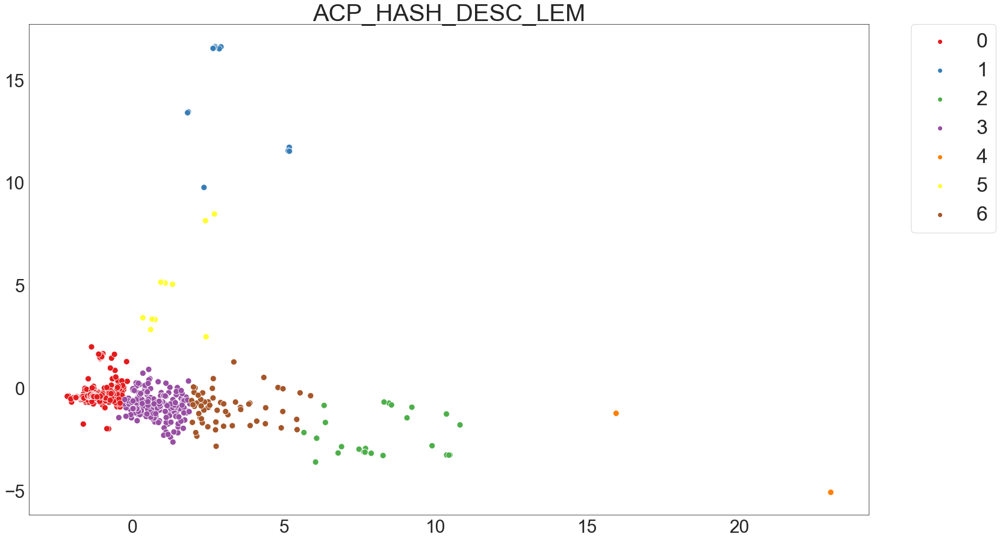

In [260]:
# Visualisation des clusters
outils_nlp.affiche_projection_par_clusters(X_proj_acp_hash_desc_lem,
                                           kmeans_acp_hash_desc_lem_labels,
                                           type_donnee)

In [261]:
# Sauvegarde des précisions de la catégorisation
df_precision = outils_nlp.sauvegarde_precision(df_precision, '0',
                                               type_donnee)
# Sauvegarde des dataframes de trace
outils_data.to_csv(df_precision, 'data_df_precision.csv')

**Bilan** :
***
- Répartition inégale (2 gros clusters), les vraies catégories sont mélangées dans les clusters, certains clusters sont vides, le score ARI est faible (mais meilleur résultat qu'avec ACP CountVectorizer).
- Cette combinaison ACP HashingVectorizer + description lemmatisée ne parvient pas retrouver les 7 catégories comme le souhaite notre client.

**description** - stemmatisée
***

**Recherche des meilleurs hyperparamètres**

In [262]:
type_donnee = 'ACP_HASH_DESC_STEM'

In [263]:
# Tuning hyperparametres n_init, max_iter
# Paramètres à tester
n_init = [10, 20, 30, 50, 70, 80, 100]
max_iter = [100, 200, 300, 400, 500]
# Métriques avec les différentes combinaisons des paramètres
df_metrics_kmeans = \
    outils_nlp.calcul_metrics_kmeans(df_acp_hash_desc_stem[cols],
                                     df_metrics_kmeans,
                                     type_donnee,
                                     seed, n_init, max_iter)
# Tri par indice de dispersion : proche de 0
df_metrics_kmeans[df_metrics_kmeans['Type_données'] == type_donnee] \
    .sort_values(by=['coef_silh', 'davies_bouldin', 'Durée (s)'],
                 ascending=[False, True, True]).style.hide_index()

Type_données,n_init,max_iter,coef_silh,dispersion,davies_bouldin,Durée (s)
ACP_HASH_DESC_STEM,10,400,0.62093,864.97532,0.51802,0.02499
ACP_HASH_DESC_STEM,10,500,0.62093,864.97532,0.51802,0.03124
ACP_HASH_DESC_STEM,10,300,0.62093,864.97532,0.51802,0.03989
ACP_HASH_DESC_STEM,10,100,0.62093,864.97532,0.51802,0.03990
ACP_HASH_DESC_STEM,10,200,0.62093,864.97532,0.51802,0.04089
ACP_HASH_DESC_STEM,20,200,0.62093,864.97532,0.51802,0.06749
ACP_HASH_DESC_STEM,20,100,0.62093,864.97532,0.51802,0.06914
ACP_HASH_DESC_STEM,20,500,0.62093,864.97532,0.51802,0.07181
ACP_HASH_DESC_STEM,20,400,0.62093,864.97532,0.51802,0.07280
ACP_HASH_DESC_STEM,20,300,0.62093,864.97532,0.51802,0.08649


In [264]:
# Sauvegarde des dataframes de trace
outils_data.to_csv(df_metrics_kmeans, 'data_df_metrics_kmeans.csv')

**Clustering**

In [265]:
# Instanciation du modèle KMeans avec les meilleurs paramètres
kmeans_acp_hash_desc_stem = KMeans(n_clusters=7, init='k-means++',
                                   n_init=10, max_iter=400,
                                   random_state=seed) \
    .fit(df_acp_hash_desc_stem[cols])
# Ajout de l'assignation du cluster au dataframe
df_acp_hash_desc_stem['Clusters'] = kmeans_acp_hash_desc_stem.labels_
kmeans_acp_hash_desc_stem_labels = kmeans_acp_hash_desc_stem.labels_

In [267]:
# Scores ?
df_scores = outils_nlp.calcul_metriques_clusters(df_acp_hash_desc_stem,
                                                 df_scores,
                                                 type_donnee)
df_scores.style.hide_index()

Type_données,ARI,Homogénéité,Complétude,V-measure
ACP_CV_DESC_LEM,0.03894,0.11797,0.20952,0.15095
ACP_CV_DESC_STEM,0.04503,0.11941,0.19802,0.14898
ACP_CV_PROD_LEM,0.10551,0.26012,0.58404,0.35994
ACP_CV_PROD_STEM,0.10015,0.25417,0.57940,0.35334
ACP_TFIDF_DESC_LEM,0.14925,0.34720,0.53091,0.41984
ACP_TFIDF_DESC_STEM,0.14698,0.34728,0.52762,0.41886
ACP_TFIDF_PROD_LEM,0.20215,0.37890,0.48553,0.42564
ACP_TFIDF_PROD_STEM,0.21837,0.39724,0.50516,0.44475
ACP_HASH_DESC_LEM,0.03915,0.11095,0.19437,0.14126
ACP_HASH_DESC_STEM,0.04546,0.11990,0.20162,0.15037


In [268]:
# Sauvegarde des dataframes de trace
outils_data.to_csv(df_scores, 'data_df_scores.csv')

Clusters,Nombre,%
0,221,21.05000
1,28,2.67000
2,651,62.00000
3,30,2.86000
4,7,0.67000
5,84,8.00000
6,29,2.76000


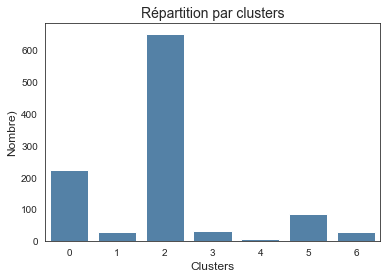

In [269]:
outils_nlp.affiche_repartition_par_clusters(kmeans_acp_hash_desc_stem_labels)

In [204]:
# Les catégories par clusters
df_acp_hash_desc_stem.groupby('Clusters')['CATEGORIE'].value_counts().to_frame()

CATEGORIE
Clusters CATEGORIE                            
0        Baby Care                          82
         Home Furnishing                    38
         Home Decor & Festive Needs         37
         Kitchen & Dining                   27
         Beauty and Personal Care           17
         Computers                          13
         Watches                             7
1        Kitchen & Dining                   28
2        Watches                           142
         Beauty and Personal Care          123
         Computers                          95
         Home Decor & Festive Needs         92
         Home Furnishing                    88
         Kitchen & Dining                   60
         Baby Care                          51
3        Computers                          21
         Baby Care                           3
         Home Decor & Festive Needs          3
         Home Furnishing                     3
4        Computers                           6
         Beauty and Personal Care            1
5        Home Furnishing                    21
         Home Decor & Festive Needs         17
         Computers                          15
         Baby Care                          13
         Beauty and Personal Care            9
         Kitchen & Dining                    8
         Watches                             1
6        Kitchen & Dining                   27
         Baby Care                           1
         Home Decor & Festive Needs          1

2:80: E501 line too long (80 > 79 characters)


**Visualisation des clusters**

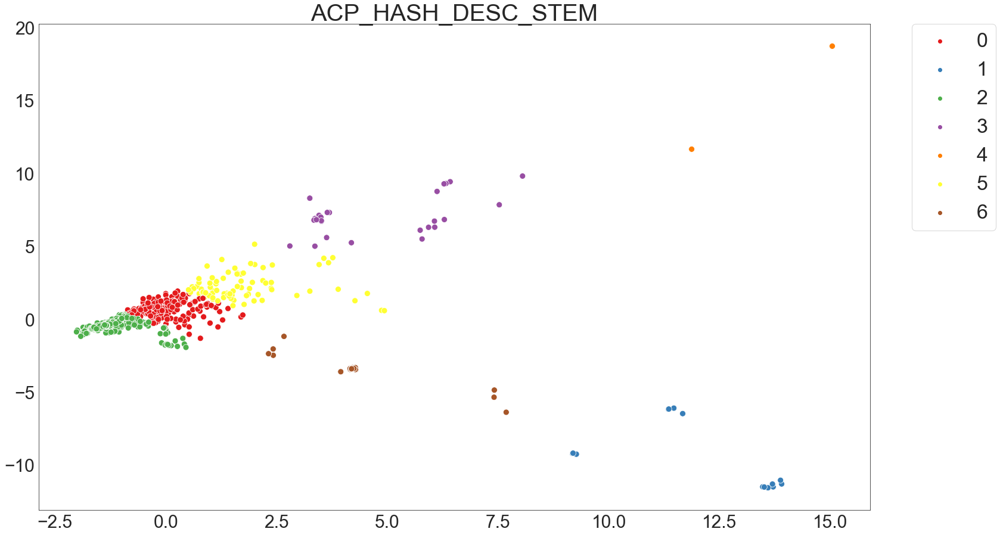

In [270]:
# Visualisation des clusters
outils_nlp.affiche_projection_par_clusters(X_proj_acp_hash_desc_stem,
                                           kmeans_acp_hash_desc_stem_labels,
                                           type_donnee)

In [271]:
# Sauvegarde des précisions de la catégorisation
df_precision = outils_nlp.sauvegarde_precision(df_precision, '0',
                                               type_donnee)
# Sauvegarde des dataframes de trace
outils_data.to_csv(df_precision, 'data_df_precision.csv')

**Bilan** :
***
- Répartition inégale (2 gros clusters), les vraies catégories sont mélangées dans les clusters, certains clusters sont vides, le score ARI est  faible (et plus petit qu'avec les données lemmatisées).
- Cette combinaison ACP HashingVectorizer + description stemmatisée ne parvient pas retrouver les 7 catégories comme le souhaite notre client.

**produit_specification** - lemmatisée
***

**Recherche des meilleurs hyperparamètres**

In [272]:
type_donnee = 'ACP_HASH_PROD_LEM'

In [273]:
# Tuning hyperparametres n_init, max_iter
# Paramètres à tester
n_init = [10, 20, 30, 50, 70, 80, 100]
max_iter = [100, 200, 300, 400, 500]
# Métriques avec les différentes combinaisons des paramètres
df_metrics_kmeans = \
    outils_nlp.calcul_metrics_kmeans(df_acp_hash_prod_lem[cols],
                                     df_metrics_kmeans,
                                     type_donnee,
                                     seed, n_init, max_iter)
# Tri par indice de dispersion : proche de 0
df_metrics_kmeans[df_metrics_kmeans['Type_données'] == type_donnee] \
    .sort_values(by=['coef_silh', 'davies_bouldin', 'Durée (s)'],
                 ascending=[False, True, True]).style.hide_index()

Type_données,n_init,max_iter,coef_silh,dispersion,davies_bouldin,Durée (s)
ACP_HASH_PROD_LEM,10,400,0.69325,395.40667,0.47531,0.04189
ACP_HASH_PROD_LEM,10,200,0.69325,395.40667,0.47531,0.04488
ACP_HASH_PROD_LEM,10,100,0.69325,395.40667,0.47531,0.04488
ACP_HASH_PROD_LEM,10,500,0.69325,395.40667,0.47531,0.04488
ACP_HASH_PROD_LEM,10,300,0.69325,395.40667,0.47531,0.04588
ACP_HASH_PROD_LEM,20,100,0.69124,395.38949,0.47373,0.09175
ACP_HASH_PROD_LEM,20,400,0.69124,395.38949,0.47373,0.09574
ACP_HASH_PROD_LEM,20,300,0.69124,395.38949,0.47373,0.09962
ACP_HASH_PROD_LEM,20,200,0.69124,395.38949,0.47373,0.09973
ACP_HASH_PROD_LEM,20,500,0.69124,395.38949,0.47373,0.10147


In [274]:
# Sauvegarde des dataframes de trace
outils_data.to_csv(df_metrics_kmeans, 'data_df_metrics_kmeans.csv')

**Clustering**

In [275]:
# Instanciation du modèle KMeans avec les meilleurs paramètres
kmeans_acp_hash_prod_lem = KMeans(n_clusters=7, init='k-means++',
                                  n_init=10, max_iter=400,
                                  random_state=seed) \
    .fit(df_acp_hash_prod_lem[cols])
# Ajout de l'assignation du cluster au dataframe
df_acp_hash_prod_lem['Clusters'] = kmeans_acp_hash_prod_lem.labels_
kmeans_acp_hash_prod_lem_labels = kmeans_acp_hash_prod_lem.labels_

In [276]:
# Scores ?
df_scores = outils_nlp.calcul_metriques_clusters(df_acp_hash_prod_lem,
                                                 df_scores,
                                                 type_donnee)
df_scores.style.hide_index()

Type_données,ARI,Homogénéité,Complétude,V-measure
ACP_CV_DESC_LEM,0.03894,0.11797,0.20952,0.15095
ACP_CV_DESC_STEM,0.04503,0.11941,0.19802,0.14898
ACP_CV_PROD_LEM,0.10551,0.26012,0.58404,0.35994
ACP_CV_PROD_STEM,0.10015,0.25417,0.57940,0.35334
ACP_TFIDF_DESC_LEM,0.14925,0.34720,0.53091,0.41984
ACP_TFIDF_DESC_STEM,0.14698,0.34728,0.52762,0.41886
ACP_TFIDF_PROD_LEM,0.20215,0.37890,0.48553,0.42564
ACP_TFIDF_PROD_STEM,0.21837,0.39724,0.50516,0.44475
ACP_HASH_DESC_LEM,0.03915,0.11095,0.19437,0.14126
ACP_HASH_DESC_STEM,0.04546,0.11990,0.20162,0.15037


In [277]:
# Sauvegarde des dataframes de trace
outils_data.to_csv(df_scores, 'data_df_scores.csv')

Clusters,Nombre,%
0,799,76.10000
1,48,4.57000
2,8,0.76000
3,108,10.29000
4,75,7.14000
5,10,0.95000
6,2,0.19000


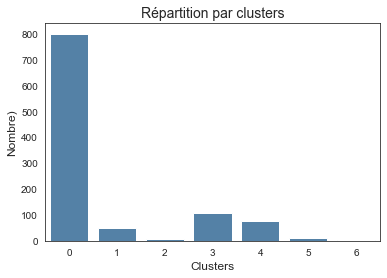

In [278]:
outils_nlp.affiche_repartition_par_clusters(kmeans_acp_hash_prod_lem_labels)

In [279]:
# Les catégories par clusters
df_acp_hash_prod_lem.groupby('Clusters')['CATEGORIE'].value_counts().to_frame()

CATEGORIE
Clusters CATEGORIE                            
0        Baby Care                         150
         Home Furnishing                   150
         Kitchen & Dining                  147
         Beauty and Personal Care          146
         Home Decor & Festive Needs        143
         Computers                          36
         Watches                            27
1        Watches                            48
2        Computers                           8
3        Computers                          96
         Home Decor & Festive Needs          6
         Beauty and Personal Care            3
         Kitchen & Dining                    3
4        Watches                            73
         Beauty and Personal Care            1
         Home Decor & Festive Needs          1
5        Computers                          10
6        Watches                             2

**Visualisation des clusters**

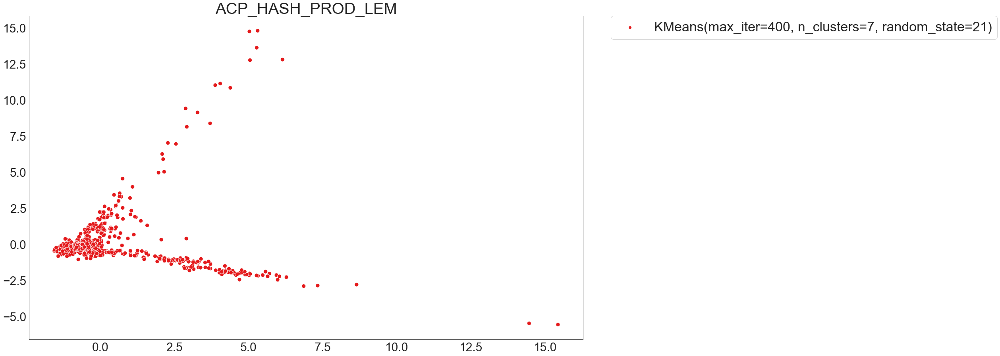

In [280]:
# Visualisation des clusters
outils_nlp.affiche_projection_par_clusters(X_proj_acp_hash_prod_lem,
                                           kmeans_acp_hash_prod_lem,
                                           type_donnee)

In [281]:
# Sauvegarde des précisions de la catégorisation
df_precision = outils_nlp.sauvegarde_precision(df_precision, '0',
                                               type_donnee)
# Sauvegarde des dataframes de trace
outils_data.to_csv(df_precision, 'data_df_precision.csv')

**Bilan** :
***
- Répartition inégale (2 gros clusters), les vraies catégories sont mélangées dans les clusters, le score ARI est faible (mais plus grand qu'avec les données description et les clusters commencent à être mieux répartis).
- Cette combinaison ACP HashingVectorizer + produit spécification lemmatisée ne parvient pas retrouver les 7 catégories comme le souhaite notre client.

**produit_specification** - stemmatisée
***

**Recherche des meilleurs hyperparamètres**

In [282]:
type_donnee = 'ACP_HASH_PROD_STEM'

In [283]:
# Tuning hyperparametres n_init, max_iter
# Paramètres à tester
n_init = [10, 20, 30, 50, 70, 80, 100]
max_iter = [100, 200, 300, 400, 500]
# Métriques avec les différentes combinaisons des paramètres
df_metrics_kmeans = \
    outils_nlp.calcul_metrics_kmeans(df_acp_hash_prod_stem[cols],
                                     df_metrics_kmeans,
                                     type_donnee,
                                     seed, n_init, max_iter)
# Tri par indice de dispersion : proche de 0
df_metrics_kmeans[df_metrics_kmeans['Type_données'] == type_donnee] \
    .sort_values(by=['coef_silh', 'davies_bouldin', 'Durée (s)'],
                 ascending=[False, True, True]).style.hide_index()

Type_données,n_init,max_iter,coef_silh,dispersion,davies_bouldin,Durée (s)
ACP_HASH_PROD_STEM,30,500,0.70502,473.57978,0.47385,0.12267
ACP_HASH_PROD_STEM,30,200,0.70502,473.57978,0.47385,0.12267
ACP_HASH_PROD_STEM,30,300,0.70502,473.57978,0.47385,0.12367
ACP_HASH_PROD_STEM,30,100,0.70502,473.57978,0.47385,0.12566
ACP_HASH_PROD_STEM,30,400,0.70502,473.57978,0.47385,0.14162
ACP_HASH_PROD_STEM,50,500,0.70502,473.57978,0.47385,0.20046
ACP_HASH_PROD_STEM,50,200,0.70502,473.57978,0.47385,0.20146
ACP_HASH_PROD_STEM,50,100,0.70502,473.57978,0.47385,0.20146
ACP_HASH_PROD_STEM,50,400,0.70502,473.57978,0.47385,0.20197
ACP_HASH_PROD_STEM,50,300,0.70502,473.57978,0.47385,0.20345


In [284]:
# Sauvegarde des dataframes de trace
outils_data.to_csv(df_metrics_kmeans, 'data_df_metrics_kmeans.csv')

**Clustering**

In [285]:
# Instanciation du modèle KMeans avec les meilleurs paramètres
kmeans_acp_hash_prod_stem = KMeans(n_clusters=7, init='k-means++',
                                   n_init=30, max_iter=500,
                                   random_state=seed) \
    .fit(df_acp_hash_prod_stem[cols])
# Ajout de l'assignation du cluster au dataframe
df_acp_hash_prod_stem['Clusters'] = kmeans_acp_hash_prod_stem.labels_
kmeans_acp_hash_prod_stem_labels = kmeans_acp_hash_prod_stem.labels_

In [286]:
# Scores ?
df_scores = outils_nlp.calcul_metriques_clusters(df_acp_hash_prod_stem,
                                                 df_scores,
                                                 type_donnee)
df_scores.style.hide_index()

Type_données,ARI,Homogénéité,Complétude,V-measure
ACP_CV_DESC_LEM,0.03894,0.11797,0.20952,0.15095
ACP_CV_DESC_STEM,0.04503,0.11941,0.19802,0.14898
ACP_CV_PROD_LEM,0.10551,0.26012,0.58404,0.35994
ACP_CV_PROD_STEM,0.10015,0.25417,0.57940,0.35334
ACP_TFIDF_DESC_LEM,0.14925,0.34720,0.53091,0.41984
ACP_TFIDF_DESC_STEM,0.14698,0.34728,0.52762,0.41886
ACP_TFIDF_PROD_LEM,0.20215,0.37890,0.48553,0.42564
ACP_TFIDF_PROD_STEM,0.21837,0.39724,0.50516,0.44475
ACP_HASH_DESC_LEM,0.03915,0.11095,0.19437,0.14126
ACP_HASH_DESC_STEM,0.04546,0.11990,0.20162,0.15037


In [287]:
# Sauvegarde des dataframes de trace
outils_data.to_csv(df_scores, 'data_df_scores.csv')

Clusters,Nombre,%
0,74,7.05000
1,804,76.57000
2,10,0.95000
3,107,10.19000
4,2,0.19000
5,45,4.29000
6,8,0.76000


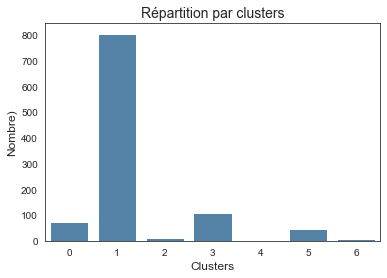

In [288]:
outils_nlp.affiche_repartition_par_clusters(kmeans_acp_hash_prod_stem_labels)

In [289]:
# Les catégories par clusters
df_acp_hash_prod_stem.groupby('Clusters')['CATEGORIE'].value_counts() \
    .to_frame()

CATEGORIE
Clusters CATEGORIE                            
0        Watches                            73
         Beauty and Personal Care            1
1        Baby Care                         150
         Home Furnishing                   150
         Beauty and Personal Care          146
         Kitchen & Dining                  146
         Home Decor & Festive Needs        144
         Computers                          38
         Watches                            30
2        Computers                          10
3        Computers                          94
         Home Decor & Festive Needs          6
         Kitchen & Dining                    4
         Beauty and Personal Care            3
4        Watches                             2
5        Watches                            45
6        Computers                           8

**Visualisation des clusters**

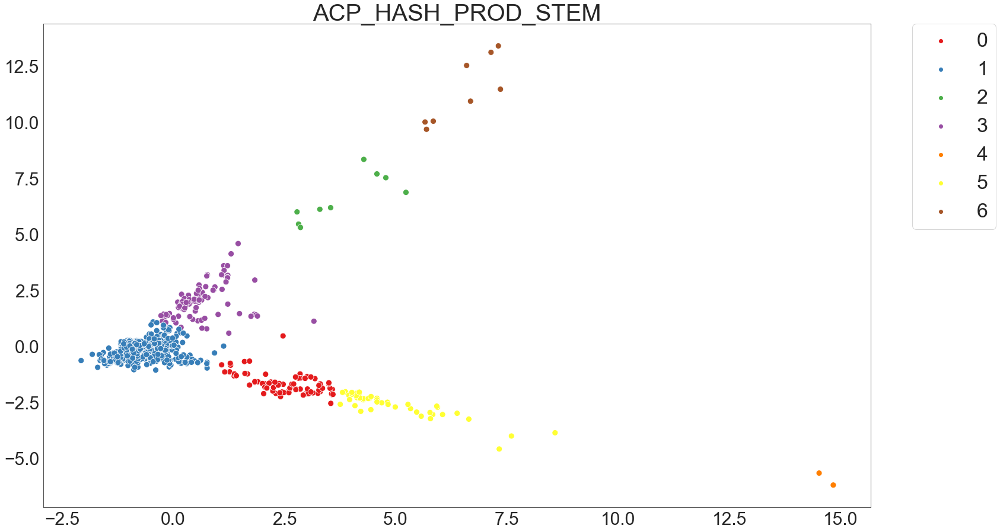

In [290]:
# Visualisation des clusters
outils_nlp.affiche_projection_par_clusters(X_proj_acp_hash_prod_stem,
                                           kmeans_acp_hash_prod_stem_labels,
                                           type_donnee)

In [291]:
# Sauvegarde des précisions de la catégorisation
df_precision = outils_nlp.sauvegarde_precision(df_precision, '0',
                                               type_donnee)
# Sauvegarde des dataframes de trace
outils_data.to_csv(df_precision, 'data_df_precision.csv')

**Bilan** :
***
- Répartition inégale (2 gros clusters), les vraies catégories sont mélangées dans les clusters, le score ARI est faible (mais plus grand qu'avec les données produit spécification lemmatisée).
- Cette combinaison ACP HashingVactorizer + produit spécification stemmatisée ne parvient pas retrouver les 7 catégories comme le souhaite notre client.

### <span style='background:PowderBlue'>6.4. TSNE BOW CountVectorizer</span>

**description** - lemmatisée
***

**Recherche des meilleurs hyperparamètres**

In [292]:
type_donnee = 'TSNE_CV_DESC_LEM'

In [293]:
# Tuning hyperparametres n_init, max_iter
# Paramètres à tester
n_init = [10, 20, 30, 50, 70, 80, 100]
max_iter = [100, 200, 300, 400, 500]
# Métriques avec les différentes combinaisons des paramètres
df_metrics_kmeans = \
    outils_nlp.calcul_metrics_kmeans(df_tsne_cv_desc_lem[cols],
                                     df_metrics_kmeans,
                                     type_donnee,
                                     seed, n_init, max_iter)
# Tri par indice de dispersion : proche de 0
df_metrics_kmeans[df_metrics_kmeans['Type_données'] == type_donnee] \
    .sort_values(by=['coef_silh', 'davies_bouldin', 'Durée (s)'],
                 ascending=[False, True, True]).style.hide_index()

Type_données,n_init,max_iter,coef_silh,dispersion,davies_bouldin,Durée (s)
TSNE_CV_DESC_LEM,20,500,0.41330,122182.81250,0.77425,0.12091
TSNE_CV_DESC_LEM,20,200,0.41330,122182.79688,0.77425,0.12510
TSNE_CV_DESC_LEM,20,100,0.41330,122182.78906,0.77425,0.13147
TSNE_CV_DESC_LEM,20,400,0.41330,122182.81250,0.77425,0.13863
TSNE_CV_DESC_LEM,20,300,0.41330,122182.79688,0.77425,0.14062
TSNE_CV_DESC_LEM,30,500,0.41330,122182.79688,0.77425,0.16272
TSNE_CV_DESC_LEM,30,400,0.41330,122182.81250,0.77425,0.16676
TSNE_CV_DESC_LEM,30,300,0.41330,122182.81250,0.77425,0.16755
TSNE_CV_DESC_LEM,30,100,0.41330,122182.78906,0.77425,0.17645
TSNE_CV_DESC_LEM,30,200,0.41330,122182.79688,0.77425,0.17762


In [294]:
# Sauvegarde des dataframes de trace
outils_data.to_csv(df_metrics_kmeans, 'data_df_metrics_kmeans.csv')

**Clustering**

In [295]:
# Instanciation du modèle KMeans avec les meilleurs paramètres
kmeans_tsne_cv_desc_lem = KMeans(n_clusters=7, init='k-means++',
                                 n_init=20, max_iter=500,
                                 random_state=seed) \
    .fit(df_tsne_cv_desc_lem[cols])
# Ajout de l'assignation du cluster au dataframe
df_tsne_cv_desc_lem['Clusters'] = kmeans_tsne_cv_desc_lem.labels_
kmeans_tsne_cv_desc_lem_labels = kmeans_tsne_cv_desc_lem.labels_

In [296]:
# Scores ?
df_scores = outils_nlp.calcul_metriques_clusters(df_tsne_cv_desc_lem,
                                                 df_scores,
                                                 type_donnee)
df_scores.style.hide_index()

Type_données,ARI,Homogénéité,Complétude,V-measure
ACP_CV_DESC_LEM,0.03894,0.11797,0.20952,0.15095
ACP_CV_DESC_STEM,0.04503,0.11941,0.19802,0.14898
ACP_CV_PROD_LEM,0.10551,0.26012,0.58404,0.35994
ACP_CV_PROD_STEM,0.10015,0.25417,0.57940,0.35334
ACP_TFIDF_DESC_LEM,0.14925,0.34720,0.53091,0.41984
ACP_TFIDF_DESC_STEM,0.14698,0.34728,0.52762,0.41886
ACP_TFIDF_PROD_LEM,0.20215,0.37890,0.48553,0.42564
ACP_TFIDF_PROD_STEM,0.21837,0.39724,0.50516,0.44475
ACP_HASH_DESC_LEM,0.03915,0.11095,0.19437,0.14126
ACP_HASH_DESC_STEM,0.04546,0.11990,0.20162,0.15037


Clusters,Nombre,%
0,162,15.43000
1,157,14.95000
2,162,15.43000
3,9,0.86000
4,293,27.90000
5,181,17.24000
6,86,8.19000


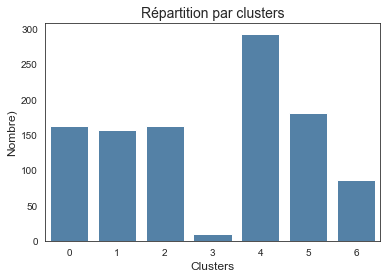

In [297]:
outils_nlp.affiche_repartition_par_clusters(kmeans_tsne_cv_desc_lem_labels)

In [298]:
# Les catégories par clusters
df_tsne_cv_desc_lem.groupby('Clusters')['CATEGORIE'].value_counts().to_frame()

CATEGORIE
Clusters CATEGORIE                            
0        Watches                           149
         Beauty and Personal Care            8
         Kitchen & Dining                    5
1        Computers                          90
         Beauty and Personal Care           28
         Kitchen & Dining                   22
         Home Decor & Festive Needs         16
         Baby Care                           1
2        Baby Care                          88
         Home Furnishing                    45
         Computers                          11
         Kitchen & Dining                    7
         Beauty and Personal Care            6
         Home Decor & Festive Needs          5
3        Home Decor & Festive Needs          4
         Beauty and Personal Care            2
         Computers                           1
         Kitchen & Dining                    1
         Watches                             1
4        Beauty and Personal Care           86
         Home Furnishing                    86
         Computers                          45
         Baby Care                          39
         Home Decor & Festive Needs         20
         Kitchen & Dining                   17
5        Home Decor & Festive Needs        104
         Beauty and Personal Care           20
         Kitchen & Dining                   20
         Home Furnishing                    19
         Baby Care                          18
6        Kitchen & Dining                   78
         Baby Care                           4
         Computers                           3
         Home Decor & Festive Needs          1

**Visualisation des clusters**

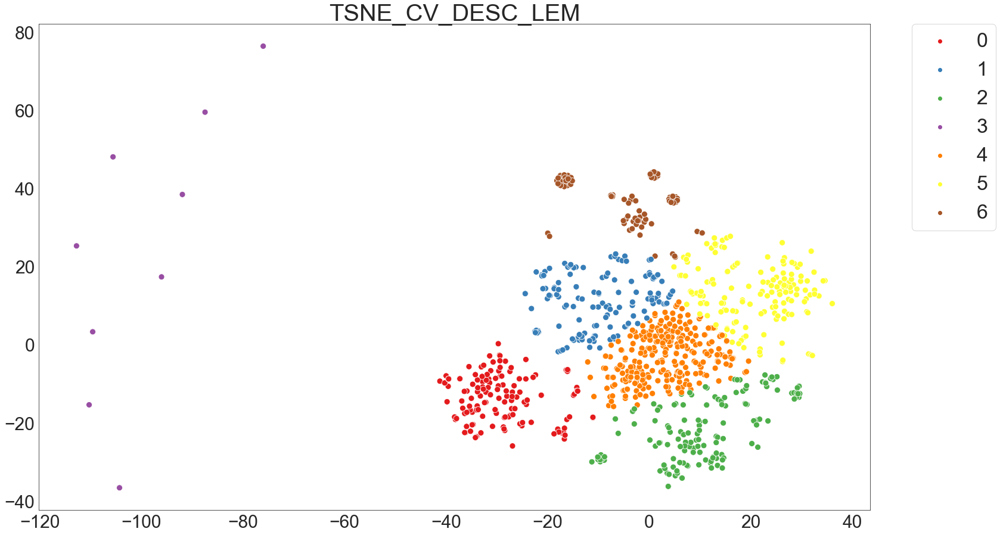

In [299]:
# Visualisation des clusters
outils_nlp.affiche_projection_par_clusters(X_proj_tsne_cv_desc_lem,
                                           kmeans_tsne_cv_desc_lem_labels,
                                           type_donnee)

In [300]:
# Sauvegarde des précisions de la catégorisation
df_precision = outils_nlp.sauvegarde_precision(df_precision, '0',
                                               type_donnee)
# Sauvegarde des dataframes de trace
outils_data.to_csv(df_precision, 'data_df_precision.csv')

**Bilan** :
***
- On observe un bien meilleur score qu'avec la réduction dimensionnelle ACP.
- La répartition est inégale, les vraies catégories sont mélangées dans les clusters, certains clusters sont vides , le score ARI est moins faible qu'avec ACP.
- Cette combinaison T-SNE CountVectorizer + description lemmatisée ne parvient pas retrouver les 7 catégories comme le souhaite notre client.

**description** - stemmatisée
***

**Recherche des meilleurs hyperparamètres**

In [696]:
type_donnee = 'TSNE_CV_DESC_STEM'

In [302]:
# Tuning hyperparametres n_init, max_iter
# Paramètres à tester
n_init = [10, 20, 30, 50, 70, 80, 100]
max_iter = [100, 200, 300, 400, 500]
# Métriques avec les différentes combinaisons des paramètres
df_metrics_kmeans = \
    outils_nlp.calcul_metrics_kmeans(df_tsne_cv_desc_stem[cols],
                                     df_metrics_kmeans,
                                     type_donnee,
                                     seed, n_init, max_iter)
# Tri par indice de dispersion : proche de 0
df_metrics_kmeans[df_metrics_kmeans['Type_données'] == type_donnee] \
    .sort_values(by=['coef_silh', 'davies_bouldin', 'Durée (s)'],
                 ascending=[False, True, True]).style.hide_index()

Type_données,n_init,max_iter,coef_silh,dispersion,davies_bouldin,Durée (s)
TSNE_CV_DESC_STEM,10,200,0.40534,130759.00781,0.74947,0.06084
TSNE_CV_DESC_STEM,10,100,0.40534,130759.00781,0.74947,0.06183
TSNE_CV_DESC_STEM,10,400,0.40534,130759.00000,0.74947,0.06981
TSNE_CV_DESC_STEM,10,300,0.40534,130759.00781,0.74947,0.07280
TSNE_CV_DESC_STEM,10,500,0.40534,130759.00000,0.74947,0.07580
TSNE_CV_DESC_STEM,20,400,0.40534,130759.00000,0.74947,0.11374
TSNE_CV_DESC_STEM,20,500,0.40534,130759.00000,0.74947,0.11563
TSNE_CV_DESC_STEM,20,300,0.40534,130759.00781,0.74947,0.12401
TSNE_CV_DESC_STEM,20,100,0.40534,130759.00000,0.74947,0.14162
TSNE_CV_DESC_STEM,20,200,0.40534,130759.00000,0.74947,0.14461


In [303]:
# Sauvegarde des dataframes de trace
outils_data.to_csv(df_metrics_kmeans, 'data_df_metrics_kmeans.csv')

**Clustering**

In [304]:
# Instanciation du modèle KMeans avec les meilleurs paramètres
kmeans_tsne_cv_desc_stem = KMeans(n_clusters=7, init='k-means++',
                                  n_init=10, max_iter=200,
                                  random_state=seed) \
    .fit(df_tsne_cv_desc_stem[cols])
# Ajout de l'assignation du cluster au dataframe
df_tsne_cv_desc_stem['Clusters'] = kmeans_tsne_cv_desc_stem.labels_
kmeans_tsne_cv_desc_stem_labels = kmeans_tsne_cv_desc_stem.labels_

In [305]:
# Scores ?
df_scores = outils_nlp.calcul_metriques_clusters(df_tsne_cv_desc_stem,
                                                 df_scores,
                                                 type_donnee)
df_scores.style.hide_index()

Type_données,ARI,Homogénéité,Complétude,V-measure
ACP_CV_DESC_LEM,0.03894,0.11797,0.20952,0.15095
ACP_CV_DESC_STEM,0.04503,0.11941,0.19802,0.14898
ACP_CV_PROD_LEM,0.10551,0.26012,0.58404,0.35994
ACP_CV_PROD_STEM,0.10015,0.25417,0.57940,0.35334
ACP_TFIDF_DESC_LEM,0.14925,0.34720,0.53091,0.41984
ACP_TFIDF_DESC_STEM,0.14698,0.34728,0.52762,0.41886
ACP_TFIDF_PROD_LEM,0.20215,0.37890,0.48553,0.42564
ACP_TFIDF_PROD_STEM,0.21837,0.39724,0.50516,0.44475
ACP_HASH_DESC_LEM,0.03915,0.11095,0.19437,0.14126
ACP_HASH_DESC_STEM,0.04546,0.11990,0.20162,0.15037


In [307]:
# Sauvegarde des dataframes de trace
outils_data.to_csv(df_scores, 'data_df_scores.csv')

Clusters,Nombre,%
0,156,14.86000
1,165,15.71000
2,91,8.67000
3,285,27.14000
4,143,13.62000
5,203,19.33000
6,7,0.67000


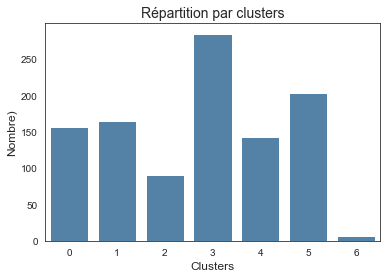

In [308]:
outils_nlp.affiche_repartition_par_clusters(kmeans_tsne_cv_desc_stem_labels)

In [309]:
# Les catégories par clusters
df_tsne_cv_desc_stem.groupby('Clusters')['CATEGORIE'].value_counts().to_frame()

CATEGORIE
Clusters CATEGORIE                            
0        Watches                           149
         Beauty and Personal Care            6
         Kitchen & Dining                    1
1        Home Furnishing                   109
         Baby Care                          20
         Home Decor & Festive Needs         13
         Beauty and Personal Care           12
         Kitchen & Dining                   11
2        Kitchen & Dining                   81
         Beauty and Personal Care            7
         Baby Care                           2
         Home Decor & Festive Needs          1
3        Computers                         137
         Beauty and Personal Care           42
         Home Decor & Festive Needs         29
         Kitchen & Dining                   28
         Baby Care                          25
         Home Furnishing                    24
4        Home Decor & Festive Needs        105
         Kitchen & Dining                   19
         Beauty and Personal Care           14
         Baby Care                           5
5        Baby Care                          97
         Beauty and Personal Care           69
         Home Furnishing                    17
         Computers                          11
         Kitchen & Dining                    8
         Home Decor & Festive Needs          1
6        Computers                           2
         Kitchen & Dining                    2
         Baby Care                           1
         Home Decor & Festive Needs          1
         Watches                             1

**Visualisation des clusters**

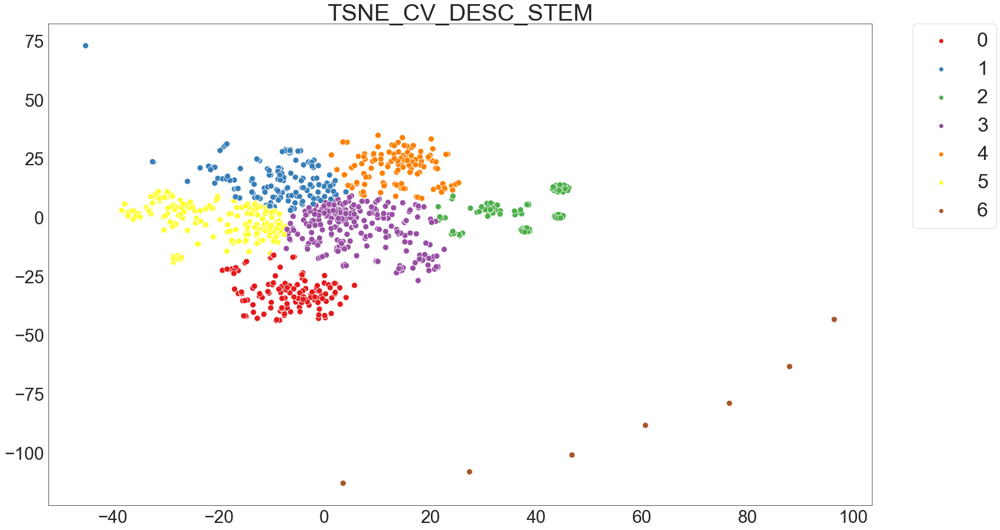

In [310]:
# Visualisation des clusters
outils_nlp.affiche_projection_par_clusters(X_proj_tsne_cv_desc_stem,
                                           kmeans_tsne_cv_desc_stem_labels,
                                           type_donnee)

In [697]:
# Sauvegarde des précisions de la catégorisation
df_precision = outils_nlp.sauvegarde_precision(df_precision, '0',
                                               type_donnee)
# Sauvegarde des dataframes de trace
outils_data.to_csv(df_precision, 'data_df_precision.csv')

**Bilan** :
***
- On observe un bien meilleur score qu'avec la réduction dimensionnelle ACP.
- La répartition est inégale, les vraies catégories sont mélangées dans les clusters, certains clusters sont vides , le score ARI est moins faible qu'avec ACP mais plus faible qu'avec les données lemmatisées.
- Cette combinaison T-SNE CountVectorizer + description sremmatisée ne parvient pas retrouver les 7 catégories comme le souhaite notre client.

**produit_specification** - lemmatisée
***

**Recherche des meilleurs hyperparamètres**

In [311]:
type_donnee = 'TSNE_CV_PROD_LEM'

In [312]:
# Tuning hyperparametres n_init, max_iter
# Paramètres à tester
n_init = [10, 20, 30, 50, 70, 80, 100]
max_iter = [100, 200, 300, 400, 500]
# Métriques avec les différentes combinaisons des paramètres
df_metrics_kmeans = \
    outils_nlp.calcul_metrics_kmeans(df_tsne_cv_prod_lem[cols],
                                     df_metrics_kmeans,
                                     type_donnee,
                                     seed, n_init, max_iter)
# Tri par indice de dispersion : proche de 0
df_metrics_kmeans[df_metrics_kmeans['Type_données'] == type_donnee] \
    .sort_values(by=['coef_silh', 'davies_bouldin', 'Durée (s)'],
                 ascending=[False, True, True]).style.hide_index()

Type_données,n_init,max_iter,coef_silh,dispersion,davies_bouldin,Durée (s)
TSNE_CV_PROD_LEM,30,300,0.45687,86617.25000,0.70988,0.17354
TSNE_CV_PROD_LEM,30,100,0.45687,86617.26562,0.70988,0.17453
TSNE_CV_PROD_LEM,30,200,0.45687,86617.26562,0.70988,0.17453
TSNE_CV_PROD_LEM,30,500,0.45687,86617.25781,0.70988,0.17553
TSNE_CV_PROD_LEM,30,400,0.45687,86617.26562,0.70988,0.17753
TSNE_CV_PROD_LEM,50,400,0.45687,86616.76562,0.70988,0.29222
TSNE_CV_PROD_LEM,50,500,0.45687,86616.76562,0.70988,0.29322
TSNE_CV_PROD_LEM,50,200,0.45687,86616.77344,0.70988,0.29621
TSNE_CV_PROD_LEM,50,300,0.45687,86616.75781,0.70988,0.29820
TSNE_CV_PROD_LEM,50,100,0.45687,86616.76562,0.70988,0.30020


In [313]:
# Sauvegarde des dataframes de trace
outils_data.to_csv(df_metrics_kmeans, 'data_df_metrics_kmeans.csv')

**Clustering**

In [314]:
# Instanciation du modèle KMeans avec les meilleurs paramètres
kmeans_tsne_cv_prod_lem = KMeans(n_clusters=7, init='k-means++',
                                 n_init=30, max_iter=300,
                                 random_state=seed) \
    .fit(df_tsne_cv_prod_lem[cols])
# Ajout de l'assignation du cluster au dataframe
df_tsne_cv_prod_lem['Clusters'] = kmeans_tsne_cv_prod_lem.labels_
kmeans_tsne_cv_prod_lem_labels = kmeans_tsne_cv_prod_lem.labels_

In [315]:
# Scores ?
df_scores = outils_nlp.calcul_metriques_clusters(df_tsne_cv_prod_lem,
                                                 df_scores,
                                                 type_donnee)
df_scores.style.hide_index()

Type_données,ARI,Homogénéité,Complétude,V-measure
ACP_CV_DESC_LEM,0.03894,0.11797,0.20952,0.15095
ACP_CV_DESC_STEM,0.04503,0.11941,0.19802,0.14898
ACP_CV_PROD_LEM,0.10551,0.26012,0.58404,0.35994
ACP_CV_PROD_STEM,0.10015,0.25417,0.57940,0.35334
ACP_TFIDF_DESC_LEM,0.14925,0.34720,0.53091,0.41984
ACP_TFIDF_DESC_STEM,0.14698,0.34728,0.52762,0.41886
ACP_TFIDF_PROD_LEM,0.20215,0.37890,0.48553,0.42564
ACP_TFIDF_PROD_STEM,0.21837,0.39724,0.50516,0.44475
ACP_HASH_DESC_LEM,0.03915,0.11095,0.19437,0.14126
ACP_HASH_DESC_STEM,0.04546,0.11990,0.20162,0.15037


In [316]:
# Sauvegarde des dataframes de trace
outils_data.to_csv(df_scores, 'data_df_scores.csv')

Clusters,Nombre,%
0,136,12.95000
1,153,14.57000
2,75,7.14000
3,256,24.38000
4,172,16.38000
5,154,14.67000
6,104,9.90000


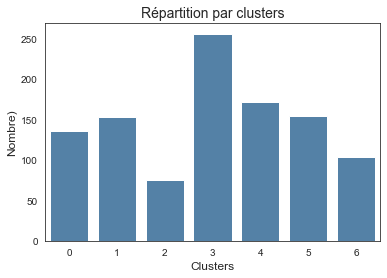

In [317]:
outils_nlp.affiche_repartition_par_clusters(kmeans_tsne_cv_prod_lem_labels)

In [318]:
# Les catégories par clusters
df_tsne_cv_prod_lem.groupby('Clusters')['CATEGORIE'].value_counts().to_frame()

CATEGORIE
Clusters CATEGORIE                            
0        Home Furnishing                    77
         Computers                          32
         Home Decor & Festive Needs         12
         Baby Care                           8
         Kitchen & Dining                    7
1        Watches                           141
         Home Decor & Festive Needs          7
         Home Furnishing                     5
2        Kitchen & Dining                   74
         Baby Care                           1
3        Home Decor & Festive Needs         92
         Beauty and Personal Care           45
         Kitchen & Dining                   35
         Baby Care                          34
         Computers                          21
         Home Furnishing                    20
         Watches                             9
4        Beauty and Personal Care          105
         Home Decor & Festive Needs         33
         Kitchen & Dining                   33
         Baby Care                           1
5        Baby Care                         106
         Home Furnishing                    48
6        Computers                          97
         Home Decor & Festive Needs          6
         Kitchen & Dining                    1

**Visualisation des clusters**

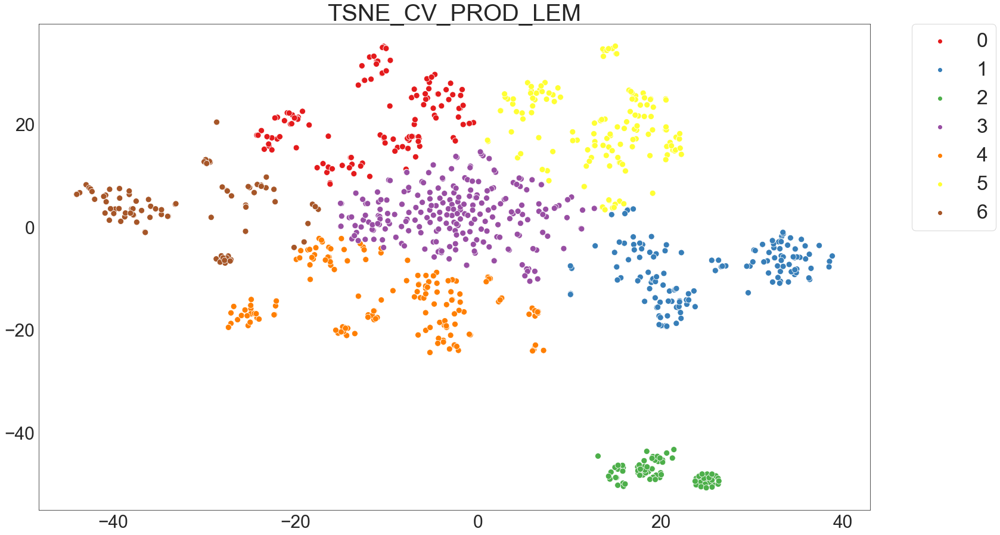

In [319]:
# Visualisation des clusters
outils_nlp.affiche_projection_par_clusters(X_proj_tsne_cv_prod_lem,
                                           kmeans_tsne_cv_prod_lem_labels,
                                           type_donnee)

**Bilan** :
***
- Le score ARI est encore plus grand qu'avec les données description.
- Les 7 catégories sont bien trouvées avec cependant quelques mélanges :
    - Cluster 0 : Home Furnishing
    - Cluster 1 : Watches
    - Cluster 2 : Kitchen & Dining
    - Cluster 3 : Home Decor & Festive Needs
    - Cluster 4 : Beauty and Personal Care
    - Cluster 5 : Baby Care
    - Cluster 6 : Computers
- Cette combinaison TSNE CountVectorizer + produit spécification lemmatisée parvient à retrouver les 7 catégories comme le souhaite notre client. Il reste à mesurer la qualité de cette catégorisation (70%).

**Qualité de la catégorisation ?**

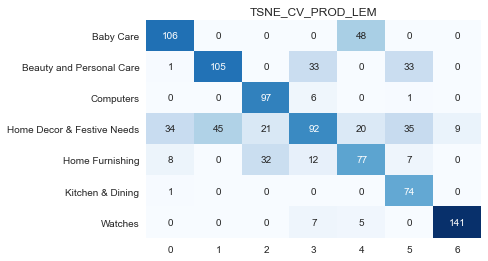

'Précision: 65.9%'

                            precision    recall  f1-score   support

                 Baby Care       0.71      0.69      0.70       154
  Beauty and Personal Care       0.70      0.61      0.65       172
                 Computers       0.65      0.93      0.76       104
Home Decor & Festive Needs       0.61      0.36      0.45       256
           Home Furnishing       0.51      0.57      0.54       136
          Kitchen & Dining       0.49      0.99      0.66        75
                   Watches       0.94      0.92      0.93       153

                  accuracy                           0.66      1050
                 macro avg       0.66      0.72      0.67      1050
              weighted avg       0.67      0.66      0.65      1050


In [320]:
# Liste : Baby Care, Beauty and Personal Care, Computers,
#         Home Decor & Festive Needs, Home Furnishing, Kitchen & Dining,
#         Watches
dico_categories = {'0': 'Home Furnishing',
                   '1': 'Watches',
                   '2': 'Kitchen & Dining',
                   '3': 'Home Decor & Festive Needs',
                   '4': 'Beauty and Personal Care',
                   '5': 'Baby Care',
                   '6': 'Computers'}
outils_nlp.affiche_qualite_categorisation(df_tsne_cv_prod_lem,
                                          dico_categories, type_donnee)

In [321]:
# Sauvegarde des précisions de la catégorisation
df_precision = outils_nlp.sauvegarde_precision(df_precision, '66',
                                               type_donnee)
# Sauvegarde des dataframes de trace
outils_data.to_csv(df_precision, 'data_df_precision.csv')

**produit_specification** - stemmatisée
***

**Recherche des meilleurs hyperparamètres**

In [322]:
type_donnee = 'TSNE_CV_PROD_STEM'

In [323]:
# Tuning hyperparametres n_init, max_iter
# Paramètres à tester
n_init = [10, 20, 30, 50, 70, 80, 100]
max_iter = [100, 200, 300, 400, 500]
# Métriques avec les différentes combinaisons des paramètres
df_metrics_kmeans = \
    outils_nlp.calcul_metrics_kmeans(df_tsne_cv_prod_stem[cols],
                                     df_metrics_kmeans,
                                     type_donnee,
                                     seed, n_init, max_iter)
# Tri par indice de dispersion : proche de 0
df_metrics_kmeans[df_metrics_kmeans['Type_données'] == type_donnee] \
    .sort_values(by=['coef_silh', 'davies_bouldin', 'Durée (s)'],
                 ascending=[False, True, True]).style.hide_index()

Type_données,n_init,max_iter,coef_silh,dispersion,davies_bouldin,Durée (s)
TSNE_CV_PROD_STEM,100,100,0.47089,85389.23438,0.67485,0.53458
TSNE_CV_PROD_STEM,100,200,0.47089,85389.23438,0.67485,0.53641
TSNE_CV_PROD_STEM,100,500,0.47089,85389.23438,0.67485,0.53856
TSNE_CV_PROD_STEM,100,300,0.47089,85389.23438,0.67485,0.54693
TSNE_CV_PROD_STEM,100,400,0.47089,85389.23438,0.67485,0.56050
TSNE_CV_PROD_STEM,10,300,0.47065,85389.38281,0.67597,0.03775
TSNE_CV_PROD_STEM,10,400,0.47065,85389.38281,0.67597,0.04686
TSNE_CV_PROD_STEM,10,200,0.47065,85389.38281,0.67597,0.04837
TSNE_CV_PROD_STEM,10,100,0.47065,85389.38281,0.67597,0.05286
TSNE_CV_PROD_STEM,10,500,0.47065,85389.38281,0.67597,0.06122


In [324]:
# Sauvegarde des dataframes de trace
outils_data.to_csv(df_metrics_kmeans, 'data_df_metrics_kmeans.csv')

**Clustering**

In [325]:
# Instanciation du modèle KMeans avec les meilleurs paramètres
kmeans_tsne_cv_prod_stem = KMeans(n_clusters=7, init='k-means++',
                                  n_init=100, max_iter=100,
                                  random_state=seed) \
    .fit(df_tsne_cv_prod_stem[cols])
# Ajout de l'assignation du cluster au dataframe
df_tsne_cv_prod_stem['Clusters'] = kmeans_tsne_cv_prod_stem.labels_
kmeans_tsne_cv_prod_stem_labels = kmeans_tsne_cv_prod_stem.labels_

In [326]:
# Scores ?
df_scores = outils_nlp.calcul_metriques_clusters(df_tsne_cv_prod_stem,
                                                 df_scores,
                                                 type_donnee)
df_scores.style.hide_index()

Type_données,ARI,Homogénéité,Complétude,V-measure
ACP_CV_DESC_LEM,0.03894,0.11797,0.20952,0.15095
ACP_CV_DESC_STEM,0.04503,0.11941,0.19802,0.14898
ACP_CV_PROD_LEM,0.10551,0.26012,0.58404,0.35994
ACP_CV_PROD_STEM,0.10015,0.25417,0.57940,0.35334
ACP_TFIDF_DESC_LEM,0.14925,0.34720,0.53091,0.41984
ACP_TFIDF_DESC_STEM,0.14698,0.34728,0.52762,0.41886
ACP_TFIDF_PROD_LEM,0.20215,0.37890,0.48553,0.42564
ACP_TFIDF_PROD_STEM,0.21837,0.39724,0.50516,0.44475
ACP_HASH_DESC_LEM,0.03915,0.11095,0.19437,0.14126
ACP_HASH_DESC_STEM,0.04546,0.11990,0.20162,0.15037


In [327]:
# Sauvegarde des dataframes de trace
outils_data.to_csv(df_scores, 'data_df_scores.csv')

Clusters,Nombre,%
0,147,14.00000
1,148,14.10000
2,138,13.14000
3,75,7.14000
4,143,13.62000
5,128,12.19000
6,271,25.81000


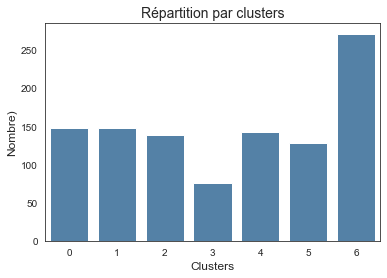

In [328]:
outils_nlp.affiche_repartition_par_clusters(kmeans_tsne_cv_prod_stem_labels)

In [331]:
# Les catégories par clusters
df_tsne_cv_prod_stem.groupby('Clusters')['CATEGORIE'].value_counts().to_frame()

CATEGORIE
Clusters CATEGORIE                            
0        Computers                         128
         Home Decor & Festive Needs         12
         Kitchen & Dining                    7
1        Watches                           141
         Home Decor & Festive Needs          4
         Home Furnishing                     3
2        Baby Care                          92
         Home Furnishing                    46
3        Kitchen & Dining                   74
         Baby Care                           1
4        Beauty and Personal Care          110
         Kitchen & Dining                   31
         Baby Care                           1
         Home Decor & Festive Needs          1
5        Home Furnishing                    99
         Baby Care                          23
         Computers                           6
6        Home Decor & Festive Needs        133
         Beauty and Personal Care           40
         Kitchen & Dining                   38
         Baby Care                          33
         Computers                          16
         Watches                             9
         Home Furnishing                     2

**Visualisation des clusters**

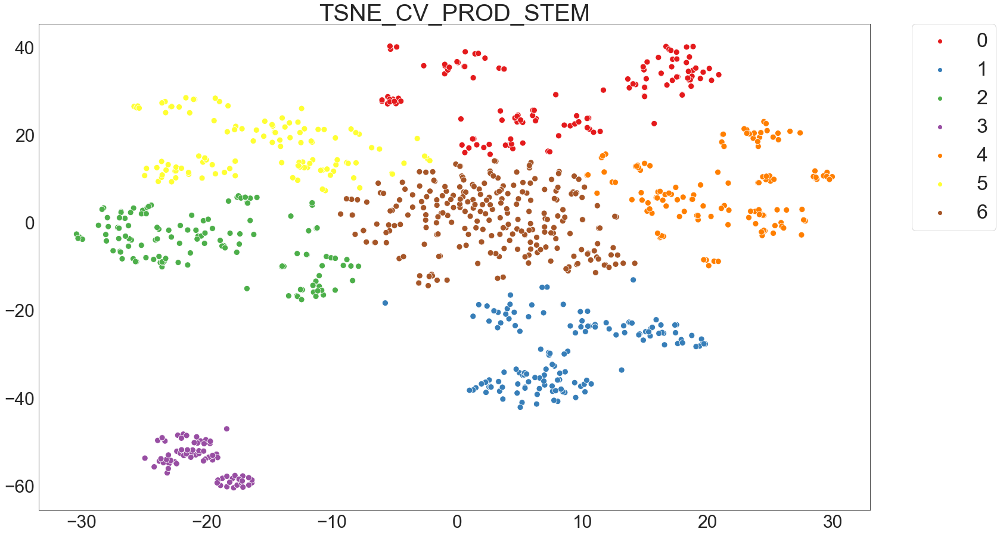

In [332]:
# Visualisation des clusters
outils_nlp.affiche_projection_par_clusters(X_proj_tsne_cv_prod_stem,
                                           kmeans_tsne_cv_prod_stem_labels,
                                           type_donnee)

**Bilan** :
***
- Le score ARI est encore plus grand qu'avec les données description mais moins bonne qu'avec les données lemmatisées.
- Les 7 catégories sont bien trouvées avec cependant quelques mélanges :
    - Cluster 0 : Computers
    - Cluster 1 : Watches
    - Cluster 2 : Baby Care
    - Cluster 3 : Kitchen & Dining
    - Cluster 4 : Beauty and Personal Care
    - Cluster 5 : Home Furnishing
    - Cluster 6 : Home Decor & Festive Needs
- Cette combinaison TSNE CountVectorizer + produit spécification stemmatisée parvient à retrouver les 7 catégories comme le souhaite notre client. Il reste à mesurer la qualité de cette catégorisation (64%).

**Qualité de la catégorisation ?**

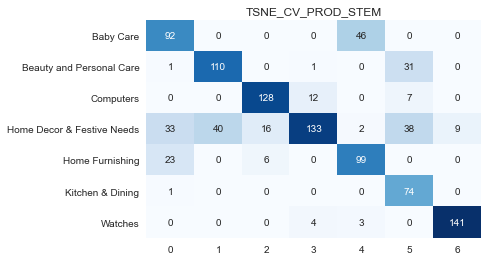

'Précision: 74.0%'

                            precision    recall  f1-score   support

                 Baby Care       0.61      0.67      0.64       138
  Beauty and Personal Care       0.73      0.77      0.75       143
                 Computers       0.85      0.87      0.86       147
Home Decor & Festive Needs       0.89      0.49      0.63       271
           Home Furnishing       0.66      0.77      0.71       128
          Kitchen & Dining       0.49      0.99      0.66        75
                   Watches       0.94      0.95      0.95       148

                  accuracy                           0.74      1050
                 macro avg       0.74      0.79      0.74      1050
              weighted avg       0.78      0.74      0.74      1050


In [333]:
dico_categories = {'0': 'Computers',
                   '1': 'Watches',
                   '2': 'Baby Care',
                   '3': 'Kitchen & Dining',
                   '4': 'Beauty and Personal Care',
                   '5': 'Home Furnishing',
                   '6': 'Home Decor & Festive Needs'}
outils_nlp.affiche_qualite_categorisation(df_tsne_cv_prod_stem,
                                          dico_categories, type_donnee)

In [334]:
# Sauvegarde des précisions de la catégorisation
df_precision = outils_nlp.sauvegarde_precision(df_precision, '74',
                                               type_donnee)
# Sauvegarde des dataframes de trace
outils_data.to_csv(df_precision, 'data_df_precision.csv')

### <span style='background:PowderBlue'>6.5. TSNE BOW TfidfVectorizer</span>

**description** - lemmatisée
***

**Recherche des meilleurs hyperparamètres**

In [712]:
type_donnee = 'TSNE_TFIDF_DESC_LEM'

In [336]:
# Tuning hyperparametres n_init, max_iter
# Paramètres à tester
n_init = [10, 20, 30, 50, 70, 80, 100]
max_iter = [100, 200, 300, 400, 500]
# Métriques avec les différentes combinaisons des paramètres
df_metrics_kmeans = \
    outils_nlp.calcul_metrics_kmeans(df_tsne_tfidf_desc_lem[cols],
                                     df_metrics_kmeans,
                                     type_donnee,
                                     seed, n_init, max_iter)
# Tri par indice de dispersion : proche de 0
df_metrics_kmeans[df_metrics_kmeans['Type_données'] == type_donnee] \
    .sort_values(by=['coef_silh', 'davies_bouldin', 'Durée (s)'],
                 ascending=[False, True, True]).style.hide_index()

Type_données,n_init,max_iter,coef_silh,dispersion,davies_bouldin,Durée (s)
TSNE_HASH_DESC_LEM,10,300,0.44853,126093.99219,0.72024,0.05054
TSNE_HASH_DESC_LEM,10,500,0.44853,126093.99219,0.72024,0.05337
TSNE_HASH_DESC_LEM,10,400,0.44853,126094.00000,0.72024,0.05687
TSNE_HASH_DESC_LEM,10,200,0.44853,126094.00000,0.72024,0.06582
TSNE_HASH_DESC_LEM,10,100,0.44853,126093.99219,0.72024,0.06683
TSNE_HASH_DESC_LEM,20,200,0.44837,126091.39062,0.72201,0.12304
TSNE_HASH_DESC_LEM,20,400,0.44837,126091.37500,0.72201,0.12804
TSNE_HASH_DESC_LEM,20,100,0.44837,126091.37500,0.72201,0.13065
TSNE_HASH_DESC_LEM,20,300,0.44837,126091.39062,0.72201,0.14081
TSNE_HASH_DESC_LEM,20,500,0.44837,126091.39062,0.72201,0.14248


In [337]:
# Sauvegarde des dataframes de trace
outils_data.to_csv(df_metrics_kmeans, 'data_df_metrics_kmeans.csv')

**Clustering**

In [338]:
# Instanciation du modèle KMeans avec les meilleurs paramètres
kmeans_tsne_tfidf_desc_lem = KMeans(n_clusters=7, init='k-means++',
                                    n_init=10, max_iter=300,
                                    random_state=seed) \
    .fit(df_tsne_tfidf_desc_lem[cols])
# Ajout de l'assignation du cluster au dataframe
df_tsne_tfidf_desc_lem['Clusters'] = kmeans_tsne_tfidf_desc_lem.labels_
kmeans_tsne_tfidf_desc_lem_labels = kmeans_tsne_tfidf_desc_lem.labels_

In [339]:
# Scores ?
df_scores = outils_nlp.calcul_metriques_clusters(df_tsne_tfidf_desc_lem,
                                                 df_scores,
                                                 type_donnee)
df_scores.style.hide_index()

Type_données,ARI,Homogénéité,Complétude,V-measure
ACP_CV_DESC_LEM,0.03894,0.11797,0.20952,0.15095
ACP_CV_DESC_STEM,0.04503,0.11941,0.19802,0.14898
ACP_CV_PROD_LEM,0.10551,0.26012,0.58404,0.35994
ACP_CV_PROD_STEM,0.10015,0.25417,0.57940,0.35334
ACP_TFIDF_DESC_LEM,0.14925,0.34720,0.53091,0.41984
ACP_TFIDF_DESC_STEM,0.14698,0.34728,0.52762,0.41886
ACP_TFIDF_PROD_LEM,0.20215,0.37890,0.48553,0.42564
ACP_TFIDF_PROD_STEM,0.21837,0.39724,0.50516,0.44475
ACP_HASH_DESC_LEM,0.03915,0.11095,0.19437,0.14126
ACP_HASH_DESC_STEM,0.04546,0.11990,0.20162,0.15037


In [340]:
# Sauvegarde des dataframes de trace
outils_data.to_csv(df_scores, 'data_df_scores.csv')

Clusters,Nombre,%
0,206,19.62000
1,136,12.95000
2,154,14.67000
3,182,17.33000
4,167,15.90000
5,90,8.57000
6,115,10.95000


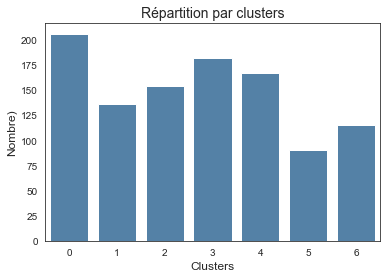

In [345]:
outils_nlp.affiche_repartition_par_clusters(kmeans_tsne_tfidf_desc_lem_labels)

In [346]:
# Les catégories par clusters
df_tsne_tfidf_desc_lem.groupby('Clusters')['CATEGORIE'].value_counts() \
    .to_frame()

CATEGORIE
Clusters CATEGORIE                            
0        Home Decor & Festive Needs        107
         Kitchen & Dining                   40
         Computers                          30
         Beauty and Personal Care           18
         Baby Care                          11
1        Baby Care                          95
         Home Furnishing                    22
         Computers                           9
         Beauty and Personal Care            6
         Home Decor & Festive Needs          3
         Kitchen & Dining                    1
2        Watches                           148
         Computers                           3
         Home Decor & Festive Needs          3
3        Home Furnishing                   108
         Home Decor & Festive Needs         26
         Baby Care                          20
         Beauty and Personal Care           17
         Kitchen & Dining                    8
         Computers                           3
4        Computers                         105
         Kitchen & Dining                   23
         Beauty and Personal Care           22
         Home Decor & Festive Needs          8
         Baby Care                           7
         Watches                             2
5        Kitchen & Dining                   77
         Beauty and Personal Care            9
         Baby Care                           2
         Home Decor & Festive Needs          2
6        Beauty and Personal Care           78
         Home Furnishing                    20
         Baby Care                          15
         Home Decor & Festive Needs          1
         Kitchen & Dining                    1

**Visualisation des clusters**

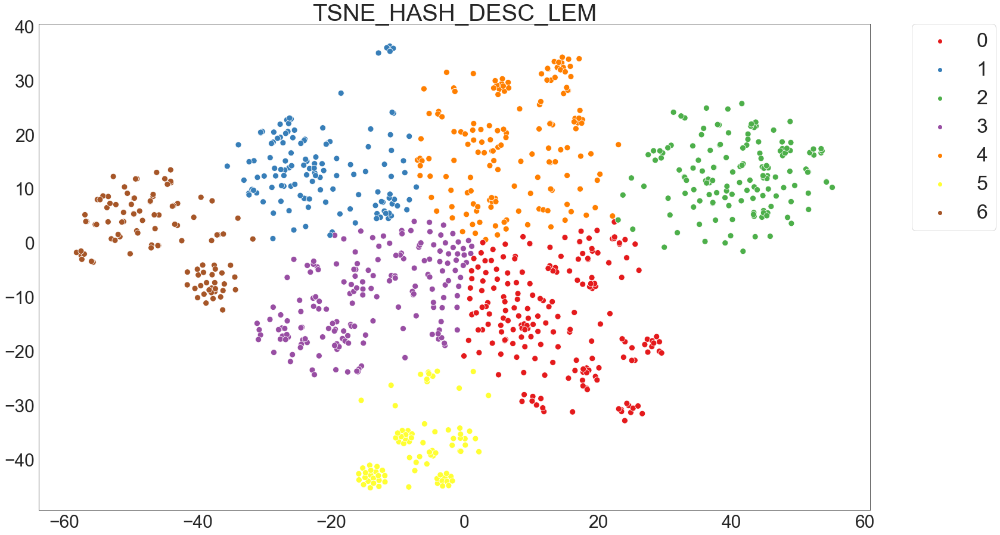

In [343]:
# Visualisation des clusters
outils_nlp.affiche_projection_par_clusters(X_proj_tsne_tfidf_desc_lem,
                                           kmeans_tsne_tfidf_desc_lem_labels,
                                           type_donnee)

**Bilan** :
***
- Le score ARI est encore plus grand qu'avec les données description mais moins bonne qu'avec les données lemmatisées.
- Les 7 catégories sont bien trouvées avec cependant quelques mélanges :
    - Cluster 0 : Home Decor & Festive Needs
    - Cluster 1 : Baby Care
    - Cluster 2 : Watches
    - Cluster 3 : Home Furnishing	
    - Cluster 4 : Computers
    - Cluster 5 : Kitchen & Dining
    - Cluster 6 : Beauty and Personal Care
- Cette combinaison TSNE CountVectorizer + produit spécification stemmatisée parvient à retrouver les 7 catégories comme le souhaite notre client. Il reste à mesurer la qualité de cette catégorisation (64%).

**Qualité de la catégorisation ?**

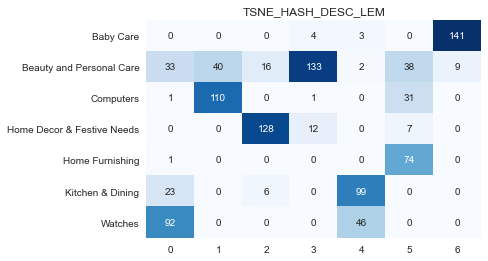

'Précision: 4.95%'

                            precision    recall  f1-score   support

                 Baby Care       0.00      0.00      0.00       148
  Beauty and Personal Care       0.27      0.15      0.19       271
                 Computers       0.00      0.00      0.00       143
Home Decor & Festive Needs       0.08      0.08      0.08       147
           Home Furnishing       0.00      0.00      0.00        75
          Kitchen & Dining       0.00      0.00      0.00       128
                   Watches       0.00      0.00      0.00       138

                  accuracy                           0.05      1050
                 macro avg       0.05      0.03      0.04      1050
              weighted avg       0.08      0.05      0.06      1050


In [344]:
dico_categories = {'0': 'Home Decor & Festive Needs',
                   '1': 'Baby Care',
                   '2': 'Watches',
                   '3': 'Home Furnishing',
                   '4': 'Computers',
                   '5': 'Kitchen & Dining',
                   '6': 'Beauty and Personal Care'}
outils_nlp.affiche_qualite_categorisation(df_tsne_cv_prod_stem,
                                          dico_categories, type_donnee)

In [713]:
# Sauvegarde des précisions de la catégorisation
df_precision = outils_nlp.sauvegarde_precision(df_precision, '5',
                                               type_donnee)
# Sauvegarde des dataframes de trace
outils_data.to_csv(df_precision, 'data_df_precision.csv')

**description** - stemmatisée
***

**Recherche des meilleurs hyperparamètres**

In [348]:
type_donnee = 'TSNE_TFIDF_DESC_STEM'

In [349]:
# Tuning hyperparametres n_init, max_iter
# Paramètres à tester
n_init = [10, 20, 30, 50, 70, 80, 100]
max_iter = [100, 200, 300, 400, 500]
# Métriques avec les différentes combinaisons des paramètres
df_metrics_kmeans = \
    outils_nlp.calcul_metrics_kmeans(df_tsne_tfidf_desc_stem[cols],
                                     df_metrics_kmeans,
                                     type_donnee,
                                     seed, n_init, max_iter)
# Tri par indice de dispersion : proche de 0
df_metrics_kmeans[df_metrics_kmeans['Type_données'] == type_donnee] \
    .sort_values(by=['coef_silh', 'davies_bouldin', 'Durée (s)'],
                 ascending=[False, True, True]).style.hide_index()

Type_données,n_init,max_iter,coef_silh,dispersion,davies_bouldin,Durée (s)
TSNE_TFIDF_DESC_STEM,10,200,0.44815,149197.57812,0.70519,0.05930
TSNE_TFIDF_DESC_STEM,10,300,0.44815,149197.57812,0.70519,0.06090
TSNE_TFIDF_DESC_STEM,10,500,0.44815,149197.57812,0.70519,0.06380
TSNE_TFIDF_DESC_STEM,10,100,0.44815,149197.57812,0.70519,0.06483
TSNE_TFIDF_DESC_STEM,10,400,0.44815,149197.57812,0.70519,0.06899
TSNE_TFIDF_DESC_STEM,20,300,0.44815,149197.57812,0.70519,0.12252
TSNE_TFIDF_DESC_STEM,20,200,0.44815,149197.57812,0.70519,0.13165
TSNE_TFIDF_DESC_STEM,20,100,0.44815,149197.57812,0.70519,0.13365
TSNE_TFIDF_DESC_STEM,20,400,0.44815,149197.56250,0.70519,0.13789
TSNE_TFIDF_DESC_STEM,20,500,0.44815,149197.57812,0.70519,0.14875


In [350]:
# Sauvegarde des dataframes de trace
outils_data.to_csv(df_metrics_kmeans, 'data_df_metrics_kmeans.csv')

**Clustering**

In [351]:
# Instanciation du modèle KMeans avec les meilleurs paramètres
kmeans_tsne_tfidf_desc_stem = KMeans(n_clusters=7, init='k-means++',
                                     n_init=10, max_iter=200,
                                     random_state=seed) \
    .fit(df_tsne_tfidf_desc_stem[cols])
# Ajout de l'assignation du cluster au dataframe
df_tsne_tfidf_desc_stem['Clusters'] = kmeans_tsne_tfidf_desc_stem.labels_
kmeans_tsne_tfidf_desc_stem_labels = kmeans_tsne_tfidf_desc_stem.labels_

In [353]:
# Scores ?
df_scores = outils_nlp.calcul_metriques_clusters(df_tsne_tfidf_desc_stem,
                                                 df_scores,
                                                 type_donnee)
df_scores.style.hide_index()

Type_données,ARI,Homogénéité,Complétude,V-measure
ACP_CV_DESC_LEM,0.03894,0.11797,0.20952,0.15095
ACP_CV_DESC_STEM,0.04503,0.11941,0.19802,0.14898
ACP_CV_PROD_LEM,0.10551,0.26012,0.58404,0.35994
ACP_CV_PROD_STEM,0.10015,0.25417,0.57940,0.35334
ACP_TFIDF_DESC_LEM,0.14925,0.34720,0.53091,0.41984
ACP_TFIDF_DESC_STEM,0.14698,0.34728,0.52762,0.41886
ACP_TFIDF_PROD_LEM,0.20215,0.37890,0.48553,0.42564
ACP_TFIDF_PROD_STEM,0.21837,0.39724,0.50516,0.44475
ACP_HASH_DESC_LEM,0.03915,0.11095,0.19437,0.14126
ACP_HASH_DESC_STEM,0.04546,0.11990,0.20162,0.15037


In [354]:
# Sauvegarde des dataframes de trace
outils_data.to_csv(df_scores, 'data_df_scores.csv')

Clusters,Nombre,%
0,116,11.05000
1,93,8.86000
2,189,18.00000
3,158,15.05000
4,167,15.90000
5,210,20.00000
6,117,11.14000


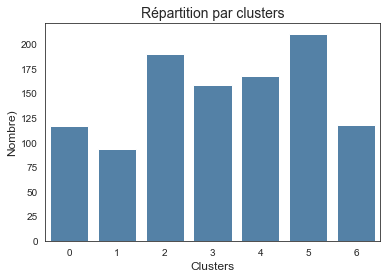

In [355]:
outils_nlp.affiche_repartition_par_clusters(kmeans_tsne_tfidf_desc_stem_labels)

In [356]:
# Les catégories par clusters
df_tsne_tfidf_desc_stem.groupby('Clusters')['CATEGORIE'].value_counts(). \
    to_frame()

CATEGORIE
Clusters CATEGORIE                            
0        Baby Care                          89
         Beauty and Personal Care           18
         Home Furnishing                     8
         Kitchen & Dining                    1
1        Kitchen & Dining                   75
         Computers                           9
         Beauty and Personal Care            5
         Baby Care                           2
         Home Decor & Festive Needs          2
2        Home Furnishing                   101
         Home Decor & Festive Needs         27
         Baby Care                          23
         Kitchen & Dining                   18
         Beauty and Personal Care           16
         Computers                           4
3        Watches                           148
         Computers                           7
         Home Decor & Festive Needs          2
         Beauty and Personal Care            1
4        Computers                          97
         Home Furnishing                    21
         Home Decor & Festive Needs         15
         Kitchen & Dining                   13
         Beauty and Personal Care           10
         Baby Care                           9
         Watches                             2
5        Home Decor & Festive Needs        104
         Kitchen & Dining                   42
         Computers                          33
         Beauty and Personal Care           20
         Baby Care                          11
6        Beauty and Personal Care           80
         Home Furnishing                    20
         Baby Care                          16
         Kitchen & Dining                    1

**Visualisation des clusters**

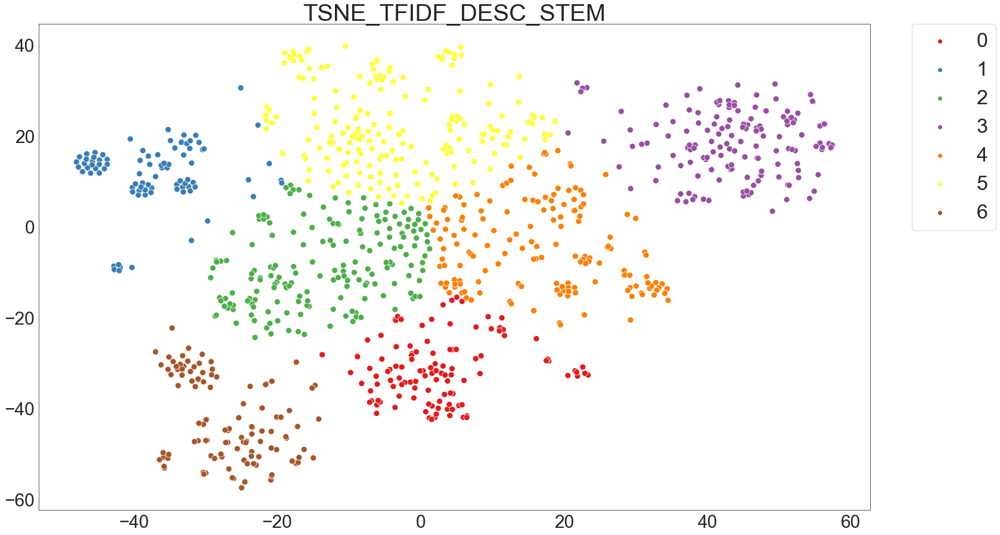

In [357]:
# Visualisation des clusters
outils_nlp.affiche_projection_par_clusters(X_proj_tsne_tfidf_desc_stem,
                                           kmeans_tsne_tfidf_desc_stem_labels,
                                           type_donnee)

**Bilan** :
***
- Le score ARI est moyen.
- Les 7 catégories sont bien trouvées avec cependant quelques mélanges :
    - Cluster 0 : Baby Care
    - Cluster 1 : Kitchen & Dining
    - Cluster 2 : Home Furnishing
    - Cluster 3 : Watches
    - Cluster 4 : Computers
    - Cluster 5 : Home Furnishing
    - Cluster 6 : Beauty and Personal Care
- Cette combinaison TSNE TfidfVectorizer + description stemmatisée parvient à retrouver les 7 catégories comme le souhaite notre client. Il reste à mesurer la qualité de cette catégorisation (66%).

**Qualité de la catégorisation ?**

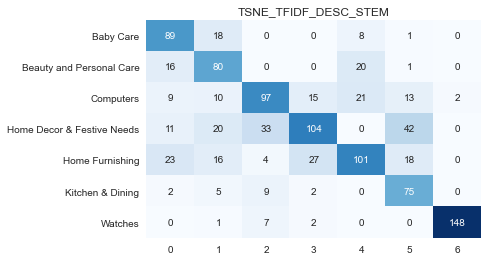

'Précision: 66.1%'

                            precision    recall  f1-score   support

                 Baby Care       0.59      0.77      0.67       116
  Beauty and Personal Care       0.53      0.68      0.60       117
                 Computers       0.65      0.58      0.61       167
Home Decor & Festive Needs       0.69      0.50      0.58       210
           Home Furnishing       0.67      0.53      0.60       189
          Kitchen & Dining       0.50      0.81      0.62        93
                   Watches       0.99      0.94      0.96       158

                  accuracy                           0.66      1050
                 macro avg       0.66      0.69      0.66      1050
              weighted avg       0.68      0.66      0.66      1050


In [358]:
dico_categories = {'0': 'Baby Care',
                   '1': 'Kitchen & Dining',
                   '2': 'Home Furnishing',
                   '3': 'Watches',
                   '4': 'Computers',
                   '5': 'Home Decor & Festive Needs',
                   '6': 'Beauty and Personal Care'}
outils_nlp.affiche_qualite_categorisation(df_tsne_tfidf_desc_stem,
                                          dico_categories, type_donnee)

In [359]:
# Sauvegarde des précisions de la catégorisation
df_precision = outils_nlp.sauvegarde_precision(df_precision, '66',
                                               type_donnee)
# Sauvegarde des dataframes de trace
outils_data.to_csv(df_precision, 'data_df_precision.csv')

**produit_specification** - lemmatisée
***

**Recherche des meilleurs hyperparamètres**

In [360]:
type_donnee = 'TSNE_TFIDF_PROD_LEM'

In [361]:
# Tuning hyperparametres n_init, max_iter
# Paramètres à tester
n_init = [10, 20, 30, 50, 70, 80, 100]
max_iter = [100, 200, 300, 400, 500]
# Métriques avec les différentes combinaisons des paramètres
df_metrics_kmeans = \
    outils_nlp.calcul_metrics_kmeans(df_tsne_tfidf_prod_lem[cols],
                                     df_metrics_kmeans,
                                     type_donnee,
                                     seed, n_init, max_iter)
# Tri par indice de dispersion : proche de 0
df_metrics_kmeans[df_metrics_kmeans['Type_données'] == type_donnee] \
    .sort_values(by=['coef_silh', 'davies_bouldin', 'Durée (s)'],
                 ascending=[False, True, True]).style.hide_index()

Type_données,n_init,max_iter,coef_silh,dispersion,davies_bouldin,Durée (s)
TSNE_TFIDF_PROD_LEM,10,500,0.48670,114218.71094,0.71912,0.05086
TSNE_TFIDF_PROD_LEM,10,200,0.48670,114218.71094,0.71912,0.05186
TSNE_TFIDF_PROD_LEM,10,400,0.48670,114218.71094,0.71912,0.05186
TSNE_TFIDF_PROD_LEM,10,300,0.48670,114218.70312,0.71912,0.05218
TSNE_TFIDF_PROD_LEM,10,100,0.48670,114218.71875,0.71912,0.05385
TSNE_TFIDF_PROD_LEM,20,500,0.48670,114218.70312,0.71912,0.09475
TSNE_TFIDF_PROD_LEM,20,100,0.48670,114218.70312,0.71912,0.09475
TSNE_TFIDF_PROD_LEM,20,200,0.48670,114218.70312,0.71912,0.09475
TSNE_TFIDF_PROD_LEM,20,300,0.48670,114218.70312,0.71912,0.09579
TSNE_TFIDF_PROD_LEM,20,400,0.48670,114218.71875,0.71912,0.10032


In [362]:
# Sauvegarde des dataframes de trace
outils_data.to_csv(df_metrics_kmeans, 'data_df_metrics_kmeans.csv')

**Clustering**

In [363]:
# Instanciation du modèle KMeans avec les meilleurs paramètres
kmeans_tsne_tfidf_prod_lem = KMeans(n_clusters=7, init='k-means++',
                                    n_init=10, max_iter=500,
                                    random_state=seed) \
    .fit(df_tsne_tfidf_prod_lem[cols])
# Ajout de l'assignation du cluster au dataframe
df_tsne_tfidf_prod_lem['Clusters'] = kmeans_tsne_tfidf_prod_lem.labels_
kmeans_tsne_tfidf_prod_lem_labels = kmeans_tsne_tfidf_prod_lem.labels_

In [364]:
# Scores ?
df_scores = outils_nlp.calcul_metriques_clusters(df_tsne_tfidf_prod_lem,
                                                 df_scores,
                                                 type_donnee)
df_scores.style.hide_index()

Type_données,ARI,Homogénéité,Complétude,V-measure
ACP_CV_DESC_LEM,0.03894,0.11797,0.20952,0.15095
ACP_CV_DESC_STEM,0.04503,0.11941,0.19802,0.14898
ACP_CV_PROD_LEM,0.10551,0.26012,0.58404,0.35994
ACP_CV_PROD_STEM,0.10015,0.25417,0.57940,0.35334
ACP_TFIDF_DESC_LEM,0.14925,0.34720,0.53091,0.41984
ACP_TFIDF_DESC_STEM,0.14698,0.34728,0.52762,0.41886
ACP_TFIDF_PROD_LEM,0.20215,0.37890,0.48553,0.42564
ACP_TFIDF_PROD_STEM,0.21837,0.39724,0.50516,0.44475
ACP_HASH_DESC_LEM,0.03915,0.11095,0.19437,0.14126
ACP_HASH_DESC_STEM,0.04546,0.11990,0.20162,0.15037


In [366]:
# Sauvegarde des dataframes de trace
outils_data.to_csv(df_scores, 'data_df_scores.csv')

Clusters,Nombre,%
0,132,12.57000
1,164,15.62000
2,158,15.05000
3,149,14.19000
4,117,11.14000
5,136,12.95000
6,194,18.48000


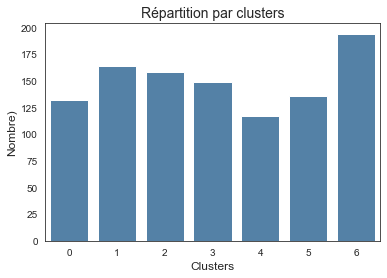

In [367]:
outils_nlp.affiche_repartition_par_clusters(kmeans_tsne_tfidf_prod_lem_labels)

In [368]:
# Les catégories par clusters
df_tsne_tfidf_prod_lem.groupby('Clusters')['CATEGORIE'].value_counts(). \
    to_frame()

CATEGORIE
Clusters CATEGORIE                            
0        Home Furnishing                    98
         Baby Care                          30
         Beauty and Personal Care            4
1        Watches                           147
         Home Decor & Festive Needs         11
         Computers                           3
         Kitchen & Dining                    2
         Beauty and Personal Care            1
2        Computers                         132
         Home Decor & Festive Needs         14
         Kitchen & Dining                    9
         Beauty and Personal Care            3
3        Beauty and Personal Care          127
         Kitchen & Dining                   13
         Baby Care                           6
         Home Decor & Festive Needs          3
4        Kitchen & Dining                  110
         Baby Care                           4
         Home Decor & Festive Needs          2
         Computers                           1
5        Baby Care                          89
         Home Furnishing                    42
         Watches                             3
         Beauty and Personal Care            1
         Home Decor & Festive Needs          1
6        Home Decor & Festive Needs        119
         Baby Care                          21
         Kitchen & Dining                   16
         Beauty and Personal Care           14
         Computers                          14
         Home Furnishing                    10

**Visualisation des clusters**

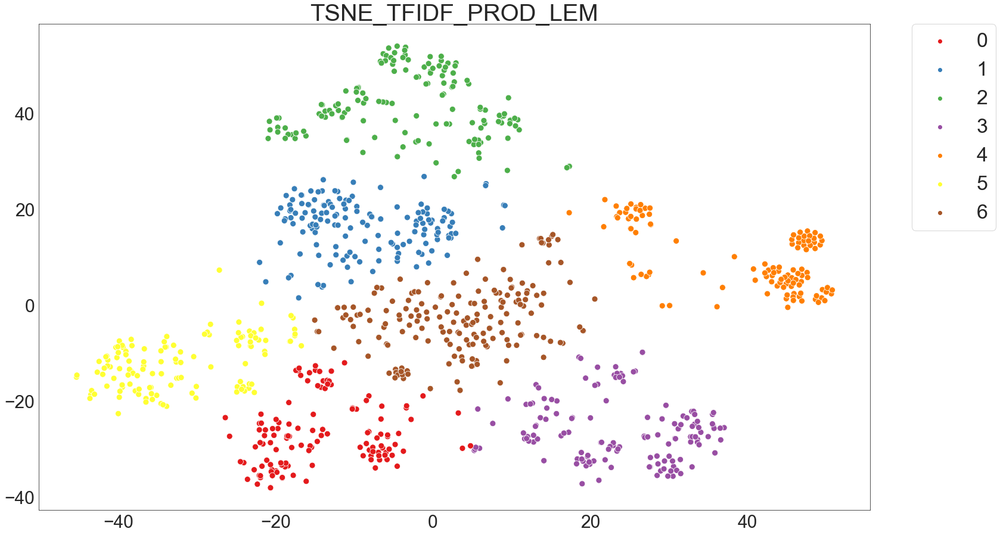

In [369]:
# Visualisation des clusters
outils_nlp.affiche_projection_par_clusters(X_proj_tsne_tfidf_prod_lem,
                                           kmeans_tsne_tfidf_prod_lem_labels,
                                           type_donnee)

**Bilan** :
***
- Le score ARI est assez haut (0.6).
- Les 7 catégories sont bien trouvées avec cependant quelques mélanges :
    - Cluster 0 : Home Furnishing
    - Cluster 1 : Watches
    - Cluster 2 : Computers
    - Cluster 3 : Beauty and Personal Care
    - Cluster 4 : Kitchen & Dining
    - Cluster 5 : Baby Care
    - Cluster 6 : Home Decor & Festive Needs
- Cette combinaison TSNE TfidfVectorizer + produit spécification lemmatisé parvient à retrouver les 7 catégories comme le souhaite notre client. Il reste à mesurer la qualité de cette catégorisation (78%).

**Qualité de la catégorisation ?**

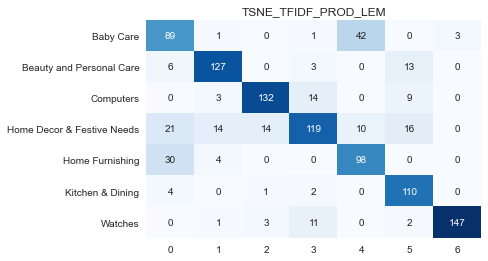

'Précision: 78.29%'

                            precision    recall  f1-score   support

                 Baby Care       0.59      0.65      0.62       136
  Beauty and Personal Care       0.85      0.85      0.85       149
                 Computers       0.88      0.84      0.86       158
Home Decor & Festive Needs       0.79      0.61      0.69       194
           Home Furnishing       0.65      0.74      0.70       132
          Kitchen & Dining       0.73      0.94      0.82       117
                   Watches       0.98      0.90      0.94       164

                  accuracy                           0.78      1050
                 macro avg       0.78      0.79      0.78      1050
              weighted avg       0.79      0.78      0.78      1050


In [372]:
dico_categories = {'0': 'Home Furnishing',
                   '1': 'Watches',
                   '2': 'Computers',
                   '3': 'Beauty and Personal Care',
                   '4': 'Kitchen & Dining',
                   '5': 'Baby Care',
                   '6': 'Home Decor & Festive Needs'}
outils_nlp.affiche_qualite_categorisation(df_tsne_tfidf_prod_lem,
                                          dico_categories, type_donnee)

In [373]:
# Sauvegarde des précisions de la catégorisation
df_precision = outils_nlp.sauvegarde_precision(df_precision, '78',
                                               type_donnee)
# Sauvegarde des dataframes de trace
outils_data.to_csv(df_precision, 'data_df_precision.csv')

**produit_specification** - stemmatisée
***

**Recherche des meilleurs hyperparamètres**

In [375]:
type_donnee = 'TSNE_TFIDF_PROD_STEM'

In [376]:
# Tuning hyperparametres n_init, max_iter
# Paramètres à tester
n_init = [10, 20, 30, 50, 70, 80, 100]
max_iter = [100, 200, 300, 400, 500]
# Métriques avec les différentes combinaisons des paramètres
df_metrics_kmeans = \
    outils_nlp.calcul_metrics_kmeans(df_tsne_tfidf_prod_stem[cols],
                                     df_metrics_kmeans,
                                     type_donnee,
                                     seed, n_init, max_iter)
# Tri par indice de dispersion : proche de 0
df_metrics_kmeans[df_metrics_kmeans['Type_données'] == type_donnee] \
    .sort_values(by=['coef_silh', 'davies_bouldin', 'Durée (s)'],
                 ascending=[False, True, True]).style.hide_index()

Type_données,n_init,max_iter,coef_silh,dispersion,davies_bouldin,Durée (s)
TSNE_TFIDF_PROD_STEM,10,400,0.47920,82716.15625,0.72018,0.05086
TSNE_TFIDF_PROD_STEM,10,300,0.47920,82716.15625,0.72018,0.05086
TSNE_TFIDF_PROD_STEM,10,100,0.47920,82716.15625,0.72018,0.05183
TSNE_TFIDF_PROD_STEM,10,500,0.47920,82716.14844,0.72018,0.05186
TSNE_TFIDF_PROD_STEM,10,200,0.47920,82716.15625,0.72018,0.05186
TSNE_TFIDF_PROD_STEM,20,100,0.47920,82716.15625,0.72018,0.10272
TSNE_TFIDF_PROD_STEM,20,300,0.47920,82716.15625,0.72018,0.10273
TSNE_TFIDF_PROD_STEM,20,400,0.47920,82716.15625,0.72018,0.10273
TSNE_TFIDF_PROD_STEM,20,200,0.47920,82716.15625,0.72018,0.10572
TSNE_TFIDF_PROD_STEM,20,500,0.47920,82716.15625,0.72018,0.10771


In [377]:
# Sauvegarde des dataframes de trace
outils_data.to_csv(df_metrics_kmeans, 'data_df_metrics_kmeans.csv')

**Clustering**

In [378]:
# Instanciation du modèle KMeans avec les meilleurs paramètres
kmeans_tsne_tfidf_prod_stem = KMeans(n_clusters=7, init='k-means++',
                                     n_init=10, max_iter=400,
                                     random_state=seed) \
    .fit(df_tsne_tfidf_prod_stem[cols])
# Ajout de l'assignation du cluster au dataframe
df_tsne_tfidf_prod_stem['Clusters'] = kmeans_tsne_tfidf_prod_stem.labels_
kmeans_tsne_tfidf_prod_stem_labels = kmeans_tsne_tfidf_prod_stem.labels_

In [379]:
# Scores ?
df_scores = outils_nlp.calcul_metriques_clusters(df_tsne_tfidf_prod_stem,
                                                 df_scores,
                                                 type_donnee)
df_scores.style.hide_index()

Type_données,ARI,Homogénéité,Complétude,V-measure
ACP_CV_DESC_LEM,0.03894,0.11797,0.20952,0.15095
ACP_CV_DESC_STEM,0.04503,0.11941,0.19802,0.14898
ACP_CV_PROD_LEM,0.10551,0.26012,0.58404,0.35994
ACP_CV_PROD_STEM,0.10015,0.25417,0.57940,0.35334
ACP_TFIDF_DESC_LEM,0.14925,0.34720,0.53091,0.41984
ACP_TFIDF_DESC_STEM,0.14698,0.34728,0.52762,0.41886
ACP_TFIDF_PROD_LEM,0.20215,0.37890,0.48553,0.42564
ACP_TFIDF_PROD_STEM,0.21837,0.39724,0.50516,0.44475
ACP_HASH_DESC_LEM,0.03915,0.11095,0.19437,0.14126
ACP_HASH_DESC_STEM,0.04546,0.11990,0.20162,0.15037


In [380]:
# Sauvegarde des dataframes de trace
outils_data.to_csv(df_scores, 'data_df_scores.csv')

Clusters,Nombre,%
0,175,16.67000
1,147,14.00000
2,144,13.71000
3,128,12.19000
4,158,15.05000
5,174,16.57000
6,124,11.81000


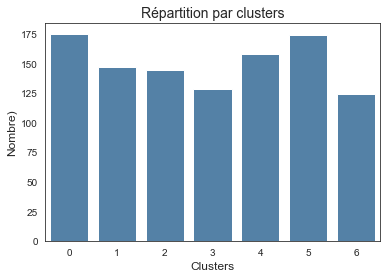

In [381]:
outils_nlp \
    .affiche_repartition_par_clusters(kmeans_tsne_tfidf_prod_stem_labels)

In [382]:
# Les catégories par clusters
df_tsne_tfidf_prod_stem.groupby('Clusters')['CATEGORIE'].value_counts() \
    .to_frame()

CATEGORIE
Clusters CATEGORIE                            
0        Watches                           146
         Home Decor & Festive Needs         13
         Baby Care                           9
         Kitchen & Dining                    5
         Computers                           2
1        Beauty and Personal Care          126
         Kitchen & Dining                   13
         Baby Care                           6
         Home Decor & Festive Needs          2
2        Baby Care                          90
         Home Furnishing                    47
         Computers                           3
         Watches                             3
         Beauty and Personal Care            1
3        Kitchen & Dining                  122
         Baby Care                           4
         Computers                           1
         Home Decor & Festive Needs          1
4        Computers                         129
         Home Decor & Festive Needs         17
         Kitchen & Dining                    8
         Beauty and Personal Care            4
5        Home Decor & Festive Needs        117
         Beauty and Personal Care           18
         Computers                          15
         Baby Care                          13
         Home Furnishing                     8
         Kitchen & Dining                    2
         Watches                             1
6        Home Furnishing                    95
         Baby Care                          28
         Beauty and Personal Care            1

**Visualisation des clusters**

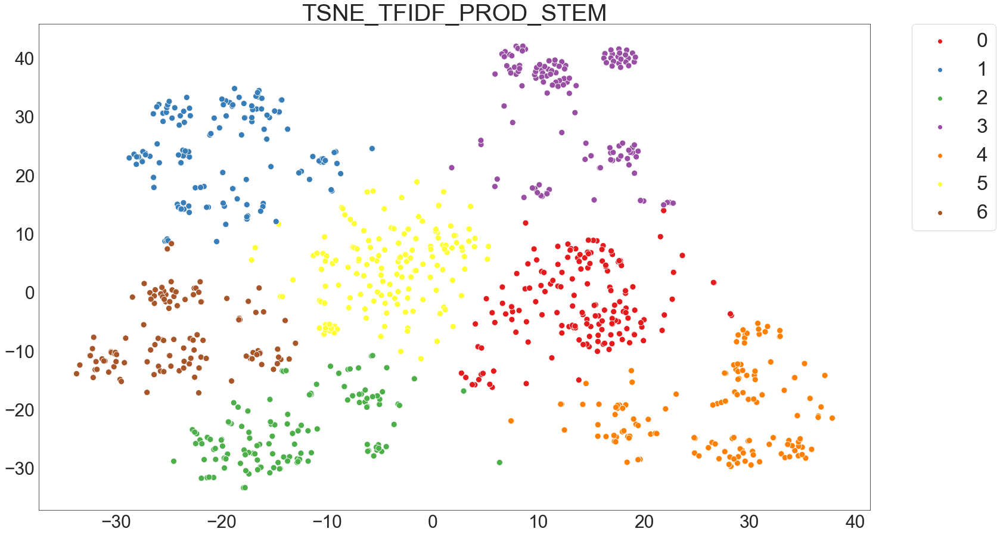

In [383]:
# Visualisation des clusters
outils_nlp.affiche_projection_par_clusters(X_proj_tsne_tfidf_prod_stem,
                                           kmeans_tsne_tfidf_prod_stem_labels,
                                           type_donnee)

**Bilan** :
***
- Le score ARI est assez haut (0.6).
- Les 7 catégories sont bien trouvées avec cependant quelques mélanges :
    - Cluster 0 : Watches
    - Cluster 1 : Beauty and Personal Care
    - Cluster 2 : Baby Care
    - Cluster 3 : Kitchen & Dining
    - Cluster 4 : Computers
    - Cluster 5 : Home Decor & Festive Needs
    - Cluster 6 : Home Furnishing
- Cette combinaison TSNE TfidfVectorizer + produit spécification stemmatisé parvient à retrouver les 7 catégories comme le souhaite notre client. Il reste à mesurer la qualité de cette catégorisation (77,5%).

**Qualité de la catégorisation ?**

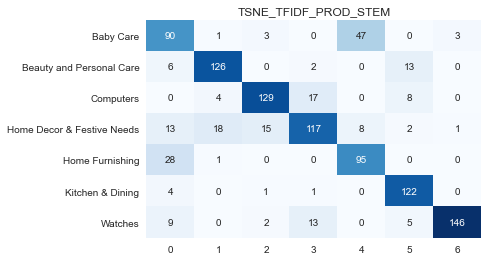

'Précision: 78.57%'

                            precision    recall  f1-score   support

                 Baby Care       0.60      0.62      0.61       144
  Beauty and Personal Care       0.84      0.86      0.85       147
                 Computers       0.86      0.82      0.84       158
Home Decor & Festive Needs       0.78      0.67      0.72       174
           Home Furnishing       0.63      0.77      0.69       124
          Kitchen & Dining       0.81      0.95      0.88       128
                   Watches       0.97      0.83      0.90       175

                  accuracy                           0.79      1050
                 macro avg       0.79      0.79      0.78      1050
              weighted avg       0.79      0.79      0.79      1050


In [384]:
dico_categories = {'0': 'Watches',
                   '1': 'Beauty and Personal Care',
                   '2': 'Baby Care',
                   '3': 'Kitchen & Dining',
                   '4': 'Computers',
                   '5': 'Home Decor & Festive Needs',
                   '6': 'Home Furnishing'}
outils_nlp.affiche_qualite_categorisation(df_tsne_tfidf_prod_stem,
                                          dico_categories, type_donnee)

In [385]:
# Sauvegarde des précisions de la catégorisation
df_precision = outils_nlp.sauvegarde_precision(df_precision, '78.5',
                                               type_donnee)
# Sauvegarde des dataframes de trace
outils_data.to_csv(df_precision, 'data_df_precision.csv')

### <span style='background:PowderBlue'>6.6. TSNE BOW HashingVectorizer</span>

**description** - lemmatisée
***

**Recherche des meilleurs hyperparamètres**

In [386]:
type_donnee = 'TSNE_HASH_DESC_LEM'

In [387]:
# Tuning hyperparametres n_init, max_iter
# Paramètres à tester
n_init = [10, 20, 30, 50, 70, 80, 100]
max_iter = [100, 200, 300, 400, 500]
# Métriques avec les différentes combinaisons des paramètres
df_metrics_kmeans = \
    outils_nlp.calcul_metrics_kmeans(df_tsne_hash_desc_lem[cols],
                                     df_metrics_kmeans,
                                     type_donnee,
                                     seed, n_init, max_iter)
# Tri par indice de dispersion : proche de 0
df_metrics_kmeans[df_metrics_kmeans['Type_données'] == type_donnee] \
    .sort_values(by=['coef_silh', 'davies_bouldin', 'Durée (s)'],
                 ascending=[False, True, True]).style.hide_index()

Type_données,n_init,max_iter,coef_silh,dispersion,davies_bouldin,Durée (s)
TSNE_HASH_DESC_LEM,10,300,0.44853,126093.99219,0.72024,0.05054
TSNE_HASH_DESC_LEM,10,500,0.44853,126093.99219,0.72024,0.05337
TSNE_HASH_DESC_LEM,10,400,0.44853,126094.00000,0.72024,0.05687
TSNE_HASH_DESC_LEM,10,200,0.44853,126094.00000,0.72024,0.06582
TSNE_HASH_DESC_LEM,10,100,0.44853,126093.99219,0.72024,0.06683
TSNE_HASH_DESC_LEM,20,200,0.44837,126091.39062,0.72201,0.12304
TSNE_HASH_DESC_LEM,20,400,0.44837,126091.37500,0.72201,0.12804
TSNE_HASH_DESC_LEM,20,100,0.44837,126091.37500,0.72201,0.13065
TSNE_HASH_DESC_LEM,20,300,0.44837,126091.39062,0.72201,0.14081
TSNE_HASH_DESC_LEM,20,500,0.44837,126091.39062,0.72201,0.14248


In [388]:
# Sauvegarde des dataframes de trace
outils_data.to_csv(df_metrics_kmeans, 'data_df_metrics_kmeans.csv')

**Clustering**

In [389]:
# Instanciation du modèle KMeans avec les meilleurs paramètres
kmeans_tsne_hash_desc_lem = KMeans(n_clusters=7, init='k-means++',
                                   n_init=10, max_iter=300,
                                   random_state=seed) \
    .fit(df_tsne_hash_desc_lem[cols])
# Ajout de l'assignation du cluster au dataframe
df_tsne_hash_desc_lem['Clusters'] = kmeans_tsne_hash_desc_lem.labels_
kmeans_tsne_hash_desc_lem_labels = kmeans_tsne_hash_desc_lem.labels_

In [390]:
# Scores ?
df_scores = outils_nlp.calcul_metriques_clusters(df_tsne_hash_desc_lem,
                                                 df_scores,
                                                 type_donnee)
df_scores.style.hide_index()

Type_données,ARI,Homogénéité,Complétude,V-measure
ACP_CV_DESC_LEM,0.03894,0.11797,0.20952,0.15095
ACP_CV_DESC_STEM,0.04503,0.11941,0.19802,0.14898
ACP_CV_PROD_LEM,0.10551,0.26012,0.58404,0.35994
ACP_CV_PROD_STEM,0.10015,0.25417,0.57940,0.35334
ACP_TFIDF_DESC_LEM,0.14925,0.34720,0.53091,0.41984
ACP_TFIDF_DESC_STEM,0.14698,0.34728,0.52762,0.41886
ACP_TFIDF_PROD_LEM,0.20215,0.37890,0.48553,0.42564
ACP_TFIDF_PROD_STEM,0.21837,0.39724,0.50516,0.44475
ACP_HASH_DESC_LEM,0.03915,0.11095,0.19437,0.14126
ACP_HASH_DESC_STEM,0.04546,0.11990,0.20162,0.15037


In [391]:
# Sauvegarde des dataframes de trace
outils_data.to_csv(df_scores, 'data_df_scores.csv')

Clusters,Nombre,%
0,253,24.10000
1,167,15.90000
2,195,18.57000
3,165,15.71000
4,147,14.00000
5,118,11.24000
6,5,0.48000


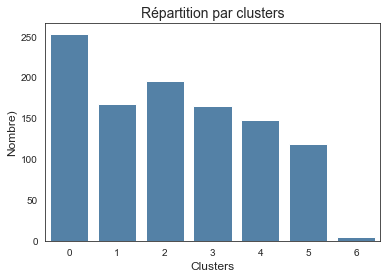

In [392]:
outils_nlp.affiche_repartition_par_clusters(kmeans_tsne_hash_desc_lem_labels)

In [393]:
# Les catégories par clusters
df_tsne_hash_desc_lem.groupby('Clusters')['CATEGORIE'].value_counts() \
    .to_frame()

CATEGORIE
Clusters CATEGORIE                            
0        Computers                         105
         Beauty and Personal Care           36
         Home Furnishing                    33
         Baby Care                          30
         Home Decor & Festive Needs         26
         Kitchen & Dining                   22
         Watches                             1
1        Watches                           149
         Computers                          13
         Home Decor & Festive Needs          4
         Baby Care                           1
2        Baby Care                         100
         Home Furnishing                    80
         Home Decor & Festive Needs          8
         Beauty and Personal Care            4
         Kitchen & Dining                    2
         Computers                           1
3        Home Decor & Festive Needs         94
         Home Furnishing                    32
         Kitchen & Dining                   20
         Beauty and Personal Care           13
         Baby Care                           3
         Computers                           3
4        Beauty and Personal Care           96
         Baby Care                          14
         Computers                          14
         Kitchen & Dining                   12
         Home Decor & Festive Needs          6
         Home Furnishing                     5
5        Kitchen & Dining                   93
         Computers                          14
         Home Decor & Festive Needs         10
         Baby Care                           1
6        Home Decor & Festive Needs          2
         Baby Care                           1
         Beauty and Personal Care            1
         Kitchen & Dining                    1

**Visualisation des clusters**

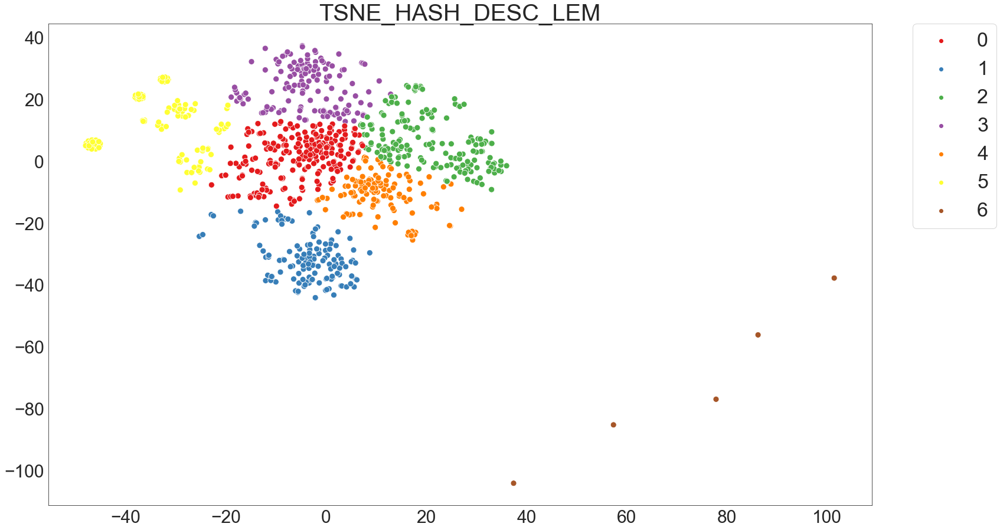

In [394]:
# Visualisation des clusters
outils_nlp.affiche_projection_par_clusters(X_proj_tsne_hash_desc_lem,
                                           kmeans_tsne_hash_desc_lem_labels,
                                           type_donnee)

In [395]:
# Sauvegarde des précisions de la catégorisation
df_precision = outils_nlp.sauvegarde_precision(df_precision, '0',
                                               type_donnee)
# Sauvegarde des dataframes de trace
outils_data.to_csv(df_precision, 'data_df_precision.csv')

**Bilan** :
***
- Le score ARI est encore plus grand qu'avec les données description mais moins bonne qu'avec les données lemmatisées.
- Cette combinaison TSNE HashingVectorizer + description lemmatisée ne parvient pas à retrouver les 7 catégories comme le souhaite notre client.

**description** - stemmatisée
***

**Recherche des meilleurs hyperparamètres**

In [396]:
type_donnee = 'TSNE_HASH_DESC_STEM'

In [397]:
# Tuning hyperparametres n_init, max_iter
# Paramètres à tester
n_init = [10, 20, 30, 50, 70, 80, 100]
max_iter = [100, 200, 300, 400, 500]
# Métriques avec les différentes combinaisons des paramètres
df_metrics_kmeans = \
    outils_nlp.calcul_metrics_kmeans(df_tsne_hash_desc_stem[cols],
                                     df_metrics_kmeans,
                                     type_donnee,
                                     seed, n_init, max_iter)
# Tri par indice de dispersion : proche de 0
df_metrics_kmeans[df_metrics_kmeans['Type_données'] == type_donnee] \
    .sort_values(by=['coef_silh', 'davies_bouldin', 'Durée (s)'],
                 ascending=[False, True, True]).style.hide_index()

Type_données,n_init,max_iter,coef_silh,dispersion,davies_bouldin,Durée (s)
TSNE_HASH_DESC_STEM,20,400,0.41197,114899.44531,0.77433,0.12237
TSNE_HASH_DESC_STEM,20,200,0.41197,114899.46094,0.77433,0.12287
TSNE_HASH_DESC_STEM,20,300,0.41197,114899.44531,0.77433,0.13148
TSNE_HASH_DESC_STEM,20,100,0.41197,114899.44531,0.77433,0.13165
TSNE_HASH_DESC_STEM,20,500,0.41197,114899.45312,0.77433,0.14304
TSNE_HASH_DESC_STEM,30,200,0.41197,114899.44531,0.77433,0.17497
TSNE_HASH_DESC_STEM,30,100,0.41197,114899.44531,0.77433,0.18413
TSNE_HASH_DESC_STEM,30,400,0.41197,114899.44531,0.77433,0.18949
TSNE_HASH_DESC_STEM,30,500,0.41197,114899.44531,0.77433,0.18962
TSNE_HASH_DESC_STEM,30,300,0.41197,114899.44531,0.77433,0.19689


In [398]:
# Sauvegarde des dataframes de trace
outils_data.to_csv(df_metrics_kmeans, 'data_df_metrics_kmeans.csv')

**Clustering**

In [399]:
# Instanciation du modèle KMeans avec les meilleurs paramètres
kmeans_tsne_hash_desc_stem = KMeans(n_clusters=7, init='k-means++',
                                    n_init=20, max_iter=400,
                                    random_state=seed) \
    .fit(df_tsne_hash_desc_stem[cols])
# Ajout de l'assignation du cluster au dataframe
df_tsne_hash_desc_stem['Clusters'] = kmeans_tsne_hash_desc_stem.labels_
kmeans_tsne_hash_desc_stem_labels = kmeans_tsne_hash_desc_stem.labels_

In [400]:
# Scores ?
df_scores = outils_nlp.calcul_metriques_clusters(df_tsne_hash_desc_stem,
                                                 df_scores,
                                                 type_donnee)
df_scores.style.hide_index()

Type_données,ARI,Homogénéité,Complétude,V-measure
ACP_CV_DESC_LEM,0.03894,0.11797,0.20952,0.15095
ACP_CV_DESC_STEM,0.04503,0.11941,0.19802,0.14898
ACP_CV_PROD_LEM,0.10551,0.26012,0.58404,0.35994
ACP_CV_PROD_STEM,0.10015,0.25417,0.57940,0.35334
ACP_TFIDF_DESC_LEM,0.14925,0.34720,0.53091,0.41984
ACP_TFIDF_DESC_STEM,0.14698,0.34728,0.52762,0.41886
ACP_TFIDF_PROD_LEM,0.20215,0.37890,0.48553,0.42564
ACP_TFIDF_PROD_STEM,0.21837,0.39724,0.50516,0.44475
ACP_HASH_DESC_LEM,0.03915,0.11095,0.19437,0.14126
ACP_HASH_DESC_STEM,0.04546,0.11990,0.20162,0.15037


In [401]:
# Sauvegarde des dataframes de trace
outils_data.to_csv(df_scores, 'data_df_scores.csv')

Clusters,Nombre,%
0,145,13.81000
1,219,20.86000
2,158,15.05000
3,89,8.48000
4,153,14.57000
5,117,11.14000
6,169,16.10000


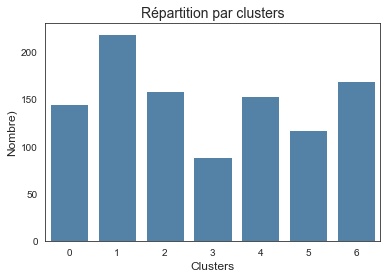

In [402]:
outils_nlp.affiche_repartition_par_clusters(kmeans_tsne_hash_desc_stem_labels)

In [403]:
# Les catégories par clusters
df_tsne_hash_desc_stem.groupby('Clusters')['CATEGORIE'].value_counts(). \
    to_frame()

CATEGORIE
Clusters CATEGORIE                            
0        Watches                           136
         Beauty and Personal Care            8
         Kitchen & Dining                    1
1        Home Furnishing                    86
         Computers                          49
         Home Decor & Festive Needs         28
         Kitchen & Dining                   25
         Baby Care                          20
         Beauty and Personal Care           10
         Watches                             1
2        Computers                          71
         Kitchen & Dining                   38
         Beauty and Personal Care           37
         Home Decor & Festive Needs         11
         Baby Care                           1
3        Kitchen & Dining                   74
         Baby Care                          12
         Home Decor & Festive Needs          2
         Computers                           1
4        Baby Care                         102
         Home Furnishing                    41
         Beauty and Personal Care            5
         Home Decor & Festive Needs          3
         Kitchen & Dining                    2
5        Home Decor & Festive Needs         99
         Home Furnishing                    15
         Baby Care                           1
         Beauty and Personal Care            1
         Kitchen & Dining                    1
6        Beauty and Personal Care           89
         Computers                          29
         Baby Care                          14
         Watches                            13
         Kitchen & Dining                    9
         Home Furnishing                     8
         Home Decor & Festive Needs          7

**Visualisation des clusters**

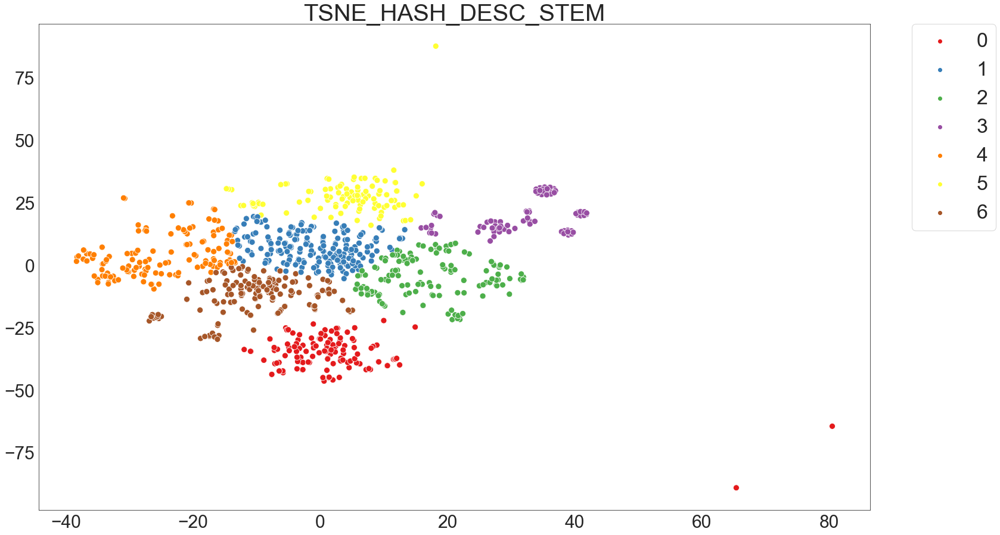

In [404]:
# Visualisation des clusters
outils_nlp.affiche_projection_par_clusters(X_proj_tsne_hash_desc_stem,
                                           kmeans_tsne_hash_desc_stem_labels,
                                           type_donnee)

**Bilan** :
***
- Le score ARI est moyen.
- Les 7 catégories sont bien trouvées avec cependant quelques mélanges :
    - Cluster 0 : Watches
    - Cluster 1 : Home Furnishing
    - Cluster 2 : Computers
    - Cluster 3 : Baby Care
    - Cluster 4 : Home Furnishing
    - Cluster 5 : Home Decor & Festive Needs
    - Cluster 6 : Beauty and Personal Care
- Cette combinaison TSNE HashingVectorizer + description stemmatisée parvient à retrouver les 7 catégories comme le souhaite notre client. Il reste à mesurer la qualité de cette catégorisation (63%).

**Qualité de la catégorisation ?**

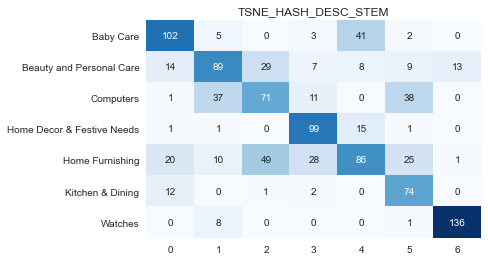

'Précision: 62.57%'

                            precision    recall  f1-score   support

                 Baby Care       0.68      0.67      0.67       153
  Beauty and Personal Care       0.59      0.53      0.56       169
                 Computers       0.47      0.45      0.46       158
Home Decor & Festive Needs       0.66      0.85      0.74       117
           Home Furnishing       0.57      0.39      0.47       219
          Kitchen & Dining       0.49      0.83      0.62        89
                   Watches       0.91      0.94      0.92       145

                  accuracy                           0.63      1050
                 macro avg       0.63      0.66      0.63      1050
              weighted avg       0.63      0.63      0.62      1050


In [405]:
dico_categories = {'0': 'Watches',
                   '1': 'Home Furnishing',
                   '2': 'Computers',
                   '3': 'Kitchen & Dining',
                   '4': 'Baby Care',
                   '5': 'Home Decor & Festive Needs',
                   '6': 'Beauty and Personal Care'}
outils_nlp.affiche_qualite_categorisation(df_tsne_hash_desc_stem,
                                          dico_categories, type_donnee)

In [406]:
# Sauvegarde des précisions de la catégorisation
df_precision = outils_nlp.sauvegarde_precision(df_precision, '63',
                                               type_donnee)
# Sauvegarde des dataframes de trace
outils_data.to_csv(df_precision, 'data_df_precision.csv')

**produit_specification** - lemmatisée
***

**Recherche des meilleurs hyperparamètres**

In [407]:
type_donnee = 'TSNE_HASH_PROD_LEM'

In [408]:
# Tuning hyperparametres n_init, max_iter
# Paramètres à tester
n_init = [10, 20, 30, 50, 70, 80, 100]
max_iter = [100, 200, 300, 400, 500]
# Métriques avec les différentes combinaisons des paramètres
df_metrics_kmeans = \
    outils_nlp.calcul_metrics_kmeans(df_tsne_hash_prod_lem[cols],
                                     df_metrics_kmeans,
                                     type_donnee,
                                     seed, n_init, max_iter)
# Tri par indice de dispersion : proche de 0
df_metrics_kmeans[df_metrics_kmeans['Type_données'] == type_donnee] \
    .sort_values(by=['coef_silh', 'davies_bouldin', 'Durée (s)'],
                 ascending=[False, True, True]).style.hide_index()

Type_données,n_init,max_iter,coef_silh,dispersion,davies_bouldin,Durée (s)
TSNE_HASH_PROD_LEM,10,300,0.45162,91697.10156,0.73242,0.05386
TSNE_HASH_PROD_LEM,10,400,0.45162,91697.09375,0.73242,0.05485
TSNE_HASH_PROD_LEM,10,500,0.45162,91697.10156,0.73242,0.05485
TSNE_HASH_PROD_LEM,10,200,0.45162,91697.10156,0.73242,0.05784
TSNE_HASH_PROD_LEM,10,100,0.45162,91697.10156,0.73242,0.06084
TSNE_HASH_PROD_LEM,20,400,0.45162,91697.10156,0.73242,0.10173
TSNE_HASH_PROD_LEM,20,200,0.45162,91697.10938,0.73242,0.10273
TSNE_HASH_PROD_LEM,20,300,0.45162,91697.10156,0.73242,0.10372
TSNE_HASH_PROD_LEM,20,500,0.45162,91697.10156,0.73242,0.10572
TSNE_HASH_PROD_LEM,20,100,0.45162,91697.09375,0.73242,0.10572


In [409]:
# Sauvegarde des dataframes de trace
outils_data.to_csv(df_metrics_kmeans, 'data_df_metrics_kmeans.csv')

**Clustering**

In [410]:
# Instanciation du modèle KMeans avec les meilleurs paramètres
kmeans_tsne_hash_prod_lem = KMeans(n_clusters=7, init='k-means++',
                                   n_init=10, max_iter=300,
                                   random_state=seed) \
    .fit(df_tsne_hash_prod_lem[cols])
# Ajout de l'assignation du cluster au dataframe
df_tsne_hash_prod_lem['Clusters'] = kmeans_tsne_hash_prod_lem.labels_
kmeans_tsne_hash_prod_lem_labels = kmeans_tsne_hash_prod_lem.labels_

In [411]:
# Scores ?
df_scores = outils_nlp.calcul_metriques_clusters(df_tsne_hash_prod_lem,
                                                 df_scores,
                                                 type_donnee)
df_scores.style.hide_index()

Type_données,ARI,Homogénéité,Complétude,V-measure
ACP_CV_DESC_LEM,0.03894,0.11797,0.20952,0.15095
ACP_CV_DESC_STEM,0.04503,0.11941,0.19802,0.14898
ACP_CV_PROD_LEM,0.10551,0.26012,0.58404,0.35994
ACP_CV_PROD_STEM,0.10015,0.25417,0.57940,0.35334
ACP_TFIDF_DESC_LEM,0.14925,0.34720,0.53091,0.41984
ACP_TFIDF_DESC_STEM,0.14698,0.34728,0.52762,0.41886
ACP_TFIDF_PROD_LEM,0.20215,0.37890,0.48553,0.42564
ACP_TFIDF_PROD_STEM,0.21837,0.39724,0.50516,0.44475
ACP_HASH_DESC_LEM,0.03915,0.11095,0.19437,0.14126
ACP_HASH_DESC_STEM,0.04546,0.11990,0.20162,0.15037


In [412]:
# Sauvegarde des dataframes de trace
outils_data.to_csv(df_scores, 'data_df_scores.csv')

Clusters,Nombre,%
0,146,13.90000
1,140,13.33000
2,136,12.95000
3,75,7.14000
4,143,13.62000
5,129,12.29000
6,281,26.76000


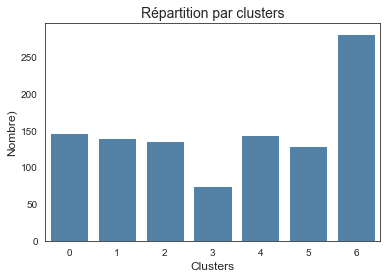

In [413]:
outils_nlp.affiche_repartition_par_clusters(kmeans_tsne_hash_prod_lem_labels)

In [414]:
# Les catégories par clusters
df_tsne_hash_prod_lem.groupby('Clusters')['CATEGORIE'].value_counts(). \
    to_frame()

CATEGORIE
Clusters CATEGORIE                            
0        Beauty and Personal Care          105
         Kitchen & Dining                   33
         Computers                           7
         Baby Care                           1
1        Watches                           140
2        Home Furnishing                    98
         Baby Care                          25
         Kitchen & Dining                   10
         Computers                           3
3        Kitchen & Dining                   74
         Baby Care                           1
4        Computers                         120
         Home Decor & Festive Needs         12
         Kitchen & Dining                    7
         Baby Care                           3
         Beauty and Personal Care            1
5        Baby Care                          93
         Home Furnishing                    36
6        Home Decor & Festive Needs        138
         Beauty and Personal Care           44
         Baby Care                          27
         Kitchen & Dining                   26
         Computers                          20
         Home Furnishing                    16
         Watches                            10

**Visualisation des clusters**

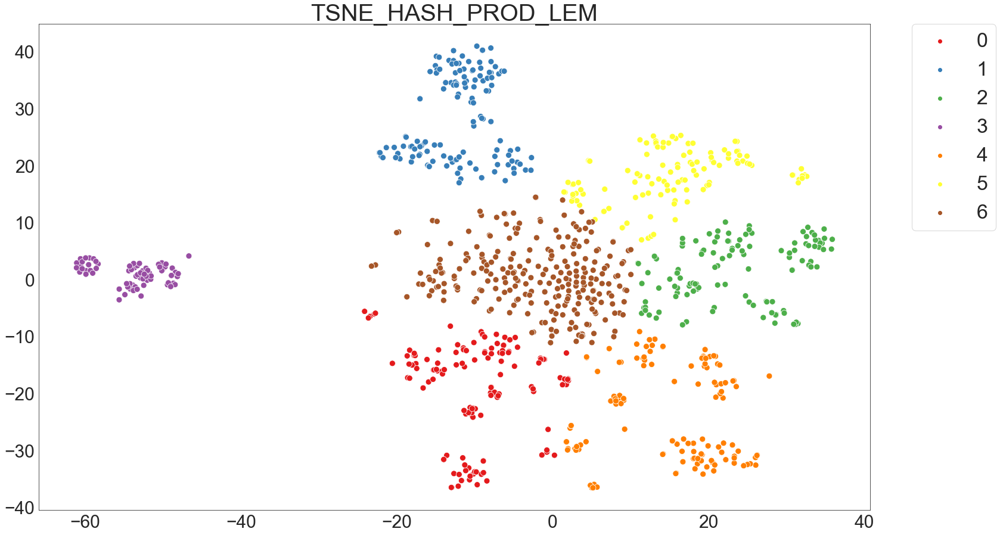

In [415]:
# Visualisation des clusters
outils_nlp.affiche_projection_par_clusters(X_proj_tsne_hash_prod_lem,
                                           kmeans_tsne_hash_prod_lem_labels,
                                           type_donnee)

**Bilan** :
***
- Le score ARI est assez haut (0.46).
- Les 7 catégories sont bien trouvées avec cependant quelques mélanges :
    - Cluster 0 : Beauty and Personal Care
    - Cluster 1 : Watches
    - Cluster 2 : Home Furnishing
    - Cluster 3 : Kitchen & Dining
    - Cluster 4 : Computers
    - Cluster 5 : Baby Care
    - Cluster 6 : Home Decor & Festive Needs
- Cette combinaison TSNE TfidfVectorizer + produit spécification lemmatisé parvient à retrouver les 7 catégories comme le souhaite notre client. Il reste à mesurer la qualité de cette catégorisation (71%).

**Qualité de la catégorisation ?**

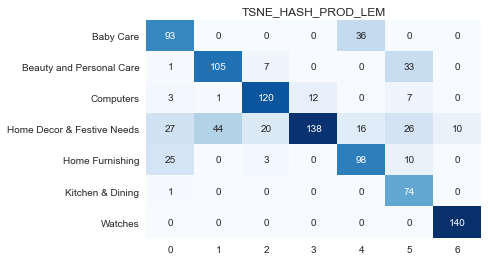

'Précision: 73.14%'

                            precision    recall  f1-score   support

                 Baby Care       0.62      0.72      0.67       129
  Beauty and Personal Care       0.70      0.72      0.71       146
                 Computers       0.80      0.84      0.82       143
Home Decor & Festive Needs       0.92      0.49      0.64       281
           Home Furnishing       0.65      0.72      0.69       136
          Kitchen & Dining       0.49      0.99      0.66        75
                   Watches       0.93      1.00      0.97       140

                  accuracy                           0.73      1050
                 macro avg       0.73      0.78      0.73      1050
              weighted avg       0.77      0.73      0.73      1050


In [416]:
dico_categories = {'0': 'Beauty and Personal Care',
                   '1': 'Watches',
                   '2': 'Home Furnishing',
                   '3': 'Kitchen & Dining',
                   '4': 'Computers',
                   '5': 'Baby Care',
                   '6': 'Home Decor & Festive Needs'}
outils_nlp.affiche_qualite_categorisation(df_tsne_hash_prod_lem,
                                          dico_categories, type_donnee)

In [417]:
# Sauvegarde des précisions de la catégorisation
df_precision = outils_nlp.sauvegarde_precision(df_precision, '73',
                                               type_donnee)
# Sauvegarde des dataframes de trace
outils_data.to_csv(df_precision, 'data_df_precision.csv')

**produit_specification** - stemmatisée
***

**Recherche des meilleurs hyperparamètres**

In [418]:
type_donnee = 'TSNE_HASH_PROD_STEM'

In [419]:
# Tuning hyperparametres n_init, max_iter
# Paramètres à tester
n_init = [10, 20, 30, 50, 70, 80, 100]
max_iter = [100, 200, 300, 400, 500]
# Métriques avec les différentes combinaisons des paramètres
df_metrics_kmeans = \
    outils_nlp.calcul_metrics_kmeans(df_tsne_hash_prod_stem[cols],
                                     df_metrics_kmeans,
                                     type_donnee,
                                     seed, n_init, max_iter)
# Tri par indice de dispersion : proche de 0
df_metrics_kmeans[df_metrics_kmeans['Type_données'] == type_donnee] \
    .sort_values(by=['coef_silh', 'davies_bouldin', 'Durée (s)'],
                 ascending=[False, True, True]).style.hide_index()

Type_données,n_init,max_iter,coef_silh,dispersion,davies_bouldin,Durée (s)
TSNE_HASH_PROD_STEM,100,300,0.44851,89778.70312,0.72484,0.53240
TSNE_HASH_PROD_STEM,100,100,0.44851,89778.71094,0.72484,0.53841
TSNE_HASH_PROD_STEM,100,200,0.44851,89778.71094,0.72484,0.53855
TSNE_HASH_PROD_STEM,100,400,0.44851,89778.70312,0.72484,0.53857
TSNE_HASH_PROD_STEM,100,500,0.44851,89778.71094,0.72484,0.53858
TSNE_HASH_PROD_STEM,20,300,0.44847,89780.00781,0.72511,0.11585
TSNE_HASH_PROD_STEM,20,400,0.44847,89780.02344,0.72511,0.11589
TSNE_HASH_PROD_STEM,20,200,0.44847,89780.00781,0.72511,0.11892
TSNE_HASH_PROD_STEM,20,500,0.44847,89780.01562,0.72511,0.12193
TSNE_HASH_PROD_STEM,20,100,0.44847,89780.00781,0.72511,0.14262


In [420]:
# Sauvegarde des dataframes de trace
outils_data.to_csv(df_metrics_kmeans, 'data_df_metrics_kmeans.csv')

**Clustering**

In [421]:
# Instanciation du modèle KMeans avec les meilleurs paramètres
kmeans_tsne_hash_prod_stem = KMeans(n_clusters=7, init='k-means++',
                                    n_init=100, max_iter=300,
                                    random_state=seed) \
    .fit(df_tsne_hash_prod_stem[cols])
# Ajout de l'assignation du cluster au dataframe
df_tsne_hash_prod_stem['Clusters'] = kmeans_tsne_hash_prod_stem.labels_
kmeans_tsne_hash_prod_stem_labels = kmeans_tsne_hash_prod_stem.labels_

In [422]:
# Scores ?
df_scores = outils_nlp.calcul_metriques_clusters(df_tsne_hash_prod_stem,
                                                 df_scores,
                                                 type_donnee)
df_scores.style.hide_index()

Type_données,ARI,Homogénéité,Complétude,V-measure
ACP_CV_DESC_LEM,0.03894,0.11797,0.20952,0.15095
ACP_CV_DESC_STEM,0.04503,0.11941,0.19802,0.14898
ACP_CV_PROD_LEM,0.10551,0.26012,0.58404,0.35994
ACP_CV_PROD_STEM,0.10015,0.25417,0.57940,0.35334
ACP_TFIDF_DESC_LEM,0.14925,0.34720,0.53091,0.41984
ACP_TFIDF_DESC_STEM,0.14698,0.34728,0.52762,0.41886
ACP_TFIDF_PROD_LEM,0.20215,0.37890,0.48553,0.42564
ACP_TFIDF_PROD_STEM,0.21837,0.39724,0.50516,0.44475
ACP_HASH_DESC_LEM,0.03915,0.11095,0.19437,0.14126
ACP_HASH_DESC_STEM,0.04546,0.11990,0.20162,0.15037


In [423]:
# Sauvegarde des dataframes de trace
outils_data.to_csv(df_scores, 'data_df_scores.csv')

Clusters,Nombre,%
0,254,24.19000
1,143,13.62000
2,74,7.05000
3,144,13.71000
4,155,14.76000
5,165,15.71000
6,115,10.95000


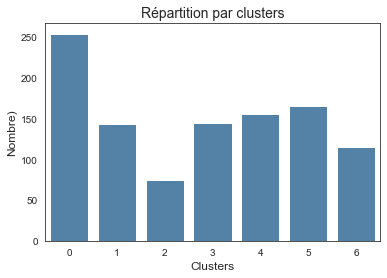

In [424]:
outils_nlp \
    .affiche_repartition_par_clusters(kmeans_tsne_hash_prod_stem_labels)

In [425]:
# Les catégories par clusters
df_tsne_hash_prod_stem.groupby('Clusters')['CATEGORIE'].value_counts() \
    .to_frame()

CATEGORIE
Clusters CATEGORIE                            
0        Home Decor & Festive Needs        100
         Beauty and Personal Care           43
         Kitchen & Dining                   34
         Baby Care                          31
         Home Furnishing                    19
         Computers                          17
         Watches                            10
1        Computers                         120
         Home Decor & Festive Needs         16
         Kitchen & Dining                    7
2        Kitchen & Dining                   74
3        Watches                           140
         Home Decor & Festive Needs          4
4        Baby Care                         107
         Home Furnishing                    43
         Home Decor & Festive Needs          5
5        Beauty and Personal Care          107
         Kitchen & Dining                   35
         Home Decor & Festive Needs         19
         Baby Care                           2
         Computers                           2
6        Home Furnishing                    88
         Computers                          11
         Baby Care                          10
         Home Decor & Festive Needs          6

**Visualisation des clusters**

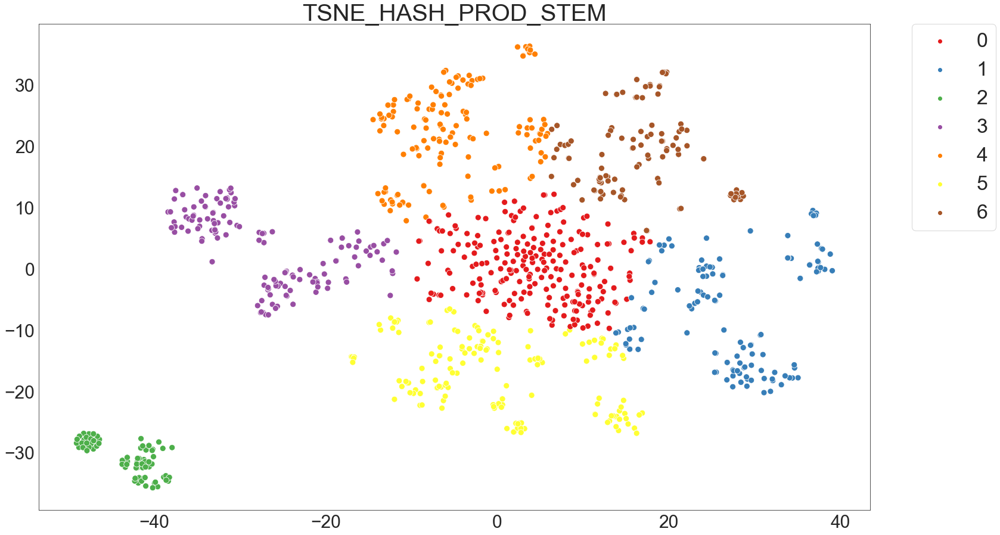

In [426]:
# Visualisation des clusters
outils_nlp.affiche_projection_par_clusters(X_proj_tsne_hash_prod_stem,
                                           kmeans_tsne_hash_prod_stem_labels,
                                           type_donnee)

**Bilan** :
***
- Le score ARI est assez haut (0.44).
- Les 7 catégories sont bien trouvées avec cependant quelques mélanges :
    - Cluster 0 : Home Decor & Festive Needs
    - Cluster 1 : Computers
    - Cluster 2 : Kitchen & Dining
    - Cluster 3 : Watches
    - Cluster 4 : Baby Care
    - Cluster 5 : Beauty and Personal Care
    - Cluster 6 : Home Furnishing
- Cette combinaison TSNE TfidfVectorizer + produit spécification stemmatisé parvient à retrouver les 7 catégories comme le souhaite notre client. Il reste à mesurer la qualité de cette catégorisation (72%).

**Qualité de la catégorisation ?**

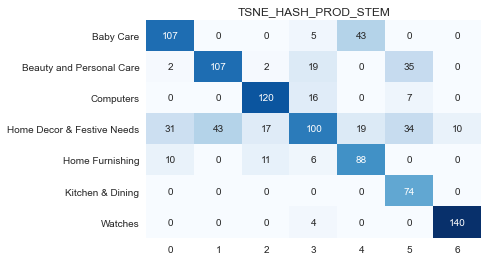

'Précision: 70.1%'

                            precision    recall  f1-score   support

                 Baby Care       0.71      0.69      0.70       155
  Beauty and Personal Care       0.71      0.65      0.68       165
                 Computers       0.80      0.84      0.82       143
Home Decor & Festive Needs       0.67      0.39      0.50       254
           Home Furnishing       0.59      0.77      0.66       115
          Kitchen & Dining       0.49      1.00      0.66        74
                   Watches       0.93      0.97      0.95       144

                  accuracy                           0.70      1050
                 macro avg       0.70      0.76      0.71      1050
              weighted avg       0.71      0.70      0.69      1050


In [427]:
dico_categories = {'0': 'Home Decor & Festive Needs',
                   '1': 'Computers',
                   '2': 'Kitchen & Dining',
                   '3': 'Watches',
                   '4': 'Baby Care',
                   '5': 'Beauty and Personal Care',
                   '6': 'Home Furnishing'}
outils_nlp.affiche_qualite_categorisation(df_tsne_hash_prod_stem,
                                          dico_categories, type_donnee)

In [428]:
# Sauvegarde des précisions de la catégorisation
df_precision = outils_nlp.sauvegarde_precision(df_precision, '70',
                                               type_donnee)
# Sauvegarde des dataframes de trace
outils_data.to_csv(df_precision, 'data_df_precision.csv')

### <span style='background:PowderBlue'>6.7. TSNE Word2Vec</span>

**description** - lemmatisée
***

**Recherche des meilleurs hyperparamètres**

In [478]:
type_donnee = 'TSNE_W2V_DESC_LEM'

In [479]:
# Tuning hyperparametres n_init, max_iter
# Paramètres à tester
n_init = [10, 20, 30, 50, 70, 80, 100]
max_iter = [100, 200, 300, 400, 500]
# Métriques avec les différentes combinaisons des paramètres
df_metrics_kmeans = \
    outils_nlp.calcul_metrics_kmeans(df_tsne_w2v_desc_lem[cols],
                                     df_metrics_kmeans,
                                     type_donnee,
                                     seed, n_init, max_iter)
# Tri par indice de dispersion : proche de 0
df_metrics_kmeans[df_metrics_kmeans['Type_données'] == type_donnee] \
    .sort_values(by=['coef_silh', 'davies_bouldin', 'Durée (s)'],
                 ascending=[False, True, True]).style.hide_index()

Type_données,n_init,max_iter,coef_silh,dispersion,davies_bouldin,Durée (s)
TSNE_W2V_DESC_LEM,10,400,0.53877,38772.83594,0.55734,0.04116
TSNE_W2V_DESC_LEM,10,500,0.53877,38772.83594,0.55734,0.04791
TSNE_W2V_DESC_LEM,10,100,0.53877,38772.83594,0.55734,0.05086
TSNE_W2V_DESC_LEM,10,200,0.53877,38772.83594,0.55734,0.05286
TSNE_W2V_DESC_LEM,10,300,0.53877,38772.83594,0.55734,0.05386
TSNE_W2V_DESC_LEM,20,200,0.53877,38772.83594,0.55734,0.09907
TSNE_W2V_DESC_LEM,20,100,0.53877,38772.83594,0.55734,0.09926
TSNE_W2V_DESC_LEM,20,300,0.53877,38772.83594,0.55734,0.10056
TSNE_W2V_DESC_LEM,20,500,0.53877,38772.83594,0.55734,0.10073
TSNE_W2V_DESC_LEM,20,400,0.53877,38772.83594,0.55734,0.10219


In [480]:
# Sauvegarde des dataframes de trace
outils_data.to_csv(df_metrics_kmeans, 'data_df_metrics_kmeans.csv')

**Clustering**

In [481]:
# Instanciation du modèle KMeans avec les meilleurs paramètres
kmeans_tsne_w2v_desc_lem = KMeans(n_clusters=7, init='k-means++',
                                  n_init=10, max_iter=400,
                                  random_state=seed) \
    .fit(df_tsne_w2v_desc_lem[cols])
# Ajout de l'assignation du cluster au dataframe
df_tsne_w2v_desc_lem['Clusters'] = kmeans_tsne_w2v_desc_lem.labels_
kmeans_tsne_w2v_desc_lem_labels = kmeans_tsne_w2v_desc_lem.labels_

In [482]:
# Scores ?
df_scores = outils_nlp.calcul_metriques_clusters(df_tsne_w2v_desc_lem,
                                                 df_scores,
                                                 type_donnee)
df_scores.style.hide_index()

Type_données,ARI,Homogénéité,Complétude,V-measure
ACP_CV_DESC_LEM,0.03894,0.11797,0.20952,0.15095
ACP_CV_DESC_STEM,0.04503,0.11941,0.19802,0.14898
ACP_CV_PROD_LEM,0.10551,0.26012,0.58404,0.35994
ACP_CV_PROD_STEM,0.10015,0.25417,0.57940,0.35334
ACP_TFIDF_DESC_LEM,0.14925,0.34720,0.53091,0.41984
ACP_TFIDF_DESC_STEM,0.14698,0.34728,0.52762,0.41886
ACP_TFIDF_PROD_LEM,0.20215,0.37890,0.48553,0.42564
ACP_TFIDF_PROD_STEM,0.21837,0.39724,0.50516,0.44475
ACP_HASH_DESC_LEM,0.03915,0.11095,0.19437,0.14126
ACP_HASH_DESC_STEM,0.04546,0.11990,0.20162,0.15037


In [483]:
# Sauvegarde des dataframes de trace
outils_data.to_csv(df_scores, 'data_df_scores.csv')

Clusters,Nombre,%
0,128,12.19000
1,138,13.14000
2,151,14.38000
3,237,22.57000
4,34,3.24000
5,125,11.90000
6,237,22.57000


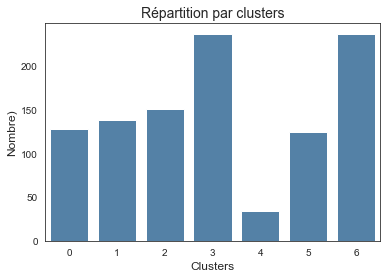

In [484]:
outils_nlp.affiche_repartition_par_clusters(kmeans_tsne_w2v_desc_lem_labels)

In [485]:
# Les catégories par clusters
df_tsne_w2v_desc_lem.groupby('Clusters')['CATEGORIE'].value_counts() \
    .to_frame()

CATEGORIE
Clusters CATEGORIE                            
0        Baby Care                          97
         Home Furnishing                    30
         Beauty and Personal Care            1
1        Kitchen & Dining                   92
         Home Decor & Festive Needs         26
         Home Furnishing                     7
         Computers                           5
         Baby Care                           4
         Beauty and Personal Care            4
2        Watches                           146
         Home Decor & Festive Needs          3
         Beauty and Personal Care            2
3        Beauty and Personal Care           88
         Home Furnishing                    73
         Home Decor & Festive Needs         33
         Baby Care                          26
         Kitchen & Dining                   12
         Computers                           3
         Watches                             2
4        Computers                          32
         Baby Care                           1
         Home Decor & Festive Needs          1
5        Computers                         100
         Kitchen & Dining                   10
         Beauty and Personal Care            7
         Home Decor & Festive Needs          6
         Baby Care                           2
6        Home Decor & Festive Needs         81
         Beauty and Personal Care           48
         Home Furnishing                    40
         Kitchen & Dining                   36
         Baby Care                          20
         Computers                          10
         Watches                             2

**Visualisation des clusters**

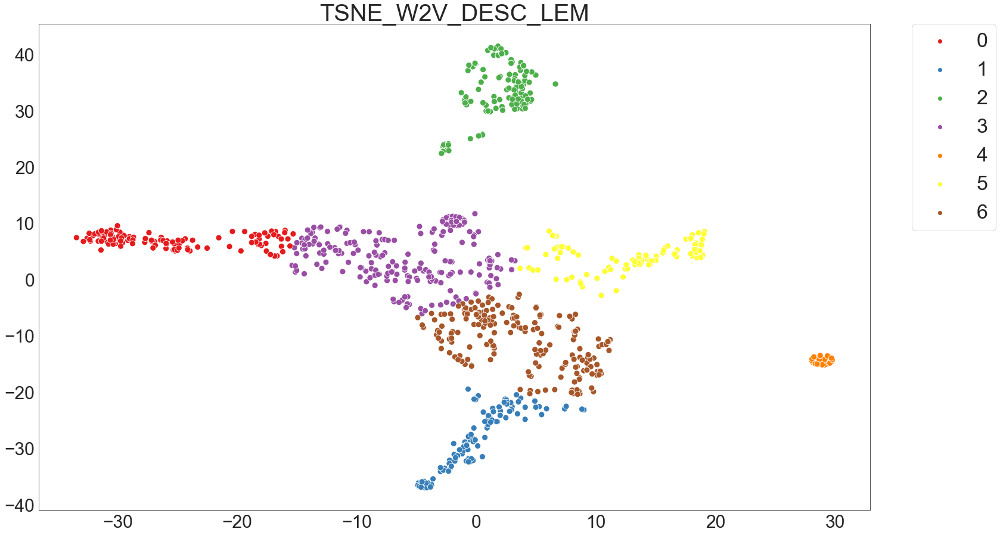

In [486]:
# Visualisation des clusters
outils_nlp.affiche_projection_par_clusters(X_proj_tsne_w2v_desc_lem,
                                           kmeans_tsne_w2v_desc_lem_labels,
                                           type_donnee)

**Bilan** :
***
- Le score ARI est assez faible (0.36).
- Cette combinaison TSNE Word2Vec + description lemmatisée ne parvient pas à retrouver les 7 catégories comme le souhaite notre client.

In [487]:
# Sauvegarde des précisions de la catégorisation
df_precision = outils_nlp.sauvegarde_precision(df_precision, '0',
                                               type_donnee)
# Sauvegarde des dataframes de trace
outils_data.to_csv(df_precision, 'data_df_precision.csv')

**description** - stemmatisée
***

**Recherche des meilleurs hyperparamètres**

In [488]:
type_donnee = 'TSNE_W2V_DESC_STEM'

In [489]:
# Tuning hyperparametres n_init, max_iter
# Paramètres à tester
n_init = [10, 20, 30, 50, 70, 80, 100]
max_iter = [100, 200, 300, 400, 500]
# Métriques avec les différentes combinaisons des paramètres
df_metrics_kmeans = \
    outils_nlp.calcul_metrics_kmeans(df_tsne_w2v_desc_stem[cols],
                                     df_metrics_kmeans,
                                     type_donnee,
                                     seed, n_init, max_iter)
# Tri par indice de dispersion : proche de 0
df_metrics_kmeans[df_metrics_kmeans['Type_données'] == type_donnee] \
    .sort_values(by=['coef_silh', 'davies_bouldin', 'Durée (s)'],
                 ascending=[False, True, True]).style.hide_index()

Type_données,n_init,max_iter,coef_silh,dispersion,davies_bouldin,Durée (s)
TSNE_W2V_DESC_STEM,10,100,0.53743,39845.67578,0.55315,0.05485
TSNE_W2V_DESC_STEM,10,500,0.53743,39845.67188,0.55315,0.05485
TSNE_W2V_DESC_STEM,10,200,0.53743,39845.67188,0.55315,0.05485
TSNE_W2V_DESC_STEM,10,300,0.53743,39845.67578,0.55315,0.05485
TSNE_W2V_DESC_STEM,10,400,0.53743,39845.67188,0.55315,0.05585
TSNE_W2V_DESC_STEM,20,300,0.53743,39845.67578,0.55315,0.10027
TSNE_W2V_DESC_STEM,20,400,0.53743,39845.67578,0.55315,0.10155
TSNE_W2V_DESC_STEM,20,100,0.53743,39845.67188,0.55315,0.10771
TSNE_W2V_DESC_STEM,20,200,0.53743,39845.67578,0.55315,0.10792
TSNE_W2V_DESC_STEM,20,500,0.53743,39845.67578,0.55315,0.11897


In [490]:
# Sauvegarde des dataframes de trace
outils_data.to_csv(df_metrics_kmeans, 'data_df_metrics_kmeans.csv')

**Clustering**

In [491]:
# Instanciation du modèle KMeans avec les meilleurs paramètres
kmeans_tsne_w2v_desc_stem = KMeans(n_clusters=7, init='k-means++',
                                   n_init=100, max_iter=100,
                                   random_state=seed) \
    .fit(df_tsne_w2v_desc_stem[cols])
# Ajout de l'assignation du cluster au dataframe
df_tsne_w2v_desc_stem['Clusters'] = kmeans_tsne_w2v_desc_stem.labels_
kmeans_tsne_w2v_desc_stem_labels = kmeans_tsne_w2v_desc_stem.labels_

In [492]:
# Scores ?
df_scores = outils_nlp.calcul_metriques_clusters(df_tsne_w2v_desc_stem,
                                                 df_scores,
                                                 type_donnee)
df_scores.style.hide_index()

Type_données,ARI,Homogénéité,Complétude,V-measure
ACP_CV_DESC_LEM,0.03894,0.11797,0.20952,0.15095
ACP_CV_DESC_STEM,0.04503,0.11941,0.19802,0.14898
ACP_CV_PROD_LEM,0.10551,0.26012,0.58404,0.35994
ACP_CV_PROD_STEM,0.10015,0.25417,0.57940,0.35334
ACP_TFIDF_DESC_LEM,0.14925,0.34720,0.53091,0.41984
ACP_TFIDF_DESC_STEM,0.14698,0.34728,0.52762,0.41886
ACP_TFIDF_PROD_LEM,0.20215,0.37890,0.48553,0.42564
ACP_TFIDF_PROD_STEM,0.21837,0.39724,0.50516,0.44475
ACP_HASH_DESC_LEM,0.03915,0.11095,0.19437,0.14126
ACP_HASH_DESC_STEM,0.04546,0.11990,0.20162,0.15037


In [495]:
# Sauvegarde des dataframes de trace
outils_data.to_csv(df_scores, 'data_df_scores.csv')

Clusters,Nombre,%
0,120,11.43000
1,125,11.90000
2,174,16.57000
3,135,12.86000
4,208,19.81000
5,254,24.19000
6,34,3.24000


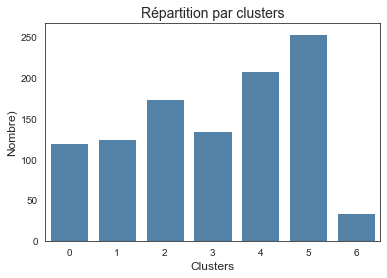

In [496]:
outils_nlp.affiche_repartition_par_clusters(kmeans_tsne_w2v_desc_stem_labels)

In [497]:
# Les catégories par clusters
df_tsne_w2v_desc_stem.groupby('Clusters')['CATEGORIE'].value_counts(). \
    to_frame()

CATEGORIE
Clusters CATEGORIE                            
0        Computers                          99
         Kitchen & Dining                    8
         Beauty and Personal Care            7
         Home Decor & Festive Needs          4
         Baby Care                           2
1        Kitchen & Dining                   85
         Home Decor & Festive Needs         25
         Computers                           5
         Baby Care                           4
         Beauty and Personal Care            4
         Home Furnishing                     2
2        Baby Care                         106
         Home Furnishing                    44
         Beauty and Personal Care            9
         Watches                             9
         Home Decor & Festive Needs          6
3        Watches                           135
4        Home Decor & Festive Needs         77
         Beauty and Personal Care           42
         Kitchen & Dining                   38
         Home Furnishing                    25
         Baby Care                          17
         Computers                           5
         Watches                             4
5        Beauty and Personal Care           88
         Home Furnishing                    79
         Home Decor & Festive Needs         37
         Baby Care                          20
         Kitchen & Dining                   19
         Computers                           9
         Watches                             2
6        Computers                          32
         Baby Care                           1
         Home Decor & Festive Needs          1

**Visualisation des clusters**

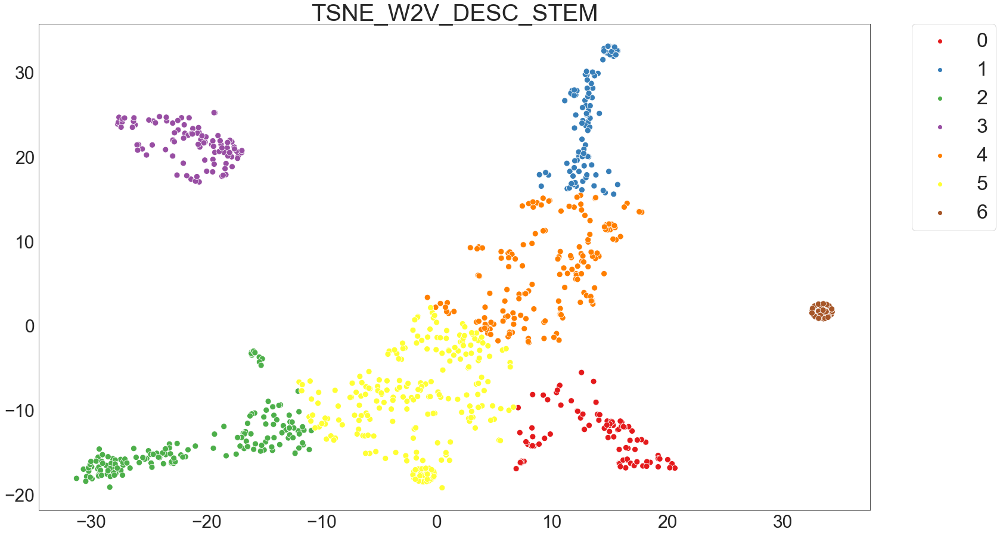

In [498]:
# Visualisation des clusters
outils_nlp.affiche_projection_par_clusters(X_proj_tsne_w2v_desc_stem,
                                           kmeans_tsne_w2v_desc_stem_labels,
                                           type_donnee)

**Bilan** :
***
- Le score ARI est faible (0.36).
- Cette combinaison TSNE Word2Vec + description stemmatisée ne parvient pas à retrouver les 7 catégories comme le souhaite notre client. 

In [499]:
# Sauvegarde des précisions de la catégorisation
df_precision = outils_nlp.sauvegarde_precision(df_precision, '0',
                                               type_donnee)
# Sauvegarde des dataframes de trace
outils_data.to_csv(df_precision, 'data_df_precision.csv')

**produit_specification** - lemmatisée
***

**CBOW**

**Recherche des meilleurs hyperparamètres**

In [500]:
type_donnee = 'TSNE_W2V_PROD_LEM'

In [501]:
# Tuning hyperparametres n_init, max_iter
# Paramètres à tester
n_init = [10, 20, 30, 50, 70, 80, 100]
max_iter = [100, 200, 300, 400, 500]
# Métriques avec les différentes combinaisons des paramètres
df_metrics_kmeans = \
    outils_nlp.calcul_metrics_kmeans(df_tsne_w2v_prod_lem[cols],
                                     df_metrics_kmeans,
                                     type_donnee,
                                     seed, n_init, max_iter)
# Tri par indice de dispersion : proche de 0
df_metrics_kmeans[df_metrics_kmeans['Type_données'] == type_donnee] \
    .sort_values(by=['coef_silh', 'davies_bouldin', 'Durée (s)'],
                 ascending=[False, True, True]).style.hide_index()

Type_données,n_init,max_iter,coef_silh,dispersion,davies_bouldin,Durée (s)
TSNE_W2V_PROD_LEM,30,200,0.65978,29613.70117,0.45806,0.10874
TSNE_W2V_PROD_LEM,50,300,0.65978,29613.70117,0.45806,0.18650
TSNE_W2V_PROD_LEM,50,200,0.65978,29613.70117,0.45806,0.19548
TSNE_W2V_PROD_LEM,70,500,0.65978,29613.70117,0.45806,0.24134
TSNE_W2V_PROD_LEM,70,200,0.65978,29613.70117,0.45806,0.26030
TSNE_W2V_PROD_LEM,70,400,0.65978,29613.70117,0.45806,0.26130
TSNE_W2V_PROD_LEM,70,100,0.65978,29613.70117,0.45806,0.26179
TSNE_W2V_PROD_LEM,70,300,0.65978,29613.70117,0.45806,0.26429
TSNE_W2V_PROD_LEM,80,100,0.65978,29613.70117,0.45806,0.28230
TSNE_W2V_PROD_LEM,80,500,0.65978,29613.70117,0.45806,0.28511


In [502]:
# Sauvegarde des dataframes de trace
outils_data.to_csv(df_metrics_kmeans, 'data_df_metrics_kmeans.csv')

**Clustering**

In [503]:
# Instanciation du modèle KMeans avec les meilleurs paramètres
kmeans_tsne_w2v_prod_lem = KMeans(n_clusters=7, init='k-means++',
                                  n_init=30, max_iter=200,
                                  random_state=seed) \
    .fit(df_tsne_w2v_prod_lem[cols])
# Ajout de l'assignation du cluster au dataframe
df_tsne_w2v_prod_lem['Clusters'] = kmeans_tsne_w2v_prod_lem.labels_
kmeans_tsne_w2v_prod_lem_labels = kmeans_tsne_w2v_prod_lem.labels_

In [504]:
# Scores ?
df_scores = outils_nlp.calcul_metriques_clusters(df_tsne_w2v_prod_lem,
                                                 df_scores,
                                                 type_donnee)
df_scores.style.hide_index()

Type_données,ARI,Homogénéité,Complétude,V-measure
ACP_CV_DESC_LEM,0.03894,0.11797,0.20952,0.15095
ACP_CV_DESC_STEM,0.04503,0.11941,0.19802,0.14898
ACP_CV_PROD_LEM,0.10551,0.26012,0.58404,0.35994
ACP_CV_PROD_STEM,0.10015,0.25417,0.57940,0.35334
ACP_TFIDF_DESC_LEM,0.14925,0.34720,0.53091,0.41984
ACP_TFIDF_DESC_STEM,0.14698,0.34728,0.52762,0.41886
ACP_TFIDF_PROD_LEM,0.20215,0.37890,0.48553,0.42564
ACP_TFIDF_PROD_STEM,0.21837,0.39724,0.50516,0.44475
ACP_HASH_DESC_LEM,0.03915,0.11095,0.19437,0.14126
ACP_HASH_DESC_STEM,0.04546,0.11990,0.20162,0.15037


In [506]:
# Sauvegarde des dataframes de trace
outils_data.to_csv(df_scores, 'data_df_scores.csv')

Clusters,Nombre,%
0,163,15.52000
1,170,16.19000
2,122,11.62000
3,84,8.00000
4,128,12.19000
5,239,22.76000
6,144,13.71000


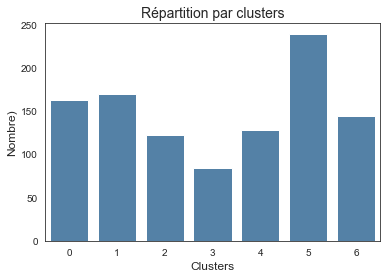

In [507]:
outils_nlp.affiche_repartition_par_clusters(kmeans_tsne_w2v_prod_lem_labels)

In [508]:
# Les catégories par clusters
df_tsne_w2v_prod_lem.groupby('Clusters')['CATEGORIE'].value_counts(). \
    to_frame()

CATEGORIE
Clusters CATEGORIE                            
0        Watches                           150
         Home Decor & Festive Needs          7
         Kitchen & Dining                    4
         Computers                           1
         Home Furnishing                     1
1        Computers                         132
         Home Decor & Festive Needs         22
         Kitchen & Dining                   12
         Beauty and Personal Care            4
2        Baby Care                          88
         Home Furnishing                    33
         Home Decor & Festive Needs          1
3        Kitchen & Dining                   76
         Computers                           3
         Beauty and Personal Care            2
         Home Decor & Festive Needs          2
         Baby Care                           1
4        Beauty and Personal Care          117
         Kitchen & Dining                    8
         Baby Care                           2
         Home Decor & Festive Needs          1
5        Home Decor & Festive Needs        117
         Kitchen & Dining                   50
         Beauty and Personal Care           26
         Baby Care                          24
         Computers                          14
         Home Furnishing                     8
6        Home Furnishing                   108
         Baby Care                          35
         Beauty and Personal Care            1

**Visualisation des clusters**

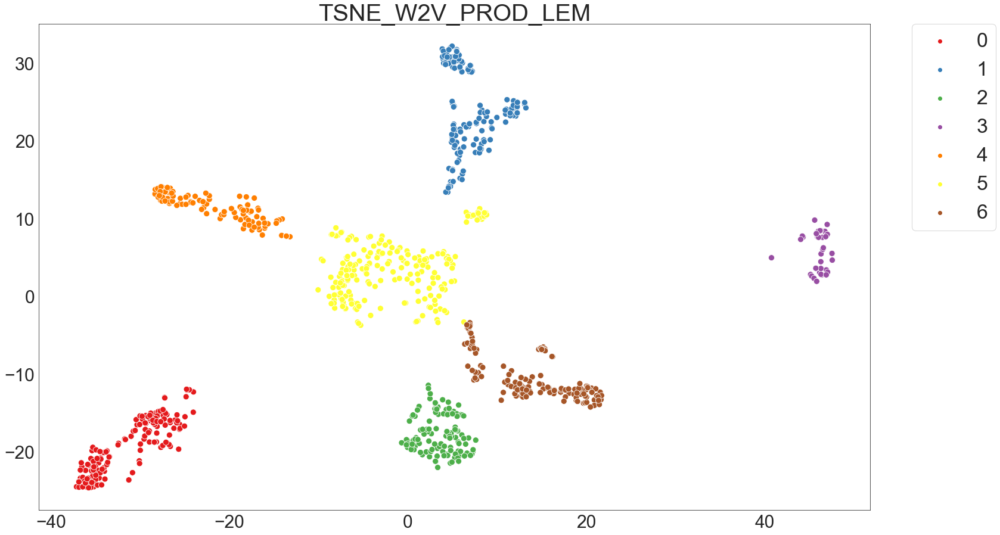

In [509]:
# Visualisation des clusters
outils_nlp.affiche_projection_par_clusters(X_proj_tsne_w2v_prod_lem,
                                           kmeans_tsne_w2v_prod_lem_labels,
                                           type_donnee)

**Bilan** :
***
- Le score ARI est assez haut (0.52).
- Les 7 catégories sont bien trouvées avec cependant quelques mélanges :
    - Cluster 0 : Watches
    - Cluster 1 : Computers
    - Cluster 2 : Baby Care
    - Cluster 3 : Kitchen & Dining
    - Cluster 4 : Beauty and Personal Care
    - Cluster 5 : Home Decor & Festive Needs
    - Cluster 6 : Home Furnishing
- Cette combinaison TSNE Word2Vec + produit spécification lemmatisé parvient à retrouver les 7 catégories comme le souhaite notre client. Il reste à mesurer la qualité de cette catégorisation (75%).

**Qualité de la catégorisation ?**

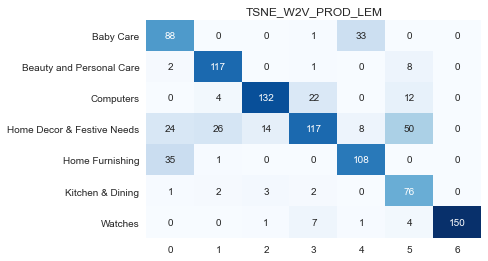

'Précision: 75.05%'

                            precision    recall  f1-score   support

                 Baby Care       0.59      0.72      0.65       122
  Beauty and Personal Care       0.78      0.91      0.84       128
                 Computers       0.88      0.78      0.82       170
Home Decor & Festive Needs       0.78      0.49      0.60       239
           Home Furnishing       0.72      0.75      0.73       144
          Kitchen & Dining       0.51      0.90      0.65        84
                   Watches       1.00      0.92      0.96       163

                  accuracy                           0.75      1050
                 macro avg       0.75      0.78      0.75      1050
              weighted avg       0.78      0.75      0.75      1050


In [510]:
dico_categories = {'0': 'Watches',
                   '1': 'Computers',
                   '2': 'Baby Care',
                   '3': 'Kitchen & Dining',
                   '4': 'Beauty and Personal Care',
                   '5': 'Home Decor & Festive Needs',
                   '6': 'Home Furnishing'}
outils_nlp.affiche_qualite_categorisation(df_tsne_w2v_prod_lem,
                                          dico_categories, type_donnee)

In [511]:
# Sauvegarde des précisions de la catégorisation
df_precision = outils_nlp.sauvegarde_precision(df_precision, '75',
                                               type_donnee)
# Sauvegarde des dataframes de trace
outils_data.to_csv(df_precision, 'data_df_precision.csv')

**Skip-gramm**

**Recherche des meilleurs hyperparamètres**

In [512]:
type_donnee = 'TSNE_W2V_PROD_LEM_SG'

In [513]:
# Tuning hyperparametres n_init, max_iter
# Paramètres à tester
n_init = [10, 20, 30, 50, 70, 80, 100]
max_iter = [100, 200, 300, 400, 500]
# Métriques avec les différentes combinaisons des paramètres
df_metrics_kmeans = \
    outils_nlp.calcul_metrics_kmeans(df_tsne_w2v_prod_lem_sg[cols],
                                     df_metrics_kmeans,
                                     type_donnee,
                                     seed, n_init, max_iter)
# Tri par indice de dispersion : proche de 0
df_metrics_kmeans[df_metrics_kmeans['Type_données'] == type_donnee] \
    .sort_values(by=['coef_silh', 'davies_bouldin', 'Durée (s)'],
                 ascending=[False, True, True]).style.hide_index()

Type_données,n_init,max_iter,coef_silh,dispersion,davies_bouldin,Durée (s)
TSNE_W2V_PROD_LEM_SG,10,300,0.59909,29485.66797,0.57136,0.02985
TSNE_W2V_PROD_LEM_SG,10,400,0.59909,29485.67188,0.57136,0.03228
TSNE_W2V_PROD_LEM_SG,10,200,0.59909,29485.66992,0.57136,0.04189
TSNE_W2V_PROD_LEM_SG,10,100,0.59909,29485.67188,0.57136,0.04289
TSNE_W2V_PROD_LEM_SG,10,500,0.59909,29485.67188,0.57136,0.04687
TSNE_W2V_PROD_LEM_SG,20,400,0.59909,29485.66797,0.57136,0.07767
TSNE_W2V_PROD_LEM_SG,20,200,0.59909,29485.66797,0.57136,0.08178
TSNE_W2V_PROD_LEM_SG,20,300,0.59909,29485.66797,0.57136,0.08278
TSNE_W2V_PROD_LEM_SG,30,400,0.59909,29485.66797,0.57136,0.12039
TSNE_W2V_PROD_LEM_SG,30,300,0.59909,29485.66797,0.57136,0.12766


In [514]:
# Sauvegarde des dataframes de trace
outils_data.to_csv(df_metrics_kmeans, 'data_df_metrics_kmeans.csv')

**Clustering**

In [515]:
# Instanciation du modèle KMeans avec les meilleurs paramètres
kmeans_tsne_w2v_prod_lem_sg = KMeans(n_clusters=7, init='k-means++',
                                     n_init=10, max_iter=300,
                                     random_state=seed) \
    .fit(df_tsne_w2v_prod_lem_sg[cols])
# Ajout de l'assignation du cluster au dataframe
df_tsne_w2v_prod_lem_sg['Clusters'] = kmeans_tsne_w2v_prod_lem_sg.labels_
kmeans_tsne_w2v_prod_lem_sg_labels = kmeans_tsne_w2v_prod_lem_sg.labels_

In [516]:
# Scores ?
df_scores = outils_nlp.calcul_metriques_clusters(df_tsne_w2v_prod_lem_sg,
                                                 df_scores,
                                                 type_donnee)
df_scores.style.hide_index()

Type_données,ARI,Homogénéité,Complétude,V-measure
ACP_CV_DESC_LEM,0.03894,0.11797,0.20952,0.15095
ACP_CV_DESC_STEM,0.04503,0.11941,0.19802,0.14898
ACP_CV_PROD_LEM,0.10551,0.26012,0.58404,0.35994
ACP_CV_PROD_STEM,0.10015,0.25417,0.57940,0.35334
ACP_TFIDF_DESC_LEM,0.14925,0.34720,0.53091,0.41984
ACP_TFIDF_DESC_STEM,0.14698,0.34728,0.52762,0.41886
ACP_TFIDF_PROD_LEM,0.20215,0.37890,0.48553,0.42564
ACP_TFIDF_PROD_STEM,0.21837,0.39724,0.50516,0.44475
ACP_HASH_DESC_LEM,0.03915,0.11095,0.19437,0.14126
ACP_HASH_DESC_STEM,0.04546,0.11990,0.20162,0.15037


In [517]:
# Sauvegarde des dataframes de trace
outils_data.to_csv(df_scores, 'data_df_scores.csv')

Clusters,Nombre,%
0,253,24.10000
1,162,15.43000
2,114,10.86000
3,151,14.38000
4,115,10.95000
5,130,12.38000
6,125,11.90000


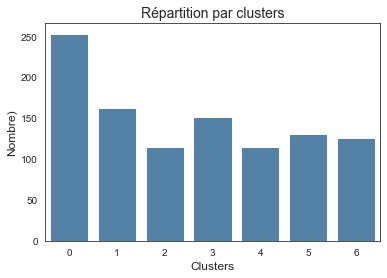

In [518]:
outils_nlp.affiche_repartition_par_clusters(kmeans_tsne_w2v_prod_lem_sg_labels)

In [519]:
# Les catégories par clusters
df_tsne_w2v_prod_lem_sg.groupby('Clusters')['CATEGORIE'].value_counts(). \
    to_frame()

CATEGORIE
Clusters CATEGORIE                            
0        Home Decor & Festive Needs        116
         Kitchen & Dining                   33
         Beauty and Personal Care           31
         Home Furnishing                    31
         Baby Care                          27
         Computers                          15
1        Watches                           150
         Home Decor & Festive Needs          7
         Kitchen & Dining                    4
         Home Furnishing                     1
2        Home Furnishing                    84
         Baby Care                          30
3        Computers                         130
         Kitchen & Dining                   11
         Home Decor & Festive Needs          7
         Beauty and Personal Care            3
4        Beauty and Personal Care          112
         Baby Care                           2
         Home Decor & Festive Needs          1
5        Kitchen & Dining                  102
         Home Decor & Festive Needs         19
         Computers                           5
         Beauty and Personal Care            4
6        Baby Care                          91
         Home Furnishing                    34

**Visualisation des clusters**

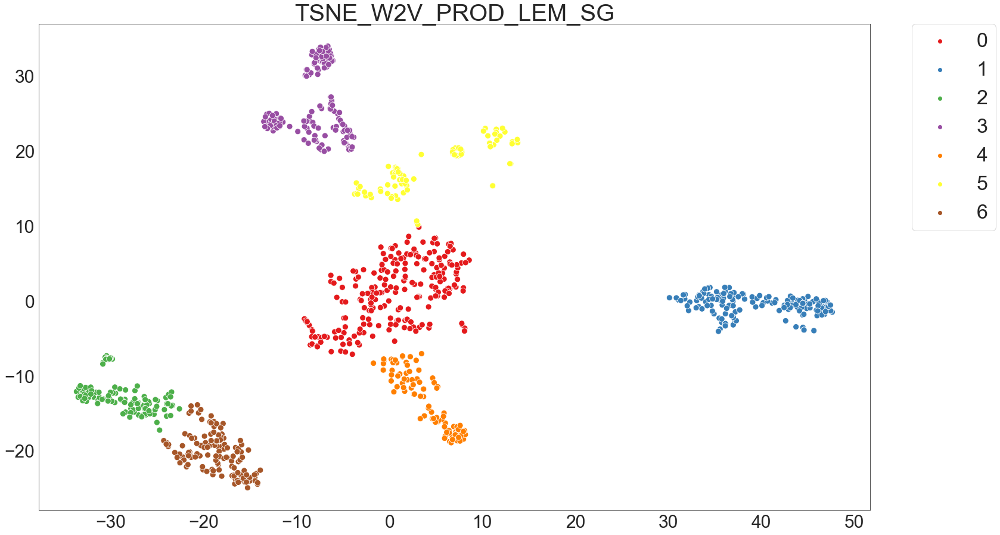

In [520]:
# Visualisation des clusters
outils_nlp.affiche_projection_par_clusters(X_proj_tsne_w2v_prod_lem_sg,
                                           kmeans_tsne_w2v_prod_lem_sg_labels,
                                           type_donnee)

**Bilan** :
***
- Le score ARI est assez haut (0.62).
- Les 7 catégories sont bien trouvées avec cependant quelques mélanges :
    - Cluster 0 : Home Decor & Festive Needs
    - Cluster 1 : Watches
    - Cluster 2 : Home Furnishing
    - Cluster 3 : Computers
    - Cluster 4 : Beauty and Personal Care
    - Cluster 5 : Kitchen & Dining
    - Cluster 6 : Baby Care
- Cette combinaison TSNE Word2Vec + produit spécification lemmatisé parvient à retrouver les 7 catégories comme le souhaite notre client. Il reste à mesurer la qualité de cette catégorisation (75%).

**Qualité de la catégorisation ?**

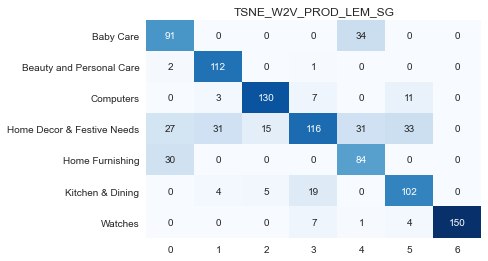

'Précision: 74.76%'

                            precision    recall  f1-score   support

                 Baby Care       0.61      0.73      0.66       125
  Beauty and Personal Care       0.75      0.97      0.85       115
                 Computers       0.87      0.86      0.86       151
Home Decor & Festive Needs       0.77      0.46      0.58       253
           Home Furnishing       0.56      0.74      0.64       114
          Kitchen & Dining       0.68      0.78      0.73       130
                   Watches       1.00      0.93      0.96       162

                  accuracy                           0.75      1050
                 macro avg       0.75      0.78      0.75      1050
              weighted avg       0.76      0.75      0.74      1050


In [523]:
dico_categories = {'0': 'Home Decor & Festive Needs',
                   '1': 'Watches',
                   '2': 'Home Furnishing',
                   '3': 'Computers',
                   '4': 'Beauty and Personal Care',
                   '5': 'Kitchen & Dining',
                   '6': 'Baby Care'}
outils_nlp.affiche_qualite_categorisation(df_tsne_w2v_prod_lem_sg,
                                          dico_categories, type_donnee)

In [524]:
# Sauvegarde des précisions de la catégorisation
df_precision = outils_nlp.sauvegarde_precision(df_precision, '75',
                                               type_donnee)
# Sauvegarde des dataframes de trace
outils_data.to_csv(df_precision, 'data_df_precision.csv')

**produit_specification** - stemmatisée
***

**Recherche des meilleurs hyperparamètres**

In [525]:
type_donnee = 'TSNE_W2V_PROD_STEM'

In [526]:
# Tuning hyperparametres n_init, max_iter
# Paramètres à tester
n_init = [10, 20, 30, 50, 70, 80, 100]
max_iter = [100, 200, 300, 400, 500]
# Métriques avec les différentes combinaisons des paramètres
df_metrics_kmeans = \
    outils_nlp.calcul_metrics_kmeans(df_tsne_w2v_prod_stem[cols],
                                     df_metrics_kmeans,
                                     type_donnee,
                                     seed, n_init, max_iter)
# Tri par indice de dispersion : proche de 0
df_metrics_kmeans[df_metrics_kmeans['Type_données'] == type_donnee] \
    .sort_values(by=['coef_silh', 'davies_bouldin', 'Durée (s)'],
                 ascending=[False, True, True]).style.hide_index()

Type_données,n_init,max_iter,coef_silh,dispersion,davies_bouldin,Durée (s)
TSNE_W2V_PROD_STEM,10,300,0.46200,70008.60156,0.67851,0.05137
TSNE_W2V_PROD_STEM,10,500,0.46200,70008.60156,0.67851,0.05303
TSNE_W2V_PROD_STEM,10,100,0.46200,70008.60156,0.67851,0.06183
TSNE_W2V_PROD_STEM,10,200,0.46200,70008.59375,0.67851,0.06283
TSNE_W2V_PROD_STEM,10,400,0.46200,70008.60156,0.67851,0.06599
TSNE_W2V_PROD_STEM,20,200,0.46200,70008.60938,0.67851,0.11585
TSNE_W2V_PROD_STEM,20,100,0.46200,70008.60938,0.67851,0.11703
TSNE_W2V_PROD_STEM,20,500,0.46200,70008.59375,0.67851,0.11728
TSNE_W2V_PROD_STEM,20,400,0.46200,70008.60156,0.67851,0.11868
TSNE_W2V_PROD_STEM,20,300,0.46200,70008.60938,0.67851,0.12295


In [527]:
# Sauvegarde des dataframes de trace
outils_data.to_csv(df_metrics_kmeans, 'data_df_metrics_kmeans.csv')

**Clustering**

In [528]:
# Instanciation du modèle KMeans avec les meilleurs paramètres
kmeans_tsne_w2v_prod_stem = KMeans(n_clusters=7, init='k-means++',
                                   n_init=10, max_iter=300,
                                   random_state=seed) \
    .fit(df_tsne_w2v_prod_stem[cols])
# Ajout de l'assignation du cluster au dataframe
df_tsne_w2v_prod_stem['Clusters'] = kmeans_tsne_w2v_prod_stem.labels_
kmeans_tsne_w2v_prod_stem_labels = kmeans_tsne_w2v_prod_stem.labels_

In [529]:
# Scores ?
df_scores = outils_nlp.calcul_metriques_clusters(df_tsne_w2v_prod_stem,
                                                 df_scores,
                                                 type_donnee)
df_scores.style.hide_index()

Type_données,ARI,Homogénéité,Complétude,V-measure
ACP_CV_DESC_LEM,0.03894,0.11797,0.20952,0.15095
ACP_CV_DESC_STEM,0.04503,0.11941,0.19802,0.14898
ACP_CV_PROD_LEM,0.10551,0.26012,0.58404,0.35994
ACP_CV_PROD_STEM,0.10015,0.25417,0.57940,0.35334
ACP_TFIDF_DESC_LEM,0.14925,0.34720,0.53091,0.41984
ACP_TFIDF_DESC_STEM,0.14698,0.34728,0.52762,0.41886
ACP_TFIDF_PROD_LEM,0.20215,0.37890,0.48553,0.42564
ACP_TFIDF_PROD_STEM,0.21837,0.39724,0.50516,0.44475
ACP_HASH_DESC_LEM,0.03915,0.11095,0.19437,0.14126
ACP_HASH_DESC_STEM,0.04546,0.11990,0.20162,0.15037


In [530]:
# Sauvegarde des dataframes de trace
outils_data.to_csv(df_scores, 'data_df_scores.csv')

Clusters,Nombre,%
0,129,12.29000
1,170,16.19000
2,75,7.14000
3,148,14.10000
4,144,13.71000
5,250,23.81000
6,134,12.76000


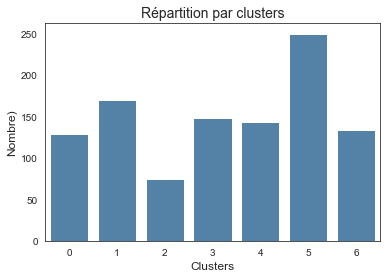

In [531]:
outils_nlp \
    .affiche_repartition_par_clusters(kmeans_tsne_w2v_prod_stem_labels)

In [532]:
# Les catégories par clusters
df_tsne_w2v_prod_stem.groupby('Clusters')['CATEGORIE'].value_counts() \
    .to_frame()

CATEGORIE
Clusters CATEGORIE                            
0        Computers                          86
         Kitchen & Dining                   32
         Home Decor & Festive Needs         11
1        Baby Care                         110
         Home Furnishing                    56
         Home Decor & Festive Needs          4
2        Kitchen & Dining                   74
         Baby Care                           1
3        Watches                           140
         Home Decor & Festive Needs          4
         Home Furnishing                     4
4        Beauty and Personal Care          108
         Kitchen & Dining                   18
         Home Decor & Festive Needs         15
         Computers                           2
         Baby Care                           1
5        Home Decor & Festive Needs        109
         Beauty and Personal Care           42
         Baby Care                          28
         Kitchen & Dining                   25
         Computers                          18
         Home Furnishing                    18
         Watches                            10
6        Home Furnishing                    72
         Computers                          44
         Baby Care                          10
         Home Decor & Festive Needs          7
         Kitchen & Dining                    1

**Visualisation des clusters**

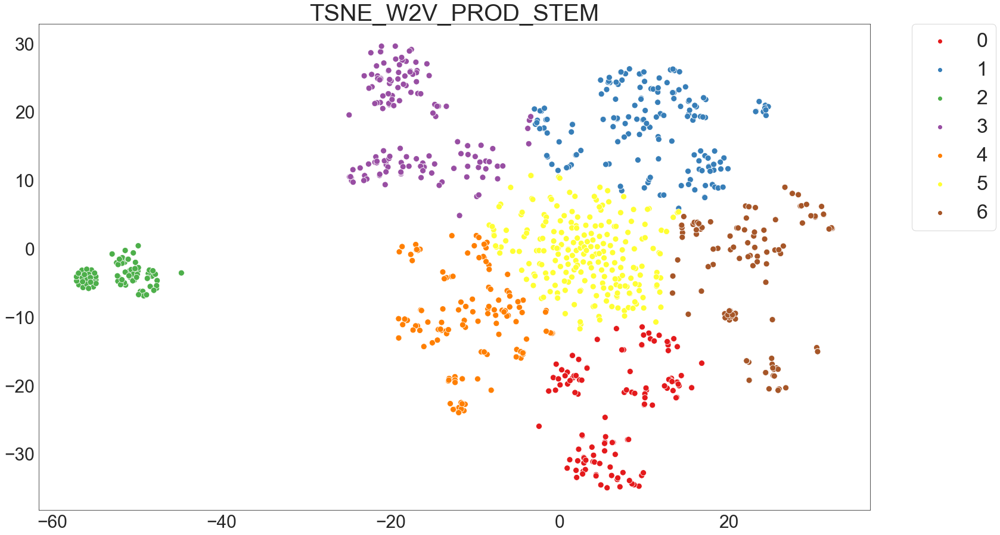

In [533]:
# Visualisation des clusters
outils_nlp.affiche_projection_par_clusters(X_proj_tsne_w2v_prod_stem,
                                           kmeans_tsne_w2v_prod_stem_labels,
                                           type_donnee)

**Bilan** :
***
- Le score ARI est assez haut (0.42).
- Les 7 catégories sont bien trouvées avec cependant quelques mélanges :
    - Cluster 0 : Computers
    - Cluster 1 : Baby Care
    - Cluster 2 : Kitchen & Dining
    - Cluster 3 : Watches
    - Cluster 4 : Beauty and Personal Care
    - Cluster 5 : Home Decor & Festive Needs
    - Cluster 6 : Home Furnishing
- Cette combinaison TSNE TfidfVectorizer + produit spécification stemmatisé parvient à retrouver les 7 catégories comme le souhaite notre client. Il reste à mesurer la qualité de cette catégorisation (67%).

**Qualité de la catégorisation ?**

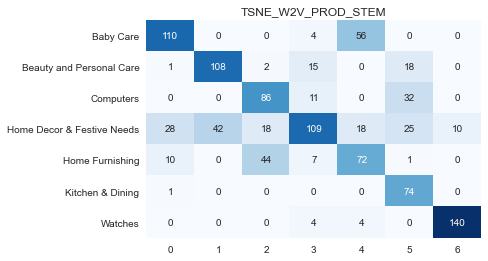

'Précision: 66.57%'

                            precision    recall  f1-score   support

                 Baby Care       0.73      0.65      0.69       170
  Beauty and Personal Care       0.72      0.75      0.73       144
                 Computers       0.57      0.67      0.62       129
Home Decor & Festive Needs       0.73      0.44      0.54       250
           Home Furnishing       0.48      0.54      0.51       134
          Kitchen & Dining       0.49      0.99      0.66        75
                   Watches       0.93      0.95      0.94       148

                  accuracy                           0.67      1050
                 macro avg       0.67      0.71      0.67      1050
              weighted avg       0.69      0.67      0.66      1050


In [534]:
dico_categories = {'0': 'Computers',
                   '1': 'Baby Care',
                   '2': 'Kitchen & Dining',
                   '3': 'Watches',
                   '4': 'Beauty and Personal Care',
                   '5': 'Home Decor & Festive Needs',
                   '6': 'Home Furnishing'}
outils_nlp.affiche_qualite_categorisation(df_tsne_w2v_prod_stem,
                                          dico_categories, type_donnee)

In [535]:
# Sauvegarde des précisions de la catégorisation
df_precision = outils_nlp.sauvegarde_precision(df_precision, '67',
                                               type_donnee)
# Sauvegarde des dataframes de trace
outils_data.to_csv(df_precision, 'data_df_precision.csv')

### <span style='background:PowderBlue'>6.8. ACP+TSNE BOW CountVectorizer</span>

**description** - lemmatisée
***

**Recherche des meilleurs hyperparamètres**

In [536]:
type_donnee = 'ACP+TSNE_CV_DESC_LEM'

In [537]:
# Tuning hyperparametres n_init, max_iter
# Paramètres à tester
n_init = [10, 20, 30, 50, 70, 80, 100]
max_iter = [100, 200, 300, 400, 500]
# Métriques avec les différentes combinaisons des paramètres
df_metrics_kmeans = \
    outils_nlp.calcul_metrics_kmeans(df_acptsne_cv_desc_lem[cols],
                                     df_metrics_kmeans,
                                     type_donnee,
                                     seed, n_init, max_iter)
# Tri par indice de dispersion : proche de 0
df_metrics_kmeans[df_metrics_kmeans['Type_données'] == type_donnee] \
    .sort_values(by=['coef_silh', 'davies_bouldin', 'Durée (s)'],
                 ascending=[False, True, True]).style.hide_index()

Type_données,n_init,max_iter,coef_silh,dispersion,davies_bouldin,Durée (s)
ACP+TSNE_CV_DESC_LEM,100,400,0.48605,94214.38281,0.73486,0.52759
ACP+TSNE_CV_DESC_LEM,100,300,0.48605,94214.38281,0.73486,0.52958
ACP+TSNE_CV_DESC_LEM,100,200,0.48605,94214.38281,0.73486,0.53258
ACP+TSNE_CV_DESC_LEM,100,500,0.48605,94214.38281,0.73486,0.53457
ACP+TSNE_CV_DESC_LEM,100,100,0.48605,94214.38281,0.73486,0.53856
ACP+TSNE_CV_DESC_LEM,20,500,0.48589,94217.11719,0.73572,0.11070
ACP+TSNE_CV_DESC_LEM,20,400,0.48589,94217.11719,0.73572,0.11170
ACP+TSNE_CV_DESC_LEM,20,200,0.48589,94217.11719,0.73572,0.11270
ACP+TSNE_CV_DESC_LEM,20,100,0.48589,94217.11719,0.73572,0.11469
ACP+TSNE_CV_DESC_LEM,20,300,0.48589,94217.11719,0.73572,0.11569


In [538]:
# Sauvegarde des dataframes de trace
outils_data.to_csv(df_metrics_kmeans, 'data_df_metrics_kmeans.csv')

**Clustering**

In [539]:
# Instanciation du modèle KMeans avec les meilleurs paramètres
kmeans_tsne_acp_cv_desc_lem = KMeans(n_clusters=7, init='k-means++',
                                     n_init=100, max_iter=400,
                                     random_state=seed) \
    .fit(df_acptsne_cv_desc_lem[cols])
# Ajout de l'assignation du cluster au dataframe
df_acptsne_cv_desc_lem['Clusters'] = kmeans_tsne_acp_cv_desc_lem.labels_
kmeans_tsne_acp_cv_desc_lem_labels = kmeans_tsne_acp_cv_desc_lem.labels_

In [540]:
# Scores ?
df_scores = outils_nlp.calcul_metriques_clusters(df_acptsne_cv_desc_lem,
                                                 df_scores,
                                                 type_donnee)
df_scores.style.hide_index()

Type_données,ARI,Homogénéité,Complétude,V-measure
ACP_CV_DESC_LEM,0.03894,0.11797,0.20952,0.15095
ACP_CV_DESC_STEM,0.04503,0.11941,0.19802,0.14898
ACP_CV_PROD_LEM,0.10551,0.26012,0.58404,0.35994
ACP_CV_PROD_STEM,0.10015,0.25417,0.57940,0.35334
ACP_TFIDF_DESC_LEM,0.14925,0.34720,0.53091,0.41984
ACP_TFIDF_DESC_STEM,0.14698,0.34728,0.52762,0.41886
ACP_TFIDF_PROD_LEM,0.20215,0.37890,0.48553,0.42564
ACP_TFIDF_PROD_STEM,0.21837,0.39724,0.50516,0.44475
ACP_HASH_DESC_LEM,0.03915,0.11095,0.19437,0.14126
ACP_HASH_DESC_STEM,0.04546,0.11990,0.20162,0.15037


In [541]:
# Sauvegarde des dataframes de trace
outils_data.to_csv(df_scores, 'data_df_scores.csv')

Clusters,Nombre,%
0,126,12.00000
1,199,18.95000
2,250,23.81000
3,150,14.29000
4,110,10.48000
5,133,12.67000
6,82,7.81000


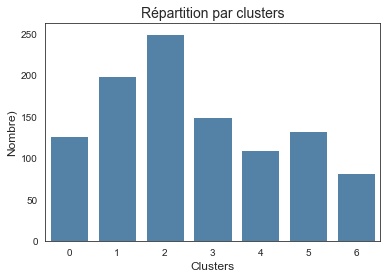

In [542]:
outils_nlp.affiche_repartition_par_clusters(kmeans_tsne_acp_cv_desc_lem_labels)

In [543]:
# Les catégories par clusters
df_acptsne_cv_desc_lem.groupby('Clusters')['CATEGORIE'].value_counts() \
    .to_frame()

CATEGORIE
Clusters CATEGORIE                            
0        Baby Care                          94
         Home Furnishing                    23
         Computers                           5
         Beauty and Personal Care            3
         Kitchen & Dining                    1
1        Computers                          82
         Kitchen & Dining                   43
         Beauty and Personal Care           33
         Home Decor & Festive Needs         26
         Baby Care                          15
2        Home Furnishing                   109
         Computers                          52
         Baby Care                          30
         Beauty and Personal Care           28
         Home Decor & Festive Needs         21
         Kitchen & Dining                   10
3        Watches                           150
4        Home Decor & Festive Needs         99
         Home Furnishing                    10
         Beauty and Personal Care            1
5        Beauty and Personal Care           85
         Kitchen & Dining                   17
         Computers                          11
         Baby Care                           9
         Home Furnishing                     8
         Home Decor & Festive Needs          3
6        Kitchen & Dining                   79
         Baby Care                           2
         Home Decor & Festive Needs          1

**Visualisation des clusters**

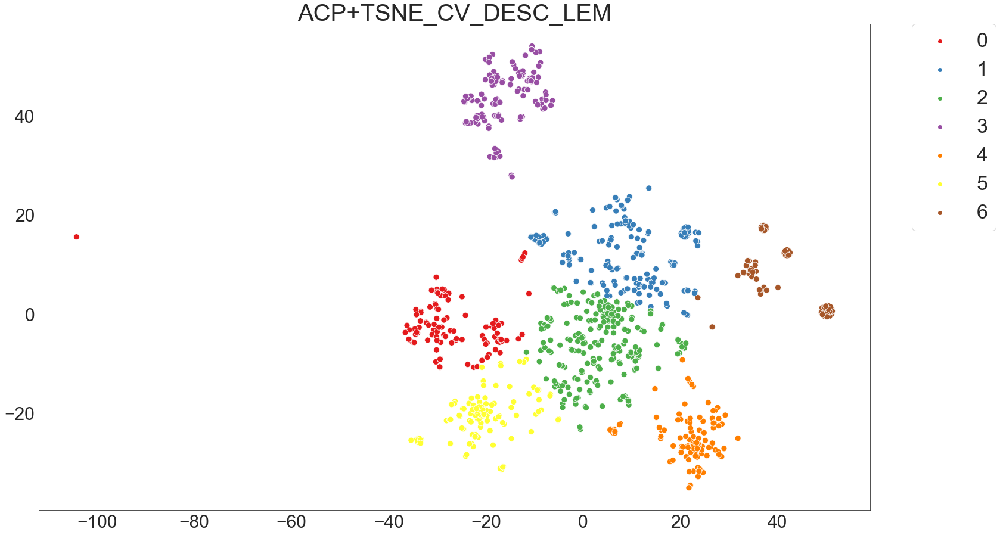

In [544]:
# Visualisation des clusters
outils_nlp.affiche_projection_par_clusters(X_proj_acptsne_cv_desc_lem,
                                           kmeans_tsne_acp_cv_desc_lem_labels,
                                           type_donnee)

**Bilan** :
***
- Le score ARI est moyen (0.41).
- Les 7 catégories sont bien trouvées avec cependant quelques mélanges :
    - Cluster 0 : Baby Care
    - Cluster 1 : Computers
    - Cluster 2 : Home Furnishing
    - Cluster 3 : Watches
    - Cluster 4 : Home Decor & Festive Needs
    - Cluster 5 : Beauty and Personal Care
    - Cluster 6 : Kitchen & Dining
- Cette combinaison ACP+TSNE CountVectorizer + description lemmatisée parvient à retrouver les 7 catégories comme le souhaite notre client. Il reste à mesurer la qualité de cette catégorisation (66.5%).

**Qualité de la catégorisation ?**

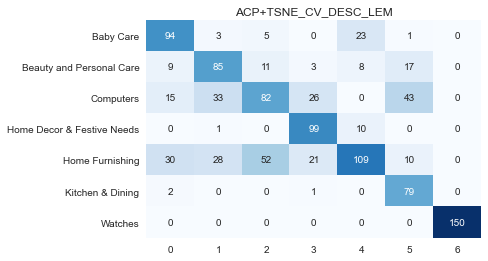

'Précision: 66.48%'

                            precision    recall  f1-score   support

                 Baby Care       0.63      0.75      0.68       126
  Beauty and Personal Care       0.57      0.64      0.60       133
                 Computers       0.55      0.41      0.47       199
Home Decor & Festive Needs       0.66      0.90      0.76       110
           Home Furnishing       0.73      0.44      0.54       250
          Kitchen & Dining       0.53      0.96      0.68        82
                   Watches       1.00      1.00      1.00       150

                  accuracy                           0.66      1050
                 macro avg       0.66      0.73      0.68      1050
              weighted avg       0.68      0.66      0.65      1050


In [545]:
dico_categories = {'0': 'Baby Care',
                   '1': 'Computers',
                   '2': 'Home Furnishing',
                   '3': 'Watches',
                   '4': 'Home Decor & Festive Needs',
                   '5': 'Beauty and Personal Care',
                   '6': 'Kitchen & Dining'}
outils_nlp.affiche_qualite_categorisation(df_acptsne_cv_desc_lem,
                                          dico_categories, type_donnee)

In [546]:
# Sauvegarde des précisions de la catégorisation
df_precision = outils_nlp.sauvegarde_precision(df_precision, '66.5',
                                               type_donnee)
# Sauvegarde des dataframes de trace
outils_data.to_csv(df_precision, 'data_df_precision.csv')

**description** - stemmatisée
***

**Recherche des meilleurs hyperparamètres**

In [547]:
type_donnee = 'ACP+TSNE_CV_DESC_STEM'

In [548]:
# Tuning hyperparametres n_init, max_iter
# Paramètres à tester
n_init = [10, 20, 30, 50, 70, 80, 100]
max_iter = [100, 200, 300, 400, 500]
# Métriques avec les différentes combinaisons des paramètres
df_metrics_kmeans = \
    outils_nlp.calcul_metrics_kmeans(df_acptsne_cv_desc_stem[cols],
                                     df_metrics_kmeans,
                                     type_donnee,
                                     seed, n_init, max_iter)
# Tri par indice de dispersion : proche de 0
df_metrics_kmeans[df_metrics_kmeans['Type_données'] == type_donnee] \
    .sort_values(by=['coef_silh', 'davies_bouldin', 'Durée (s)'],
                 ascending=[False, True, True]).style.hide_index()

Type_données,n_init,max_iter,coef_silh,dispersion,davies_bouldin,Durée (s)
ACP+TSNE_CV_DESC_STEM,50,200,0.48322,102469.21094,0.71507,0.23222
ACP+TSNE_CV_DESC_STEM,50,400,0.48322,102469.21094,0.71507,0.23837
ACP+TSNE_CV_DESC_STEM,50,100,0.48322,102469.21094,0.71507,0.24769
ACP+TSNE_CV_DESC_STEM,50,300,0.48322,102469.21094,0.71507,0.25428
ACP+TSNE_CV_DESC_STEM,50,500,0.48322,102469.20312,0.71507,0.25557
ACP+TSNE_CV_DESC_STEM,70,400,0.48322,102469.21094,0.71507,0.33677
ACP+TSNE_CV_DESC_STEM,70,500,0.48322,102469.20312,0.71507,0.33761
ACP+TSNE_CV_DESC_STEM,70,200,0.48322,102469.20312,0.71507,0.35206
ACP+TSNE_CV_DESC_STEM,70,300,0.48322,102469.21094,0.71507,0.35704
ACP+TSNE_CV_DESC_STEM,70,100,0.48322,102469.21094,0.71507,0.36014


In [549]:
# Sauvegarde des dataframes de trace
outils_data.to_csv(df_metrics_kmeans, 'data_df_metrics_kmeans.csv')

**Clustering**

In [550]:
# Instanciation du modèle KMeans avec les meilleurs paramètres
kmeans_acptsne_cv_desc_stem = KMeans(n_clusters=7, init='k-means++',
                                     n_init=50, max_iter=200,
                                     random_state=seed) \
    .fit(df_acptsne_cv_desc_stem[cols])
# Ajout de l'assignation du cluster au dataframe
df_acptsne_cv_desc_stem['Clusters'] = kmeans_acptsne_cv_desc_stem.labels_
kmeans_acptsne_cv_desc_stem_labels = kmeans_acptsne_cv_desc_stem.labels_

In [552]:
# Scores ?
df_scores = outils_nlp.calcul_metriques_clusters(df_acptsne_cv_desc_stem,
                                                 df_scores,
                                                 type_donnee)
df_scores.style.hide_index()

Type_données,ARI,Homogénéité,Complétude,V-measure
ACP_CV_DESC_LEM,0.03894,0.11797,0.20952,0.15095
ACP_CV_DESC_STEM,0.04503,0.11941,0.19802,0.14898
ACP_CV_PROD_LEM,0.10551,0.26012,0.58404,0.35994
ACP_CV_PROD_STEM,0.10015,0.25417,0.57940,0.35334
ACP_TFIDF_DESC_LEM,0.14925,0.34720,0.53091,0.41984
ACP_TFIDF_DESC_STEM,0.14698,0.34728,0.52762,0.41886
ACP_TFIDF_PROD_LEM,0.20215,0.37890,0.48553,0.42564
ACP_TFIDF_PROD_STEM,0.21837,0.39724,0.50516,0.44475
ACP_HASH_DESC_LEM,0.03915,0.11095,0.19437,0.14126
ACP_HASH_DESC_STEM,0.04546,0.11990,0.20162,0.15037


In [553]:
# Sauvegarde des dataframes de trace
outils_data.to_csv(df_scores, 'data_df_scores.csv')

Clusters,Nombre,%
0,126,12.00000
1,152,14.48000
2,260,24.76000
3,118,11.24000
4,151,14.38000
5,123,11.71000
6,120,11.43000


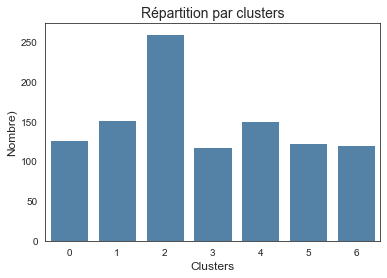

In [554]:
outils_nlp.affiche_repartition_par_clusters(kmeans_acptsne_cv_desc_stem_labels)

In [555]:
# Les catégories par clusters
df_acptsne_cv_desc_stem.groupby('Clusters')['CATEGORIE'].value_counts() \
    .to_frame()

CATEGORIE
Clusters CATEGORIE                            
0        Baby Care                          96
         Home Furnishing                    28
         Beauty and Personal Care            1
         Kitchen & Dining                    1
1        Home Decor & Festive Needs        104
         Computers                          38
         Kitchen & Dining                    7
         Beauty and Personal Care            3
2        Home Furnishing                    82
         Computers                          61
         Beauty and Personal Care           48
         Baby Care                          31
         Home Decor & Festive Needs         21
         Kitchen & Dining                   17
3        Beauty and Personal Care           82
         Kitchen & Dining                   12
         Computers                          11
         Baby Care                           6
         Home Furnishing                     4
         Home Decor & Festive Needs          3
4        Watches                           148
         Kitchen & Dining                    2
         Computers                           1
5        Kitchen & Dining                  100
         Baby Care                          10
         Beauty and Personal Care           10
         Home Decor & Festive Needs          3
6        Computers                          39
         Home Furnishing                    36
         Home Decor & Festive Needs         19
         Kitchen & Dining                   11
         Baby Care                           7
         Beauty and Personal Care            6
         Watches                             2

**Visualisation des clusters**

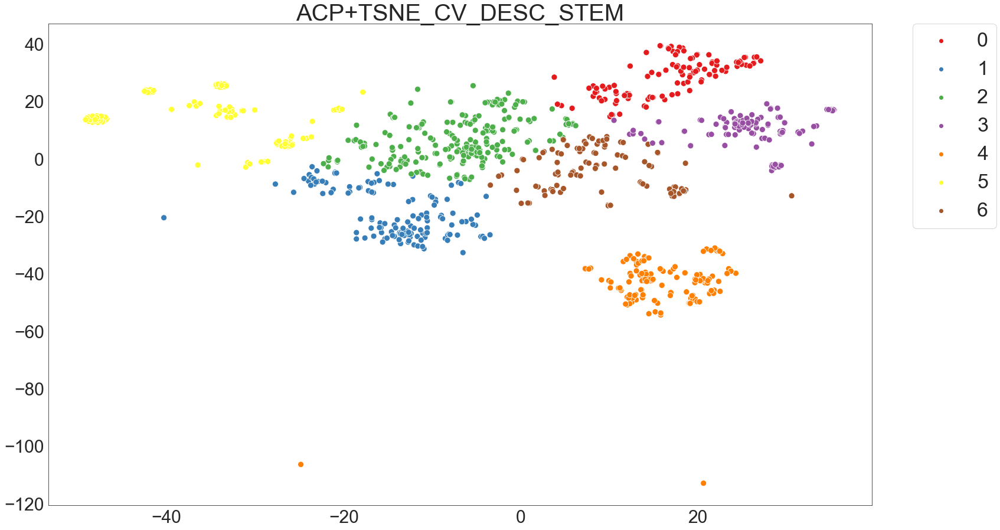

In [556]:
# Visualisation des clusters
outils_nlp.affiche_projection_par_clusters(X_proj_acptsne_cv_desc_stem,
                                           kmeans_acptsne_cv_desc_stem_labels,
                                           type_donnee)

**Bilan** :
***
- Le score ARI est moyen (0.49).
- Les 7 catégories sont bien trouvées avec cependant quelques mélanges :
    - Cluster 0 : Baby Care
    - Cluster 1 : Home Decor & Festive Needs
    - Cluster 2 : Home Furnishing
    - Cluster 3 : Beauty and Personal Care
    - Cluster 4 : Watches
    - Cluster 5 : Kitchen & Dining
    - Cluster 6 : Computers
- Cette combinaison ACP+TSNE CountVectorizer + description stemmatisée parvient à retrouver les 7 catégories comme le souhaite notre client. Il reste à mesurer la qualité de cette catégorisation (62%).

**Qualité de la catégorisation ?**

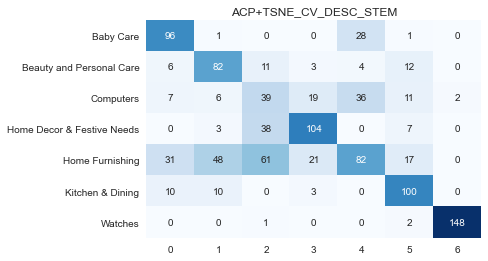

'Précision: 62.0%'

                            precision    recall  f1-score   support

                 Baby Care       0.64      0.76      0.70       126
  Beauty and Personal Care       0.55      0.69      0.61       118
                 Computers       0.26      0.33      0.29       120
Home Decor & Festive Needs       0.69      0.68      0.69       152
           Home Furnishing       0.55      0.32      0.40       260
          Kitchen & Dining       0.67      0.81      0.73       123
                   Watches       0.99      0.98      0.98       151

                  accuracy                           0.62      1050
                 macro avg       0.62      0.65      0.63      1050
              weighted avg       0.62      0.62      0.61      1050


In [557]:
dico_categories = {'0': 'Baby Care',
                   '1': 'Home Decor & Festive Needs',
                   '2': 'Home Furnishing',
                   '3': 'Beauty and Personal Care',
                   '4': 'Watches',
                   '5': 'Kitchen & Dining',
                   '6': 'Computers'}
outils_nlp.affiche_qualite_categorisation(df_acptsne_cv_desc_stem,
                                          dico_categories, type_donnee)

In [558]:
# Sauvegarde des précisions de la catégorisation
df_precision = outils_nlp.sauvegarde_precision(df_precision, '62',
                                               type_donnee)
# Sauvegarde des dataframes de trace
outils_data.to_csv(df_precision, 'data_df_precision.csv')

**produit_specification** - lemmatisée
***

**Recherche des meilleurs hyperparamètres**

In [559]:
type_donnee = 'ACP+TSNE_CV_PROD_LEM'

In [560]:
# Tuning hyperparametres n_init, max_iter
# Paramètres à tester
n_init = [10, 20, 30, 50, 70, 80, 100]
max_iter = [100, 200, 300, 400, 500]
# Métriques avec les différentes combinaisons des paramètres
df_metrics_kmeans = \
    outils_nlp.calcul_metrics_kmeans(df_acptsne_cv_prod_lem[cols],
                                     df_metrics_kmeans,
                                     type_donnee,
                                     seed, n_init, max_iter)
# Tri par indice de dispersion : proche de 0
df_metrics_kmeans[df_metrics_kmeans['Type_données'] == type_donnee] \
    .sort_values(by=['coef_silh', 'davies_bouldin', 'Durée (s)'],
                 ascending=[False, True, True]).style.hide_index()

Type_données,n_init,max_iter,coef_silh,dispersion,davies_bouldin,Durée (s)
ACP+TSNE_CV_PROD_LEM,10,300,0.46593,90750.50781,0.67864,0.04686
ACP+TSNE_CV_PROD_LEM,10,200,0.46593,90750.50000,0.67864,0.05058
ACP+TSNE_CV_PROD_LEM,10,500,0.46593,90750.50000,0.67864,0.05585
ACP+TSNE_CV_PROD_LEM,10,400,0.46593,90750.50000,0.67864,0.05685
ACP+TSNE_CV_PROD_LEM,10,100,0.46593,90750.50781,0.67864,0.05888
ACP+TSNE_CV_PROD_LEM,20,200,0.46593,90750.50000,0.67864,0.09941
ACP+TSNE_CV_PROD_LEM,20,300,0.46593,90750.50000,0.67864,0.11103
ACP+TSNE_CV_PROD_LEM,20,100,0.46593,90750.50781,0.67864,0.11170
ACP+TSNE_CV_PROD_LEM,20,500,0.46593,90750.50000,0.67864,0.11665
ACP+TSNE_CV_PROD_LEM,20,400,0.46593,90750.50000,0.67864,0.12367


In [561]:
# Sauvegarde des dataframes de trace
outils_data.to_csv(df_metrics_kmeans, 'data_df_metrics_kmeans.csv')

**Clustering**

In [562]:
# Instanciation du modèle KMeans avec les meilleurs paramètres
kmeans_acptsne_cv_prod_lem = KMeans(n_clusters=7, init='k-means++',
                                    n_init=10, max_iter=300,
                                    random_state=seed) \
    .fit(df_acptsne_cv_prod_lem[cols])
# Ajout de l'assignation du cluster au dataframe
df_acptsne_cv_prod_lem['Clusters'] = kmeans_acptsne_cv_prod_lem.labels_
kmeans_acptsne_cv_prod_lem_labels = kmeans_acptsne_cv_prod_lem.labels_

In [563]:
# Scores ?
df_scores = outils_nlp.calcul_metriques_clusters(df_acptsne_cv_prod_lem,
                                                 df_scores,
                                                 type_donnee)
df_scores.style.hide_index()

Type_données,ARI,Homogénéité,Complétude,V-measure
ACP_CV_DESC_LEM,0.03894,0.11797,0.20952,0.15095
ACP_CV_DESC_STEM,0.04503,0.11941,0.19802,0.14898
ACP_CV_PROD_LEM,0.10551,0.26012,0.58404,0.35994
ACP_CV_PROD_STEM,0.10015,0.25417,0.57940,0.35334
ACP_TFIDF_DESC_LEM,0.14925,0.34720,0.53091,0.41984
ACP_TFIDF_DESC_STEM,0.14698,0.34728,0.52762,0.41886
ACP_TFIDF_PROD_LEM,0.20215,0.37890,0.48553,0.42564
ACP_TFIDF_PROD_STEM,0.21837,0.39724,0.50516,0.44475
ACP_HASH_DESC_LEM,0.03915,0.11095,0.19437,0.14126
ACP_HASH_DESC_STEM,0.04546,0.11990,0.20162,0.15037


In [564]:
# Sauvegarde des dataframes de trace
outils_data.to_csv(df_scores, 'data_df_scores.csv')

Clusters,Nombre,%
0,138,13.14000
1,278,26.48000
2,100,9.52000
3,143,13.62000
4,133,12.67000
5,128,12.19000
6,130,12.38000


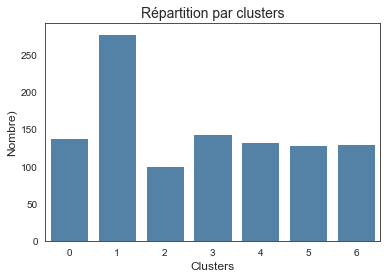

In [565]:
outils_nlp.affiche_repartition_par_clusters(kmeans_acptsne_cv_prod_lem_labels)

In [566]:
# Les catégories par clusters
df_acptsne_cv_prod_lem.groupby('Clusters')['CATEGORIE'].value_counts() \
    .to_frame()

CATEGORIE
Clusters CATEGORIE                            
0        Watches                           138
1        Home Decor & Festive Needs        137
         Beauty and Personal Care           40
         Kitchen & Dining                   30
         Baby Care                          23
         Computers                          18
         Home Furnishing                    18
         Watches                            12
2        Kitchen & Dining                  100
3        Beauty and Personal Care          106
         Kitchen & Dining                   20
         Home Decor & Festive Needs         13
         Baby Care                           2
         Computers                           2
4        Home Furnishing                    97
         Baby Care                          32
         Beauty and Personal Care            4
5        Baby Care                          93
         Home Furnishing                    35
6        Computers                         130

**Visualisation des clusters**

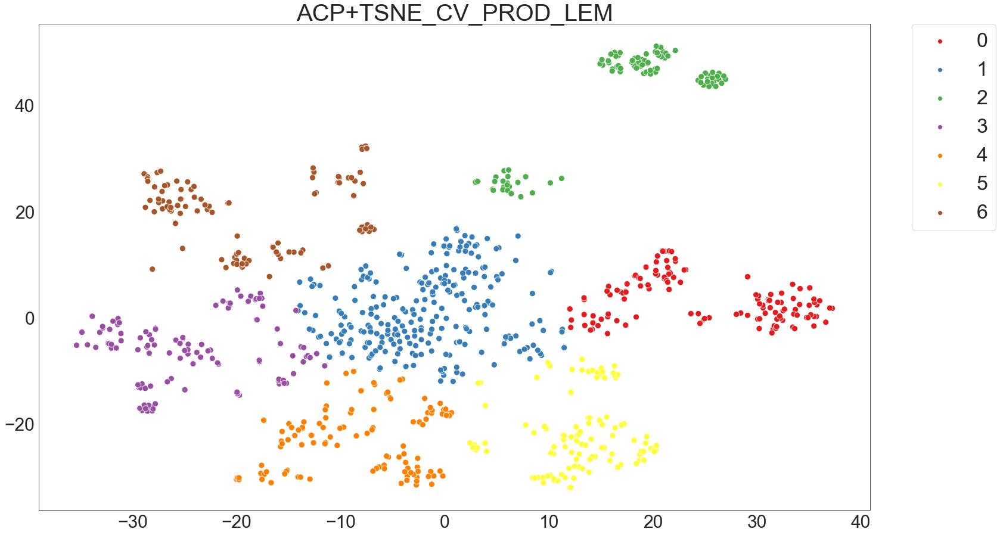

In [567]:
# Visualisation des clusters
outils_nlp.affiche_projection_par_clusters(X_proj_acptsne_cv_prod_lem,
                                           kmeans_acptsne_cv_prod_lem_labels,
                                           type_donnee)

**Bilan** :
***
- Le score ARI est moyen (0.53).
- Les 7 catégories sont bien trouvées avec cependant quelques mélanges :
    - Cluster 0 : Watches
    - Cluster 1 : Home Decor & Festive Needs
    - Cluster 2 : Kitchen & Dining
    - Cluster 3 : Beauty and Personal Care
    - Cluster 4 : Home Furnishing
    - Cluster 5 : Baby Care
    - Cluster 6 : Computers
- Cette combinaison ACP+TSNE CountVectorizer + produit spécification lemmatisé parvient à retrouver les 7 catégories comme le souhaite notre client. Il reste à mesurer la qualité de cette catégorisation (76%).

**Qualité de la catégorisation ?**

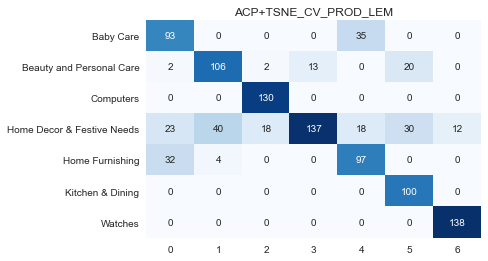

'Précision: 76.29%'

                            precision    recall  f1-score   support

                 Baby Care       0.62      0.73      0.67       128
  Beauty and Personal Care       0.71      0.74      0.72       143
                 Computers       0.87      1.00      0.93       130
Home Decor & Festive Needs       0.91      0.49      0.64       278
           Home Furnishing       0.65      0.73      0.69       133
          Kitchen & Dining       0.67      1.00      0.80       100
                   Watches       0.92      1.00      0.96       138

                  accuracy                           0.76      1050
                 macro avg       0.76      0.81      0.77      1050
              weighted avg       0.79      0.76      0.75      1050


In [568]:
dico_categories = {'0': 'Watches',
                   '1': 'Home Decor & Festive Needs',
                   '2': 'Kitchen & Dining',
                   '3': 'Beauty and Personal Care',
                   '4': 'Home Furnishing',
                   '5': 'Baby Care',
                   '6': 'Computers'}
outils_nlp.affiche_qualite_categorisation(df_acptsne_cv_prod_lem,
                                          dico_categories, type_donnee)
13
# Sauvegarde des précisions de la catégorisation
df_precision = outils_nlp.sauvegarde_precision(df_precision, '76',
                                               type_donnee)
# Sauvegarde des dataframes de trace
outils_data.to_csv(df_precision, 'data_df_precision.csv')

**produit_specification** - stemmatisée
***

**Recherche des meilleurs hyperparamètres**

In [570]:
type_donnee = 'ACP+TSNE_CV_PROD_STEM'

In [571]:
# Tuning hyperparametres n_init, max_iter
# Paramètres à tester
n_init = [10, 20, 30, 50, 70, 80, 100]
max_iter = [100, 200, 300, 400, 500]
# Métriques avec les différentes combinaisons des paramètres
df_metrics_kmeans = \
    outils_nlp.calcul_metrics_kmeans(df_acptsne_cv_prod_stem[cols],
                                     df_metrics_kmeans,
                                     type_donnee,
                                     seed, n_init, max_iter)
# Tri par indice de dispersion : proche de 0
df_metrics_kmeans[df_metrics_kmeans['Type_données'] == type_donnee] \
    .sort_values(by=['coef_silh', 'davies_bouldin', 'Durée (s)'],
                 ascending=[False, True, True]).style.hide_index()

Type_données,n_init,max_iter,coef_silh,dispersion,davies_bouldin,Durée (s)
ACP+TSNE_CV_PROD_STEM,10,300,0.45589,84643.42969,0.66672,0.05685
ACP+TSNE_CV_PROD_STEM,10,100,0.45589,84643.44531,0.66672,0.05685
ACP+TSNE_CV_PROD_STEM,10,500,0.45589,84643.44531,0.66672,0.05685
ACP+TSNE_CV_PROD_STEM,10,200,0.45589,84643.44531,0.66672,0.05792
ACP+TSNE_CV_PROD_STEM,10,400,0.45589,84643.44531,0.66672,0.05884
ACP+TSNE_CV_PROD_STEM,20,200,0.45589,84643.44531,0.66672,0.10658
ACP+TSNE_CV_PROD_STEM,20,500,0.45589,84643.44531,0.66672,0.12390
ACP+TSNE_CV_PROD_STEM,30,300,0.45589,84643.44531,0.66672,0.16573
ACP+TSNE_CV_PROD_STEM,30,400,0.45589,84643.42969,0.66672,0.17553
ACP+TSNE_CV_PROD_STEM,30,200,0.45589,84643.42969,0.66672,0.18850


In [572]:
# Sauvegarde des dataframes de trace
outils_data.to_csv(df_metrics_kmeans, 'data_df_metrics_kmeans.csv')

**Clustering**

In [573]:
# Instanciation du modèle KMeans avec les meilleurs paramètres
kmeans_acptsne_cv_prod_stem = KMeans(n_clusters=7, init='k-means++',
                                     n_init=10, max_iter=300,
                                     random_state=seed) \
    .fit(df_acptsne_cv_prod_stem[cols])
# Ajout de l'assignation du cluster au dataframe
df_acptsne_cv_prod_stem['Clusters'] = kmeans_acptsne_cv_prod_stem.labels_
kmeans_acptsne_cv_prod_stem_labels = kmeans_acptsne_cv_prod_stem.labels_

In [574]:
# Scores ?
df_scores = outils_nlp.calcul_metriques_clusters(df_acptsne_cv_prod_stem,
                                                 df_scores,
                                                 type_donnee)
df_scores.style.hide_index()

Type_données,ARI,Homogénéité,Complétude,V-measure
ACP_CV_DESC_LEM,0.03894,0.11797,0.20952,0.15095
ACP_CV_DESC_STEM,0.04503,0.11941,0.19802,0.14898
ACP_CV_PROD_LEM,0.10551,0.26012,0.58404,0.35994
ACP_CV_PROD_STEM,0.10015,0.25417,0.57940,0.35334
ACP_TFIDF_DESC_LEM,0.14925,0.34720,0.53091,0.41984
ACP_TFIDF_DESC_STEM,0.14698,0.34728,0.52762,0.41886
ACP_TFIDF_PROD_LEM,0.20215,0.37890,0.48553,0.42564
ACP_TFIDF_PROD_STEM,0.21837,0.39724,0.50516,0.44475
ACP_HASH_DESC_LEM,0.03915,0.11095,0.19437,0.14126
ACP_HASH_DESC_STEM,0.04546,0.11990,0.20162,0.15037


In [575]:
# Sauvegarde des dataframes de trace
outils_data.to_csv(df_scores, 'data_df_scores.csv')

Clusters,Nombre,%
0,288,27.43000
1,138,13.14000
2,139,13.24000
3,73,6.95000
4,128,12.19000
5,169,16.10000
6,115,10.95000


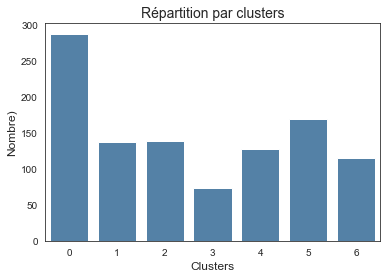

In [576]:
outils_nlp.affiche_repartition_par_clusters(kmeans_acptsne_cv_prod_stem_labels)

In [577]:
# Les catégories par clusters
df_acptsne_cv_prod_stem.groupby('Clusters')['CATEGORIE'].value_counts() \
    .to_frame()

CATEGORIE
Clusters CATEGORIE                            
0        Home Decor & Festive Needs        132
         Beauty and Personal Care           51
         Kitchen & Dining                   34
         Baby Care                          25
         Watches                            22
         Home Furnishing                    15
         Computers                           9
1        Baby Care                         100
         Home Furnishing                    37
         Home Decor & Festive Needs          1
2        Computers                          94
         Kitchen & Dining                   32
         Home Decor & Festive Needs         13
3        Kitchen & Dining                   73
4        Watches                           128
5        Home Furnishing                    98
         Computers                          45
         Baby Care                          24
         Beauty and Personal Care            1
         Home Decor & Festive Needs          1
6        Beauty and Personal Care           98
         Kitchen & Dining                   11
         Home Decor & Festive Needs          3
         Computers                           2
         Baby Care                           1

**Visualisation des clusters**

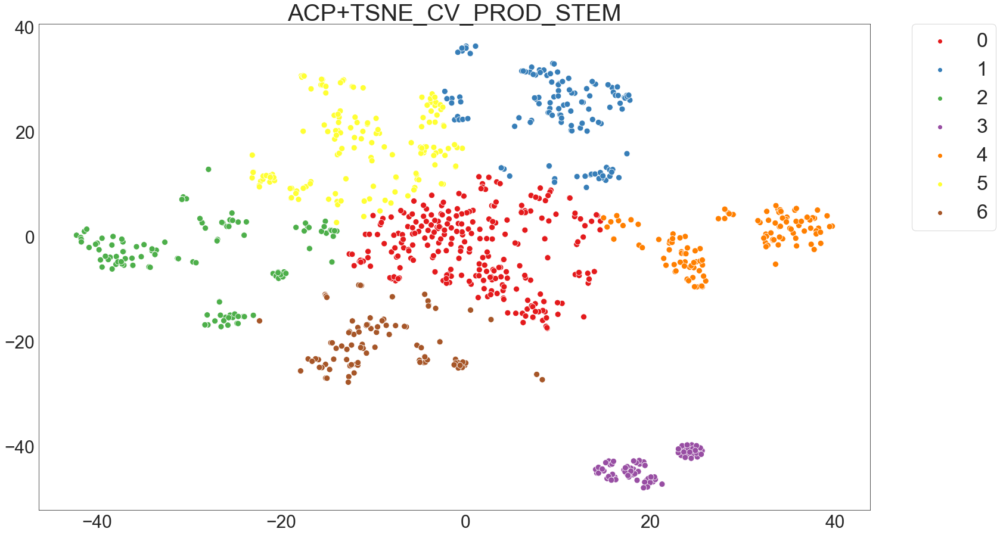

In [578]:
# Visualisation des clusters
outils_nlp.affiche_projection_par_clusters(X_proj_acptsne_cv_prod_stem,
                                           kmeans_acptsne_cv_prod_stem_labels,
                                           type_donnee)

**Bilan** :
***
- Le score ARI est assez haut (0.56).
- Les 7 catégories sont bien trouvées avec cependant quelques mélanges :
    - Cluster 0 : Home Decor & Festive Needs
    - Cluster 1 : Baby Care
    - Cluster 2 : Computers
    - Cluster 3 : Kitchen & Dining
    - Cluster 4 : Watches
    - Cluster 5 : Home Furnishing
    - Cluster 6 : Beauty and Personal Care
- Cette combinaison ACP+TSNE CountVectorizer + produit spécification lemmatisé parvient à retrouver les 7 catégories comme le souhaite notre client. Il reste à mesurer la qualité de cette catégorisation (69%).

**Qualité de la catégorisation ?**

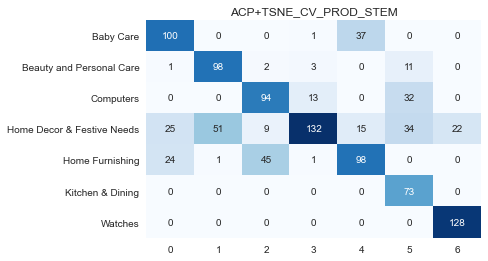

'Précision: 68.86%'

                            precision    recall  f1-score   support

                 Baby Care       0.67      0.72      0.69       138
  Beauty and Personal Care       0.65      0.85      0.74       115
                 Computers       0.63      0.68      0.65       139
Home Decor & Festive Needs       0.88      0.46      0.60       288
           Home Furnishing       0.65      0.58      0.61       169
          Kitchen & Dining       0.49      1.00      0.65        73
                   Watches       0.85      1.00      0.92       128

                  accuracy                           0.69      1050
                 macro avg       0.69      0.76      0.70      1050
              weighted avg       0.73      0.69      0.68      1050


In [579]:
dico_categories = {'0': 'Home Decor & Festive Needs',
                   '1': 'Baby Care',
                   '2': 'Computers',
                   '3': 'Kitchen & Dining',
                   '4': 'Watches',
                   '5': 'Home Furnishing',
                   '6': 'Beauty and Personal Care'}
outils_nlp.affiche_qualite_categorisation(df_acptsne_cv_prod_stem,
                                          dico_categories, type_donnee)

In [580]:
# Sauvegarde des précisions de la catégorisation
df_precision = outils_nlp.sauvegarde_precision(df_precision, '69',
                                               type_donnee)
# Sauvegarde des dataframes de trace
outils_data.to_csv(df_precision, 'data_df_precision.csv')

### <span style='background:PowderBlue'>6.9. ACP+TSNE BOW TfidfVectorizer</span>

**description** - lemmatisée
***

**Recherche des meilleurs hyperparamètres**

In [581]:
type_donnee = 'ACP+TSNE_TFIDF_DESC_LEM'

In [582]:
# Tuning hyperparametres n_init, max_iter
# Paramètres à tester
n_init = [10, 20, 30, 50, 70, 80, 100]
max_iter = [100, 200, 300, 400, 500]
# Métriques avec les différentes combinaisons des paramètres
df_metrics_kmeans = \
    outils_nlp.calcul_metrics_kmeans(df_acptsne_tfidf_desc_lem[cols],
                                     df_metrics_kmeans,
                                     type_donnee,
                                     seed, n_init, max_iter)
# Tri par indice de dispersion : proche de 0
df_metrics_kmeans[df_metrics_kmeans['Type_données'] == type_donnee] \
    .sort_values(by=['coef_silh', 'davies_bouldin', 'Durée (s)'],
                 ascending=[False, True, True]).style.hide_index()

Type_données,n_init,max_iter,coef_silh,dispersion,davies_bouldin,Durée (s)
ACP+TSNE_TFIDF_DESC_LEM,30,200,0.42111,113494.86719,0.74649,0.18550
ACP+TSNE_TFIDF_DESC_LEM,30,100,0.42111,113494.85938,0.74649,0.19747
ACP+TSNE_TFIDF_DESC_LEM,30,400,0.42111,113494.85156,0.74649,0.20046
ACP+TSNE_TFIDF_DESC_LEM,30,500,0.42111,113494.85938,0.74649,0.20146
ACP+TSNE_TFIDF_DESC_LEM,30,300,0.42111,113494.85938,0.74649,0.20246
ACP+TSNE_TFIDF_DESC_LEM,50,500,0.42063,113473.01562,0.74586,0.32378
ACP+TSNE_TFIDF_DESC_LEM,50,400,0.42063,113473.00781,0.74586,0.32696
ACP+TSNE_TFIDF_DESC_LEM,50,200,0.42063,113473.00781,0.74586,0.33190
ACP+TSNE_TFIDF_DESC_LEM,50,300,0.42063,113473.00781,0.74586,0.35804
ACP+TSNE_TFIDF_DESC_LEM,50,100,0.42063,113473.00781,0.74586,0.37201


In [583]:
# Sauvegarde des dataframes de trace
outils_data.to_csv(df_metrics_kmeans, 'data_df_metrics_kmeans.csv')

**Clustering**

In [584]:
# Instanciation du modèle KMeans avec les meilleurs paramètres
kmeans_acptsne_tfidf_desc_lem = KMeans(n_clusters=7, init='k-means++',
                                       n_init=30, max_iter=200,
                                       random_state=seed) \
    .fit(df_acptsne_tfidf_desc_lem[cols])
# Ajout de l'assignation du cluster au dataframe
df_acptsne_tfidf_desc_lem['Clusters'] = kmeans_acptsne_tfidf_desc_lem.labels_
kmeans_acptsne_tfidf_desc_lem_labels = kmeans_acptsne_tfidf_desc_lem.labels_

In [585]:
# Scores ?
df_scores = outils_nlp.calcul_metriques_clusters(df_acptsne_tfidf_desc_lem,
                                                 df_scores,
                                                 type_donnee)
df_scores.style.hide_index()

Type_données,ARI,Homogénéité,Complétude,V-measure
ACP_CV_DESC_LEM,0.03894,0.11797,0.20952,0.15095
ACP_CV_DESC_STEM,0.04503,0.11941,0.19802,0.14898
ACP_CV_PROD_LEM,0.10551,0.26012,0.58404,0.35994
ACP_CV_PROD_STEM,0.10015,0.25417,0.57940,0.35334
ACP_TFIDF_DESC_LEM,0.14925,0.34720,0.53091,0.41984
ACP_TFIDF_DESC_STEM,0.14698,0.34728,0.52762,0.41886
ACP_TFIDF_PROD_LEM,0.20215,0.37890,0.48553,0.42564
ACP_TFIDF_PROD_STEM,0.21837,0.39724,0.50516,0.44475
ACP_HASH_DESC_LEM,0.03915,0.11095,0.19437,0.14126
ACP_HASH_DESC_STEM,0.04546,0.11990,0.20162,0.15037


In [586]:
# Sauvegarde des dataframes de trace
outils_data.to_csv(df_scores, 'data_df_scores.csv')

Clusters,Nombre,%
0,149,14.19000
1,145,13.81000
2,121,11.52000
3,114,10.86000
4,193,18.38000
5,152,14.48000
6,176,16.76000


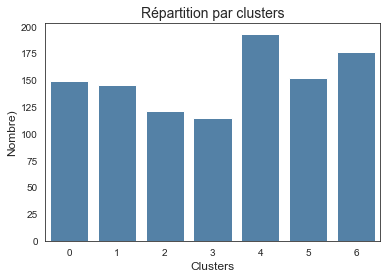

In [587]:
outils_nlp \
    .affiche_repartition_par_clusters(kmeans_acptsne_tfidf_desc_lem_labels)

In [588]:
# Les catégories par clusters
df_acptsne_tfidf_desc_lem.groupby('Clusters')['CATEGORIE'].value_counts() \
    .to_frame()

CATEGORIE
Clusters CATEGORIE                            
0        Home Decor & Festive Needs         90
         Kitchen & Dining                   33
         Baby Care                          11
         Beauty and Personal Care           11
         Home Furnishing                     4
1        Computers                         122
         Home Decor & Festive Needs         13
         Kitchen & Dining                    7
         Beauty and Personal Care            2
         Watches                             1
2        Kitchen & Dining                   74
         Home Furnishing                    44
         Baby Care                           2
         Home Decor & Festive Needs          1
3        Beauty and Personal Care           86
         Home Furnishing                    11
         Baby Care                           9
         Computers                           4
         Home Decor & Festive Needs          2
         Kitchen & Dining                    2
4        Baby Care                         106
         Home Furnishing                    86
         Kitchen & Dining                    1
5        Watches                           149
         Computers                           3
6        Beauty and Personal Care           51
         Home Decor & Festive Needs         44
         Kitchen & Dining                   33
         Baby Care                          22
         Computers                          21
         Home Furnishing                     5

**Visualisation des clusters**

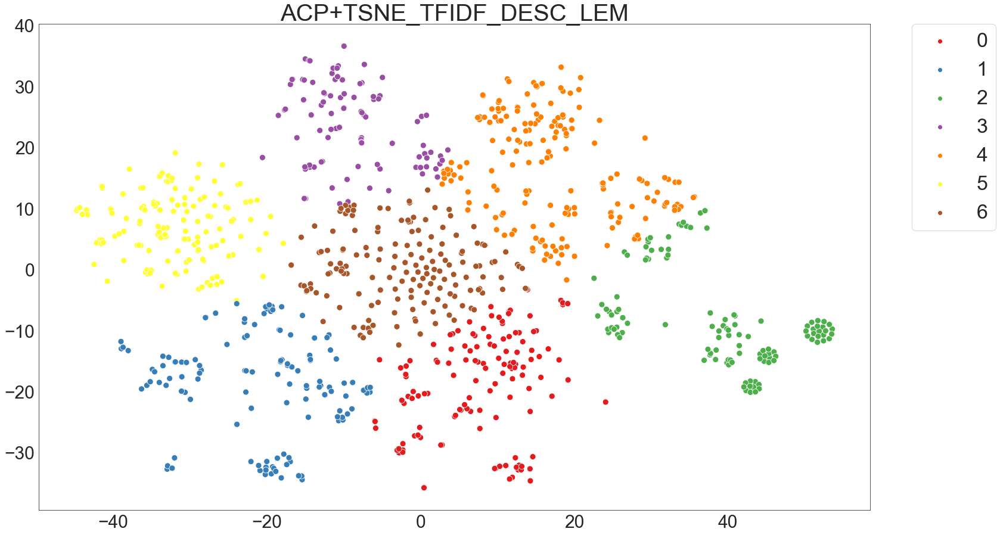

In [589]:
# Visualisation des clusters
outils_nlp \
    .affiche_projection_par_clusters(X_proj_acptsne_tfidf_desc_lem,
                                     kmeans_acptsne_tfidf_desc_lem_labels,
                                     type_donnee)

**Bilan** :
***
- Le score ARI est moyen (0.46).
- Les 7 catégories sont bien trouvées avec cependant quelques mélanges :
    - Cluster 0 : Home Decor & Festive Needs
    - Cluster 1 : Computers
    - Cluster 2 : Kitchen & Dining
    - Cluster 3 : Beauty and Personal Care
    - Cluster 4 : Baby Care
    - Cluster 5 : Watches
    - Cluster 6 : Kitchen & Dining
- Cette combinaison ACP+TSNE tFIDFVectorizer + description lemmatisée parvient à retrouver les 7 catégories comme le souhaite notre client. Il reste à mesurer la qualité de cette catégorisation (65%).

**Qualité de la catégorisation ?**

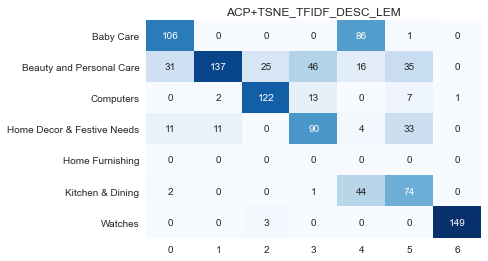

'Précision: 64.57%'

                            precision    recall  f1-score   support

                 Baby Care       0.71      0.55      0.62       193
  Beauty and Personal Care       0.91      0.47      0.62       290
                 Computers       0.81      0.84      0.83       145
Home Decor & Festive Needs       0.60      0.60      0.60       149
           Home Furnishing       0.00      0.00      0.00         0
          Kitchen & Dining       0.49      0.61      0.55       121
                   Watches       0.99      0.98      0.99       152

                  accuracy                           0.65      1050
                 macro avg       0.65      0.58      0.60      1050
              weighted avg       0.78      0.65      0.69      1050


In [590]:
dico_categories = {'0': 'Home Decor & Festive Needs',
                   '1': 'Computers',
                   '2': 'Kitchen & Dining',
                   '3': 'Beauty and Personal Care',
                   '4': 'Baby Care',
                   '5': 'Watches',
                   '6': 'Beauty and Personal Care'}
outils_nlp.affiche_qualite_categorisation(df_acptsne_tfidf_desc_lem,
                                          dico_categories, type_donnee)

In [591]:
# Sauvegarde des précisions de la catégorisation
df_precision = outils_nlp.sauvegarde_precision(df_precision, '65',
                                               type_donnee)
# Sauvegarde des dataframes de trace
outils_data.to_csv(df_precision, 'data_df_precision.csv')

**description** - stemmatisée
***

**Recherche des meilleurs hyperparamètres**

In [592]:
type_donnee = 'ACP+TSNE_TFIDF_DESC_STEM'

In [593]:
# Tuning hyperparametres n_init, max_iter
# Paramètres à tester
n_init = [10, 20, 30, 50, 70, 80, 100]
max_iter = [100, 200, 300, 400, 500]
# Métriques avec les différentes combinaisons des paramètres
df_metrics_kmeans = \
    outils_nlp.calcul_metrics_kmeans(df_acptsne_tfidf_desc_stem[cols],
                                     df_metrics_kmeans,
                                     type_donnee,
                                     seed, n_init, max_iter)
# Tri par indice de dispersion : proche de 0
df_metrics_kmeans[df_metrics_kmeans['Type_données'] == type_donnee] \
    .sort_values(by=['coef_silh', 'davies_bouldin', 'Durée (s)'],
                 ascending=[False, True, True]).style.hide_index()

Type_données,n_init,max_iter,coef_silh,dispersion,davies_bouldin,Durée (s)
ACP+TSNE_TFIDF_DESC_STEM,70,400,0.43615,107222.87500,0.73143,0.46963
ACP+TSNE_TFIDF_DESC_STEM,30,100,0.43615,107222.88281,0.73143,0.20027
ACP+TSNE_TFIDF_DESC_STEM,30,500,0.43615,107222.87500,0.73143,0.20149
ACP+TSNE_TFIDF_DESC_STEM,30,200,0.43615,107222.88281,0.73143,0.20958
ACP+TSNE_TFIDF_DESC_STEM,30,400,0.43615,107222.88281,0.73143,0.21374
ACP+TSNE_TFIDF_DESC_STEM,30,300,0.43615,107222.87500,0.73143,0.21526
ACP+TSNE_TFIDF_DESC_STEM,50,200,0.43615,107222.87500,0.73143,0.33021
ACP+TSNE_TFIDF_DESC_STEM,50,100,0.43615,107222.87500,0.73143,0.34020
ACP+TSNE_TFIDF_DESC_STEM,50,400,0.43615,107222.87500,0.73143,0.34109
ACP+TSNE_TFIDF_DESC_STEM,50,300,0.43615,107222.87500,0.73143,0.35560


In [594]:
# Sauvegarde des dataframes de trace
outils_data.to_csv(df_metrics_kmeans, 'data_df_metrics_kmeans.csv')

**Clustering**

In [595]:
# Instanciation du modèle KMeans avec les meilleurs paramètres
kmeans_acptsne_tfidf_desc_stem = KMeans(n_clusters=7, init='k-means++',
                                        n_init=70, max_iter=400,
                                        random_state=seed) \
    .fit(df_acptsne_tfidf_desc_stem[cols])
# Ajout de l'assignation du cluster au dataframe
df_acptsne_tfidf_desc_stem['Clusters'] = kmeans_acptsne_tfidf_desc_stem.labels_
kmeans_acptsne_tfidf_desc_stem_labels = kmeans_acptsne_tfidf_desc_stem.labels_

In [596]:
# Scores ?
df_scores = outils_nlp.calcul_metriques_clusters(df_acptsne_tfidf_desc_stem,
                                                 df_scores,
                                                 type_donnee)
df_scores.style.hide_index()

Type_données,ARI,Homogénéité,Complétude,V-measure
ACP_CV_DESC_LEM,0.03894,0.11797,0.20952,0.15095
ACP_CV_DESC_STEM,0.04503,0.11941,0.19802,0.14898
ACP_CV_PROD_LEM,0.10551,0.26012,0.58404,0.35994
ACP_CV_PROD_STEM,0.10015,0.25417,0.57940,0.35334
ACP_TFIDF_DESC_LEM,0.14925,0.34720,0.53091,0.41984
ACP_TFIDF_DESC_STEM,0.14698,0.34728,0.52762,0.41886
ACP_TFIDF_PROD_LEM,0.20215,0.37890,0.48553,0.42564
ACP_TFIDF_PROD_STEM,0.21837,0.39724,0.50516,0.44475
ACP_HASH_DESC_LEM,0.03915,0.11095,0.19437,0.14126
ACP_HASH_DESC_STEM,0.04546,0.11990,0.20162,0.15037


In [597]:
# Sauvegarde des dataframes de trace
outils_data.to_csv(df_scores, 'data_df_scores.csv')

Clusters,Nombre,%
0,147,14.00000
1,194,18.48000
2,153,14.57000
3,162,15.43000
4,146,13.90000
5,170,16.19000
6,78,7.43000


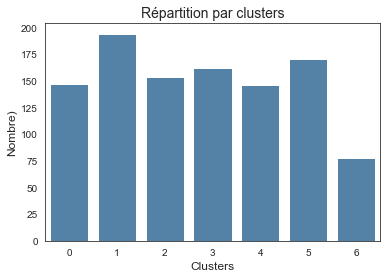

In [598]:
outils_nlp \
    .affiche_repartition_par_clusters(kmeans_acptsne_tfidf_desc_stem_labels)

In [599]:
# Les catégories par clusters
df_acptsne_tfidf_desc_stem.groupby('Clusters')['CATEGORIE'].value_counts() \
    .to_frame()

CATEGORIE
Clusters CATEGORIE                            
0        Home Furnishing                   116
         Baby Care                          22
         Home Decor & Festive Needs          7
         Kitchen & Dining                    2
1        Beauty and Personal Care           55
         Baby Care                          45
         Kitchen & Dining                   39
         Home Decor & Festive Needs         23
         Computers                          19
         Home Furnishing                    13
2        Home Decor & Festive Needs        104
         Kitchen & Dining                   25
         Baby Care                          13
         Beauty and Personal Care           10
         Computers                           1
3        Watches                           148
         Computers                          10
         Baby Care                           3
         Kitchen & Dining                    1
4        Computers                         120
         Home Decor & Festive Needs         13
         Kitchen & Dining                    7
         Baby Care                           2
         Beauty and Personal Care            2
         Watches                             2
5        Beauty and Personal Care           83
         Baby Care                          63
         Home Furnishing                    21
         Home Decor & Festive Needs          3
6        Kitchen & Dining                   76
         Baby Care                           2

**Visualisation des clusters**

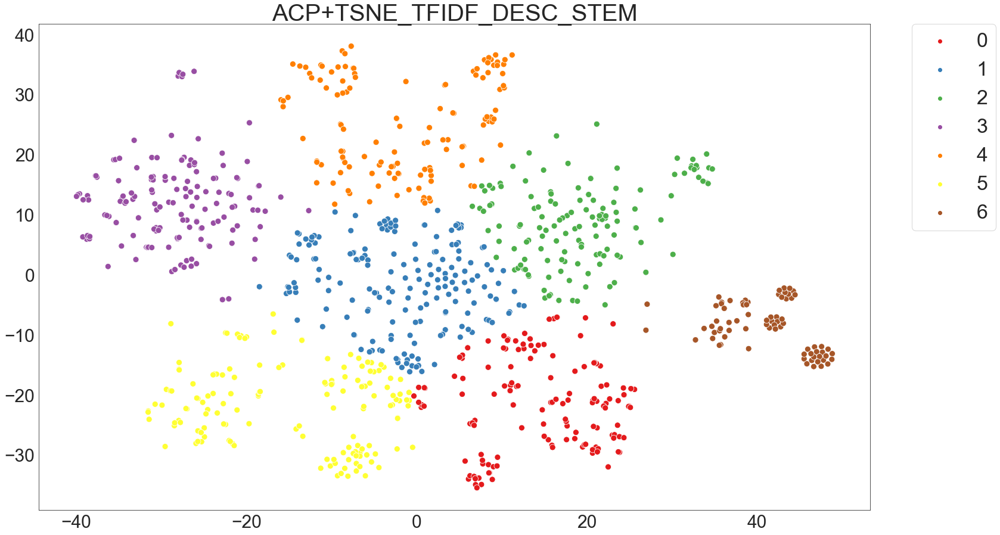

In [600]:
# Visualisation des clusters
outils_nlp \
    .affiche_projection_par_clusters(X_proj_acptsne_tfidf_desc_stem,
                                     kmeans_acptsne_tfidf_desc_stem_labels,
                                     type_donnee)

**Bilan** :
***
- Le score ARI est moyen (0.45).
- Cette combinaison ACP+TSNE TfidfVectorizer + description stemmatisée ne parvient pas à retrouver les 7 catégories comme le souhaite notre client. 

In [601]:
# Sauvegarde des précisions de la catégorisation
df_precision = outils_nlp.sauvegarde_precision(df_precision, '0',
                                               type_donnee)
# Sauvegarde des dataframes de trace
outils_data.to_csv(df_precision, 'data_df_precision.csv')

**produit_specification** - lemmatisée
***

**Recherche des meilleurs hyperparamètres**

In [602]:
type_donnee = 'ACP+TSNE_TFIDF_PROD_LEM'

In [603]:
# Tuning hyperparametres n_init, max_iter
# Paramètres à tester
n_init = [10, 20, 30, 50, 70, 80, 100]
max_iter = [100, 200, 300, 400, 500]
# Métriques avec les différentes combinaisons des paramètres
df_metrics_kmeans = \
    outils_nlp.calcul_metrics_kmeans(df_acptsne_tfidf_prod_lem[cols],
                                     df_metrics_kmeans,
                                     type_donnee,
                                     seed, n_init, max_iter)
# Tri par indice de dispersion : proche de 0
df_metrics_kmeans[df_metrics_kmeans['Type_données'] == type_donnee] \
    .sort_values(by=['coef_silh', 'davies_bouldin', 'Durée (s)'],
                 ascending=[False, True, True]).style.hide_index()

Type_données,n_init,max_iter,coef_silh,dispersion,davies_bouldin,Durée (s)
ACP+TSNE_TFIDF_PROD_LEM,10,300,0.49173,83366.27344,0.73826,0.04987
ACP+TSNE_TFIDF_PROD_LEM,10,200,0.49173,83366.27344,0.73826,0.05086
ACP+TSNE_TFIDF_PROD_LEM,10,400,0.49173,83366.28125,0.73826,0.05086
ACP+TSNE_TFIDF_PROD_LEM,10,500,0.49173,83366.27344,0.73826,0.05086
ACP+TSNE_TFIDF_PROD_LEM,10,100,0.49173,83366.27344,0.73826,0.05286
ACP+TSNE_TFIDF_PROD_LEM,20,400,0.49173,83366.27344,0.73826,0.09674
ACP+TSNE_TFIDF_PROD_LEM,20,500,0.49173,83366.26562,0.73826,0.09674
ACP+TSNE_TFIDF_PROD_LEM,20,300,0.49173,83366.27344,0.73826,0.09677
ACP+TSNE_TFIDF_PROD_LEM,20,200,0.49173,83366.27344,0.73826,0.09777
ACP+TSNE_TFIDF_PROD_LEM,20,100,0.49173,83366.27344,0.73826,0.09973


In [604]:
# Sauvegarde des dataframes de trace
outils_data.to_csv(df_metrics_kmeans, 'data_df_metrics_kmeans.csv')

**Clustering**

In [605]:
# Instanciation du modèle KMeans avec les meilleurs paramètres
kmeans_acptsne_tfidf_prod_lem = KMeans(n_clusters=7, init='k-means++',
                                       n_init=10, max_iter=300,
                                       random_state=seed) \
    .fit(df_acptsne_tfidf_prod_lem[cols])
# Ajout de l'assignation du cluster au dataframe
df_acptsne_tfidf_prod_lem['Clusters'] = kmeans_acptsne_tfidf_prod_lem.labels_
kmeans_acptsne_tfidf_prod_lem_labels = kmeans_acptsne_tfidf_prod_lem.labels_

In [606]:
# Scores ?
df_scores = outils_nlp.calcul_metriques_clusters(df_acptsne_tfidf_prod_lem,
                                                 df_scores,
                                                 type_donnee)
df_scores.style.hide_index()

Type_données,ARI,Homogénéité,Complétude,V-measure
ACP_CV_DESC_LEM,0.03894,0.11797,0.20952,0.15095
ACP_CV_DESC_STEM,0.04503,0.11941,0.19802,0.14898
ACP_CV_PROD_LEM,0.10551,0.26012,0.58404,0.35994
ACP_CV_PROD_STEM,0.10015,0.25417,0.57940,0.35334
ACP_TFIDF_DESC_LEM,0.14925,0.34720,0.53091,0.41984
ACP_TFIDF_DESC_STEM,0.14698,0.34728,0.52762,0.41886
ACP_TFIDF_PROD_LEM,0.20215,0.37890,0.48553,0.42564
ACP_TFIDF_PROD_STEM,0.21837,0.39724,0.50516,0.44475
ACP_HASH_DESC_LEM,0.03915,0.11095,0.19437,0.14126
ACP_HASH_DESC_STEM,0.04546,0.11990,0.20162,0.15037


In [607]:
# Sauvegarde des dataframes de trace
outils_data.to_csv(df_scores, 'data_df_scores.csv')

Clusters,Nombre,%
0,168,16.00000
1,171,16.29000
2,139,13.24000
3,77,7.33000
4,191,18.19000
5,150,14.29000
6,154,14.67000


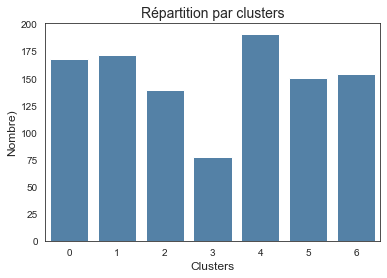

In [608]:
outils_nlp \
    .affiche_repartition_par_clusters(kmeans_acptsne_tfidf_prod_lem_labels)

In [609]:
# Les catégories par clusters
df_acptsne_tfidf_prod_lem.groupby('Clusters')['CATEGORIE'].value_counts() \
    .to_frame()

CATEGORIE
Clusters CATEGORIE                            
0        Home Furnishing                    98
         Baby Care                          38
         Computers                          11
         Kitchen & Dining                   10
         Home Decor & Festive Needs          6
         Beauty and Personal Care            5
1        Home Decor & Festive Needs        122
         Kitchen & Dining                   14
         Beauty and Personal Care           13
         Baby Care                          11
         Computers                           5
         Home Furnishing                     5
         Watches                             1
2        Baby Care                          92
         Home Furnishing                    47
3        Kitchen & Dining                   76
         Baby Care                           1
4        Computers                         131
         Kitchen & Dining                   37
         Home Decor & Festive Needs         20
         Beauty and Personal Care            3
5        Watches                           149
         Home Decor & Festive Needs          1
6        Beauty and Personal Care          129
         Kitchen & Dining                   13
         Baby Care                           8
         Computers                           3
         Home Decor & Festive Needs          1

**Visualisation des clusters**

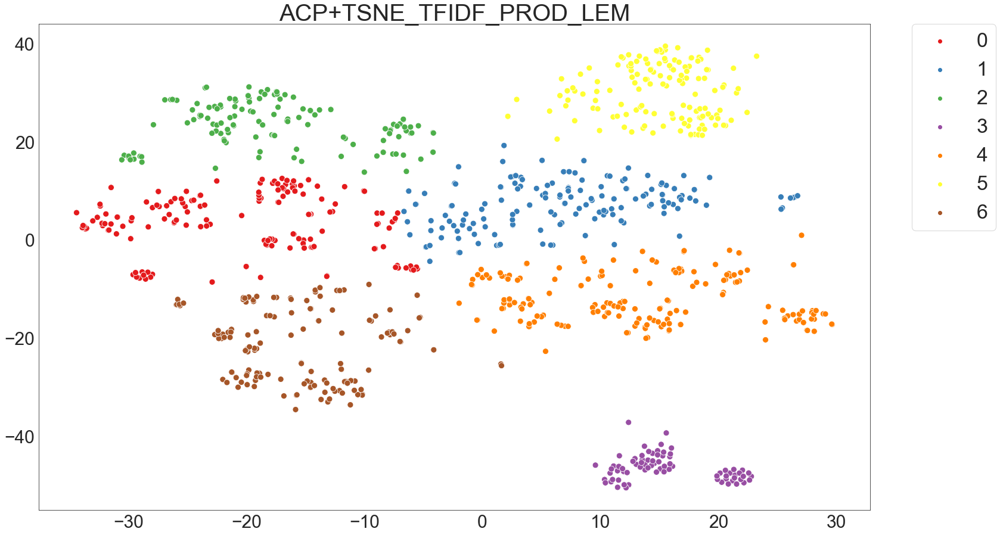

In [610]:
# Visualisation des clusters
outils_nlp \
    .affiche_projection_par_clusters(X_proj_acptsne_tfidf_prod_lem,
                                     kmeans_acptsne_tfidf_prod_lem_labels,
                                     type_donnee)

**Bilan** :
***
- Le score ARI est assez haut (0.63).
- Les 7 catégories sont bien trouvées avec cependant quelques mélanges :
    - Cluster 0 : Home Furnishing
    - Cluster 1 : Home Decor & Festive Needs
    - Cluster 2 : Baby Care
    - Cluster 3 : Kitchen & Dining
    - Cluster 4 : Computers
    - Cluster 5 : Watches
    - Cluster 6 : Beauty and Personal Care
- Cette combinaison ACP+TSNE TfidfVectorizer + produit spécification lemmatisé parvient à retrouver les 7 catégories comme le souhaite notre client. Il reste à mesurer la qualité de cette catégorisation (76%).

**Qualité de la catégorisation ?**

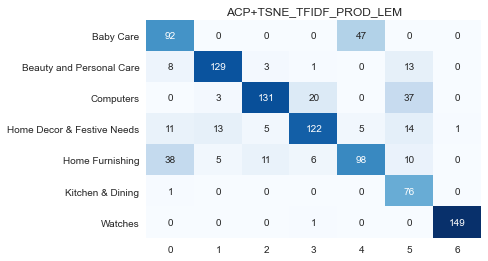

'Précision: 75.9%'

                            precision    recall  f1-score   support

                 Baby Care       0.61      0.66      0.64       139
  Beauty and Personal Care       0.86      0.84      0.85       154
                 Computers       0.87      0.69      0.77       191
Home Decor & Festive Needs       0.81      0.71      0.76       171
           Home Furnishing       0.65      0.58      0.62       168
          Kitchen & Dining       0.51      0.99      0.67        77
                   Watches       0.99      0.99      0.99       150

                  accuracy                           0.76      1050
                 macro avg       0.76      0.78      0.76      1050
              weighted avg       0.78      0.76      0.76      1050


In [611]:
dico_categories = {'0': 'Home Furnishing',
                   '1': 'Home Decor & Festive Needs',
                   '2': 'Baby Care',
                   '3': 'Kitchen & Dining',
                   '4': 'Computers',
                   '5': 'Watches',
                   '6': 'Beauty and Personal Care'}
outils_nlp.affiche_qualite_categorisation(df_acptsne_tfidf_prod_lem,
                                          dico_categories, type_donnee)

In [612]:
# Sauvegarde des précisions de la catégorisation
df_precision = outils_nlp.sauvegarde_precision(df_precision, '76',
                                               type_donnee)
# Sauvegarde des dataframes de trace
outils_data.to_csv(df_precision, 'data_df_precision.csv')

**produit_specification** - stemmatisée
***

**Recherche des meilleurs hyperparamètres**

In [613]:
type_donnee = 'ACP+TSNE_TFIDF_PROD_STEM'

In [614]:
# Tuning hyperparametres n_init, max_iter
# Paramètres à tester
n_init = [10, 20, 30, 50, 70, 80, 100]
max_iter = [100, 200, 300, 400, 500]
# Métriques avec les différentes combinaisons des paramètres
df_metrics_kmeans = \
    outils_nlp.calcul_metrics_kmeans(df_acptsne_tfidf_prod_stem[cols],
                                     df_metrics_kmeans,
                                     type_donnee,
                                     seed, n_init, max_iter)
# Tri par indice de dispersion : proche de 0
df_metrics_kmeans[df_metrics_kmeans['Type_données'] == type_donnee] \
    .sort_values(by=['coef_silh', 'davies_bouldin', 'Durée (s)'],
                 ascending=[False, True, True]).style.hide_index()

Type_données,n_init,max_iter,coef_silh,dispersion,davies_bouldin,Durée (s)
ACP+TSNE_TFIDF_PROD_STEM,20,400,0.48650,78872.18750,0.72351,0.11971
ACP+TSNE_TFIDF_PROD_STEM,20,500,0.48650,78872.18750,0.72351,0.12071
ACP+TSNE_TFIDF_PROD_STEM,20,100,0.48650,78872.18750,0.72351,0.12167
ACP+TSNE_TFIDF_PROD_STEM,20,200,0.48650,78872.18750,0.72351,0.12167
ACP+TSNE_TFIDF_PROD_STEM,20,300,0.48650,78872.18750,0.72351,0.12267
ACP+TSNE_TFIDF_PROD_STEM,30,300,0.48650,78872.18750,0.72351,0.17753
ACP+TSNE_TFIDF_PROD_STEM,30,400,0.48650,78872.18750,0.72351,0.17952
ACP+TSNE_TFIDF_PROD_STEM,30,200,0.48650,78872.18750,0.72351,0.18054
ACP+TSNE_TFIDF_PROD_STEM,30,500,0.48650,78872.18750,0.72351,0.18351
ACP+TSNE_TFIDF_PROD_STEM,30,100,0.48650,78872.18750,0.72351,0.18650


In [615]:
# Sauvegarde des dataframes de trace
outils_data.to_csv(df_metrics_kmeans, 'data_df_metrics_kmeans.csv')

**Clustering**

In [616]:
# Instanciation du modèle KMeans avec les meilleurs paramètres
kmeans_acptsne_tfidf_prod_stem = KMeans(n_clusters=7, init='k-means++',
                                        n_init=20, max_iter=400,
                                        random_state=seed) \
    .fit(df_acptsne_tfidf_prod_stem[cols])
# Ajout de l'assignation du cluster au dataframe
df_acptsne_tfidf_prod_stem['Clusters'] = kmeans_acptsne_tfidf_prod_stem.labels_
kmeans_acptsne_tfidf_prod_stem_labels = kmeans_acptsne_tfidf_prod_stem.labels_

In [617]:
# Scores ?
df_scores = outils_nlp.calcul_metriques_clusters(df_acptsne_tfidf_prod_stem,
                                                 df_scores,
                                                 type_donnee)
df_scores.style.hide_index()

Type_données,ARI,Homogénéité,Complétude,V-measure
ACP_CV_DESC_LEM,0.03894,0.11797,0.20952,0.15095
ACP_CV_DESC_STEM,0.04503,0.11941,0.19802,0.14898
ACP_CV_PROD_LEM,0.10551,0.26012,0.58404,0.35994
ACP_CV_PROD_STEM,0.10015,0.25417,0.57940,0.35334
ACP_TFIDF_DESC_LEM,0.14925,0.34720,0.53091,0.41984
ACP_TFIDF_DESC_STEM,0.14698,0.34728,0.52762,0.41886
ACP_TFIDF_PROD_LEM,0.20215,0.37890,0.48553,0.42564
ACP_TFIDF_PROD_STEM,0.21837,0.39724,0.50516,0.44475
ACP_HASH_DESC_LEM,0.03915,0.11095,0.19437,0.14126
ACP_HASH_DESC_STEM,0.04546,0.11990,0.20162,0.15037


6:1: W391 blank line at end of file


In [618]:
# Sauvegarde des dataframes de trace
outils_data.to_csv(df_scores, 'data_df_scores.csv')

Clusters,Nombre,%
0,153,14.57000
1,163,15.52000
2,164,15.62000
3,144,13.71000
4,210,20.00000
5,76,7.24000
6,140,13.33000


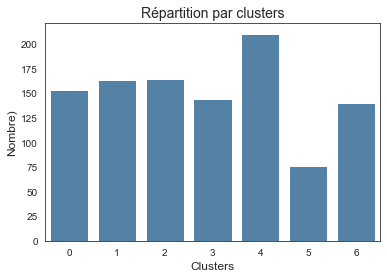

In [619]:
outils_nlp \
    .affiche_repartition_par_clusters(kmeans_acptsne_tfidf_prod_stem_labels)

In [620]:
# Les catégories par clusters
df_acptsne_tfidf_prod_stem.groupby('Clusters')['CATEGORIE'].value_counts() \
    .to_frame()

CATEGORIE
Clusters CATEGORIE                            
0        Watches                           150
         Home Decor & Festive Needs          3
1        Beauty and Personal Care          121
         Kitchen & Dining                   29
         Baby Care                           7
         Computers                           3
         Home Decor & Festive Needs          3
2        Computers                         129
         Kitchen & Dining                   27
         Home Decor & Festive Needs          5
         Beauty and Personal Care            3
3        Baby Care                          89
         Home Furnishing                    55
4        Home Decor & Festive Needs        139
         Baby Care                          21
         Kitchen & Dining                   19
         Beauty and Personal Care           17
         Computers                           7
         Home Furnishing                     7
5        Kitchen & Dining                   75
         Baby Care                           1
6        Home Furnishing                    88
         Baby Care                          32
         Computers                          11
         Beauty and Personal Care            9

**Visualisation des clusters**

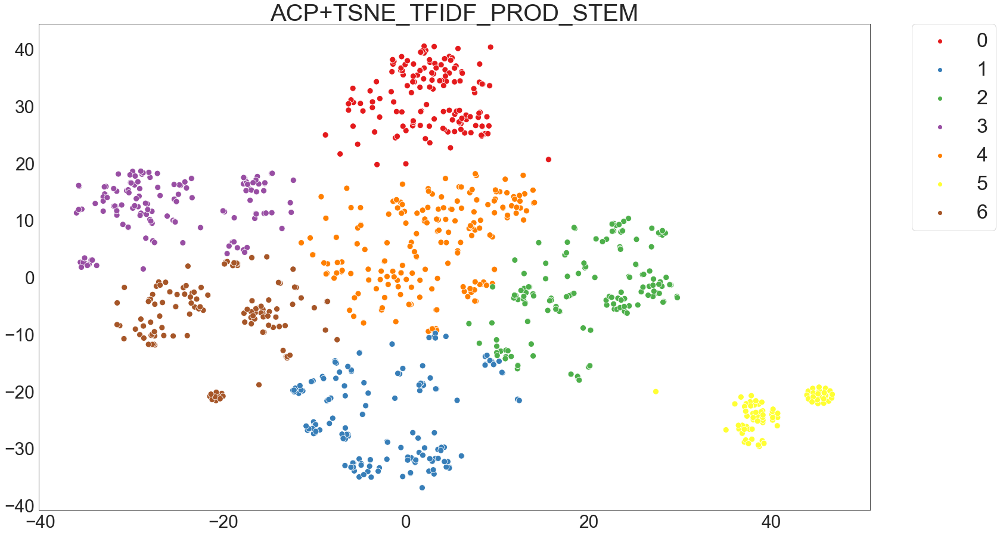

In [621]:
# Visualisation des clusters
outils_nlp \
    .affiche_projection_par_clusters(X_proj_acptsne_tfidf_prod_stem,
                                     kmeans_acptsne_tfidf_prod_stem_labels,
                                     type_donnee)

**Bilan** :
***
- Le score ARI est moyen (0.57).
- Les 7 catégories sont bien trouvées avec cependant quelques mélanges :
    - Cluster 0 : HWatches
    - Cluster 1 : Beauty and Personal Care
    - Cluster 2 : Computers
    - Cluster 3 : Baby Care
    - Cluster 4 : Home Decor & Festive Needs
    - Cluster 5 : Kitchen & Dining
    - Cluster 6 : Home Furnishing
- Cette combinaison ACP+TSNE TfidfVectorizer + produit spécification stemmatisé parvient à retrouver les 7 catégories comme le souhaite notre client. Il reste à mesurer la qualité de cette catégorisation (75%).

**Qualité de la catégorisation ?**

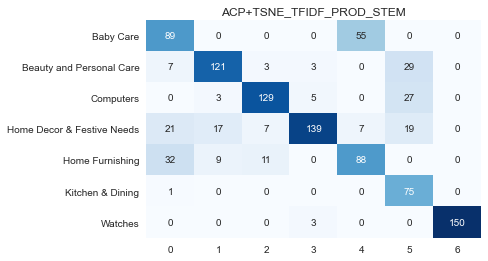

'Précision: 75.33%'

                            precision    recall  f1-score   support

                 Baby Care       0.59      0.62      0.61       144
  Beauty and Personal Care       0.81      0.74      0.77       163
                 Computers       0.86      0.79      0.82       164
Home Decor & Festive Needs       0.93      0.66      0.77       210
           Home Furnishing       0.59      0.63      0.61       140
          Kitchen & Dining       0.50      0.99      0.66        76
                   Watches       1.00      0.98      0.99       153

                  accuracy                           0.75      1050
                 macro avg       0.75      0.77      0.75      1050
              weighted avg       0.79      0.75      0.76      1050


In [622]:
dico_categories = {'0': 'Watches',
                   '1': 'Beauty and Personal Care',
                   '2': 'Computers',
                   '3': 'Baby Care',
                   '4': 'Home Decor & Festive Needs',
                   '5': 'Kitchen & Dining',
                   '6': 'Home Furnishing'}
outils_nlp.affiche_qualite_categorisation(df_acptsne_tfidf_prod_stem,
                                          dico_categories, type_donnee)

In [623]:
# Sauvegarde des précisions de la catégorisation
df_precision = outils_nlp.sauvegarde_precision(df_precision, '75',
                                               type_donnee)
# Sauvegarde des dataframes de trace
outils_data.to_csv(df_precision, 'data_df_precision.csv')

### <span style='background:PowderBlue'>6.10. ACP+TSNE BOW HashingVectorizer</span>

**description** - lemmatisée
***

**Recherche des meilleurs hyperparamètres**

In [624]:
type_donnee = 'ACP+TSNE_HASH_DESC_LEM'

In [639]:
# Tuning hyperparametres n_init, max_iter
# Paramètres à tester
n_init = [10, 20, 30, 50, 70, 80, 100]
max_iter = [100, 200, 300, 400, 500]
# Métriques avec les différentes combinaisons des paramètres
df_metrics_kmeans = \
    outils_nlp.calcul_metrics_kmeans(df_acptsne_hash_desc_lem[cols],
                                     df_metrics_kmeans,
                                     type_donnee,
                                     seed, n_init, max_iter)
# Tri par indice de dispersion : proche de 0
df_metrics_kmeans[df_metrics_kmeans['Type_données'] == type_donnee] \
    .sort_values(by=['coef_silh', 'davies_bouldin', 'Durée (s)'],
                 ascending=[False, True, True]).style.hide_index()

Type_données,n_init,max_iter,coef_silh,dispersion,davies_bouldin,Durée (s)
ACP+TSNE_HASH_DESC_LEM,30,400,0.40981,114428.92188,0.72141,0.17705
ACP+TSNE_HASH_DESC_LEM,30,100,0.40981,114428.92188,0.72141,0.18052
ACP+TSNE_HASH_DESC_LEM,30,500,0.40981,114428.92188,0.72141,0.18494
ACP+TSNE_HASH_DESC_LEM,30,200,0.40981,114428.91406,0.72141,0.19020
ACP+TSNE_HASH_DESC_LEM,30,300,0.40981,114428.92188,0.72141,0.19049
ACP+TSNE_HASH_DESC_LEM,50,300,0.40981,114428.91406,0.72141,0.30126
ACP+TSNE_HASH_DESC_LEM,50,100,0.40981,114428.92188,0.72141,0.30287
ACP+TSNE_HASH_DESC_LEM,50,200,0.40981,114428.92188,0.72141,0.30493
ACP+TSNE_HASH_DESC_LEM,50,500,0.40981,114428.92188,0.72141,0.30917
ACP+TSNE_HASH_DESC_LEM,50,400,0.40981,114428.92188,0.72141,0.31913


In [640]:
# Sauvegarde des dataframes de trace
outils_data.to_csv(df_metrics_kmeans, 'data_df_metrics_kmeans.csv')

**Clustering**

In [641]:
# Instanciation du modèle KMeans avec les meilleurs paramètres
kmeans_acptsne_hash_desc_lem = KMeans(n_clusters=7, init='k-means++',
                                      n_init=30, max_iter=400,
                                      random_state=seed) \
    .fit(df_acptsne_hash_desc_lem[cols])
# Ajout de l'assignation du cluster au dataframe
df_acptsne_hash_desc_lem['Clusters'] = kmeans_acptsne_hash_desc_lem.labels_
kmeans_acptsne_hash_desc_lem_labels = kmeans_acptsne_hash_desc_lem.labels_

In [642]:
# Scores ?
df_scores = outils_nlp.calcul_metriques_clusters(df_acptsne_hash_desc_lem,
                                                 df_scores,
                                                 type_donnee)
df_scores.style.hide_index()

Type_données,ARI,Homogénéité,Complétude,V-measure
ACP_CV_DESC_LEM,0.03894,0.11797,0.20952,0.15095
ACP_CV_DESC_STEM,0.04503,0.11941,0.19802,0.14898
ACP_CV_PROD_LEM,0.10551,0.26012,0.58404,0.35994
ACP_CV_PROD_STEM,0.10015,0.25417,0.57940,0.35334
ACP_TFIDF_DESC_LEM,0.14925,0.34720,0.53091,0.41984
ACP_TFIDF_DESC_STEM,0.14698,0.34728,0.52762,0.41886
ACP_TFIDF_PROD_LEM,0.20215,0.37890,0.48553,0.42564
ACP_TFIDF_PROD_STEM,0.21837,0.39724,0.50516,0.44475
ACP_HASH_DESC_LEM,0.03915,0.11095,0.19437,0.14126
ACP_HASH_DESC_STEM,0.04546,0.11990,0.20162,0.15037


In [643]:
# Sauvegarde des dataframes de trace
outils_data.to_csv(df_scores, 'data_df_scores.csv')

Clusters,Nombre,%
0,189,18.00000
1,181,17.24000
2,156,14.86000
3,241,22.95000
4,163,15.52000
5,116,11.05000
6,4,0.38000


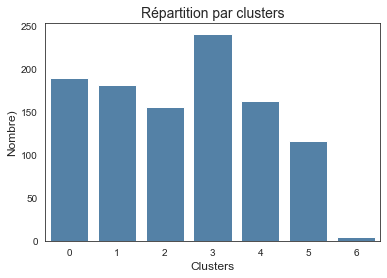

In [644]:
outils_nlp \
    .affiche_repartition_par_clusters(kmeans_acptsne_hash_desc_lem_labels)

In [645]:
# Les catégories par clusters
df_acptsne_hash_desc_lem.groupby('Clusters')['CATEGORIE'].value_counts() \
    .to_frame()

CATEGORIE
Clusters CATEGORIE                            
0        Home Decor & Festive Needs         97
         Home Furnishing                    66
         Baby Care                          12
         Beauty and Personal Care            6
         Computers                           4
         Kitchen & Dining                    4
1        Beauty and Personal Care           95
         Kitchen & Dining                   23
         Computers                          19
         Home Furnishing                    15
         Baby Care                          13
         Home Decor & Festive Needs         12
         Watches                             4
2        Watches                           146
         Computers                           7
         Home Furnishing                     2
         Home Decor & Festive Needs          1
3        Computers                         120
         Beauty and Personal Care           35
         Home Furnishing                    26
         Home Decor & Festive Needs         23
         Baby Care                          21
         Kitchen & Dining                   16
4        Baby Care                         103
         Home Furnishing                    41
         Home Decor & Festive Needs          9
         Beauty and Personal Care            6
         Kitchen & Dining                    4
5        Kitchen & Dining                  102
         Beauty and Personal Care            8
         Home Decor & Festive Needs          5
         Baby Care                           1
6        Home Decor & Festive Needs          3
         Kitchen & Dining                    1

**Visualisation des clusters**

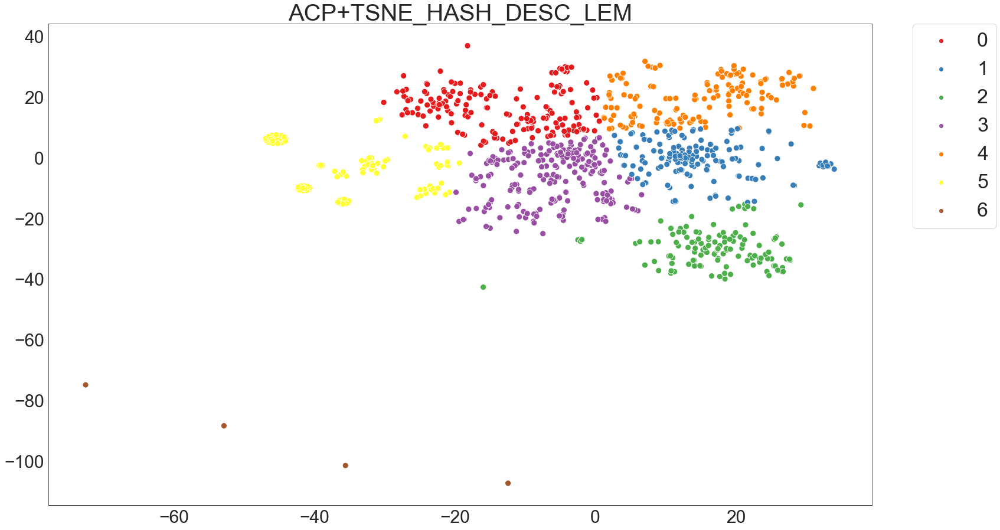

In [646]:
# Visualisation des clusters
outils_nlp \
    .affiche_projection_par_clusters(X_proj_acptsne_hash_desc_lem,
                                     kmeans_acptsne_hash_desc_lem_labels,
                                     type_donnee)

**Bilan** :
***
- Le score ARI est moyen (0.40).
- Les 7 catégories sont bien trouvées avec cependant quelques mélanges :
    - Cluster 0 : Home Decor & Festive Needs
    - Cluster 1 : Beauty and Personal Care
    - Cluster 2 : Watches
    - Cluster 3 : Computers
    - Cluster 4 : Baby Care
    - Cluster 5 : Kitchen & Dining
    - Cluster 6 : Home Decor & Festive Needs
- Cette combinaison ACP+TSNE HashingVectorizer + description lemmatisée parvient à retrouver les 7 catégories comme le souhaite notre client. Il reste à mesurer la qualité de cette catégorisation (63%).

**Qualité de la catégorisation ?**

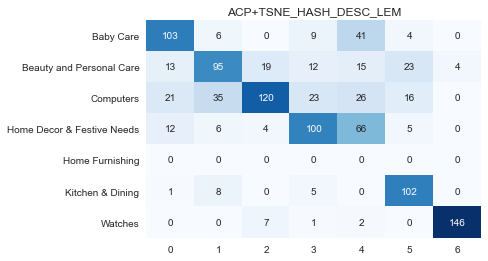

'Précision: 63.43%'

                            precision    recall  f1-score   support

                 Baby Care       0.69      0.63      0.66       163
  Beauty and Personal Care       0.63      0.52      0.57       181
                 Computers       0.80      0.50      0.61       241
Home Decor & Festive Needs       0.67      0.52      0.58       193
           Home Furnishing       0.00      0.00      0.00         0
          Kitchen & Dining       0.68      0.88      0.77       116
                   Watches       0.97      0.94      0.95       156

                  accuracy                           0.63      1050
                 macro avg       0.63      0.57      0.59      1050
              weighted avg       0.74      0.63      0.68      1050


In [647]:
dico_categories = {'0': 'Home Decor & Festive Needs',
                   '1': 'Beauty and Personal Care',
                   '2': 'Watches',
                   '3': 'Computers',
                   '4': 'Baby Care',
                   '5': 'Kitchen & Dining',
                   '6': 'Home Decor & Festive Needs'}
outils_nlp.affiche_qualite_categorisation(df_acptsne_hash_desc_lem,
                                          dico_categories, type_donnee)

In [648]:
# Sauvegarde des précisions de la catégorisation
df_precision = outils_nlp.sauvegarde_precision(df_precision, '63',
                                               type_donnee)
# Sauvegarde des dataframes de trace
outils_data.to_csv(df_precision, 'data_df_precision.csv')

**description** - stemmatisée
***

**Recherche des meilleurs hyperparamètres**

In [649]:
type_donnee = 'ACP+TSNE_HASH_DESC_STEM'

In [650]:
# Tuning hyperparametres n_init, max_iter
# Paramètres à tester
n_init = [10, 20, 30, 50, 70, 80, 100]
max_iter = [100, 200, 300, 400, 500]
# Métriques avec les différentes combinaisons des paramètres
df_metrics_kmeans = \
    outils_nlp.calcul_metrics_kmeans(df_acptsne_hash_desc_stem[cols],
                                     df_metrics_kmeans,
                                     type_donnee,
                                     seed, n_init, max_iter)
# Tri par indice de dispersion : proche de 0
df_metrics_kmeans[df_metrics_kmeans['Type_données'] == type_donnee] \
    .sort_values(by=['coef_silh', 'davies_bouldin', 'Durée (s)'],
                 ascending=[False, True, True]).style.hide_index()

Type_données,n_init,max_iter,coef_silh,dispersion,davies_bouldin,Durée (s)
ACP+TSNE_HASH_DESC_STEM,80,300,0.47668,73722.57812,0.74511,0.43190
ACP+TSNE_HASH_DESC_STEM,80,100,0.47668,73722.57031,0.74511,0.43218
ACP+TSNE_HASH_DESC_STEM,80,200,0.47668,73722.57812,0.74511,0.43829
ACP+TSNE_HASH_DESC_STEM,80,400,0.47668,73722.57812,0.74511,0.43834
ACP+TSNE_HASH_DESC_STEM,80,500,0.47668,73722.57812,0.74511,0.48673
ACP+TSNE_HASH_DESC_STEM,10,400,0.47652,73729.45312,0.74408,0.04686
ACP+TSNE_HASH_DESC_STEM,10,300,0.47652,73729.45312,0.74408,0.04790
ACP+TSNE_HASH_DESC_STEM,10,500,0.47652,73729.45312,0.74408,0.05337
ACP+TSNE_HASH_DESC_STEM,10,100,0.47652,73729.46094,0.74408,0.05981
ACP+TSNE_HASH_DESC_STEM,10,200,0.47652,73729.45312,0.74408,0.05981


In [651]:
# Sauvegarde des dataframes de trace
outils_data.to_csv(df_metrics_kmeans, 'data_df_metrics_kmeans.csv')

**Clustering**

In [652]:
# Instanciation du modèle KMeans avec les meilleurs paramètres
kmeans_acptsne_hash_desc_stem = KMeans(n_clusters=7, init='k-means++',
                                       n_init=80, max_iter=300,
                                       random_state=seed) \
    .fit(df_acptsne_hash_desc_stem[cols])
# Ajout de l'assignation du cluster au dataframe
df_acptsne_hash_desc_stem['Clusters'] = kmeans_acptsne_hash_desc_stem.labels_
kmeans_acptsne_hash_desc_stem_labels = kmeans_acptsne_hash_desc_stem.labels_

In [653]:
# Scores ?
df_scores = outils_nlp.calcul_metriques_clusters(df_acptsne_hash_desc_stem,
                                                 df_scores,
                                                 type_donnee)
df_scores.style.hide_index()

Type_données,ARI,Homogénéité,Complétude,V-measure
ACP_CV_DESC_LEM,0.03894,0.11797,0.20952,0.15095
ACP_CV_DESC_STEM,0.04503,0.11941,0.19802,0.14898
ACP_CV_PROD_LEM,0.10551,0.26012,0.58404,0.35994
ACP_CV_PROD_STEM,0.10015,0.25417,0.57940,0.35334
ACP_TFIDF_DESC_LEM,0.14925,0.34720,0.53091,0.41984
ACP_TFIDF_DESC_STEM,0.14698,0.34728,0.52762,0.41886
ACP_TFIDF_PROD_LEM,0.20215,0.37890,0.48553,0.42564
ACP_TFIDF_PROD_STEM,0.21837,0.39724,0.50516,0.44475
ACP_HASH_DESC_LEM,0.03915,0.11095,0.19437,0.14126
ACP_HASH_DESC_STEM,0.04546,0.11990,0.20162,0.15037


In [654]:
# Sauvegarde des dataframes de trace
outils_data.to_csv(df_scores, 'data_df_scores.csv')

Clusters,Nombre,%
0,81,7.71000
1,237,22.57000
2,158,15.05000
3,130,12.38000
4,152,14.48000
5,150,14.29000
6,142,13.52000


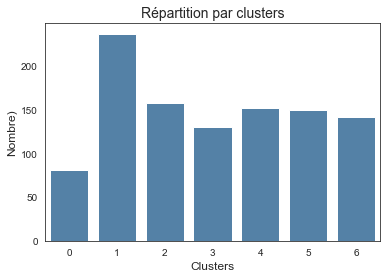

In [655]:
outils_nlp \
    .affiche_repartition_par_clusters(kmeans_acptsne_hash_desc_stem_labels)

In [656]:
# Les catégories par clusters
df_acptsne_hash_desc_stem.groupby('Clusters')['CATEGORIE'].value_counts() \
    .to_frame()

CATEGORIE
Clusters CATEGORIE                            
0        Kitchen & Dining                   79
         Baby Care                           1
         Home Decor & Festive Needs          1
1        Home Furnishing                    76
         Computers                          53
         Beauty and Personal Care           35
         Baby Care                          32
         Home Decor & Festive Needs         26
         Kitchen & Dining                   15
2        Beauty and Personal Care           83
         Home Furnishing                    45
         Computers                          12
         Baby Care                           6
         Home Decor & Festive Needs          6
         Kitchen & Dining                    4
         Watches                             2
3        Baby Care                          99
         Home Furnishing                    27
         Beauty and Personal Care            4
4        Computers                          83
         Kitchen & Dining                   28
         Beauty and Personal Care           19
         Home Decor & Festive Needs         18
         Baby Care                           2
         Home Furnishing                     2
5        Watches                           148
         Beauty and Personal Care            1
         Kitchen & Dining                    1
6        Home Decor & Festive Needs         99
         Kitchen & Dining                   23
         Baby Care                          10
         Beauty and Personal Care            8
         Computers                           2

**Visualisation des clusters**

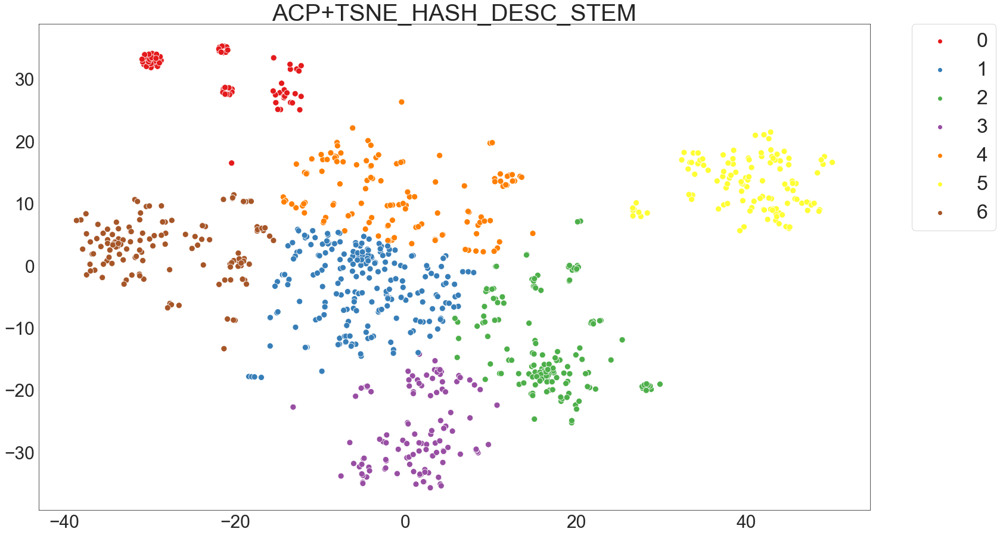

In [657]:
# Visualisation des clusters
outils_nlp \
    .affiche_projection_par_clusters(X_proj_acptsne_hash_desc_stem,
                                     kmeans_acptsne_hash_desc_stem_labels,
                                     type_donnee)

**Bilan** :
***
- Le score ARI est moyen (0.38).
- Les 7 catégories sont bien trouvées avec cependant quelques mélanges :
    - Cluster 0 : Kitchen & Dining
    - Cluster 1 : Home Furnishing
    - Cluster 2 : Beauty and Personal Care
    - Cluster 3 : Baby Care
    - Cluster 4 : Computers
    - Cluster 5 : Watches
    - Cluster 6 : Home Decor & Festive Needs
- Cette combinaison ACP+TSNE HashingVectorizer + description lemmatisée parvient à retrouver les 7 catégories comme le souhaite notre client. Il reste à mesurer la qualité de cette catégorisation (4%).

**Qualité de la catégorisation ?**

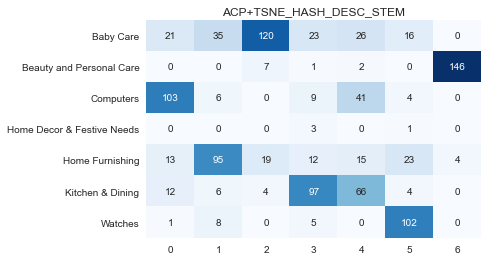

'Précision: 4.1%'

                            precision    recall  f1-score   support

                 Baby Care       0.14      0.09      0.11       241
  Beauty and Personal Care       0.00      0.00      0.00       156
                 Computers       0.00      0.00      0.00       163
Home Decor & Festive Needs       0.02      0.75      0.04         4
           Home Furnishing       0.10      0.08      0.09       181
          Kitchen & Dining       0.03      0.02      0.02       189
                   Watches       0.00      0.00      0.00       116

                  accuracy                           0.04      1050
                 macro avg       0.04      0.13      0.04      1050
              weighted avg       0.05      0.04      0.04      1050


In [658]:
dico_categories = {'0': 'Kitchen & Dining',
                   '1': 'Home Furnishing',
                   '2': 'Beauty and Personal Care',
                   '3': 'Baby Care',
                   '4': 'Computers',
                   '5': 'Watches',
                   '6': 'Home Decor & Festive Needs'}
outils_nlp.affiche_qualite_categorisation(df_acptsne_hash_desc_lem,
                                          dico_categories, type_donnee)

In [659]:
# Sauvegarde des précisions de la catégorisation
df_precision = outils_nlp.sauvegarde_precision(df_precision, '4',
                                               type_donnee)
# Sauvegarde des dataframes de trace
outils_data.to_csv(df_precision, 'data_df_precision.csv')

**produit_specification** - lemmatisée
***

**Recherche des meilleurs hyperparamètres**

In [660]:
type_donnee = 'ACP+TSNE_HASH_PROD_LEM'

In [661]:
# Tuning hyperparametres n_init, max_iter
# Paramètres à tester
n_init = [10, 20, 30, 50, 70, 80, 100]
max_iter = [100, 200, 300, 400, 500]
# Métriques avec les différentes combinaisons des paramètres
df_metrics_kmeans = \
    outils_nlp.calcul_metrics_kmeans(df_acptsne_hash_prod_lem[cols],
                                     df_metrics_kmeans,
                                     type_donnee,
                                     seed, n_init, max_iter)
# Tri par indice de dispersion : proche de 0
df_metrics_kmeans[df_metrics_kmeans['Type_données'] == type_donnee] \
    .sort_values(by=['coef_silh', 'davies_bouldin', 'Durée (s)'],
                 ascending=[False, True, True]).style.hide_index()

Type_données,n_init,max_iter,coef_silh,dispersion,davies_bouldin,Durée (s)
ACP+TSNE_HASH_PROD_LEM,20,100,0.44680,89597.11719,0.72442,0.09642
ACP+TSNE_HASH_PROD_LEM,20,500,0.44680,89597.11719,0.72442,0.09981
ACP+TSNE_HASH_PROD_LEM,20,200,0.44680,89597.11719,0.72442,0.10024
ACP+TSNE_HASH_PROD_LEM,20,400,0.44680,89597.11719,0.72442,0.10871
ACP+TSNE_HASH_PROD_LEM,20,300,0.44680,89597.11719,0.72442,0.11089
ACP+TSNE_HASH_PROD_LEM,30,400,0.44680,89597.11719,0.72442,0.16076
ACP+TSNE_HASH_PROD_LEM,30,100,0.44680,89597.11719,0.72442,0.16317
ACP+TSNE_HASH_PROD_LEM,30,300,0.44680,89597.11719,0.72442,0.16855
ACP+TSNE_HASH_PROD_LEM,30,500,0.44680,89597.11719,0.72442,0.16922
ACP+TSNE_HASH_PROD_LEM,30,200,0.44680,89597.11719,0.72442,0.17232


In [662]:
# Sauvegarde des dataframes de trace
outils_data.to_csv(df_metrics_kmeans, 'data_df_metrics_kmeans.csv')

**Clustering**

In [663]:
# Instanciation du modèle KMeans avec les meilleurs paramètres
kmeans_acptsne_hash_prod_lem = KMeans(n_clusters=7, init='k-means++',
                                      n_init=20, max_iter=100,
                                      random_state=seed) \
    .fit(df_acptsne_hash_prod_lem[cols])
# Ajout de l'assignation du cluster au dataframe
df_acptsne_hash_prod_lem['Clusters'] = kmeans_acptsne_hash_prod_lem.labels_
kmeans_acptsne_hash_prod_lem_labels = kmeans_acptsne_hash_prod_lem.labels_

In [664]:
# Scores ?
df_scores = outils_nlp.calcul_metriques_clusters(df_acptsne_hash_prod_lem,
                                                 df_scores,
                                                 type_donnee)
df_scores.style.hide_index()

Type_données,ARI,Homogénéité,Complétude,V-measure
ACP_CV_DESC_LEM,0.03894,0.11797,0.20952,0.15095
ACP_CV_DESC_STEM,0.04503,0.11941,0.19802,0.14898
ACP_CV_PROD_LEM,0.10551,0.26012,0.58404,0.35994
ACP_CV_PROD_STEM,0.10015,0.25417,0.57940,0.35334
ACP_TFIDF_DESC_LEM,0.14925,0.34720,0.53091,0.41984
ACP_TFIDF_DESC_STEM,0.14698,0.34728,0.52762,0.41886
ACP_TFIDF_PROD_LEM,0.20215,0.37890,0.48553,0.42564
ACP_TFIDF_PROD_STEM,0.21837,0.39724,0.50516,0.44475
ACP_HASH_DESC_LEM,0.03915,0.11095,0.19437,0.14126
ACP_HASH_DESC_STEM,0.04546,0.11990,0.20162,0.15037


In [665]:
# Sauvegarde des dataframes de trace
outils_data.to_csv(df_scores, 'data_df_scores.csv')

Clusters,Nombre,%
0,113,10.76000
1,164,15.62000
2,74,7.05000
3,139,13.24000
4,140,13.33000
5,151,14.38000
6,269,25.62000


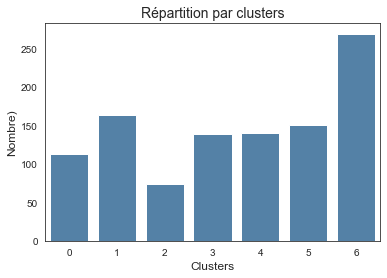

In [666]:
outils_nlp \
    .affiche_repartition_par_clusters(kmeans_acptsne_hash_prod_lem_labels)

In [667]:
# Les catégories par clusters
df_acptsne_hash_prod_lem.groupby('Clusters')['CATEGORIE'].value_counts() \
    .to_frame()

CATEGORIE
Clusters CATEGORIE                            
0        Computers                          84
         Kitchen & Dining                   25
         Beauty and Personal Care            4
1        Baby Care                         106
         Home Furnishing                    58
2        Kitchen & Dining                   74
3        Beauty and Personal Care          109
         Kitchen & Dining                   19
         Home Decor & Festive Needs          9
         Baby Care                           2
4        Watches                           140
5        Home Furnishing                    77
         Computers                          46
         Home Decor & Festive Needs         12
         Baby Care                           9
         Kitchen & Dining                    7
6        Home Decor & Festive Needs        129
         Beauty and Personal Care           37
         Baby Care                          33
         Kitchen & Dining                   25
         Computers                          20
         Home Furnishing                    15
         Watches                            10

**Visualisation des clusters**

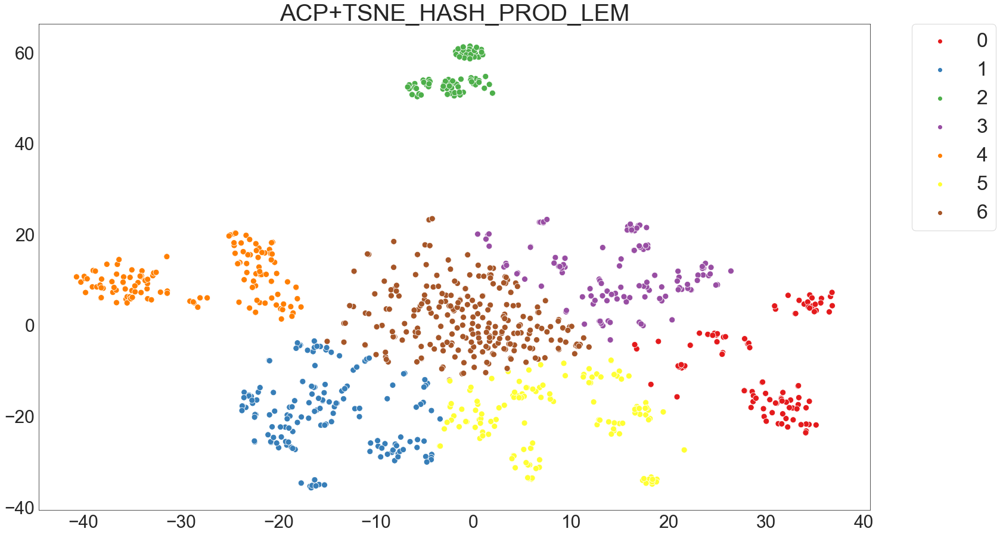

In [668]:
# Visualisation des clusters
outils_nlp \
    .affiche_projection_par_clusters(X_proj_acptsne_hash_prod_lem,
                                     kmeans_acptsne_hash_prod_lem_labels,
                                     type_donnee)

**Bilan** :
***
- Le score ARI est moyen (0.44).
- Les 7 catégories sont bien trouvées avec cependant quelques mélanges :
    - Cluster 0 : Computers
    - Cluster 1 : Baby Care
    - Cluster 2 : Kitchen & Dining
    - Cluster 3 : Beauty and Personal Care
    - Cluster 4 : Watches
    - Cluster 5 : Home Furnishing
    - Cluster 6 : Home Decor & Festive Needs
- Cette combinaison ACP+TSNE HashingVectorizer + produit spécification lemmatisé parvient à retrouver les 7 catégories comme le souhaite notre client. Il reste à mesurer la qualité de cette catégorisation (68.5%).

**Qualité de la catégorisation ?**

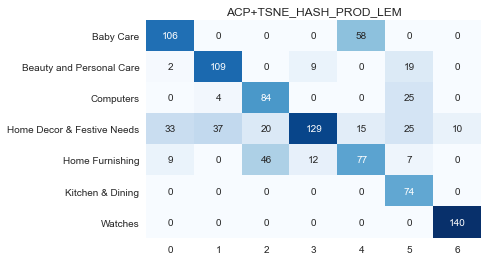

'Précision: 68.48%'

                            precision    recall  f1-score   support

                 Baby Care       0.71      0.65      0.68       164
  Beauty and Personal Care       0.73      0.78      0.75       139
                 Computers       0.56      0.74      0.64       113
Home Decor & Festive Needs       0.86      0.48      0.62       269
           Home Furnishing       0.51      0.51      0.51       151
          Kitchen & Dining       0.49      1.00      0.66        74
                   Watches       0.93      1.00      0.97       140

                  accuracy                           0.68      1050
                 macro avg       0.68      0.74      0.69      1050
              weighted avg       0.72      0.68      0.68      1050


In [669]:
dico_categories = {'0': 'Computers',
                   '1': 'Baby Care',
                   '2': 'Kitchen & Dining',
                   '3': 'Beauty and Personal Care',
                   '4': 'Watches',
                   '5': 'Home Furnishing',
                   '6': 'Home Decor & Festive Needs'}
outils_nlp.affiche_qualite_categorisation(df_acptsne_hash_prod_lem,
                                          dico_categories, type_donnee)

In [670]:
# Sauvegarde des précisions de la catégorisation
df_precision = outils_nlp.sauvegarde_precision(df_precision, '68.5',
                                               type_donnee)
# Sauvegarde des dataframes de trace
outils_data.to_csv(df_precision, 'data_df_precision.csv')

**produit_specification** - stemmatisée
***

**Recherche des meilleurs hyperparamètres**

In [671]:
type_donnee = 'ACP+TSNE_HASH_PROD_STEM'

In [672]:
# Tuning hyperparametres n_init, max_iter
# Paramètres à tester
n_init = [10, 20, 30, 50, 70, 80, 100]
max_iter = [100, 200, 300, 400, 500]
# Métriques avec les différentes combinaisons des paramètres
df_metrics_kmeans = \
    outils_nlp.calcul_metrics_kmeans(df_acptsne_hash_prod_stem[cols],
                                     df_metrics_kmeans,
                                     type_donnee,
                                     seed, n_init, max_iter)
# Tri par indice de dispersion : proche de 0
df_metrics_kmeans[df_metrics_kmeans['Type_données'] == type_donnee] \
    .sort_values(by=['coef_silh', 'davies_bouldin', 'Durée (s)'],
                 ascending=[False, True, True]).style.hide_index()

Type_données,n_init,max_iter,coef_silh,dispersion,davies_bouldin,Durée (s)
ACP+TSNE_HASH_PROD_STEM,10,400,0.47961,86250.53125,0.65965,0.05386
ACP+TSNE_HASH_PROD_STEM,10,500,0.47961,86250.53125,0.65965,0.05386
ACP+TSNE_HASH_PROD_STEM,10,300,0.47961,86250.53125,0.65965,0.05585
ACP+TSNE_HASH_PROD_STEM,10,100,0.47961,86250.53125,0.65965,0.05585
ACP+TSNE_HASH_PROD_STEM,10,200,0.47961,86250.53125,0.65965,0.05585
ACP+TSNE_HASH_PROD_STEM,20,100,0.47961,86250.53125,0.65965,0.10073
ACP+TSNE_HASH_PROD_STEM,20,200,0.47961,86250.53125,0.65965,0.10073
ACP+TSNE_HASH_PROD_STEM,20,300,0.47961,86250.53125,0.65965,0.10173
ACP+TSNE_HASH_PROD_STEM,20,400,0.47961,86250.53125,0.65965,0.10273
ACP+TSNE_HASH_PROD_STEM,20,500,0.47961,86250.53125,0.65965,0.10273


In [673]:
# Sauvegarde des dataframes de trace
outils_data.to_csv(df_metrics_kmeans, 'data_df_metrics_kmeans.csv')

**Clustering**

In [674]:
# Instanciation du modèle KMeans avec les meilleurs paramètres
kmeans_acptsne_hash_prod_stem = KMeans(n_clusters=7, init='k-means++',
                                       n_init=10, max_iter=400,
                                       random_state=seed) \
    .fit(df_acptsne_hash_prod_stem[cols])
# Ajout de l'assignation du cluster au dataframe
df_acptsne_hash_prod_stem['Clusters'] = kmeans_acptsne_hash_prod_stem.labels_
kmeans_acptsne_hash_prod_stem_labels = kmeans_acptsne_hash_prod_stem.labels_

In [675]:
# Scores ?
df_scores = outils_nlp.calcul_metriques_clusters(df_acptsne_hash_prod_stem,
                                                 df_scores,
                                                 type_donnee)
df_scores.style.hide_index()

Type_données,ARI,Homogénéité,Complétude,V-measure
ACP_CV_DESC_LEM,0.03894,0.11797,0.20952,0.15095
ACP_CV_DESC_STEM,0.04503,0.11941,0.19802,0.14898
ACP_CV_PROD_LEM,0.10551,0.26012,0.58404,0.35994
ACP_CV_PROD_STEM,0.10015,0.25417,0.57940,0.35334
ACP_TFIDF_DESC_LEM,0.14925,0.34720,0.53091,0.41984
ACP_TFIDF_DESC_STEM,0.14698,0.34728,0.52762,0.41886
ACP_TFIDF_PROD_LEM,0.20215,0.37890,0.48553,0.42564
ACP_TFIDF_PROD_STEM,0.21837,0.39724,0.50516,0.44475
ACP_HASH_DESC_LEM,0.03915,0.11095,0.19437,0.14126
ACP_HASH_DESC_STEM,0.04546,0.11990,0.20162,0.15037


In [692]:
# Sauvegarde des dataframes de trace
outils_data.to_csv(df_scores, 'data_df_scores.csv')

Clusters,Nombre,%
0,175,16.67000
1,121,11.52000
2,116,11.05000
3,141,13.43000
4,74,7.05000
5,148,14.10000
6,275,26.19000


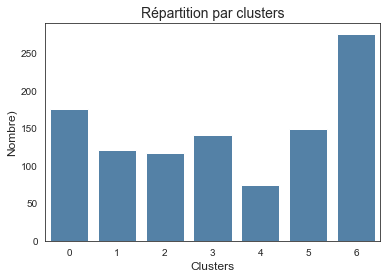

In [677]:
outils_nlp \
    .affiche_repartition_par_clusters(kmeans_acptsne_hash_prod_stem_labels)

In [678]:
# Les catégories par clusters
df_acptsne_hash_prod_stem.groupby('Clusters')['CATEGORIE'].value_counts() \
    .to_frame()

CATEGORIE
Clusters CATEGORIE                            
0        Beauty and Personal Care          107
         Kitchen & Dining                   55
         Computers                           5
         Baby Care                           4
         Home Decor & Festive Needs          4
1        Baby Care                          89
         Home Furnishing                    32
2        Watches                           116
3        Computers                         117
         Home Decor & Festive Needs         17
         Kitchen & Dining                    7
4        Kitchen & Dining                   74
5        Home Furnishing                    99
         Baby Care                          39
         Beauty and Personal Care            5
         Home Decor & Festive Needs          5
6        Home Decor & Festive Needs        124
         Beauty and Personal Care           38
         Watches                            34
         Computers                          28
         Home Furnishing                    19
         Baby Care                          18
         Kitchen & Dining                   14

**Visualisation des clusters**

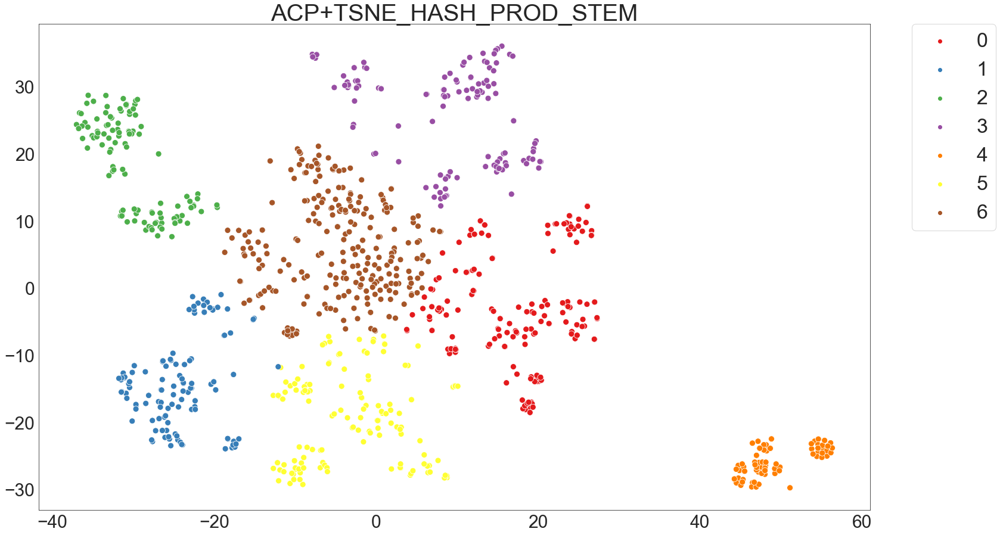

In [679]:
# Visualisation des clusters
outils_nlp \
    .affiche_projection_par_clusters(X_proj_acptsne_hash_prod_stem,
                                     kmeans_acptsne_hash_prod_stem_labels,
                                     type_donnee)

**Bilan** :
***
- Le score ARI est moyen (0.43).
- Les 7 catégories sont bien trouvées avec cependant quelques mélanges :
    - Cluster 0 : Beauty and Personal Care
    - Cluster 1 : Baby Care
    - Cluster 2 : Watches
    - Cluster 3 : Computers
    - Cluster 4 : Kitchen & Dining
    - Cluster 5 : Home Furnishing
    - Cluster 6 : Home Decor & Festive Needs
- Cette combinaison ACP+TSNE TfidfVectorizer + produit spécification stemmatisé parvient à retrouver les 7 catégories comme le souhaite notre client. Il reste à mesurer la qualité de cette catégorisation (69%).

**Qualité de la catégorisation ?**

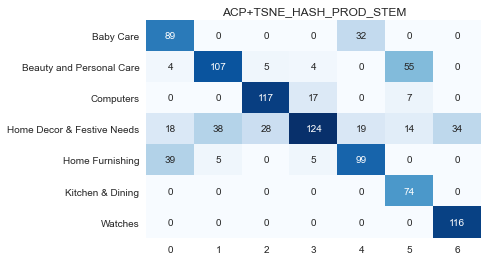

'Précision: 69.14%'

                            precision    recall  f1-score   support

                 Baby Care       0.59      0.74      0.66       121
  Beauty and Personal Care       0.71      0.61      0.66       175
                 Computers       0.78      0.83      0.80       141
Home Decor & Festive Needs       0.83      0.45      0.58       275
           Home Furnishing       0.66      0.67      0.66       148
          Kitchen & Dining       0.49      1.00      0.66        74
                   Watches       0.77      1.00      0.87       116

                  accuracy                           0.69      1050
                 macro avg       0.69      0.76      0.70      1050
              weighted avg       0.72      0.69      0.68      1050


In [680]:
dico_categories = {'0': 'Beauty and Personal Care',
                   '1': 'Baby Care',
                   '2': 'Watches',
                   '3': 'Computers',
                   '4': 'Kitchen & Dining',
                   '5': 'Home Furnishing',
                   '6': 'Home Decor & Festive Needs'}
outils_nlp.affiche_qualite_categorisation(df_acptsne_hash_prod_stem,
                                          dico_categories, type_donnee)

### <span style='background:PowderBlue'>6.11. TruncatedSVD BOW TfidfVectorizer</span>

**produit_specification** - lemmatisée
***

**Recherche des meilleurs hyperparamètres**

In [204]:
type_donnee = 'TSVD_TFIDF_PROD_LEM'

In [205]:
# Tuning hyperparametres n_init, max_iter
# Paramètres à tester
n_init = [10, 20, 30, 50, 70, 80, 100]
max_iter = [100, 200, 300, 400, 500]
# Métriques avec les différentes combinaisons des paramètres
df_metrics_kmeans = \
    outils_nlp.calcul_metrics_kmeans(df_tsvd_tfidf_prod_lem[cols],
                                     df_metrics_kmeans,
                                     type_donnee,
                                     seed, n_init, max_iter)
# Tri par indice de dispersion : proche de 0
df_metrics_kmeans[df_metrics_kmeans['Type_données'] == type_donnee] \
    .sort_values(by=['coef_silh', 'davies_bouldin', 'Durée (s)'],
                 ascending=[False, True, True]).style.hide_index()

Type_données,n_init,max_iter,coef_silh,dispersion,davies_bouldin,Durée (s)
TSVD_TFIDF_PROD_LEM,10,400,0.52559,1.41217,0.55289,0.02963
TSVD_TFIDF_PROD_LEM,10,200,0.52559,1.41217,0.55289,0.03590
TSVD_TFIDF_PROD_LEM,10,100,0.52559,1.41217,0.55289,0.04089
TSVD_TFIDF_PROD_LEM,10,500,0.52559,1.41217,0.55289,0.04686
TSVD_TFIDF_PROD_LEM,10,300,0.52559,1.41217,0.55289,0.04686
TSVD_TFIDF_PROD_LEM,20,400,0.52479,1.41035,0.55867,0.06799
TSVD_TFIDF_PROD_LEM,20,500,0.52479,1.41035,0.55867,0.06866
TSVD_TFIDF_PROD_LEM,20,300,0.52479,1.41035,0.55867,0.06989
TSVD_TFIDF_PROD_LEM,20,100,0.52479,1.41035,0.55867,0.07003
TSVD_TFIDF_PROD_LEM,20,200,0.52479,1.41035,0.55867,0.08362


In [206]:
# Sauvegarde des dataframes de trace
outils_data.to_csv(df_metrics_kmeans, 'data_df_metrics_kmeans.csv')

**Clustering**

In [207]:
# Instanciation du modèle KMeans avec les meilleurs paramètres
kmeans_tsvd_tfidf_prod_lem = KMeans(n_clusters=7, init='k-means++',
                                    n_init=10, max_iter=400,
                                    random_state=seed) \
    .fit(df_tsvd_tfidf_prod_lem[cols])
# Ajout de l'assignation du cluster au dataframe
df_tsvd_tfidf_prod_lem['Clusters'] = kmeans_tsvd_tfidf_prod_lem.labels_
kmeans_tsvd_tfidf_prod_lem_labels = kmeans_tsvd_tfidf_prod_lem.labels_

In [208]:
# Scores ?
df_scores = outils_nlp.calcul_metriques_clusters(df_tsvd_tfidf_prod_lem,
                                                 df_scores,
                                                 type_donnee)
df_scores.style.hide_index()

Type_données,ARI,Homogénéité,Complétude,V-measure
object,float64,float64,float64,float64
ACP_CV_DESC_LEM,0.03893506287347069,0.1179725836434307,0.20952294918955433,0.15095145533535295
ACP_CV_DESC_STEM,0.0450305867356181,0.11940923823125914,0.19802303120314202,0.14898157235459364
ACP_CV_PROD_LEM,0.10551115873444396,0.2601232540746453,0.5840393870958657,0.3599359139335603
ACP_CV_PROD_STEM,0.10014879668768888,0.25416713608389785,0.5794044467400027,0.353336346623738
ACP_TFIDF_DESC_LEM,0.1492529852873013,0.3472048649110712,0.5309142170941463,0.4198428272498124
ACP_TFIDF_DESC_STEM,0.1469813465220413,0.34727934797368504,0.5276205127178243,0.41886326851021216
ACP_TFIDF_PROD_LEM,0.2021524854735017,0.37890315953877907,0.4855268547291208,0.4256392218254822
ACP_TFIDF_PROD_STEM,0.21837125976451904,0.3972426180037001,0.5051552295086917,0.44474659690616575
ACP_HASH_DESC_LEM,0.03915386310926595,0.11094940996982793,0.19436792840646958,0.14126290428470276


In [209]:
# Sauvegarde des dataframes de trace
outils_data.to_csv(df_scores, 'data_df_scores.csv')

Clusters,Nombre,%
0,330,31.43000
1,75,7.14000
2,86,8.19000
3,295,28.10000
4,50,4.76000
5,117,11.14000
6,97,9.24000


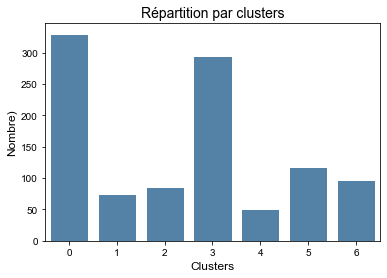

In [210]:
outils_nlp \
    .affiche_repartition_par_clusters(kmeans_tsvd_tfidf_prod_lem_labels)

In [211]:
# Les catégories par clusters
df_tsvd_tfidf_prod_lem.groupby('Clusters')['CATEGORIE'].value_counts() \
    .to_frame()

CATEGORIE
Clusters CATEGORIE                            
0        Home Decor & Festive Needs         98
         Beauty and Personal Care           90
         Computers                          52
         Baby Care                          37
         Home Furnishing                    32
         Kitchen & Dining                   21
1        Kitchen & Dining                   74
         Baby Care                           1
2        Watches                            86
3        Computers                          94
         Home Furnishing                    83
         Baby Care                          57
         Home Decor & Festive Needs         34
         Beauty and Personal Care           20
         Kitchen & Dining                    7
4        Watches                            50
5        Baby Care                          50
         Home Furnishing                    33
         Watches                            14
         Home Decor & Festive Needs         12
         Beauty and Personal Care            4
         Computers                           4
6        Kitchen & Dining                   48
         Beauty and Personal Care           36
         Home Decor & Festive Needs          6
         Baby Care                           5
         Home Furnishing                     2

**Visualisation des clusters**

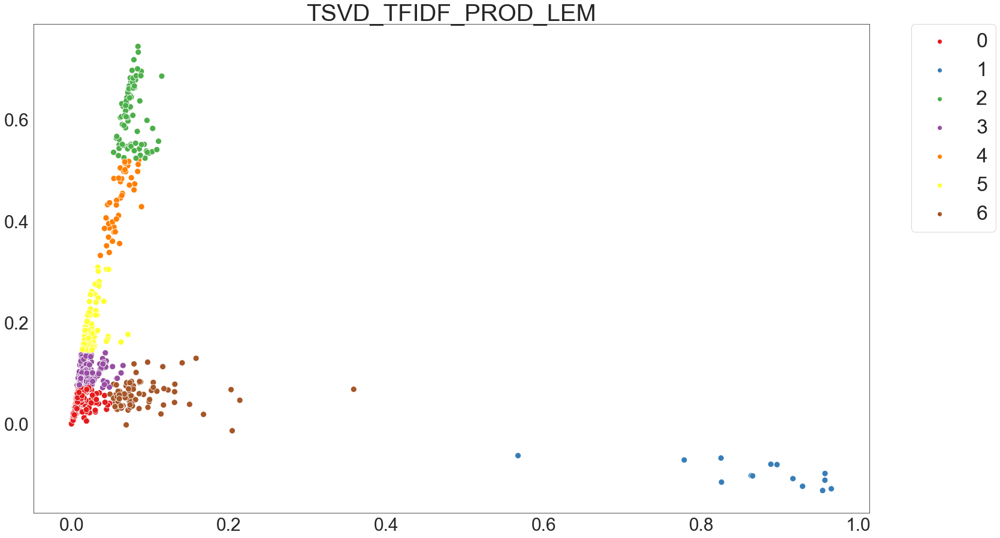

In [212]:
# Visualisation des clusters
outils_nlp \
    .affiche_projection_par_clusters(X_proj_tsvd_tfidf_prod_lem,
                                     kmeans_tsvd_tfidf_prod_lem_labels,
                                     type_donnee)

**Bilan** :
***
- Le score ARI est faible (0.20).
- Cette combinaison TruncatedSVD TfidfVectorizer + produit spécification lemmatisé ne parvient pas à retrouver les 7 catégories comme le souhaite notre client.

In [213]:
# Sauvegarde des précisions de la catégorisation
df_precision = outils_nlp.sauvegarde_precision(df_precision, '0',
                                               type_donnee)
# Sauvegarde des dataframes de trace
outils_data.to_csv(df_precision, 'data_df_precision.csv')

**produit_specification** - stemmatisée
***

**Recherche des meilleurs hyperparamètres**

In [214]:
type_donnee = 'TSVD_TFIDF_PROD_STEM'

In [215]:
# Tuning hyperparametres n_init, max_iter
# Paramètres à tester
n_init = [10, 20, 30, 50, 70, 80, 100]
max_iter = [100, 200, 300, 400, 500]
# Métriques avec les différentes combinaisons des paramètres
df_metrics_kmeans = \
    outils_nlp.calcul_metrics_kmeans(df_tsvd_tfidf_prod_stem[cols],
                                     df_metrics_kmeans,
                                     type_donnee,
                                     seed, n_init, max_iter)
# Tri par indice de dispersion : proche de 0
df_metrics_kmeans[df_metrics_kmeans['Type_données'] == type_donnee] \
    .sort_values(by=['coef_silh', 'davies_bouldin', 'Durée (s)'],
                 ascending=[False, True, True]).style.hide_index()

Type_données,n_init,max_iter,coef_silh,dispersion,davies_bouldin,Durée (s)
TSVD_TFIDF_PROD_STEM,10,300,0.54437,1.44643,0.55210,0.02807
TSVD_TFIDF_PROD_STEM,10,400,0.54437,1.44643,0.55210,0.03207
TSVD_TFIDF_PROD_STEM,10,500,0.54437,1.44643,0.55210,0.03813
TSVD_TFIDF_PROD_STEM,10,200,0.54437,1.44643,0.55210,0.04089
TSVD_TFIDF_PROD_STEM,10,100,0.54437,1.44643,0.55210,0.04189
TSVD_TFIDF_PROD_STEM,50,300,0.54153,1.44444,0.55073,0.16240
TSVD_TFIDF_PROD_STEM,50,400,0.54153,1.44444,0.55073,0.16923
TSVD_TFIDF_PROD_STEM,50,500,0.54153,1.44444,0.55073,0.17104
TSVD_TFIDF_PROD_STEM,50,200,0.54153,1.44444,0.55073,0.17254
TSVD_TFIDF_PROD_STEM,50,100,0.54153,1.44444,0.55073,0.17396


In [216]:
# Sauvegarde des dataframes de trace
outils_data.to_csv(df_metrics_kmeans, 'data_df_metrics_kmeans.csv')

**Clustering**

In [217]:
# Instanciation du modèle KMeans avec les meilleurs paramètres
kmeans_tsvd_tfidf_prod_stem = KMeans(n_clusters=7, init='k-means++',
                                     n_init=10, max_iter=300,
                                     random_state=seed) \
    .fit(df_tsvd_tfidf_prod_stem[cols])
# Ajout de l'assignation du cluster au dataframe
df_tsvd_tfidf_prod_stem['Clusters'] = kmeans_tsvd_tfidf_prod_stem.labels_
kmeans_tsvd_tfidf_prod_stem_labels = kmeans_tsvd_tfidf_prod_stem.labels_

In [218]:
# Scores ?
df_scores = outils_nlp.calcul_metriques_clusters(df_tsvd_tfidf_prod_stem,
                                                 df_scores,
                                                 type_donnee)
df_scores.style.hide_index()

Type_données,ARI,Homogénéité,Complétude,V-measure
object,float64,float64,float64,float64
ACP_CV_DESC_LEM,0.03893506287347069,0.1179725836434307,0.20952294918955433,0.15095145533535295
ACP_CV_DESC_STEM,0.0450305867356181,0.11940923823125914,0.19802303120314202,0.14898157235459364
ACP_CV_PROD_LEM,0.10551115873444396,0.2601232540746453,0.5840393870958657,0.3599359139335603
ACP_CV_PROD_STEM,0.10014879668768888,0.25416713608389785,0.5794044467400027,0.353336346623738
ACP_TFIDF_DESC_LEM,0.1492529852873013,0.3472048649110712,0.5309142170941463,0.4198428272498124
ACP_TFIDF_DESC_STEM,0.1469813465220413,0.34727934797368504,0.5276205127178243,0.41886326851021216
ACP_TFIDF_PROD_LEM,0.2021524854735017,0.37890315953877907,0.4855268547291208,0.4256392218254822
ACP_TFIDF_PROD_STEM,0.21837125976451904,0.3972426180037001,0.5051552295086917,0.44474659690616575
ACP_HASH_DESC_LEM,0.03915386310926595,0.11094940996982793,0.19436792840646958,0.14126290428470276


In [219]:
# Sauvegarde des dataframes de trace
outils_data.to_csv(df_scores, 'data_df_scores.csv')

Clusters,Nombre,%
0,224,21.33000
1,75,7.14000
2,55,5.24000
3,498,47.43000
4,64,6.10000
5,34,3.24000
6,100,9.52000


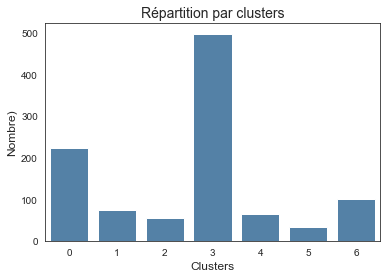

In [220]:
outils_nlp \
    .affiche_repartition_par_clusters(kmeans_tsvd_tfidf_prod_stem_labels)

In [221]:
# Les catégories par clusters
df_tsvd_tfidf_prod_stem.groupby('Clusters')['CATEGORIE'].value_counts() \
    .to_frame()

CATEGORIE
Clusters CATEGORIE                            
0        Baby Care                          74
         Computers                          56
         Home Furnishing                    48
         Home Decor & Festive Needs         27
         Beauty and Personal Care           10
         Watches                             6
         Kitchen & Dining                    3
1        Kitchen & Dining                   74
         Baby Care                           1
2        Watches                            55
3        Home Decor & Festive Needs        115
         Beauty and Personal Care          104
         Home Furnishing                    98
         Computers                          94
         Baby Care                          64
         Kitchen & Dining                   23
4        Watches                            64
5        Watches                            25
         Baby Care                           5
         Home Decor & Festive Needs          2
         Home Furnishing                     2
6        Kitchen & Dining                   50
         Beauty and Personal Care           36
         Baby Care                           6
         Home Decor & Festive Needs          6
         Home Furnishing                     2

**Visualisation des clusters**

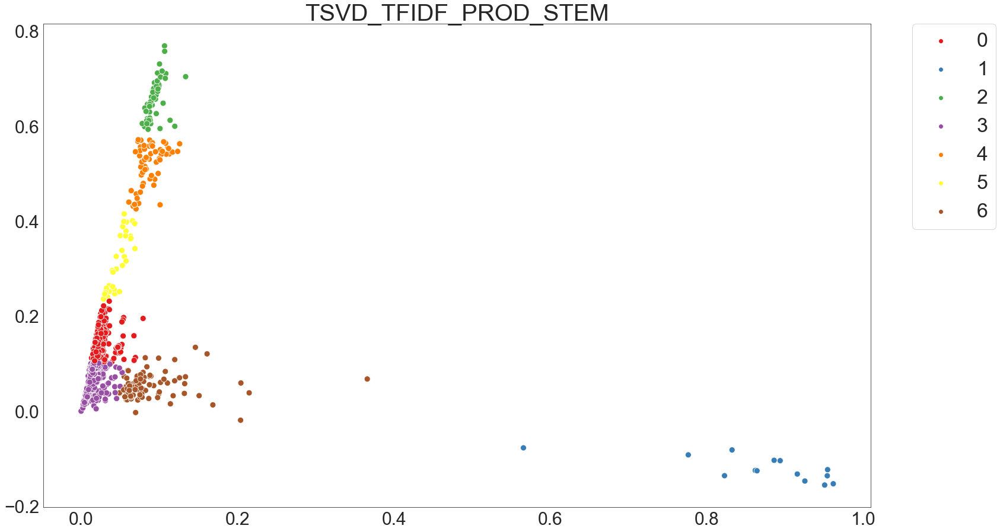

In [222]:
# Visualisation des clusters
outils_nlp \
    .affiche_projection_par_clusters(X_proj_tsvd_tfidf_prod_stem,
                                     kmeans_tsvd_tfidf_prod_stem_labels,
                                     type_donnee)

**Bilan** :
***
- Le score ARI est très faible (0.15).
- Cette combinaison TruncatedSVD TfidfVectorizer + produit spécification stemmatisé e parvient pas à retrouver les 7 catégories comme le souhaite notre client.

In [223]:
# Sauvegarde des précisions de la catégorisation
df_precision = outils_nlp.sauvegarde_precision(df_precision, '0',
                                               type_donnee)
# Sauvegarde des dataframes de trace
outils_data.to_csv(df_precision, 'data_df_precision.csv')

### <span style='background:PowderBlue'>6.12. Comparaison des scores/précisions</span>

In [231]:
# Dataframe de comparaison des scores ARI et de la précision
df_comparaison = df_scores.merge(df_precision, on='Type_données',
                                 how='left')
# Supprime la ligne des types d'objet
df_comparaison.drop(0, 0, inplace=True)
df_comparaison['ARI'] = df_comparaison['ARI'].astype(float)
df_comparaison['Homogénéité'] = df_comparaison['Homogénéité'].astype(float)
df_comparaison['Complétude'] = df_comparaison['Complétude'].astype(float)
df_comparaison['V-measure'] = df_comparaison['V-measure'].astype(float)
df_comparaison['Précision'] = df_comparaison['Précision'].astype(float)

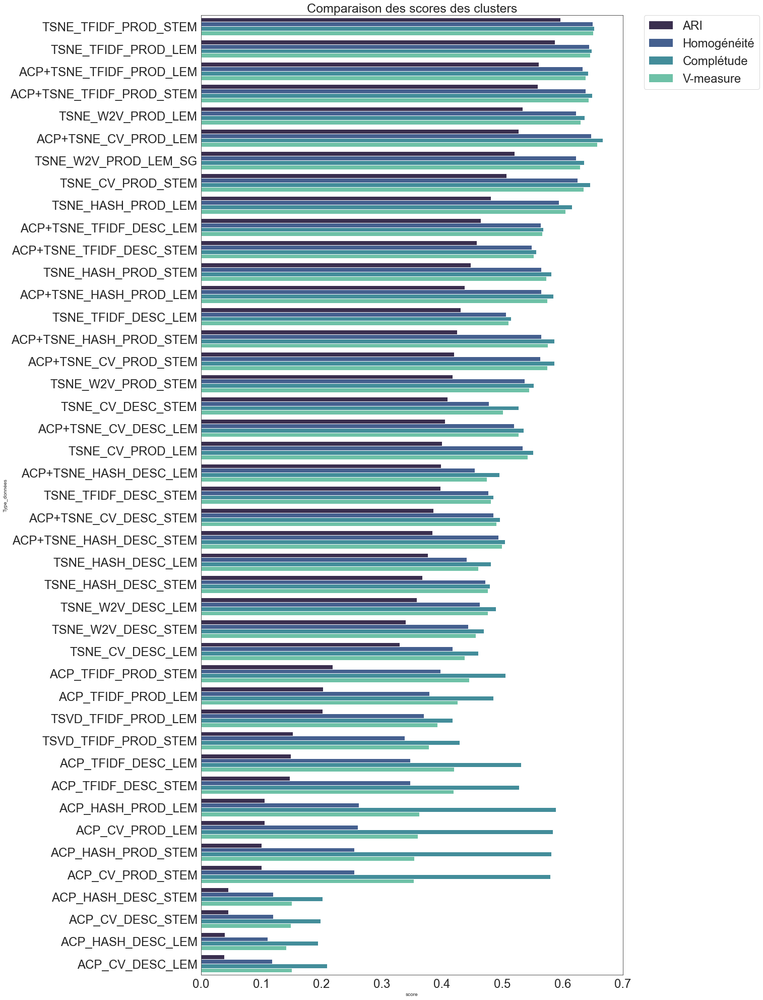

In [232]:
# Comparaison visuelle des 4 algorithmes les plus performants
df_comp_sort = df_comparaison.sort_values(by='ARI', ascending=False)
comparaison_score_melt = pd.melt(df_comp_sort, id_vars=['Type_données'],
                                 value_name='score',
                                 value_vars=['ARI', 'Homogénéité',
                                             'Complétude', 'V-measure'])
# Visualisation
plt.figure(figsize=(15, 35))
sns.barplot(y=comparaison_score_melt['Type_données'],
            x=comparaison_score_melt['score'],
            hue=comparaison_score_melt['variable'], palette='mako')
plt.xticks(fontsize=24)
plt.yticks(fontsize=24)
plt.title('Comparaison des scores des clusters', fontsize=25)
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0., fontsize=24)
plt.show()

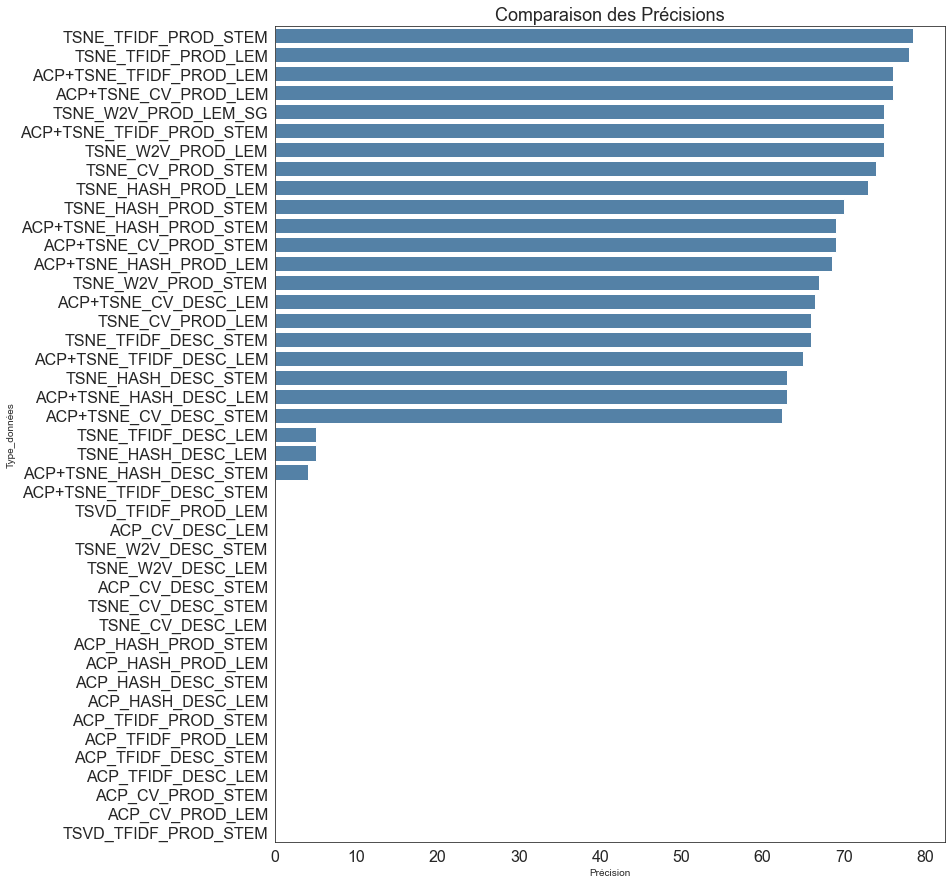

In [233]:
# Visualisation des précisions
df_comp_prec = df_comparaison.sort_values(by='Précision', ascending=False)
plt.figure(figsize=(12, 15))
sns.barplot(x=df_comp_prec['Précision'],
            y=df_comp_prec['Type_données'], color='SteelBlue')
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.title('Comparaison des Précisions', fontsize=18)
plt.show()

**Bilan** :
- Pour les méthodes traditionnelles de Words Embeddings, le meilleur résultat (ARI, Précision) est obtenu à partir des données 'produit_specification', avec une lemmatisation ou une racinisation, en utilisant une réduction de dimension t-SNE et une transformation BOW avec TfidfVectorizer.
- Pour la réduction de dimension, t-SNE et ACP suivi de t-SNE comportent des biens meilleurs résultats qu'ACP seule ou TruncatedSVD.
- TfidfVectorizer obtient des meilleurs résultats qui CountVectorizer, HashingVectorizer ou Word2Vec.

## <span style='background:Thistle'>7. Export des données nettoyées</span>

In [197]:
data_work.to_csv('data_clean.csv')